## Loading the Data-Set:

In [ ]:
from google.colab import drive
import os
import pandas as pd

## Defining the Folder Structure and Listing Files

In [ ]:
# Mount Google Drive
drive.mount('/content/drive')

# Define the main project folder path
project_folder = '/content/drive/My Drive/ML_PROJECT/'

# Define the intervals and their folder names
intervals = {
    "D1": "Daily",
    "H1": "Hourly",
    "H4": "4-Hourly",
    "M5": "5-Minute",
    "M15": "15-Minute",
    "M30": "30-Minute",
    "W1": "Weekly"
}

Mounted at /content/drive


## Selecting (Filtering the top 10 cryptos according to the project requirements) - and also verifying if data is Present

NOTE: Here we are loading the time series data for each interval (folder) separately


In [ ]:


# Updated list of top 10 cryptocurrencies by their symbols, with Tether as 'TUSDT'
top_10_symbols = ['BTC', 'ETH', 'TUSDT', 'USDC', 'BNB', 'XRP', 'ADA', 'LTC', 'SOL', 'DOT']

# Dictionary to store data for each interval and cryptocurrency
interval_data = {interval: {} for interval in intervals}

# Load data by interval and cryptocurrency
for interval, folder_name in intervals.items():
    print(f"\nLoading data for interval: {folder_name}")
    interval_folder_path = os.path.join(project_folder, interval)
    for crypto in top_10_symbols:
        # Handle specific naming for Tether (TUSDT)
        file_name = f"{crypto}USDT_{interval}.csv" if crypto != "TUSDT" else f"TUSDT_{interval}.csv"
        file_path = os.path.join(interval_folder_path, file_name)

        if os.path.exists(file_path):
            df = pd.read_csv(file_path)
            interval_data[interval][crypto] = df
            print(f"Loaded {crypto} data for {folder_name} interval from {file_path}")
        else:
            interval_data[interval][crypto] = pd.DataFrame()  # empty DataFrame if file does not exist
            print(f"No data found for {crypto} in {folder_name} interval.")



Loading data for interval: Daily
Loaded BTC data for Daily interval from /content/drive/My Drive/ML_PROJECT/D1/BTCUSDT_D1.csv
Loaded ETH data for Daily interval from /content/drive/My Drive/ML_PROJECT/D1/ETHUSDT_D1.csv
Loaded TUSDT data for Daily interval from /content/drive/My Drive/ML_PROJECT/D1/TUSDT_D1.csv
Loaded USDC data for Daily interval from /content/drive/My Drive/ML_PROJECT/D1/USDCUSDT_D1.csv
Loaded BNB data for Daily interval from /content/drive/My Drive/ML_PROJECT/D1/BNBUSDT_D1.csv
Loaded XRP data for Daily interval from /content/drive/My Drive/ML_PROJECT/D1/XRPUSDT_D1.csv
Loaded ADA data for Daily interval from /content/drive/My Drive/ML_PROJECT/D1/ADAUSDT_D1.csv
Loaded LTC data for Daily interval from /content/drive/My Drive/ML_PROJECT/D1/LTCUSDT_D1.csv
Loaded SOL data for Daily interval from /content/drive/My Drive/ML_PROJECT/D1/SOLUSDT_D1.csv
Loaded DOT data for Daily interval from /content/drive/My Drive/ML_PROJECT/D1/DOTUSDT_D1.csv

Loading data for interval: Hourly

## 1.1 Summary Statistics of the dataset

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns


# Summary statistics for each cryptocurrency by interval
for interval, folder_name in intervals.items():
    print(f"\n--- Summary Statistics for Interval: {folder_name} ---")
    for crypto, data in interval_data[interval].items():
        if data.empty:
            print(f"No data for {crypto} in {folder_name} interval.")
            continue

        print(f"\nSummary Statistics for {crypto} in {folder_name} Interval:")
        print(data.describe())


--- Summary Statistics for Interval: Daily ---

Summary Statistics for BTC in Daily Interval:
               open          high           low         close         volume
count   2401.000000   2401.000000   2401.000000   2401.000000    2401.000000
mean   21762.117930  22323.862024  21154.752495  21790.838059   72442.970202
std    16498.864396  16930.399309  16040.508547  16528.237502   83571.862556
min     3188.010000   3276.500000   2817.000000   3189.020000     228.108068
25%     8054.720000   8260.000000   7800.000000   8055.980000   29847.243490
50%    16633.470000  16880.000000  16378.610000  16662.760000   46114.359022
75%    33556.960000  34720.490000  32077.000000  33634.090000   76838.094233
max    72078.100000  73650.250000  71333.310000  73072.410000  760705.362783

Summary Statistics for ETH in Daily Interval:
              open         high          low        close        volume
count  2401.000000  2401.000000  2401.000000  2401.000000  2.401000e+03
mean   1249.297005  1

### Summary Statistics Analysis

**Daily Interval**

1. BTC: The daily average closing price is around 21,790, with high volatility as evidenced by a large standard deviation of around 16,528. The minimum price is around 3,189, whereas the maximum price reached approximately 73,072. The trading volume shows significant variation.

2. ETH: The daily closing price has an average of around 1,250, with a high standard deviation indicating substantial volatility. The minimum price was around 83.75, and the maximum reached 4,807. Trading volumes vary greatly, with a median volume of approximately 420,000.

3. Tether (TUSDT): Average daily prices for Tether are relatively stable around 0.038, which aligns with its function as a stablecoin. Volume, however, shows considerable spikes, reflecting periods of intense trading activity.

4. USDC: Similar to Tether, USDC displays price stability around 1 with very little deviation, confirming its role as a stablecoin. Volume fluctuates widely, reaching up to 2.5 billion.

5. BNB: The mean price is around 171.64 with a large range between minimum and maximum, indicating significant price changes over time. Volume is high, with a median close to 1.3 million.

6. Other Altcoins (XRP, ADA, LTC, SOL, DOT): Altcoins display substantial variability in prices and volumes. SOL, in particular, has a high price range (min: 1.20, max: 258.44) and notable volume peaks, reflecting interest and price volatility in the asset.


--------------------------------------------------------------------------------

**Hourly Interval**


1. BTC & ETH: Hourly data reveals frequent changes in price with average values close to daily levels. The maximum trading volumes are significant, with BTC and ETH reaching 137,207 and 493,227, respectively, within certain hours, indicating peak trading activity.



2. Stablecoins (Tether and USDC): Tether and USDC exhibit stable prices with minimal variation, yet show high volume spikes, emphasizing their role in liquidity during trading.




3. BNB and XRP: Both show high volume and price fluctuations. BNB’s max volume within an hour was around 2 million, indicating active trading during certain hours.



4. ADA, LTC, SOL, DOT: Altcoins in the hourly interval display considerable variation in price and volume, suggesting that these assets are actively traded and impacted by intraday market movements.

-------------------------------------------------------------------------------

**4-Hourly Interval**


1. BTC & ETH: Four-hourly data for BTC shows an average close price similar to the daily mean, with high volume peaks indicating periods of concentrated trading. ETH also follows a similar pattern with volumes peaking at over 1.5 million.



2. Stablecoins: Tether and USDC maintain their expected stability in price but show significant spikes in volume every four hours, underscoring their use in trading transactions.



3. Altcoins (BNB, XRP, ADA, etc.): Altcoins continue to show a pattern of price and volume variability, though the 4-hour interval smooths some of the extreme highs and lows seen in the hourly data.


---------------------------------------------------------------------------------


**5-Minute Interval**

1. BTC & ETH: Prices in the 5-minute interval align closely with the daily averages but are more granular in showing minute-to-minute changes. Trading volumes spike significantly, revealing high-frequency trading activities during short bursts.


2. Stablecoins: Tether and USDC remain stable with slight fluctuations, with volumes peaking at certain times within the 5-minute intervals.


3. Altcoins: ADA and SOL, among others, have high fluctuations in price and volume within the 5-minute intervals, indicative of rapid trading activities or high volatility events affecting these assets on a short-term basis.

---------------------------------------------------------------------------------

**15-Minute Interval**


1. BTC & ETH: Average prices remain close to those seen in the daily and hourly intervals. However, the 15-minute data allows for clearer observation of short-term trading surges in volume.

2. Stablecoins: Tether and USDC maintain minimal price fluctuation with volumes spiking periodically, highlighting their continued role as liquidity providers in active trading sessions.

3. BNB, XRP, ADA, and other altcoins: These assets exhibit considerable short-term price and volume variability, suggesting they may be more impacted by short-term market trends or day trading activities.


-----------------------------------------------------------------------------

**30-Minute Interval**

1. BTC & ETH: The 30-minute data offers a middle ground between hourly and daily insights, reflecting stable average prices but notable volume surges that reveal periodic spikes in trading activity.

2. Stablecoins: Tether and USDC uphold price stability while exhibiting volume peaks, maintaining their function as stable trading assets in the market.

3. BNB and other altcoins: Like the 15-minute interval, these assets show significant short-term price and volume variability, making them popular for shorter-term trading strategies.

--------------------------------------------------------------------------------

**Weekly Interval**

1. BTC & ETH: Weekly data shows overall trends with BTC’s maximum weekly close price around 68,955 and ETH’s close to 4,626. Weekly volumes are substantial, emphasizing the cumulative trading activities.

2. Stablecoins: Tether and USDC remain stable with a narrow price range, reflecting their utility as stablecoins.

3. BNB, XRP, ADA, and other altcoins: Weekly summaries show large price ranges, with ADA and SOL experiencing high maximum prices of 2.91 and 249, respectively. Weekly volumes highlight sustained interest and active trading over long periods.

--------------------------------------------------------------------------------

**Conclusions**

1. Stablecoins: Both Tether and USDC demonstrate their primary role as stablecoins with minimal price fluctuation across all intervals. However, they experience volume spikes during shorter intervals, signifying their use as liquidity providers during high trading periods.

2. BTC & ETH: Both cryptocurrencies show substantial price volatility in all intervals, with BTC maintaining a higher average price. The periodic peaks in trading volume across intervals reveal strong market activity and investor interest.

3. Altcoins (BNB, XRP, ADA, SOL, DOT): Altcoins exhibit high price volatility, especially in shorter intervals (5, 15, and 30 minutes), which indicates sensitivity to short-term market dynamics. The weekly data reveals their longer-term growth trends and periodic price peaks.

This summary of interval-based EDA reveals distinct trading patterns, volatility levels, and volume dynamics for each cryptocurrency, helping inform trading strategies and portfolio adjustments based on interval-based behavior.

## 1.2 Handling Missing Values

In [ ]:
# Checking for missing values for each cryptocurrency by interval
for interval, folder_name in intervals.items():
    print(f"\n--- Missing Values for Interval: {folder_name} ---")
    for crypto, data in interval_data[interval].items():
        if data.empty:
            print(f"No data for {crypto} in {folder_name} interval.")
            continue

        missing_values = data.isnull().sum()
        print(f"\nMissing values for {crypto} in {folder_name} Interval:")
        print(missing_values[missing_values > 0])



--- Missing Values for Interval: Daily ---

Missing values for BTC in Daily Interval:
Series([], dtype: int64)

Missing values for ETH in Daily Interval:
Series([], dtype: int64)

Missing values for TUSDT in Daily Interval:
Series([], dtype: int64)

Missing values for USDC in Daily Interval:
Series([], dtype: int64)

Missing values for BNB in Daily Interval:
Series([], dtype: int64)

Missing values for XRP in Daily Interval:
Series([], dtype: int64)

Missing values for ADA in Daily Interval:
Series([], dtype: int64)

Missing values for LTC in Daily Interval:
Series([], dtype: int64)

Missing values for SOL in Daily Interval:
Series([], dtype: int64)

Missing values for DOT in Daily Interval:
Series([], dtype: int64)

--- Missing Values for Interval: Hourly ---

Missing values for BTC in Hourly Interval:
Series([], dtype: int64)

Missing values for ETH in Hourly Interval:
Series([], dtype: int64)

Missing values for TUSDT in Hourly Interval:
Series([], dtype: int64)

Missing values for

### Conclusions for Missing Value Analysis:

Across all intervals (Daily, Hourly, 4-Hourly, 5-Minute, 15-Minute, 30-Minute, and Weekly), there are no missing values in the datasets for any of the cryptocurrencies (BTC, ETH, TUSDT, USDC, BNB, XRP, ADA, LTC, SOL, and DOT). This ensures the dataset’s integrity, enabling accurate analyses and modeling without requiring any imputation or data cleaning steps specifically related to missing values.



## 1.3 Time Series Plot for Closing prices (NOTE: This dataset is purely a time-series data)


--- Time Series Plot for Closing Prices (Daily Interval) ---


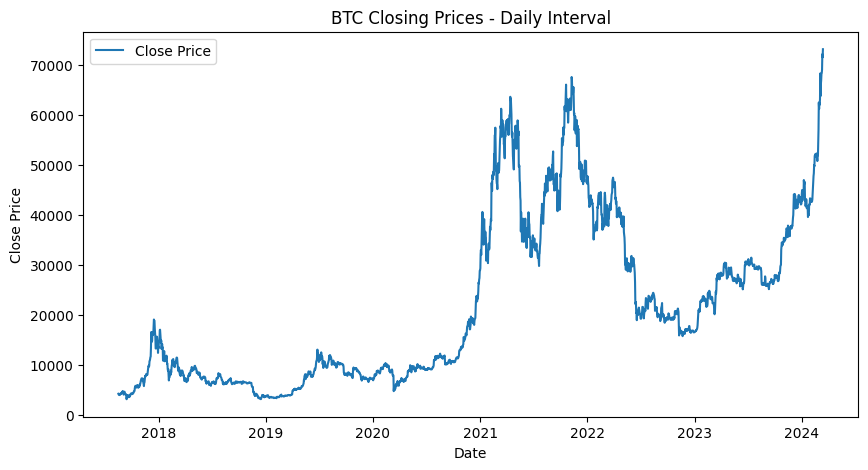

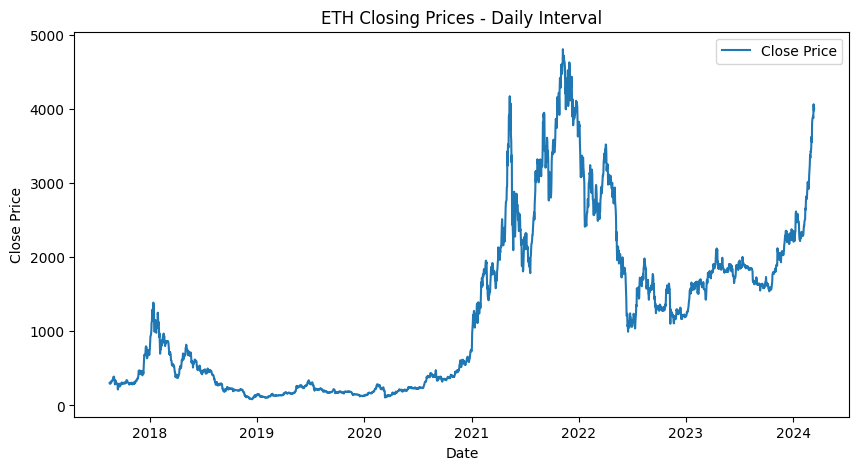

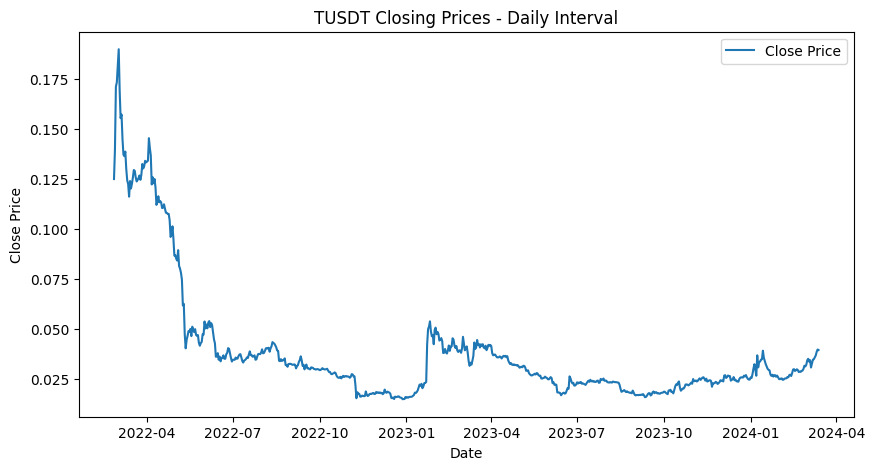

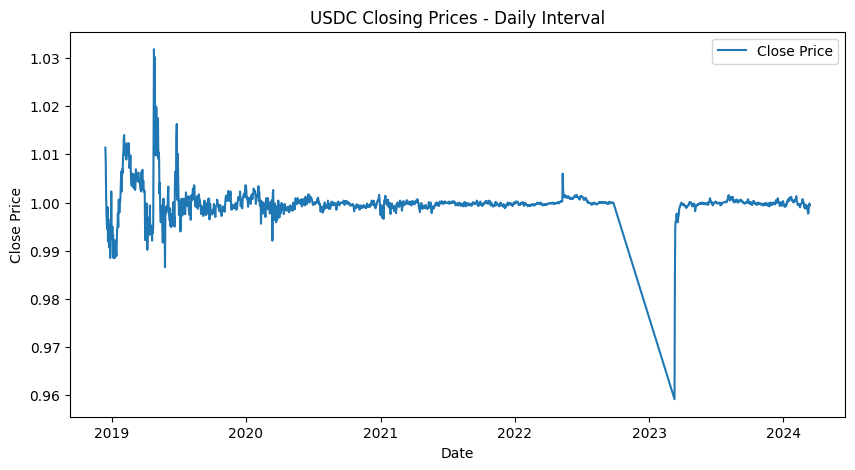

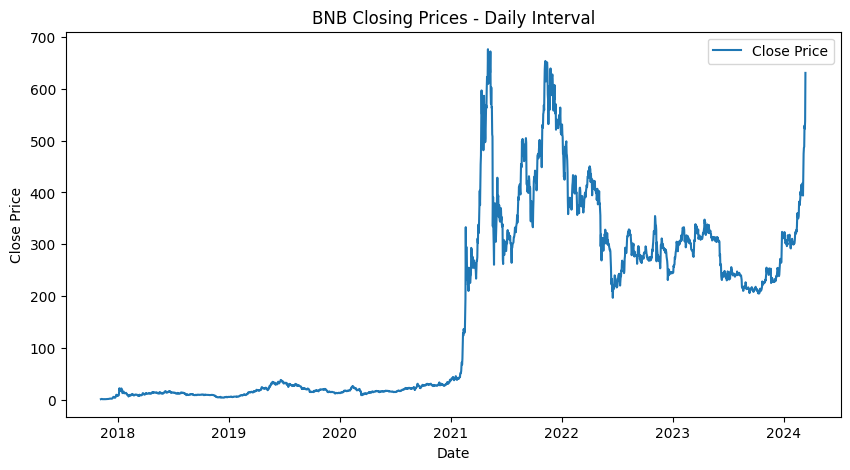

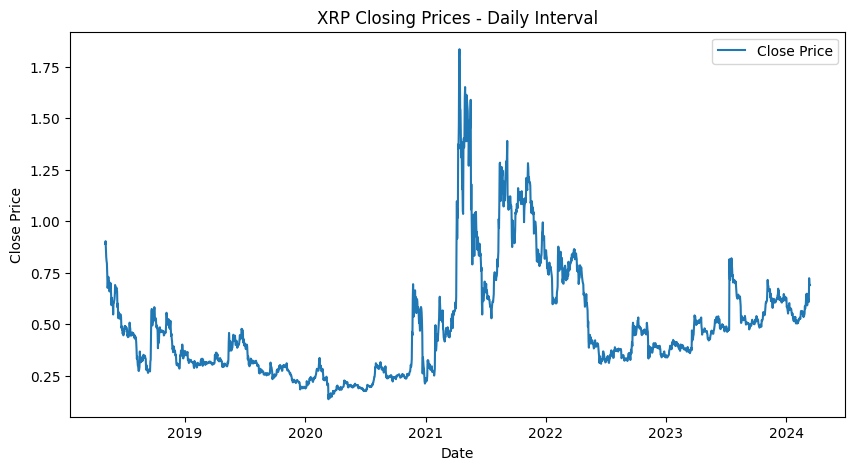

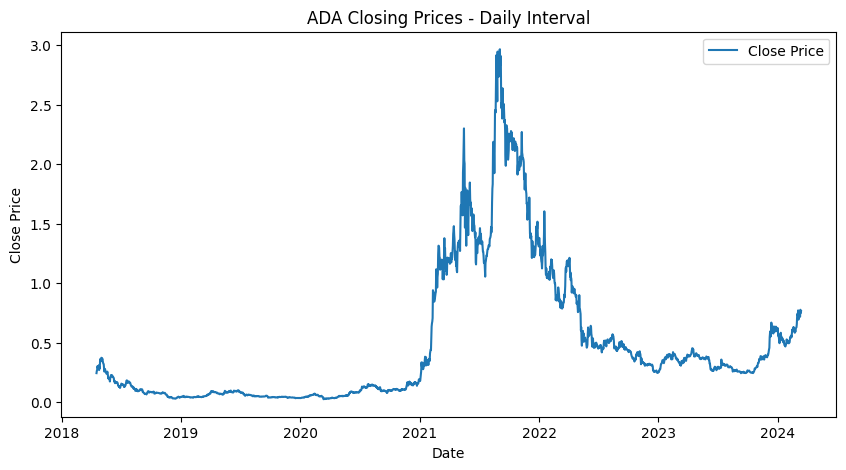

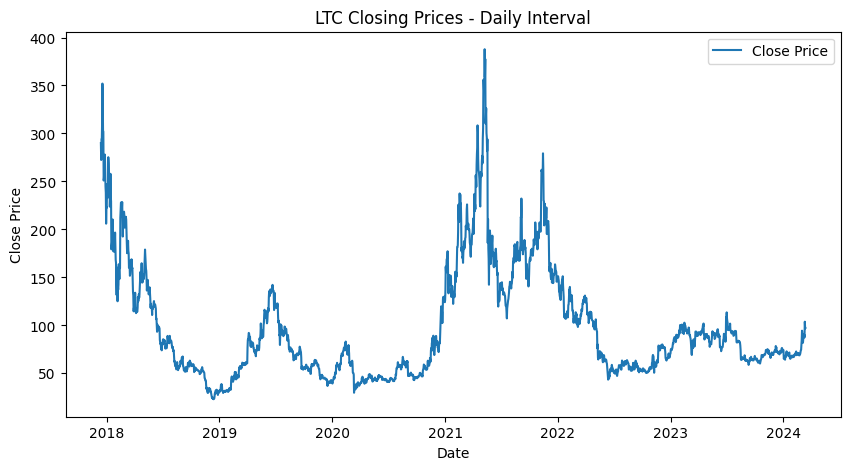

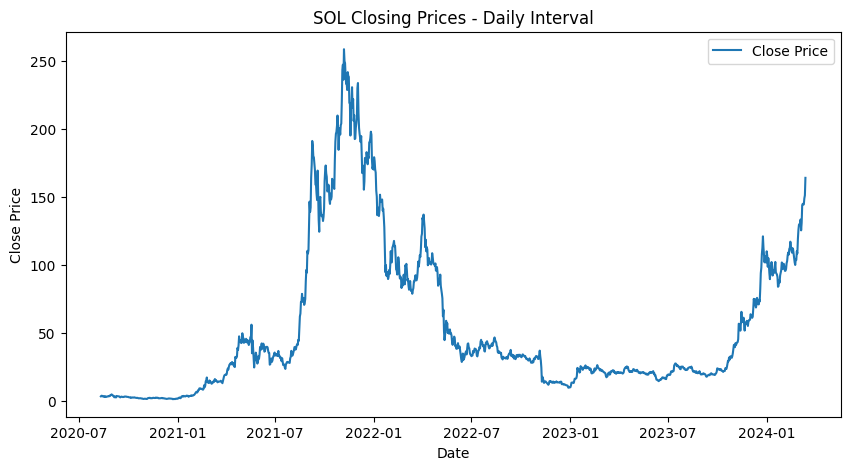

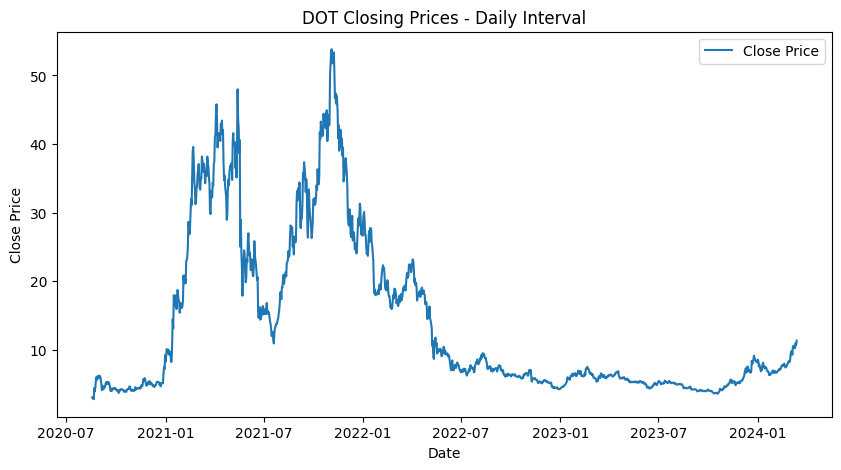


--- Time Series Plot for Closing Prices (Hourly Interval) ---


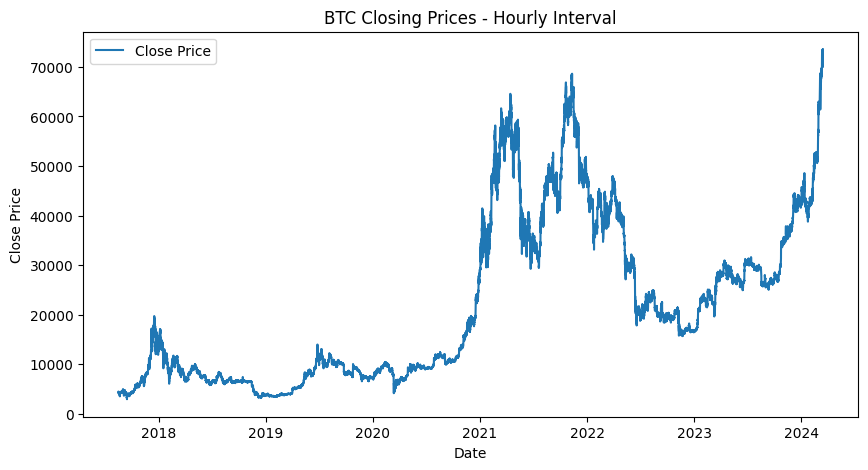

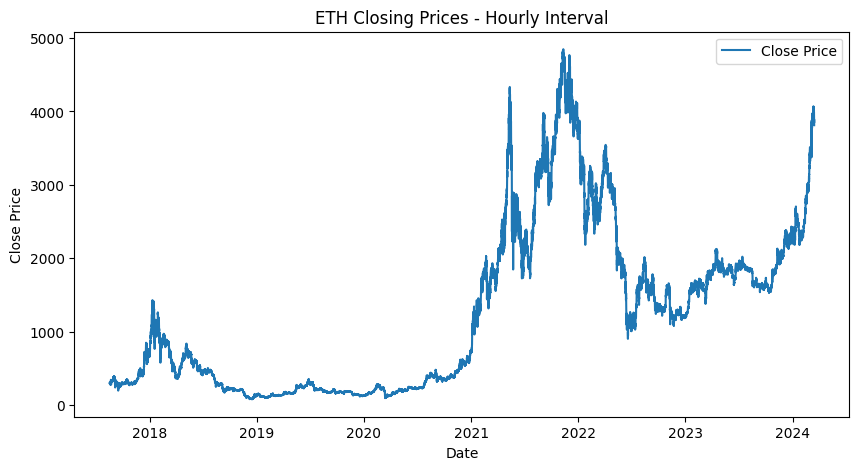

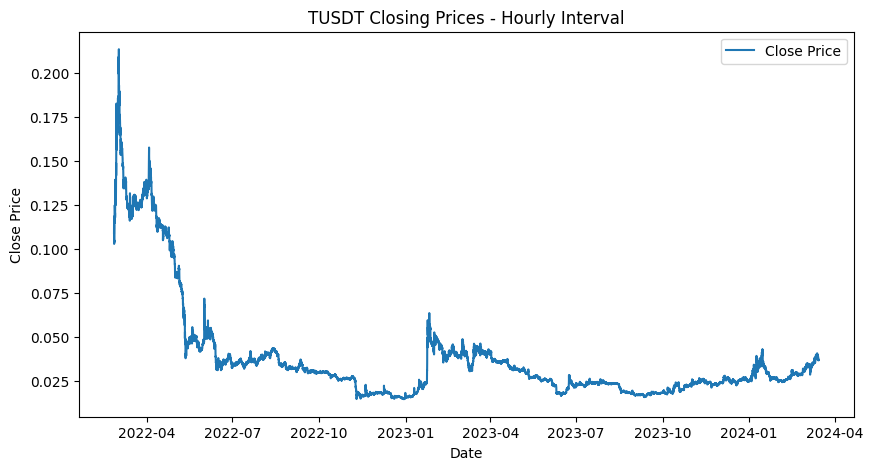

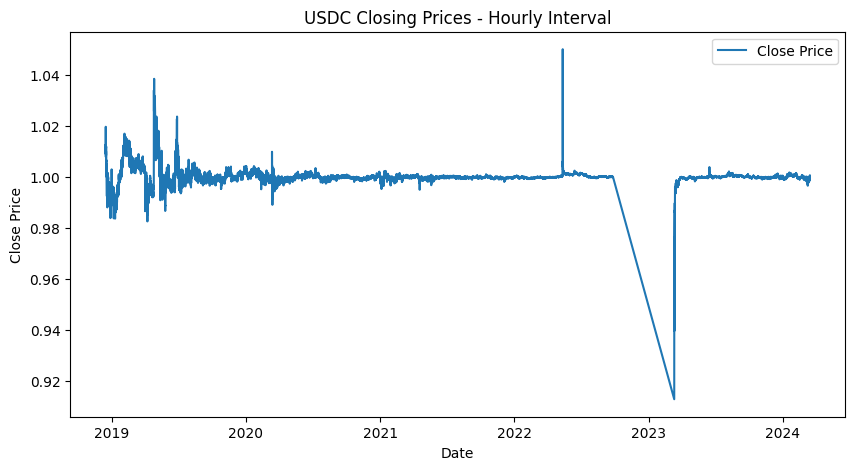

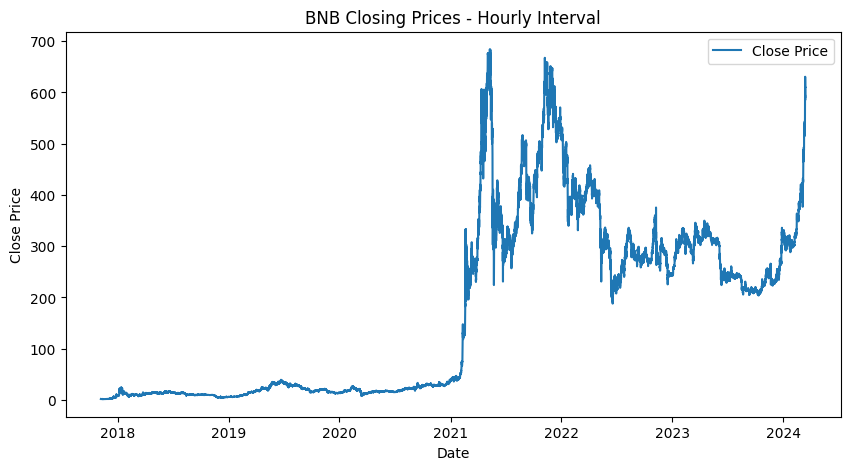

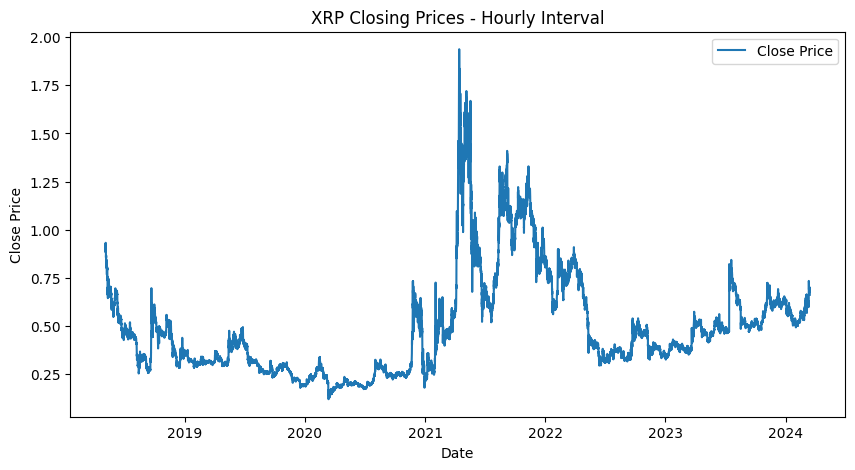

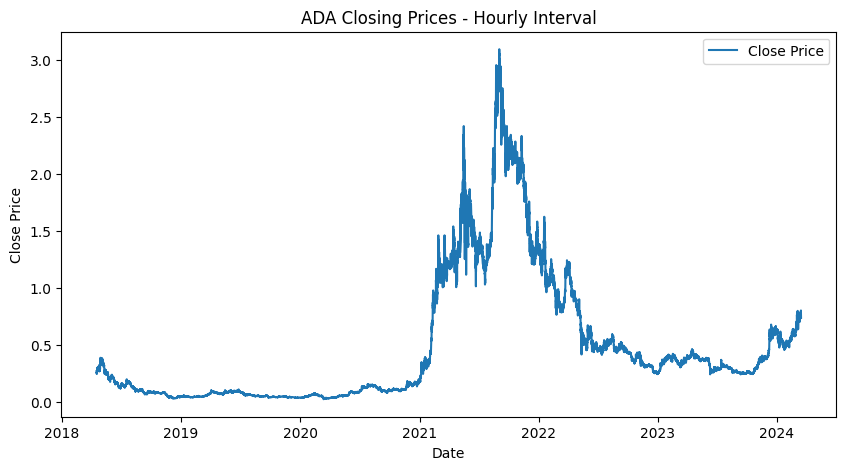

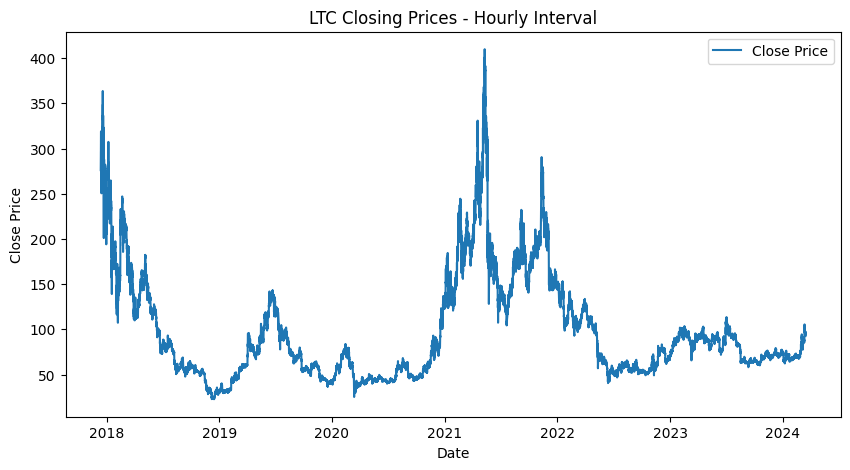

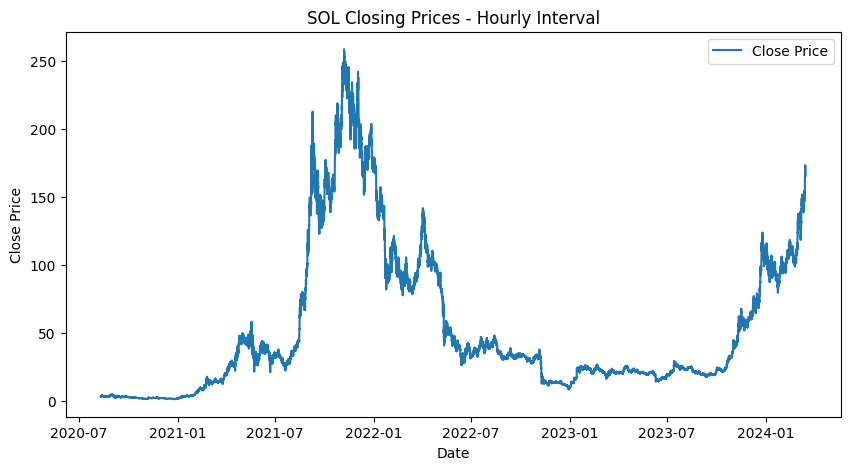

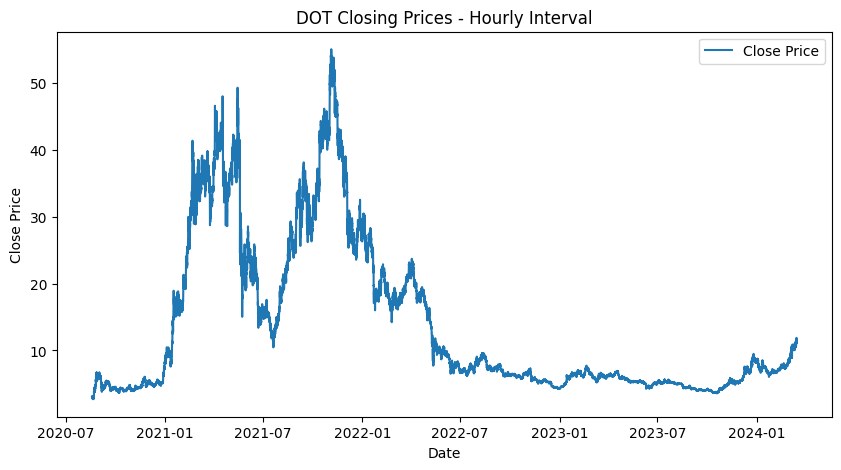


--- Time Series Plot for Closing Prices (4-Hourly Interval) ---


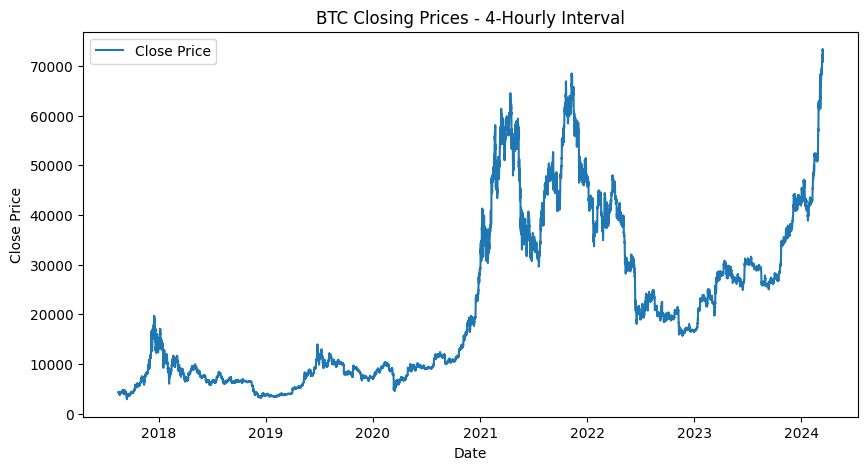

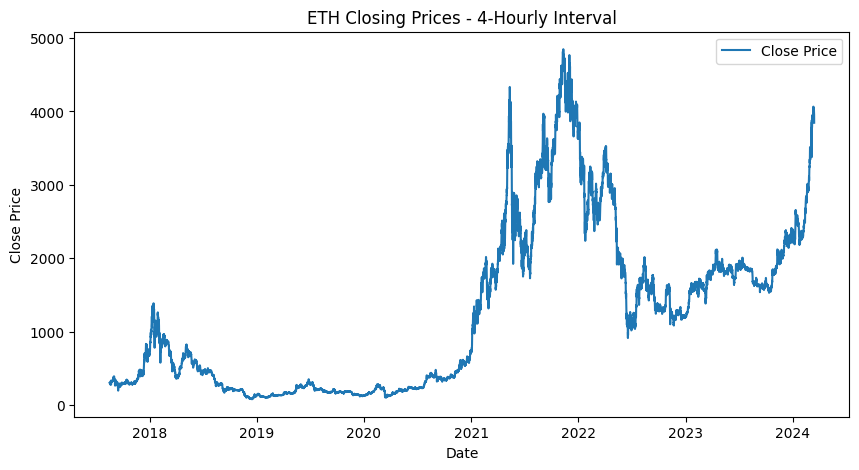

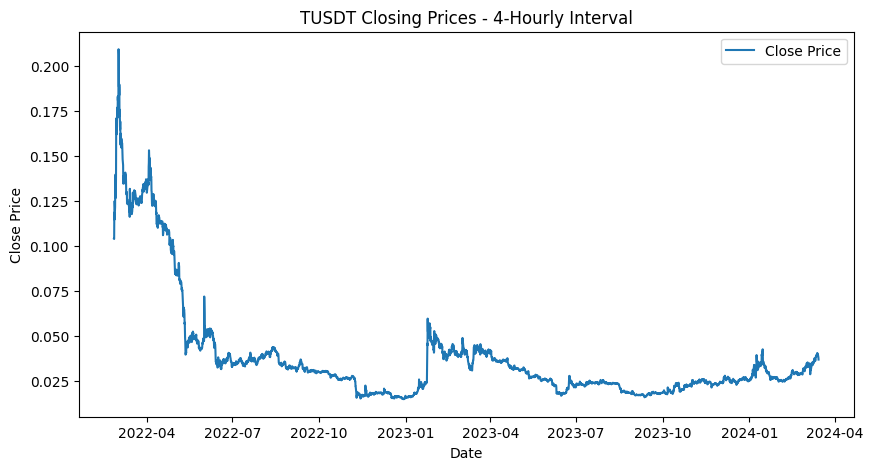

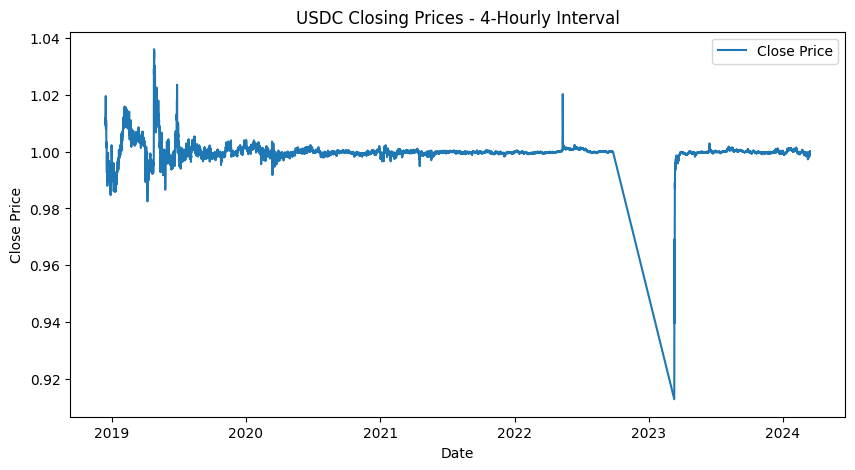

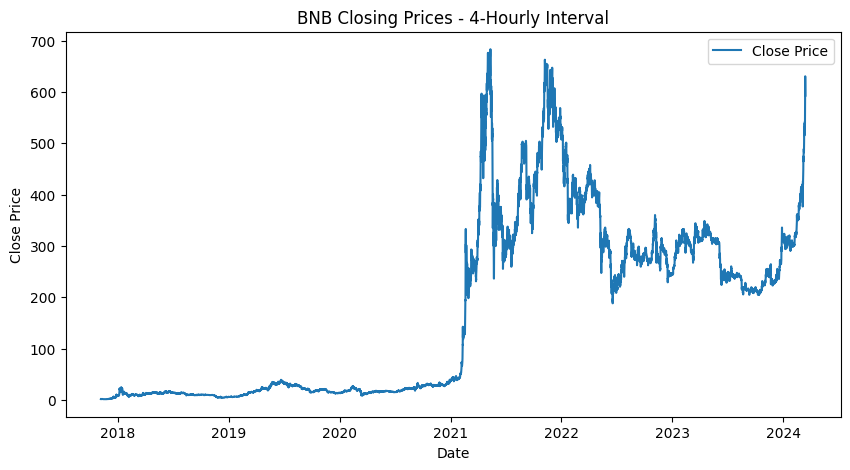

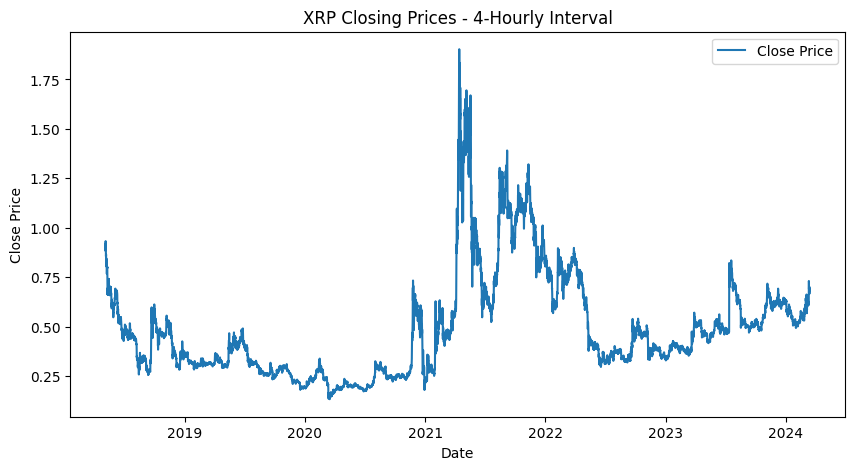

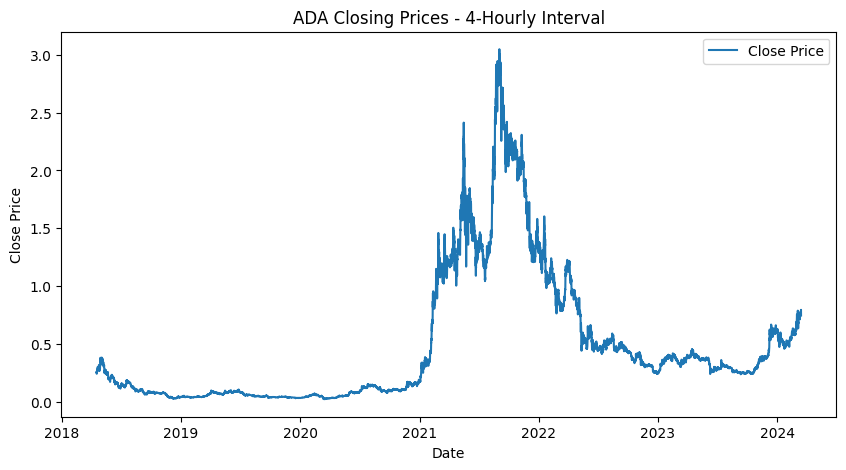

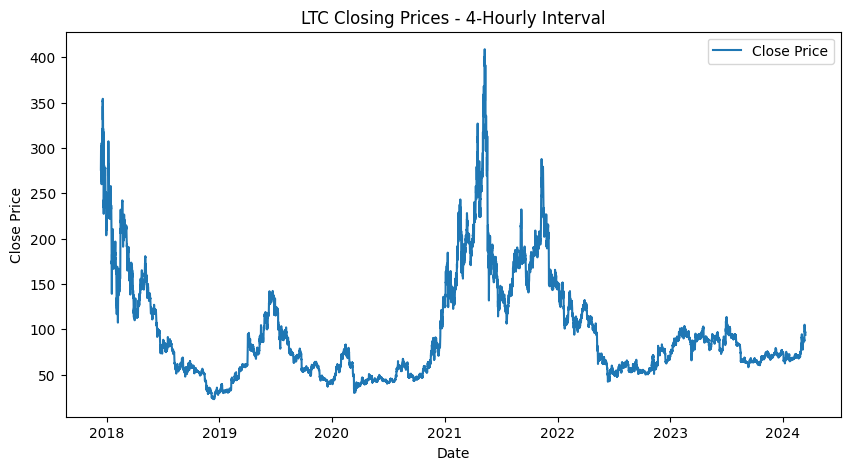

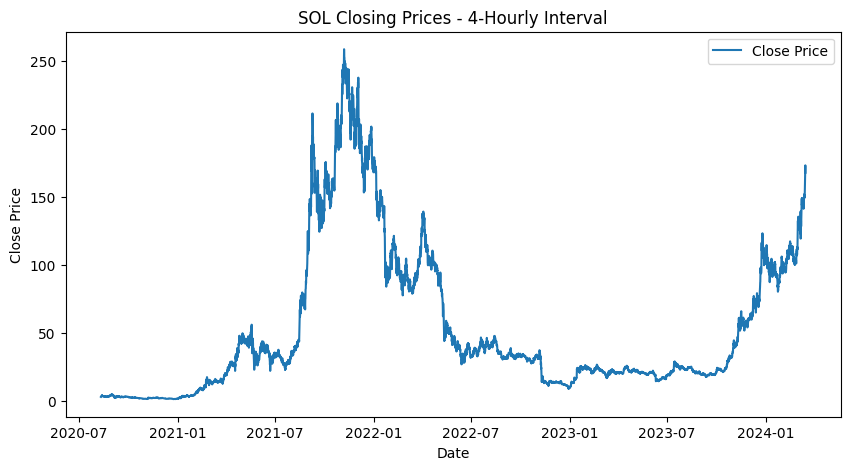

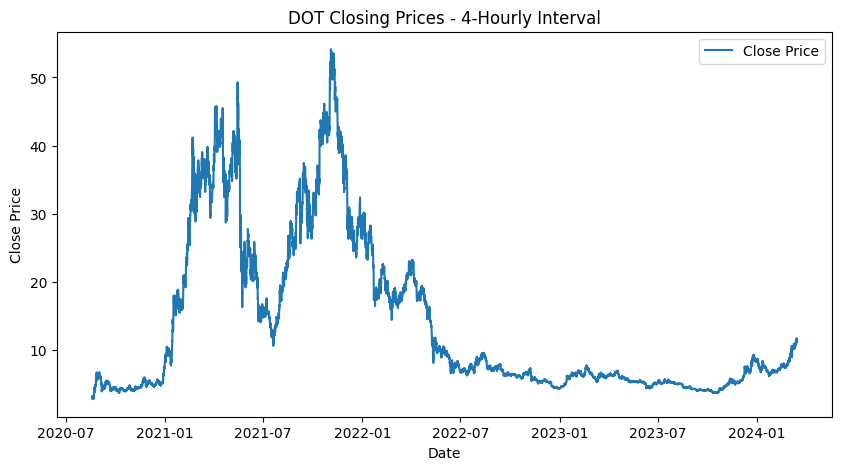


--- Time Series Plot for Closing Prices (5-Minute Interval) ---


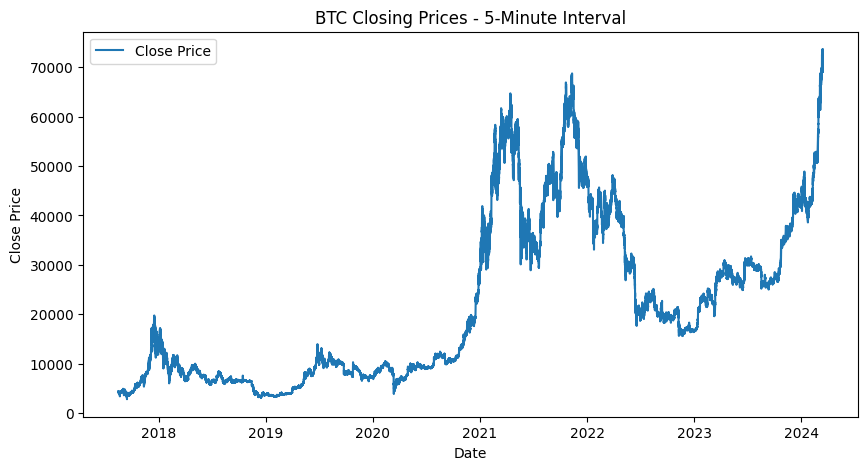

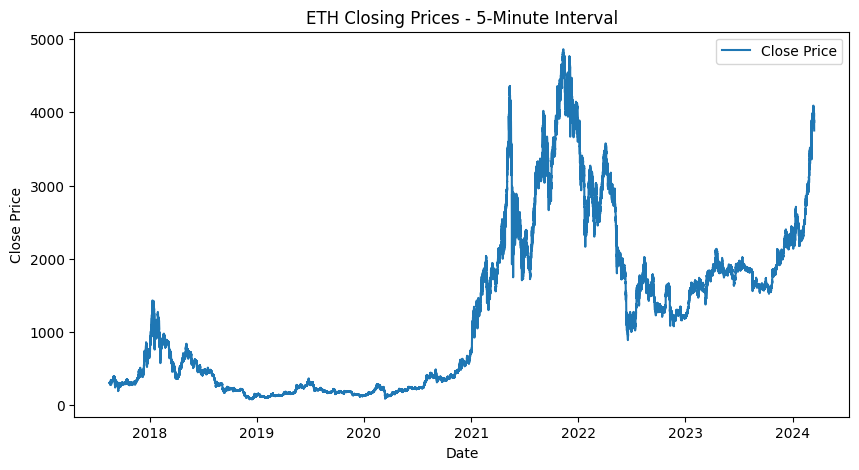

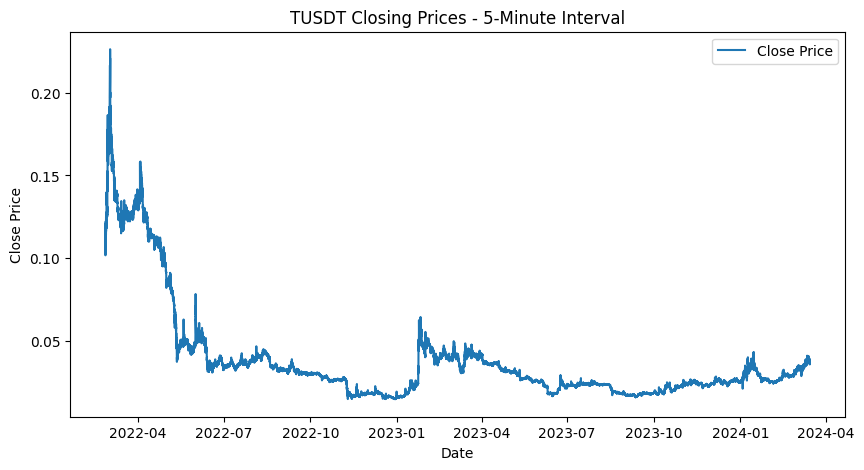

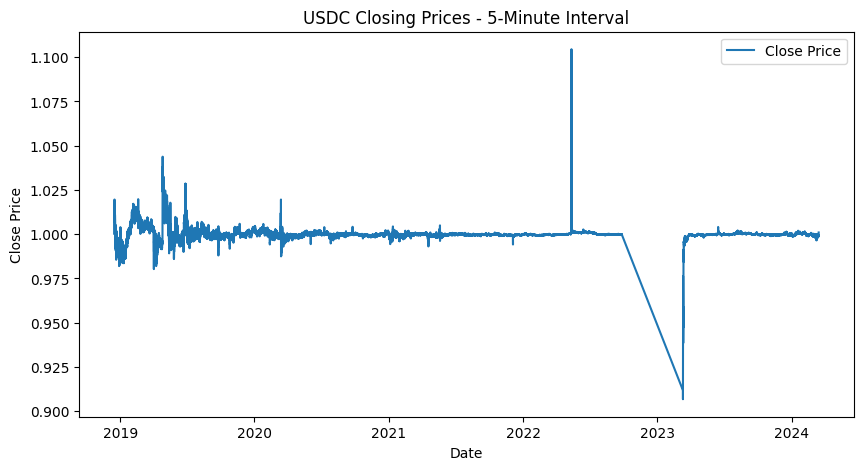

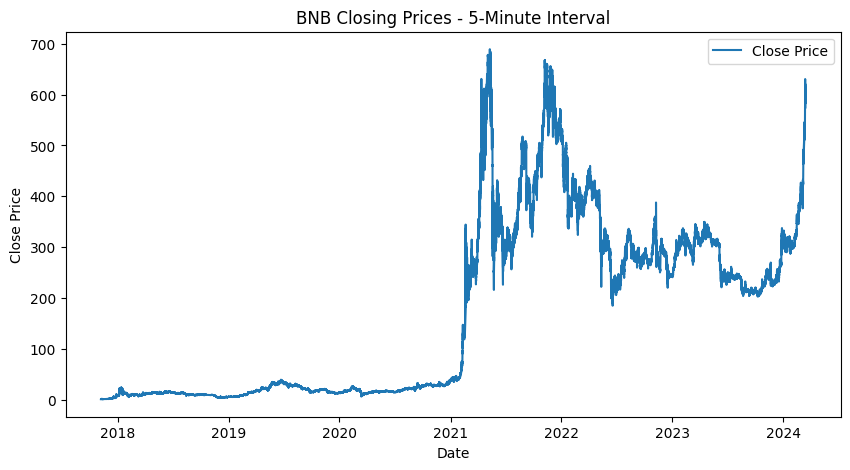

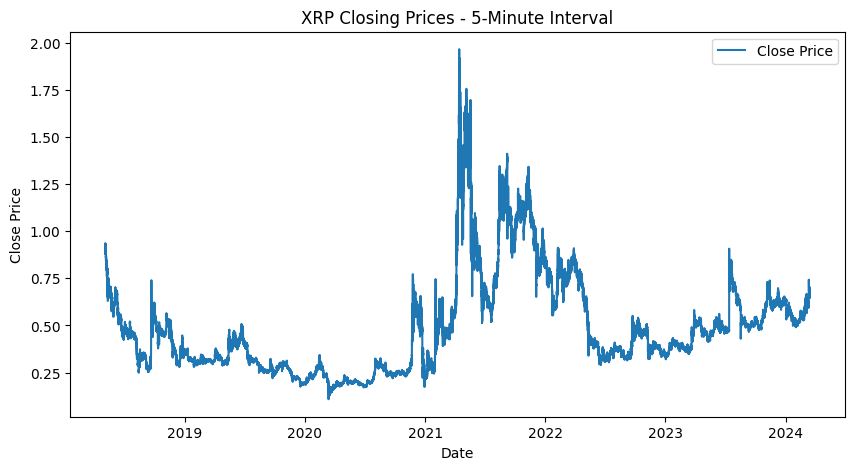

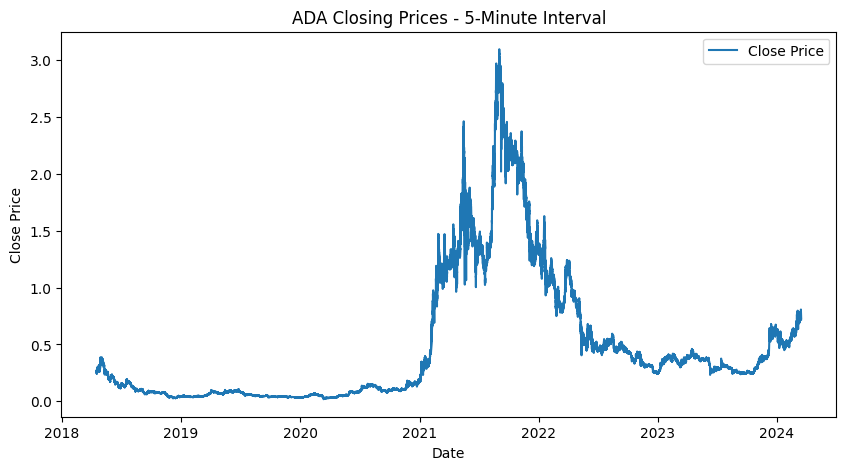

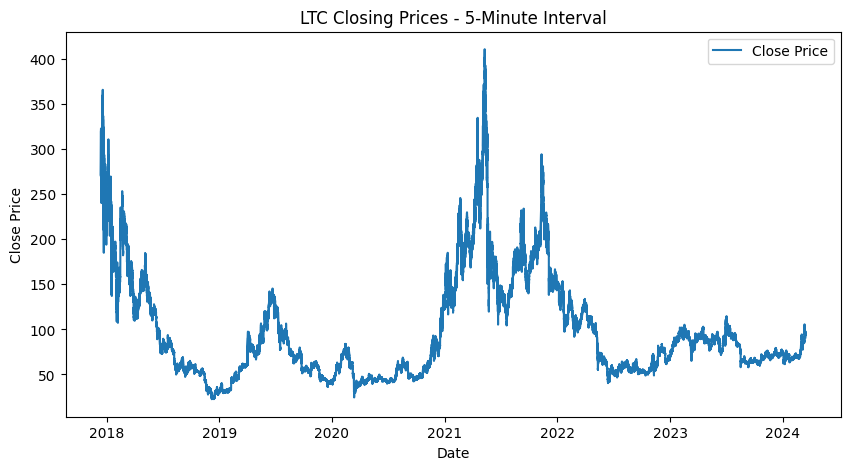

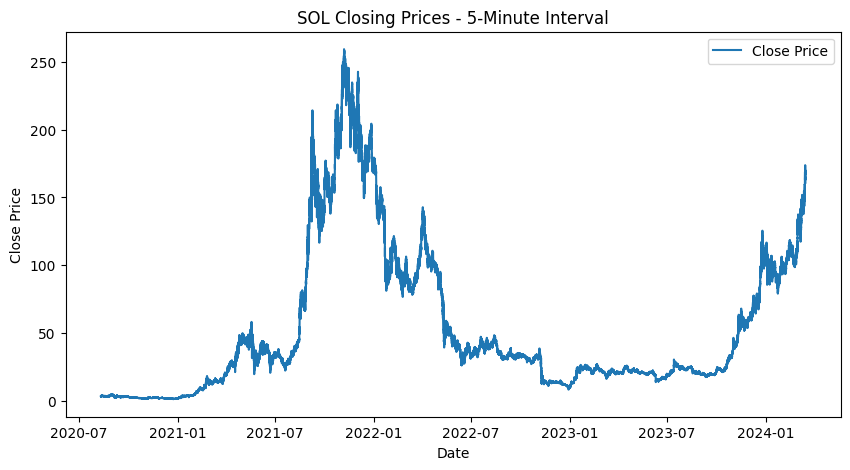

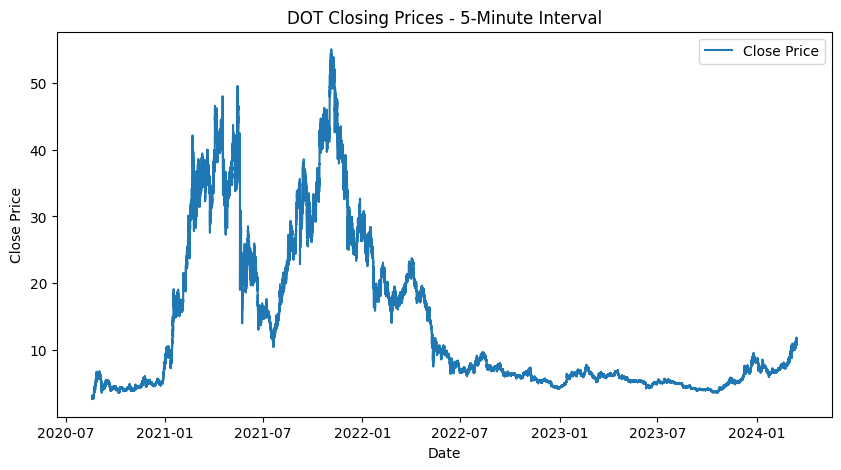


--- Time Series Plot for Closing Prices (15-Minute Interval) ---


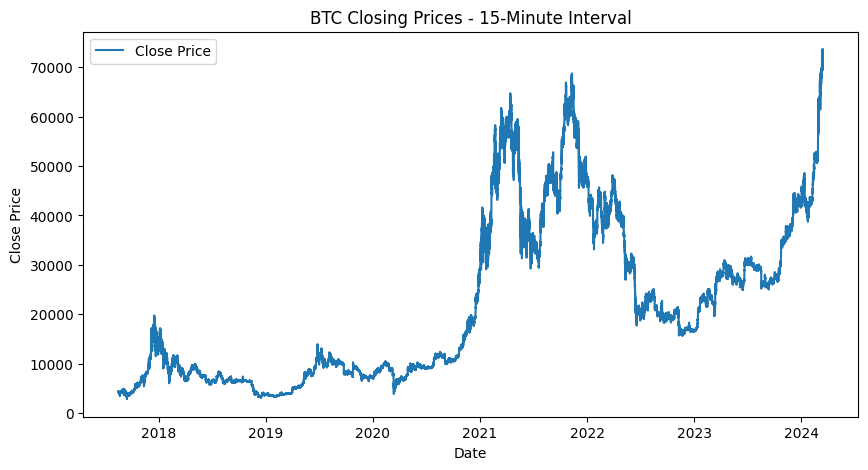

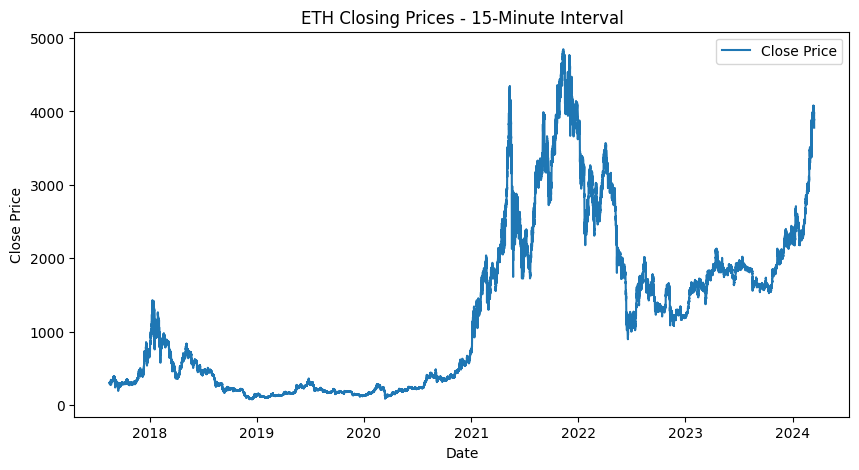

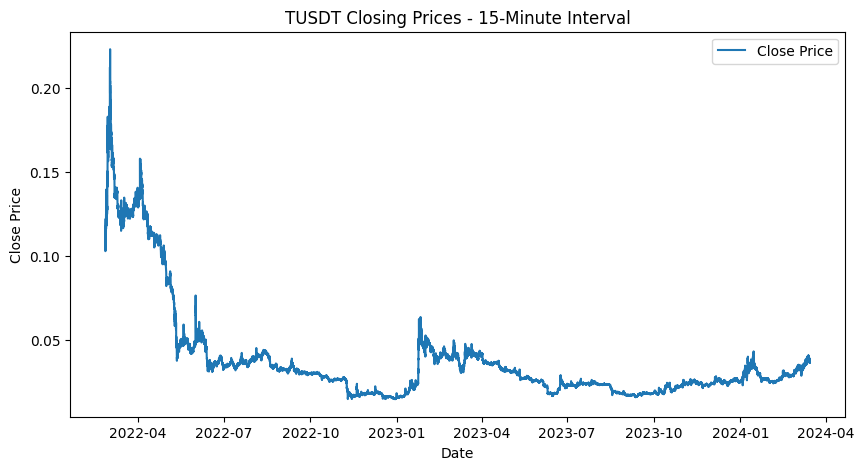

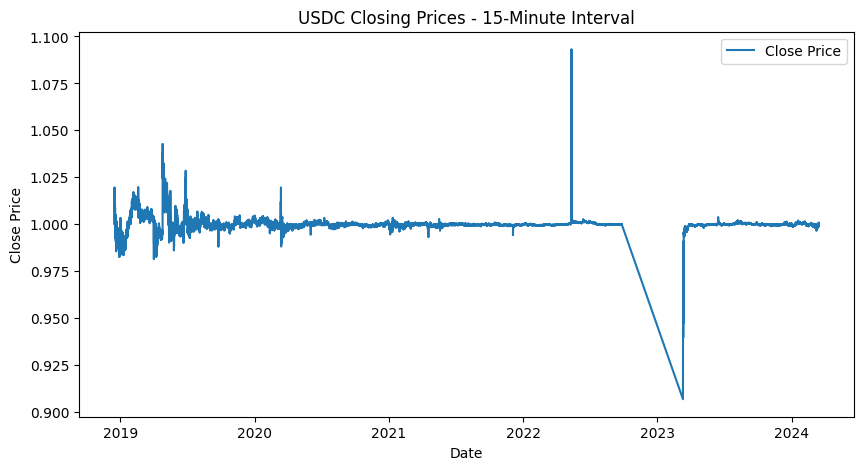

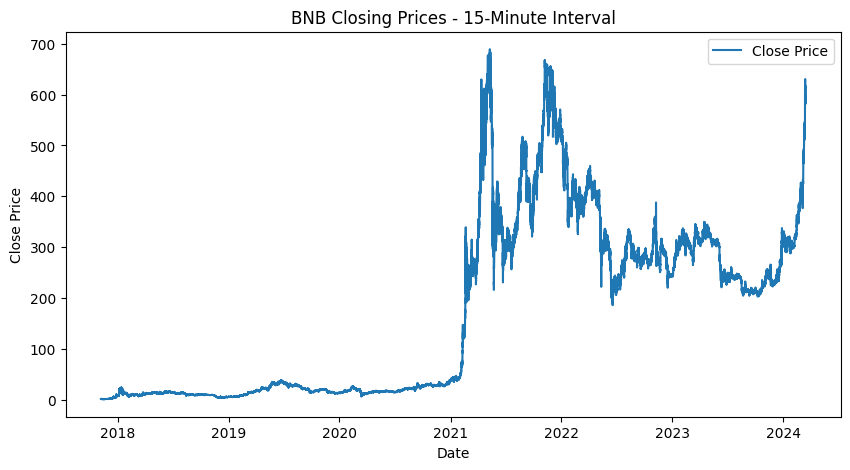

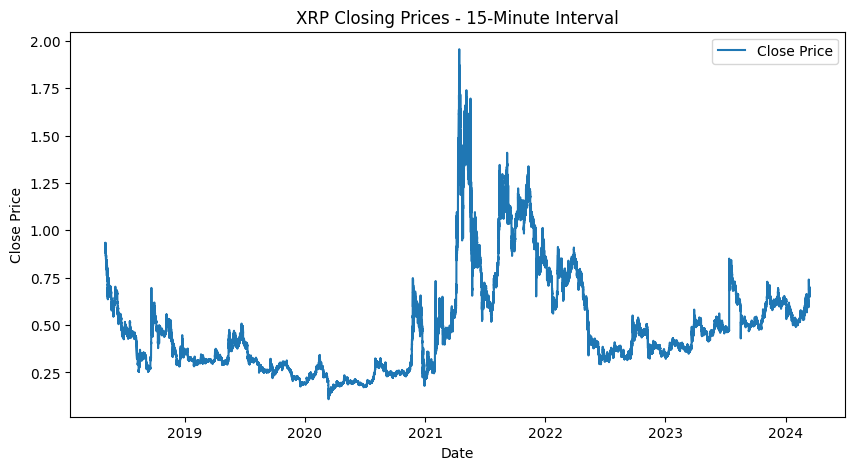

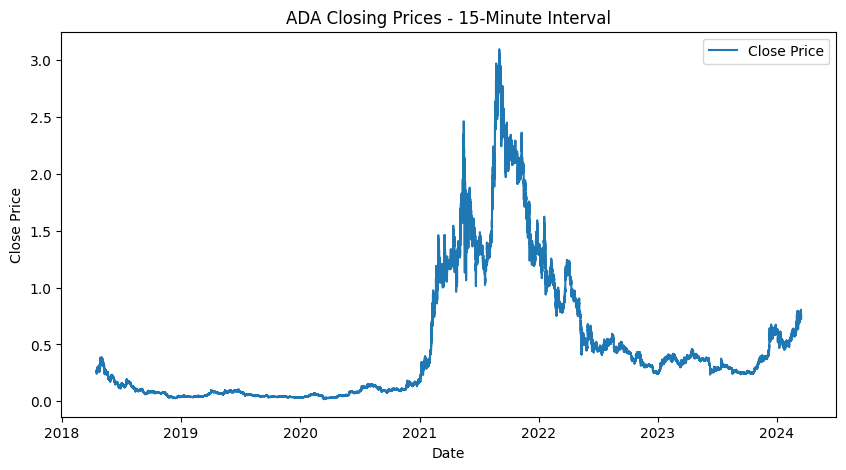

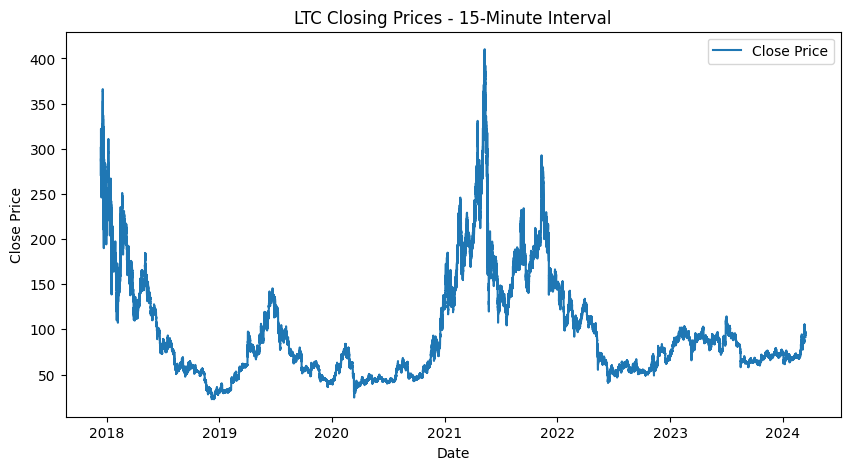

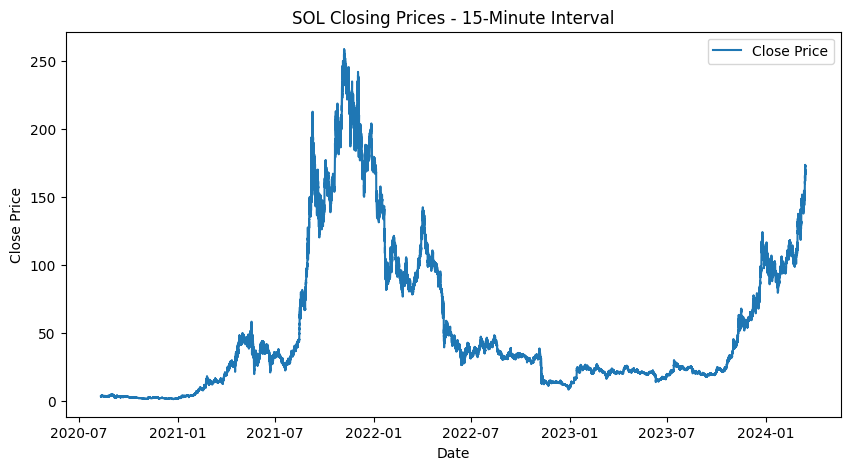

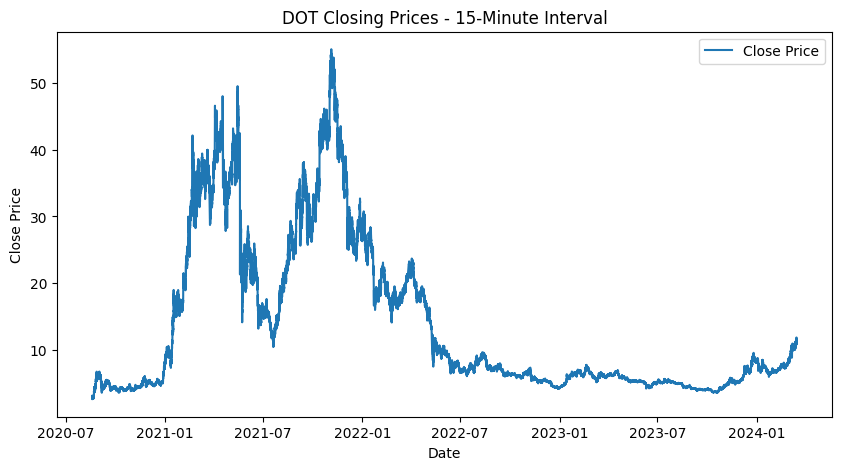


--- Time Series Plot for Closing Prices (30-Minute Interval) ---


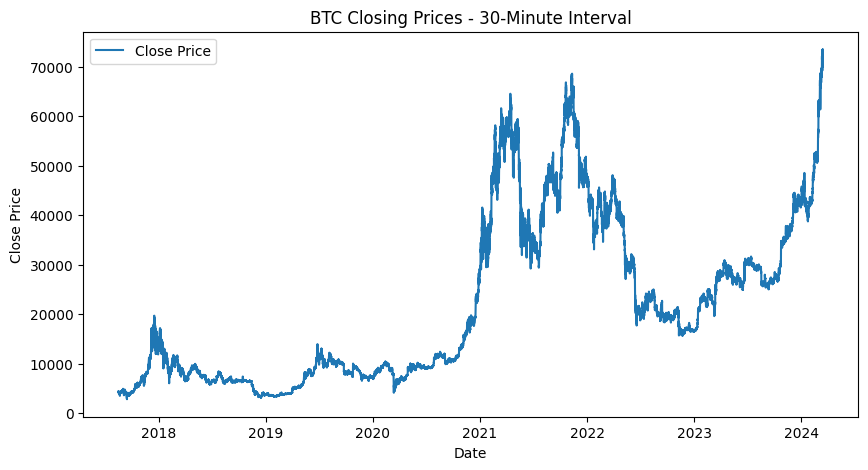

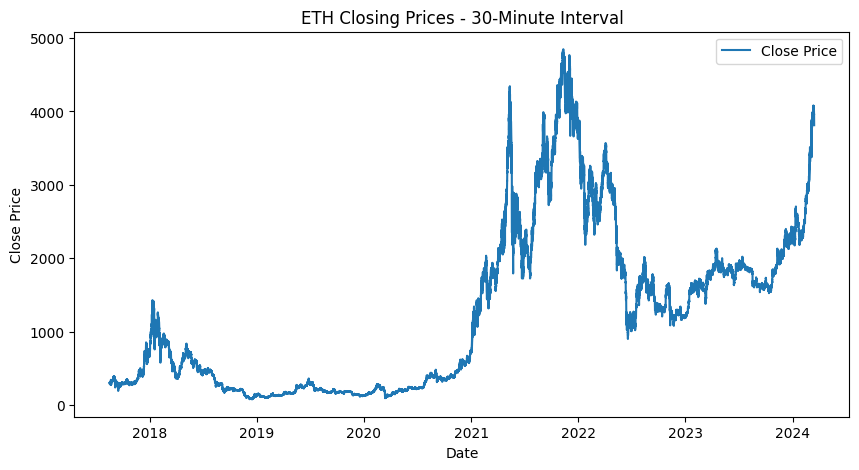

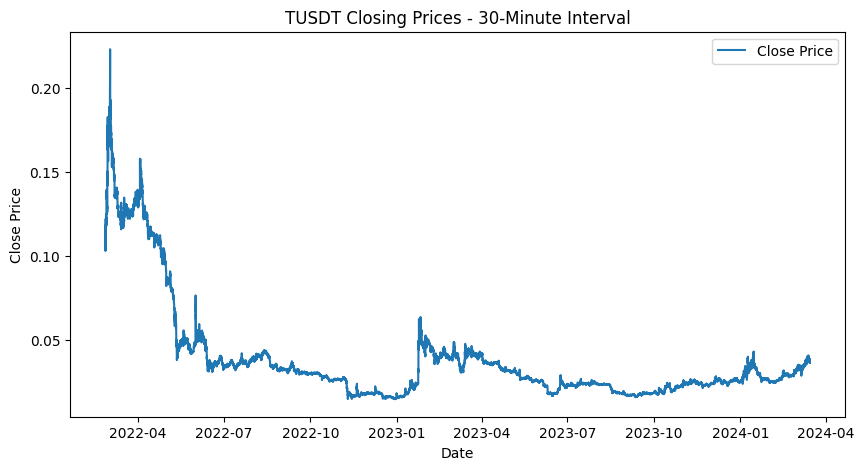

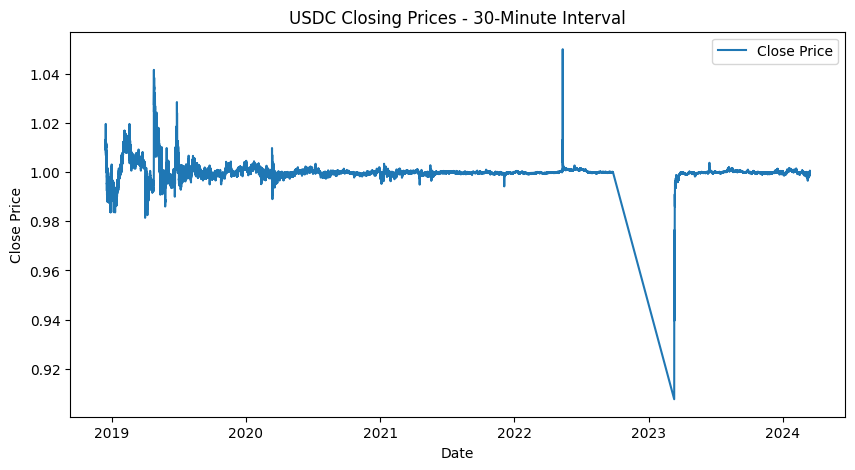

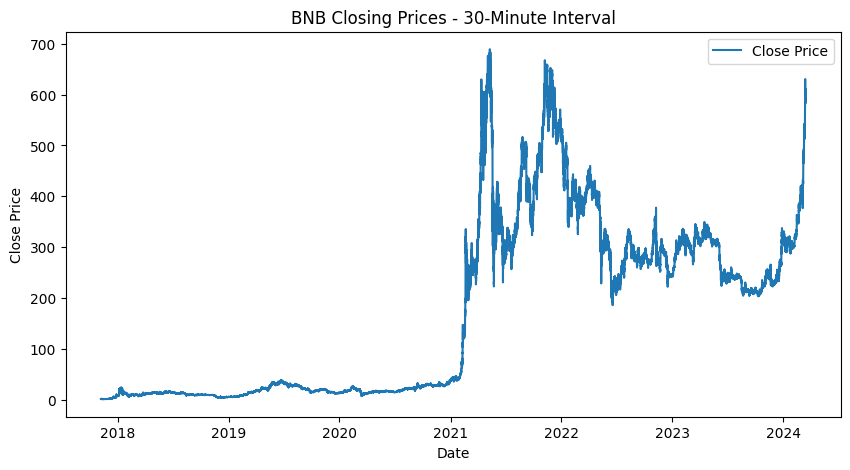

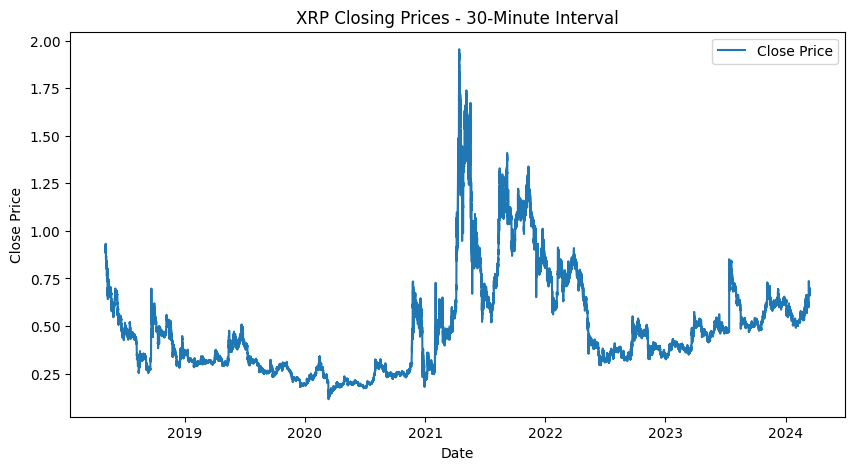

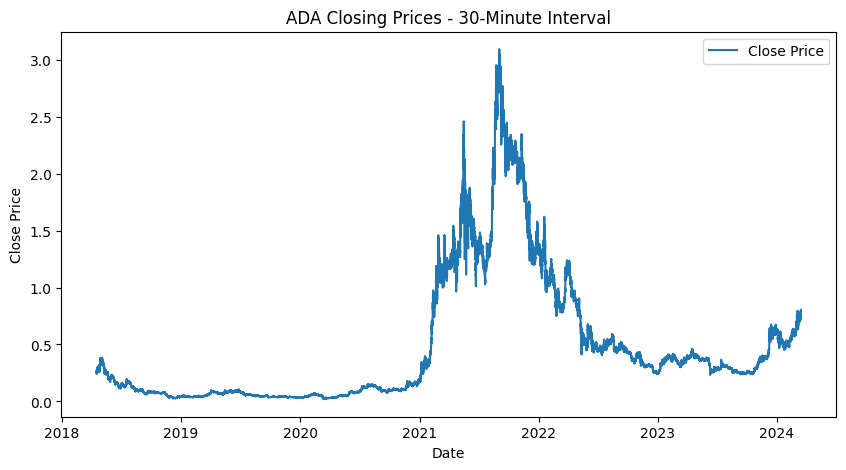

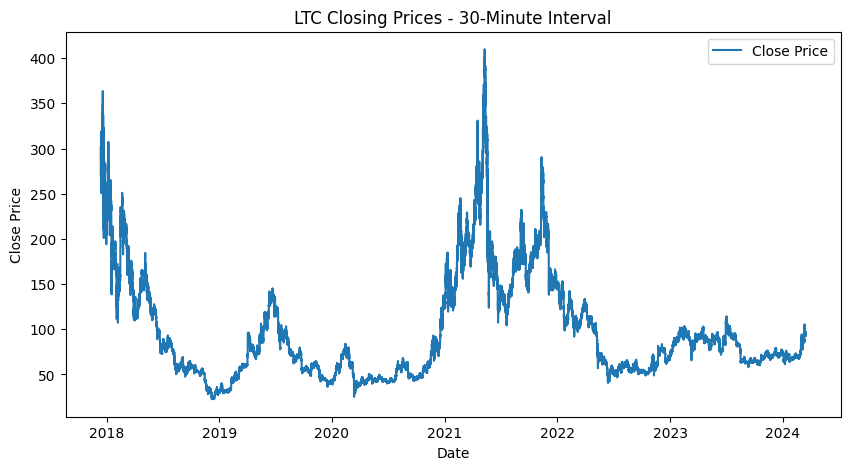

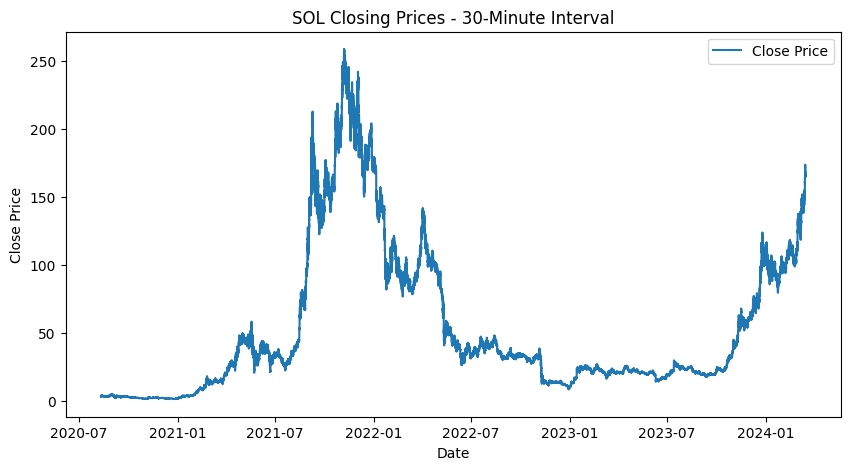

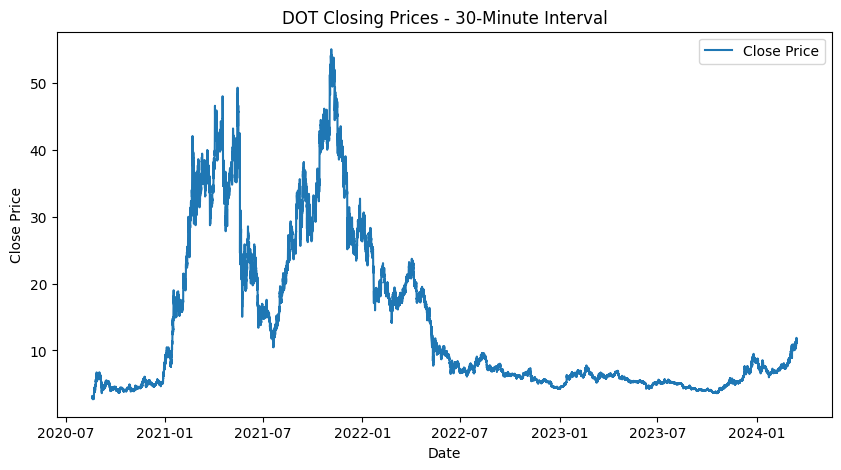


--- Time Series Plot for Closing Prices (Weekly Interval) ---


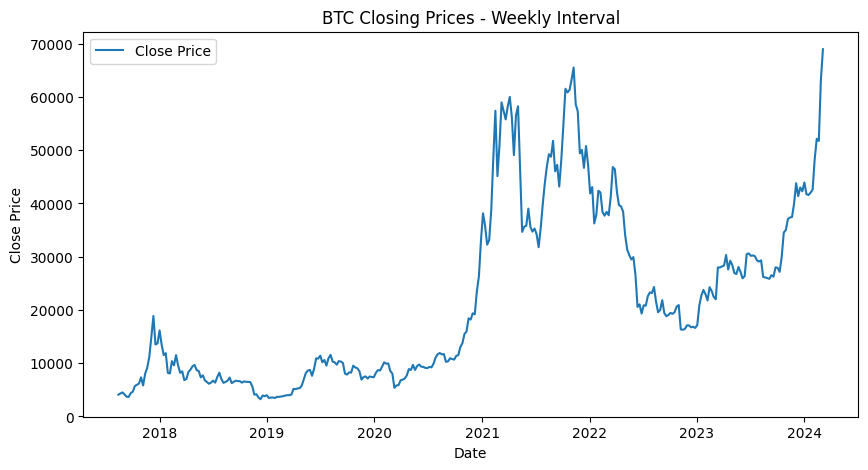

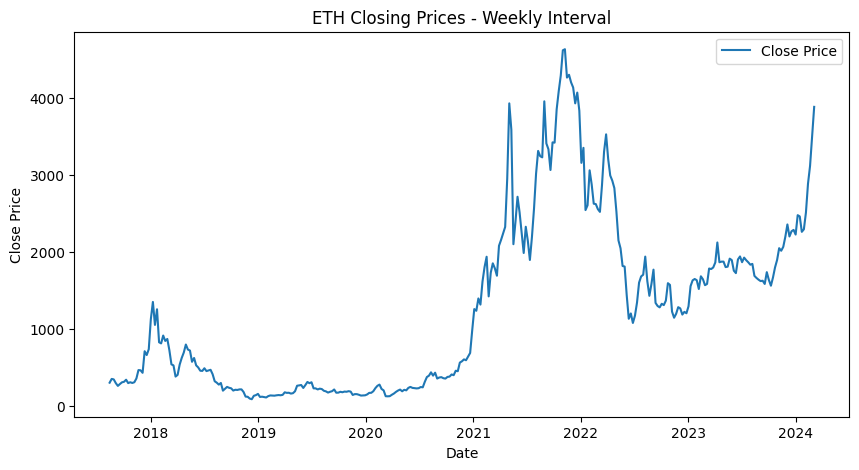

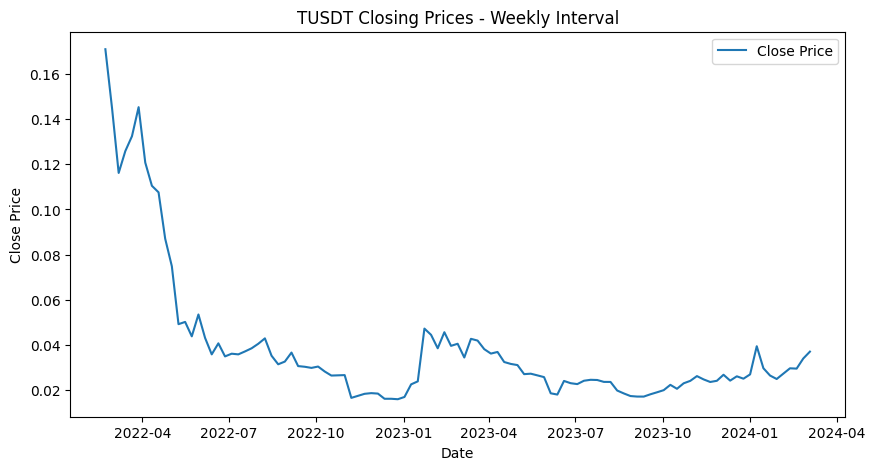

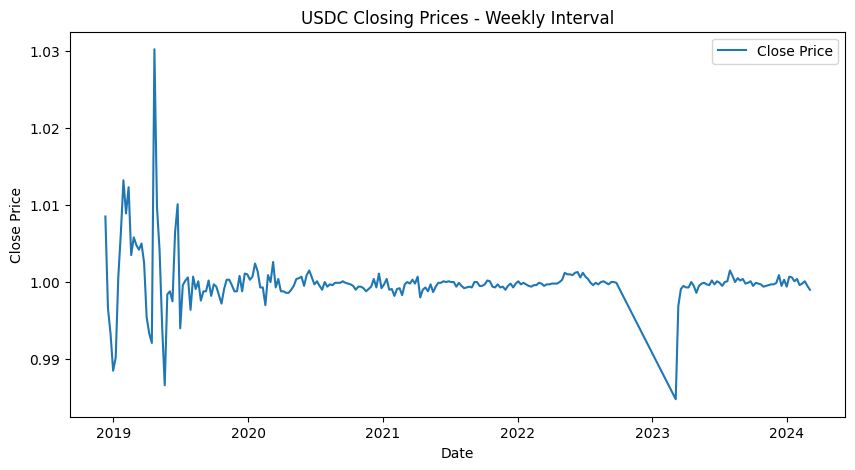

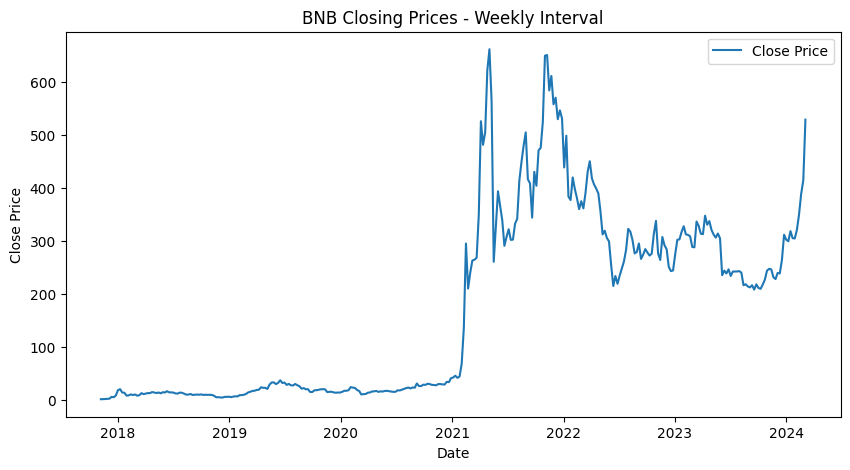

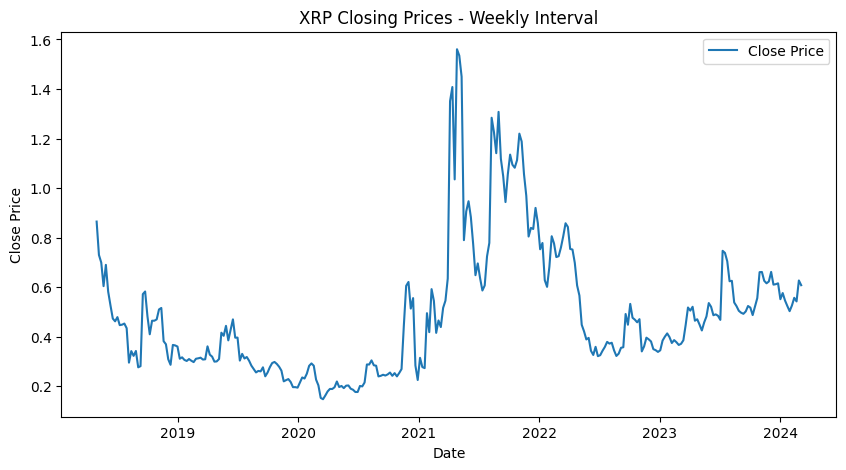

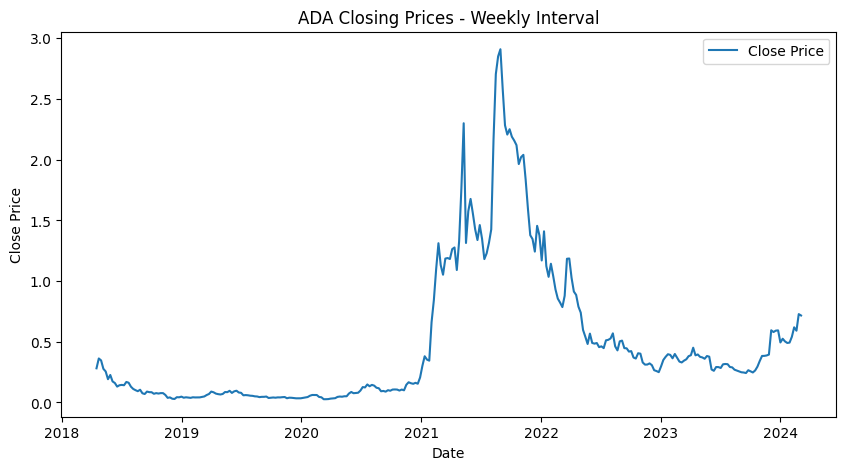

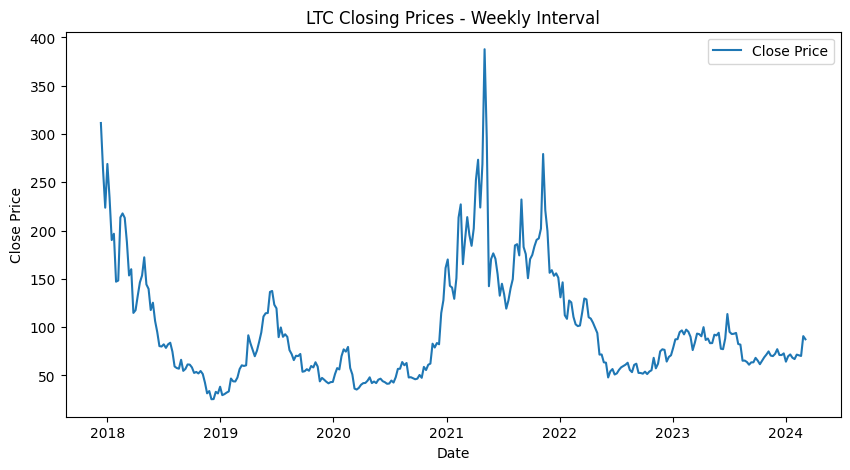

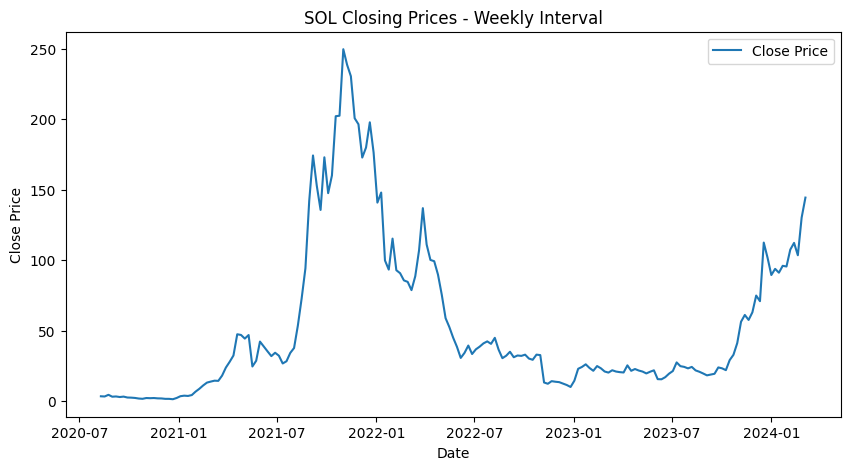

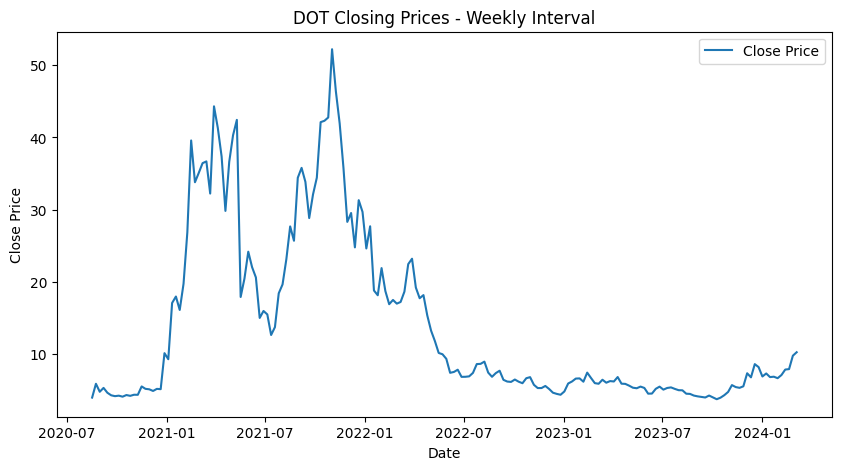

In [ ]:
# Time series plot of closing prices for each cryptocurrency by interval
for interval, folder_name in intervals.items():
    print(f"\n--- Time Series Plot for Closing Prices ({folder_name} Interval) ---")
    for crypto, data in interval_data[interval].items():
        if data.empty:
            print(f"No data for {crypto} in {folder_name} interval.")
            continue

        plt.figure(figsize=(10, 5))
        plt.plot(pd.to_datetime(data['datetime']), data['close'], label='Close Price')
        plt.title(f'{crypto} Closing Prices - {folder_name} Interval')
        plt.xlabel('Date')
        plt.ylabel('Close Price')
        plt.legend()
        plt.show()


### Conclusions based on daily closing prices of the cryptocurrencies:

1. BTC (Bitcoin): Shows significant volatility over time, with notable peaks in 2021 and 2024. This trend reflects Bitcoin’s position as a highly speculative asset with large fluctuations in price.

2. ETH (Ethereum): Similar to Bitcoin, Ethereum has exhibited high volatility, particularly around 2021. This peak likely corresponds with the increased popularity of decentralized finance (DeFi) and non-fungible tokens (NFTs) during this period.

3. Tether (TUSDT): Exhibits a stable trend with minimal fluctuations, aligning with its role as a stablecoin designed to maintain a value close to $1. However, there were brief deviations observed, which could be due to market pressures or liquidity changes.

4. USDC: Similar to Tether, USDC remains stable around $1, further reinforcing its role as a stablecoin. The limited price movements highlight its function as a stable asset in the crypto market.

5. BNB (Binance Coin): BNB shows large price fluctuations, particularly with spikes in 2021 and 2024, likely related to increased trading volumes on the Binance platform and the growing ecosystem of Binance Smart Chain.

6. XRP: XRP displays moderate volatility with peaks around 2021. It seems to follow trends related to overall market sentiment and regulatory developments that impact its value.

7. ADA (Cardano): Cardano’s price trends mirror other volatile assets with sharp increases around 2021, possibly related to network upgrades and developments within the Cardano ecosystem.

8. LTC (Litecoin): Litecoin experiences moderate volatility with peaks and troughs similar to Bitcoin, showing it’s often used as a speculative asset rather than a stable store of value.

9. SOL (Solana): Solana’s significant price fluctuations are evident, especially in 2022, corresponding with periods of network growth and DeFi adoption. However, its high volatility indicates it’s more prone to speculative price swings.

10. DOT (Polkadot): Polkadot shows price peaks in 2021, followed by a downward trend. Its price volatility may be associated with ecosystem development and adoption levels of Polkadot-based projects.




The time-series analysis of these cryptocurrencies indicates that most of them exhibit high volatility, with notable price spikes around 2021, likely driven by the overall bull market in the crypto space and specific ecosystem developments. Stablecoins like Tether (TUSDT) and USDC maintain stable price ranges, fulfilling their intended role. Other altcoins like ADA, SOL, and DOT also show similar volatility patterns to BTC and ETH but are influenced by ecosystem-specific factors. These observations highlight the speculative nature of most cryptocurrencies, with price movements driven by market sentiment, adoption trends, and broader economic factors.


-----------------------------------------X--------------------------------------




### Conclusions based on hourly closing prices of the cryptocurrencies:

1. BTC (Bitcoin):

- Significant price volatility is observed, with several prominent peaks, notably in early 2021 and late 2023, when the price surpassed 60000 dollars
and approached  $70000  respectively.
- The price shows frequent and substantial fluctuations, characteristic of Bitcoin's high volatility even in shorter intervals.
-------------------------------------------------------------------------------

2. ETH (Ethereum):

- Similar to Bitcoin, Ethereum displays considerable price spikes, especially in early 2021 and late 2023, with prices surpassing $4,000.
- The hourly data reveals high variability, indicating frequent trading and significant interest, particularly during market highs.
-------------------------------------------------------------------------------

3. TUSDT (Tether):

- Tether remains relatively stable around the $ 1 mark, with minor fluctuations that briefly deviate from the 1 dollar peg.
- This stability highlights Tether's role as a stablecoin, with brief spikes likely due to market liquidity events or anomalies.
-------------------------------------------------------------------------------
4. USDC (USD Coin):

- USDC also demonstrates a stable price pattern around $1, with a few outlier dips and spikes (especially around mid-2022 and early 2023), which may be due to liquidity issues or market stress.
- The consistency of USDC's price further reflects its stability in the market.
-------------------------------------------------------------------------------
5. BNB (Binance Coin):

- The hourly chart for BNB shows large fluctuations, particularly in 2021 when it rose sharply, reaching over $600.
- BNB demonstrates high volatility, often responding to Binance-related news and market conditions.
-------------------------------------------------------------------------------
6. XRP (Ripple):

- XRP shows significant price variability, with spikes in early 2021 and smaller fluctuations over time.
- The chart reflects XRP's speculative nature, with frequent price jumps and dips in response to regulatory and market news.
-------------------------------------------------------------------------------
7. ADA (Cardano):

- Cardano's price peaked in early 2021 and then tapered off, with smaller fluctuations visible in the hourly data.
- The chart suggests steady trading activity with moderate volatility and interest at specific time points.
-------------------------------------------------------------------------------
8. LTC (Litecoin):

- Litecoin's hourly chart shows multiple spikes, aligning with broader market trends, particularly in early 2021.
- The price fluctuates widely, indicating speculative trading and periodic interest in the asset.
-------------------------------------------------------------------------------

9. SOL (Solana):

- Solana’s price shows a rapid rise and peak around mid-2021, followed by a decline and subsequent spikes.
- The chart illustrates Solana's high trading volume during these periods, often coinciding with blockchain adoption phases.
-------------------------------------------------------------------------------
10. DOT (Polkadot):

- Polkadot’s price exhibits substantial fluctuations, with notable peaks in 2021.
- The hourly data reflects a volatile asset, with price trends influenced by project updates and market sentiment.
-------------------------------------------------------------------------------
### General Observations:
1. High Volatility: Bitcoin, Ethereum, and Binance Coin exhibit high volatility, with prices fluctuating significantly even within hourly intervals, reflecting the speculative nature of these assets.

2. Stablecoins: Tether (TUSDT) and USDC maintain a relatively stable price around $1, with minor fluctuations, showcasing their role as stable assets.
Speculative Altcoins: Assets like XRP, ADA, and DOT display moderate to high volatility, with periodic spikes reflecting market interest and trading activity.

3. Market Peaks: Most cryptocurrencies show peaks around early to mid-2021, aligning with a general market uptrend in that period.
These hourly interval observations highlight both the stability of some assets (like stablecoins) and the high volatility of others, indicating varied investor behavior and market dynamics across different cryptocurrencies.


-----------------------------------------X--------------------------------------

### Conclusions based on 4-hourly closing prices of the cryptocurrencies:

1. BTC (Bitcoin)
- Trend: Bitcoin shows significant volatility, with two major peaks in 2021 and early 2024, reaching close to $70,000.
- Behavior: Volatile movements are consistent over time, with a clear upward trend during bullish periods.

------------------------------------------------------------------------------
2. ETH (Ethereum)

- Trend: Ethereum follows a similar pattern to Bitcoin with peaks in 2021 and 2024, reaching over $4,000.
- Behavior: Consistent volatility, indicating high trading activity and investor interest during market upswings.

------------------------------------------------------------------------------

3. TUSDT (Tether)

- Trend: Tether maintains stability around $0.03 with minor fluctuations.
- Behavior: Primarily stable with short spikes, suggesting its use as a stablecoin and reserve currency.

------------------------------------------------------------------------------

4. USDC (USD Coin)

- Trend: USDC shows stability around $1, with minimal deviation, except for a few drops and a single spike.
- Behavior: Acts as a stablecoin, with occasional deviations possibly due to market events or liquidity issues.


------------------------------------------------------------------------------


5. BNB (Binance Coin)

- Trend: Binance Coin has substantial growth, with peaks in 2021 and 2024 reaching above $600.
- Behavior: Volatile yet generally upward, mirroring major crypto market trends.

------------------------------------------------------------------------------

6. XRP (Ripple)

- Trend: XRP experiences volatility, with a major spike in 2021 above $1.75, reflecting market cycles.
- Behavior: Shows less stability compared to stablecoins, with cycles of high volatility.

------------------------------------------------------------------------------

7. ADA (Cardano)

- Trend: Cardano shows sharp spikes, especially in 2021, reaching around $3, then stabilizing.
- Behavior: Volatile, reflecting interest in new blockchain projects but stabilizing during market consolidations.

------------------------------------------------------------------------------

8. LTC (Litecoin)

- Trend: Litecoin has a steady upward trajectory with spikes, especially in 2021, reaching around $400.
- Behavior: Maintains consistent volatility, following broader market movements.

------------------------------------------------------------------------------

9. SOL (Solana)

- Trend: Solana peaked in 2022 with prices above $250 but faced significant drops afterward.
- Behavior: Shows high volatility, reflecting its emerging status in the blockchain ecosystem.

------------------------------------------------------------------------------

10. DOT (Polkadot)

- Trend: Polkadot showed significant activity in 2021, peaking above $50 but has since trended lower.
- Behavior: High volatility with significant price corrections, typical for newer blockchain projects.


-------------------------------------\\------------------------------------------


Overall, the 4-hourly interval provides a more granular view of the volatility and trading patterns for each cryptocurrency, with most coins experiencing peaks around major market events and then returning to stable levels or following broader market trends. Stablecoins like USDC and TUSDT display expected stability, while assets like BTC, ETH, and BNB exhibit high volatility in sync with the overall market sentiment.


-----------------------------------------X--------------------------------------



### Conclusions based on 5-minute closing prices of the cryptocurrencies:


1. BTC: Bitcoin's 5-minute interval data shows high volatility, reflecting rapid price fluctuations. The trend highlights significant price spikes and dips around 2021 and early 2024, aligning with major market events.
-------------------------------------------------------------------------------

2. ETH: Ethereum’s 5-minute closing prices also exhibit high volatility. The 2021 bull market is visible with a sharp peak, followed by periods of decline and subsequent recovery. Price variations in 2024 suggest renewed interest or increased volatility.

-------------------------------------------------------------------------------

3. TUSDT: Tether’s prices remain relatively stable, with minor fluctuations around $0.025 to $0.05. This stability is expected due to its nature as a stablecoin, pegged closely to the dollar.

-------------------------------------------------------------------------------

4. USDC: Similar to Tether, USDC maintains stability, generally close to $1, but with a few isolated drops, particularly in early 2023, potentially reflecting brief market instability.

--------------------------------------------------------------------------------

5. BNB: Binance Coin’s price trend reveals strong growth around 2021 and increased activity in 2024. The 5-minute data shows BNB's susceptibility to market trends with notable volatility at peak periods.

--------------------------------------------------------------------------------

6. XRP: Ripple’s price pattern has noticeable volatility spikes, especially in 2021 and 2024. While not as extreme as BTC or ETH, XRP shows significant fluctuations in response to market conditions.

--------------------------------------------------------------------------------

7. ADA: Cardano follows a similar trend to other major cryptocurrencies, with price spikes in 2021, a decline, and gradual recovery towards 2024. The 5-minute interval highlights its sensitivity to market changes.

--------------------------------------------------------------------------------

8. LTC: Litecoin demonstrates regular volatility, with large spikes around 2021, reflecting its response to broader market conditions. The price trend is less volatile than BTC but still responsive to major events.

--------------------------------------------------------------------------------

9. SOL: Solana’s price trend is marked by a dramatic rise in 2021, followed by a steady decline, and a recent upward trend in 2024, suggesting increased market activity. The 5-minute interval reflects its volatile nature.

--------------------------------------------------------------------------------

10. DOT: Polkadot’s trend shows significant price fluctuations, with prominent peaks in 2021 and a revival in 2024. This pattern is indicative of the market’s cyclic nature, with DOT responding dynamically to market trends.


-----------------------------\\------------------------------------

In summary, the 5-minute interval data allows for a granular view of each cryptocurrency's volatility. Major coins like BTC, ETH, and BNB show substantial sensitivity to market conditions, while stablecoins like TUSDT and USDC maintain steady prices with minimal fluctuations.

-----------------------------------------X--------------------------------------

### Conclusions based on 15-minute closing prices of the cryptocurrencies:

1. BTC (Bitcoin): BTC exhibits high volatility with sharp increases and decreases over the years. It reached its peak in late 2021 and experienced significant corrections afterward. Recent trends show another upward movement towards the end of the timeframe.

--------------------------------------------------------------------------------

2. ETH (Ethereum): Similar to BTC, ETH displays substantial fluctuations. It also peaked around the same time as BTC and has shown increased volatility since then, with gradual upward trends in the recent period.

--------------------------------------------------------------------------------

3. TUSDT (Tether USD): TUSDT maintains a relatively stable price due to its stablecoin nature, although it had some deviations in early 2022. The price oscillates around a consistent level, showing its pegged stability.


--------------------------------------------------------------------------------

4. USDC (USD Coin): USDC also shows price stability as a stablecoin, with minimal fluctuations around $1, apart from some temporary outliers in early 2022 and 2023. This reaffirms its purpose as a stable asset.

--------------------------------------------------------------------------------

5. BNB (Binance Coin): BNB has experienced steady growth, with significant volatility around 2021. There is a noticeable peak followed by price corrections, with recent trends showing another upward move.

--------------------------------------------------------------------------------

6. XRP (Ripple): XRP's price shows consistent fluctuations with sharp peaks in 2021. The price has remained relatively stable afterward with minor volatility, reflecting ongoing market adjustments.

--------------------------------------------------------------------------------


7. ADA (Cardano): ADA displays a significant spike around 2021, followed by a prolonged period of decline. However, recent trends indicate a slight increase, suggesting a potential upward movement.


--------------------------------------------------------------------------------

8. LTC (Litecoin): LTC has notable peaks around 2021, followed by price corrections. It exhibits periodic fluctuations with recent trends showing minor increases, maintaining a cyclical pattern.

--------------------------------------------------------------------------------

9. SOL (Solana): SOL had substantial growth in 2021, reaching a high peak. After a period of decline, it shows signs of recovery with increased prices towards the end of the timeframe.

--------------------------------------------------------------------------------

10. DOT (Polkadot): DOT experienced high volatility with a peak around 2021. It underwent a steady decline but shows recent upward momentum, indicating possible recovery.

---------------------------------\\-----------------------------

In summary, the 15-minute interval analysis reveals significant price movements for most assets, especially around the 2021 period. Stablecoins (TUSDT and USDC) maintain stability as expected, while other assets exhibit cyclical and volatile trends, with recent upticks suggesting renewed interest in cryptocurrencies.


-----------------------------------------X--------------------------------------





### Conclusions based on 30-minute closing prices of the cryptocurrencies:


1. BTC (Bitcoin): The BTC closing prices continue to display significant volatility over time, with a pronounced peak in late 2021, followed by a drop and recovery in recent months. The recent trend shows an upward movement, reflecting current market interest and possible demand increase.


--------------------------------------------------------------------------------


2. ETH (Ethereum): Similar to BTC, ETH's prices exhibit high volatility with peaks around the same periods as Bitcoin. ETH also reached significant highs in 2021, followed by declines and a gradual upward trend toward 2024, indicating similar market behavior to Bitcoin.

--------------------------------------------------------------------------------


3. TUSDT (Tether): Tether shows typical stablecoin behavior, maintaining a low and steady price with minimal fluctuations. The small variations represent short-term shifts, with stability as the primary trend.

--------------------------------------------------------------------------------

4. USDC (USD Coin): Like Tether, USDC maintains a stable price around $1,
   with minor fluctuations and occasional deviations. This stability reflects its function as a stablecoin, with only rare and brief drops below the
   1 dollar mark.


--------------------------------------------------------------------------------


5. BNB (Binance Coin): BNB displays significant price variation, mirroring broader market trends with a peak in 2021 and a general recovery trend afterward. Its recent price surge suggests increased trading interest and utility within the Binance ecosystem.


-------------------------------------------------------------------------------

6. XRP (Ripple): Ripple's price trends show a peak in 2021, similar to other cryptocurrencies, followed by fluctuations and a stable range between $0.25 and
 0.75. The limited recent uptrend may indicate a return of interest or specific market movements around XRP.


 -------------------------------------------------------------------------------


 7. ADA (Cardano):Cardano follows a similar trend to BTC and ETH, with notable volatility and peaks around 2021. Prices have since stabilized at a lower range, reflecting a possible consolidation phase for the asset.


 -------------------------------------------------------------------------------

 8. LTC (Litecoin):  Litecoin's prices exhibit cyclical highs and lows, with pronounced peaks in 2021. The prices remain within a range, with smaller fluctuations recently, indicating a relatively stable trend following major volatility.

-------------------------------------------------------------------------------

9. SOL (Solana): Solana shows substantial price movements with a sharp peak in 2021. Despite a significant drop, there is a recent upward trend, suggesting renewed interest or developments within the Solana ecosystem.


--------------------------------------------------------------------------------


10. DOT (Polkadot): DOT’s price behavior includes significant peaks in 2021, similar to other altcoins. It has since experienced a drop but shows minor upward trends in recent data, indicating possible renewed market interest.


-----------------------------------\\---------------------------


Overall, the 30-minute interval graphs reflect the general trends observed across all intervals, with major peaks around 2021, followed by a decline and recent gradual increases in most assets. Stablecoins like Tether and USDC continue to exhibit minimal volatility, maintaining their purpose of stability.


-----------------------------------------X--------------------------------------






### Conclusions based on Weekly closing prices of the cryptocurrencies:

1. Bitcoin (BTC): The weekly interval highlights the significant price rise and subsequent drops around the 2021 and 2022 periods. Recently, prices show a strong upward trend, suggesting a recovery or bull phase.

--------------------------------------------------------------------------------

2. Ethereum (ETH): Similar to BTC, ETH shows a major price spike in 2021, followed by a correction. Recent weeks indicate a positive trend, aligning with broader market recovery.

--------------------------------------------------------------------------------

3. Tether (TUSDT): The graph shows an initial decline followed by a stable range near the lower values. The stability aligns with its role as a stablecoin, generally retaining close value to a base currency.

--------------------------------------------------------------------------------


4. USD Coin (USDC): Exhibits a flat trend with minor deviations, characteristic of a stablecoin. A sharp dip observed in 2023 appears to be an anomaly, but prices have since stabilized around $1.


--------------------------------------------------------------------------------



5. Binance Coin (BNB): Weekly trends show BNB's major growth period in early 2021, followed by fluctuations. The recent trend shows a resurgence, possibly reflecting increased interest in Binance and associated services.


--------------------------------------------------------------------------------


6. Ripple (XRP): XRP displays a major price surge in early 2021, followed by a long corrective phase. Recently, a steady upward trend suggests renewed interest or favorable market conditions.


--------------------------------------------------------------------------------


7. Cardano (ADA): ADA's significant peak in 2021 is followed by a prolonged downturn. However, recent weekly data shows a gradual recovery trend.


--------------------------------------------------------------------------------

8. Litecoin (LTC): LTC shows multiple price spikes, with the most prominent in 2021. Currently, prices seem to stabilize with mild growth, indicating potential renewed investor interest.

--------------------------------------------------------------------------------


9. Solana (SOL): SOL's meteoric rise in 2021 is evident, followed by a steep decline. However, the recent trend points toward recovery, indicating renewed investor confidence in the ecosystem.


--------------------------------------------------------------------------------


10. Polkadot (DOT): The weekly interval reveals a sharp rise and fall pattern similar to SOL, with DOT peaking in early 2021 and stabilizing afterward. Recent activity shows a slow upward trend.


-----------------------------------\\---------------------------


These weekly interval graphs reveal overarching trends, including:

- A significant rise and fall pattern for most cryptocurrencies around 2021, followed by corrections.
- Stablecoins (USDC, TUSDT) maintaining value consistency.
- Renewed upward trends in recent weeks, suggesting market recovery or positive sentiment across most major cryptocurrencies.

These insights provide a broader perspective on each cryptocurrency's performance, valuable for long-term trend analysis and investment strategies.


-----------------------------------------X--------------------------------------



## 1.4 Volume Plot for each Cryptocurrency by interval


--- Volume Plot (Daily Interval) ---


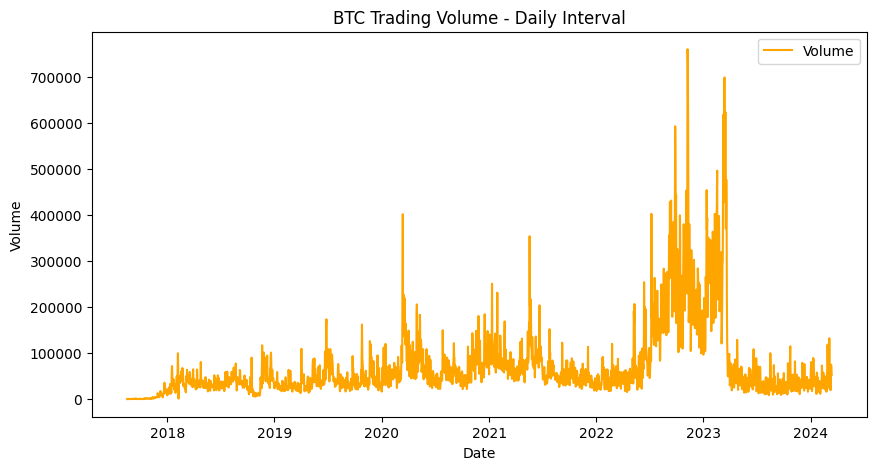

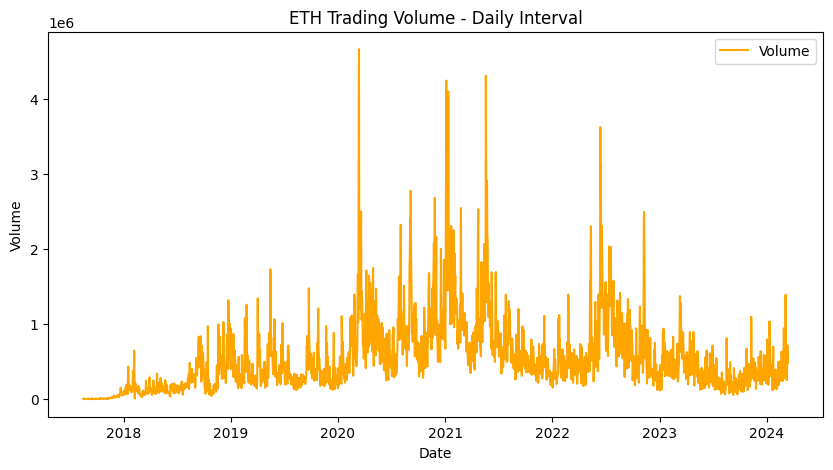

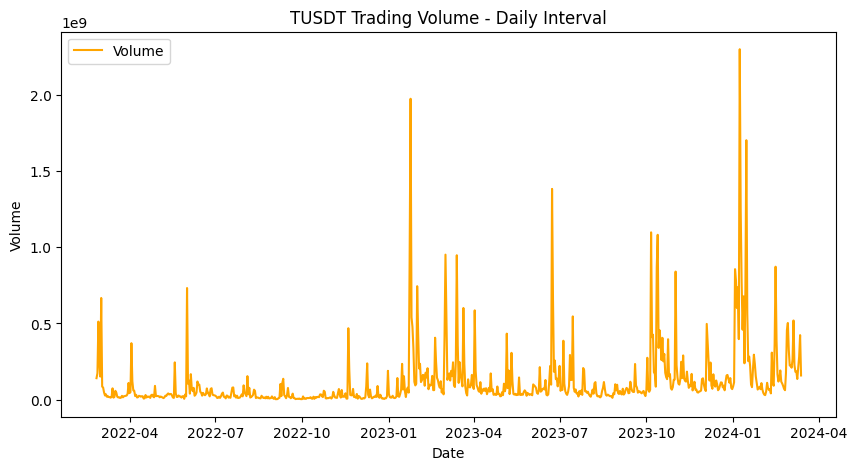

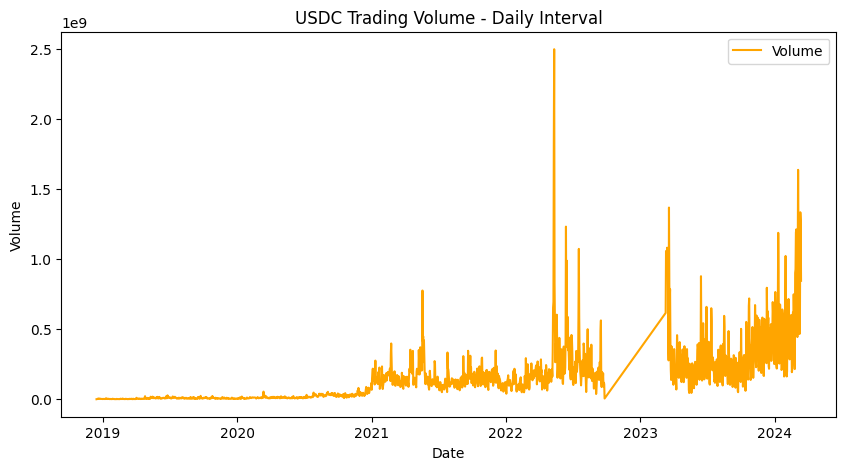

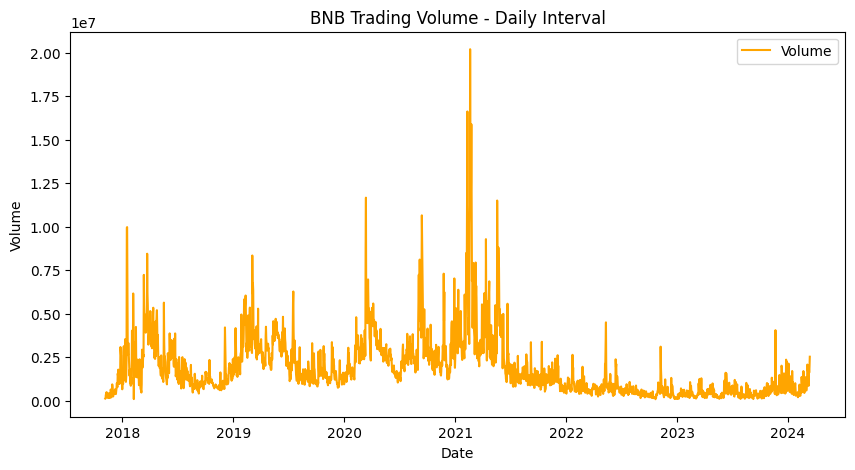

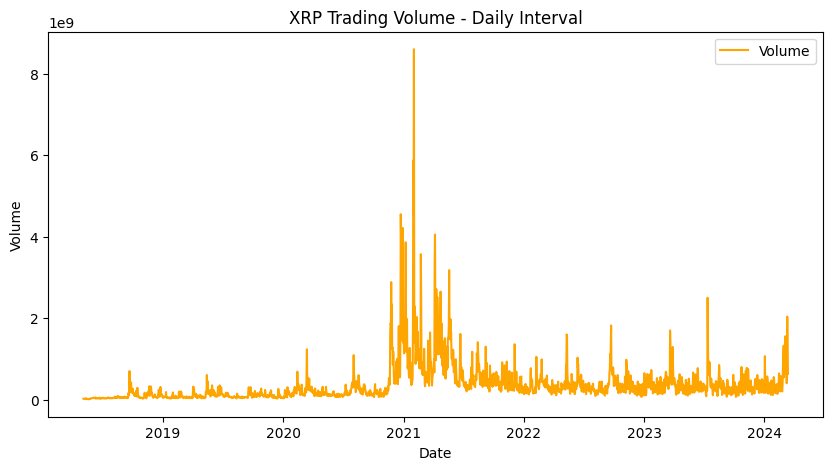

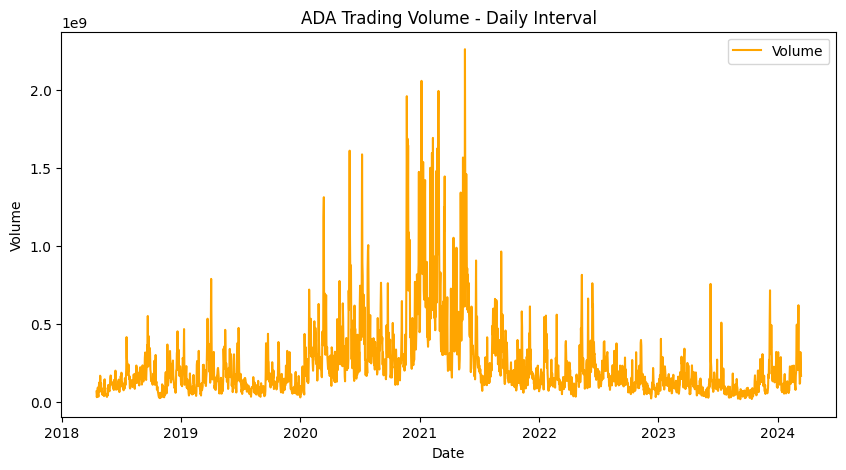

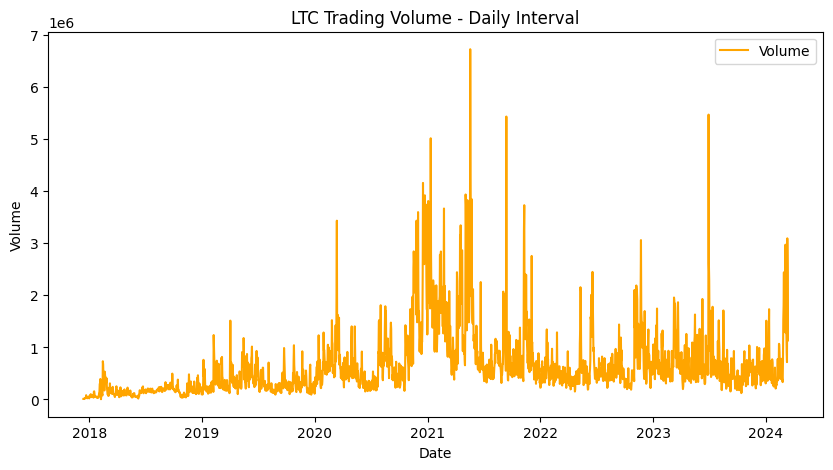

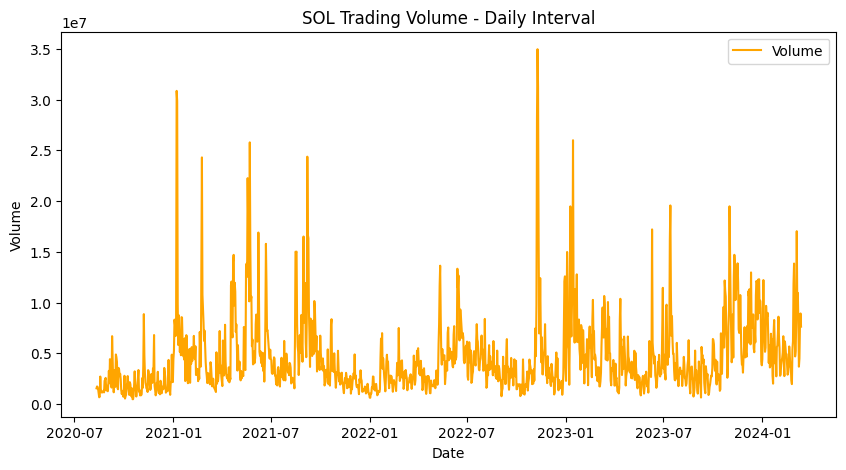

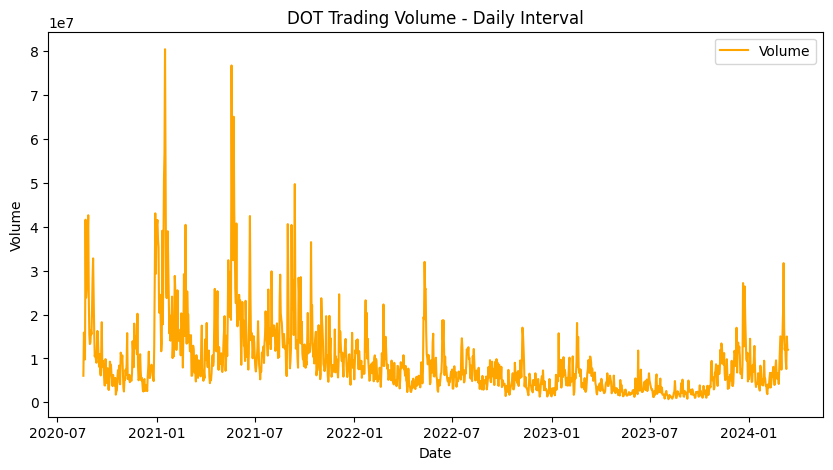


--- Volume Plot (Hourly Interval) ---


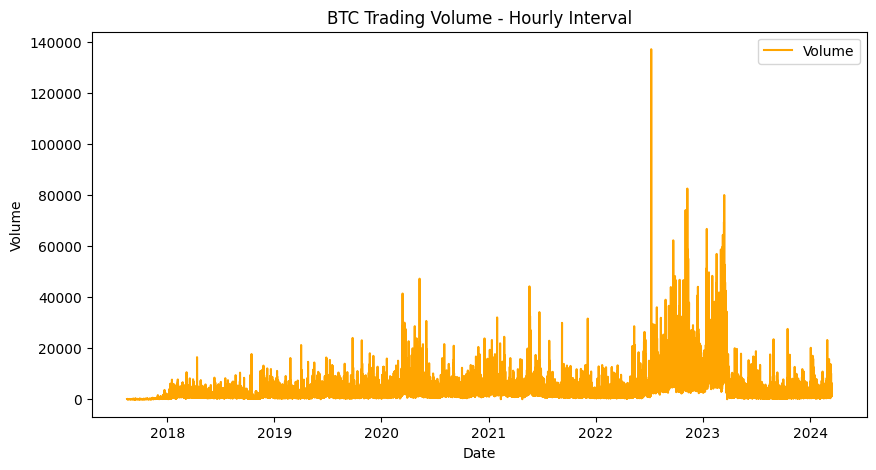

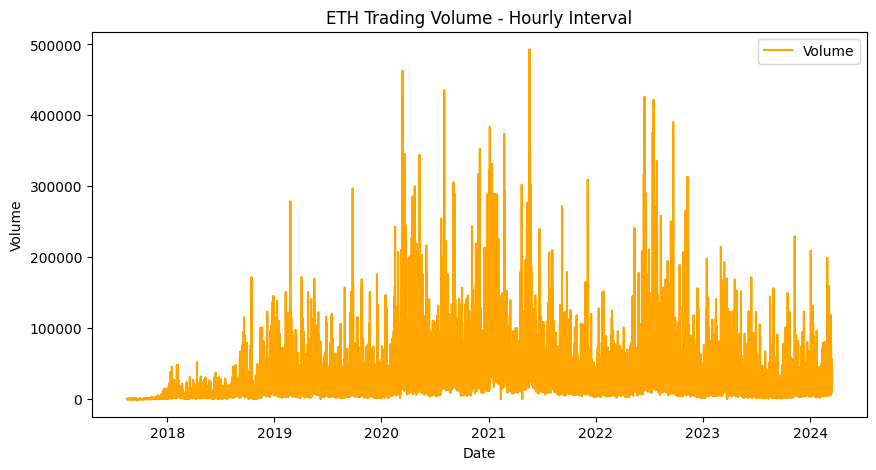

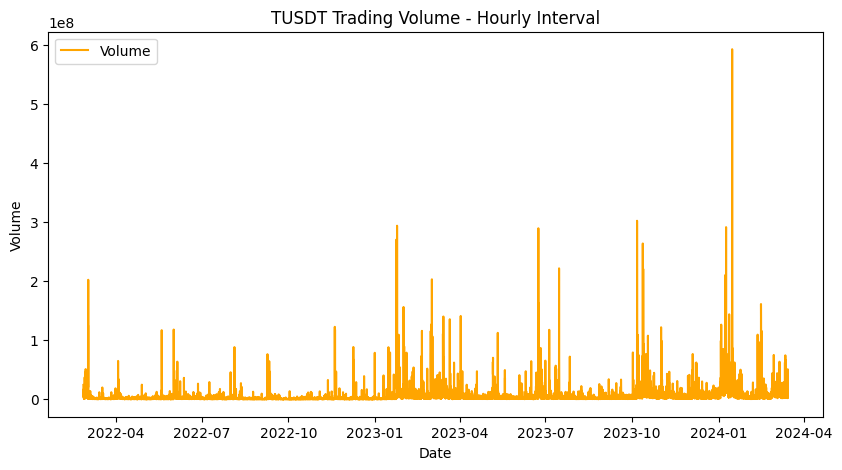

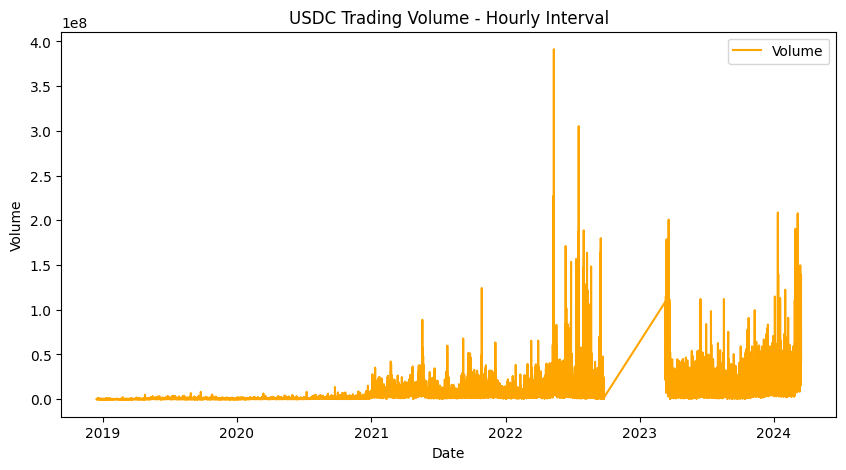

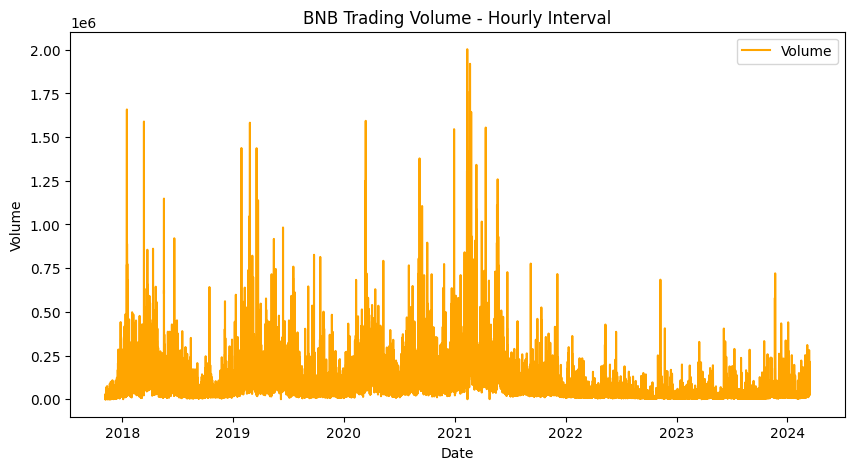

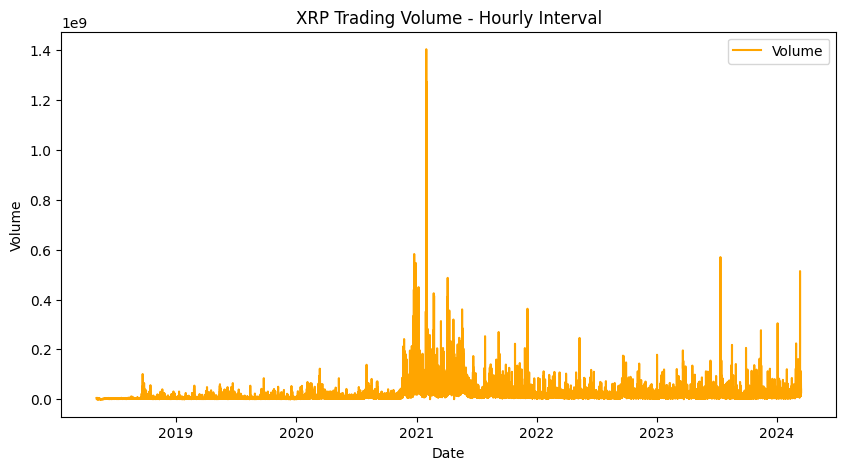

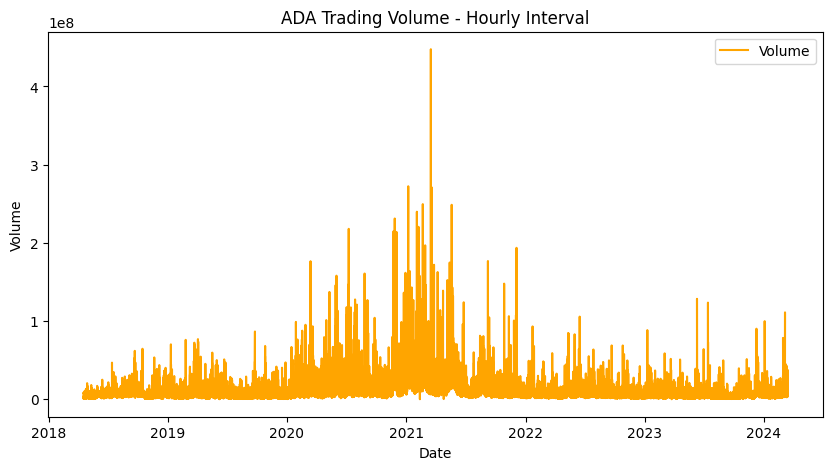

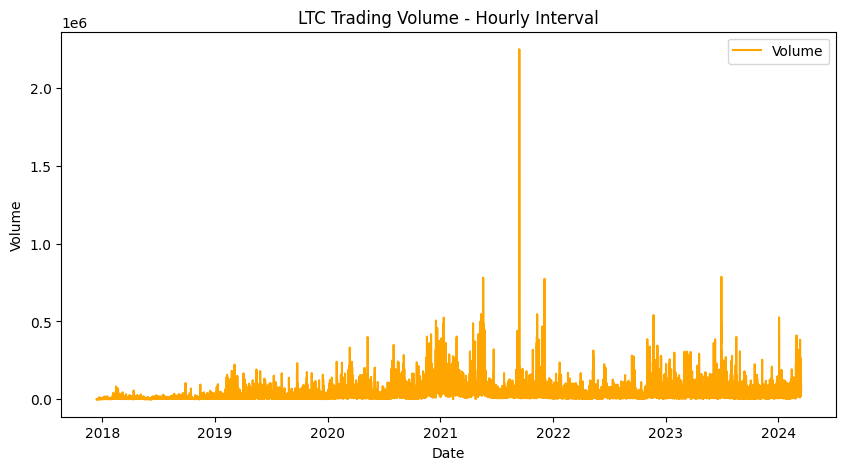

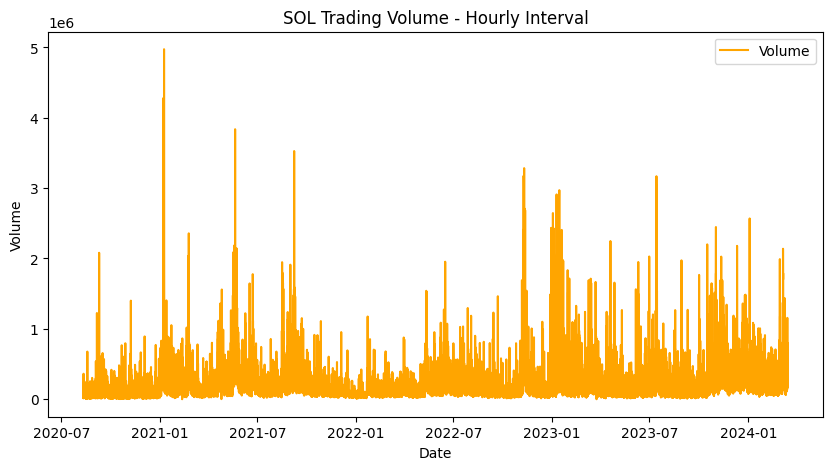

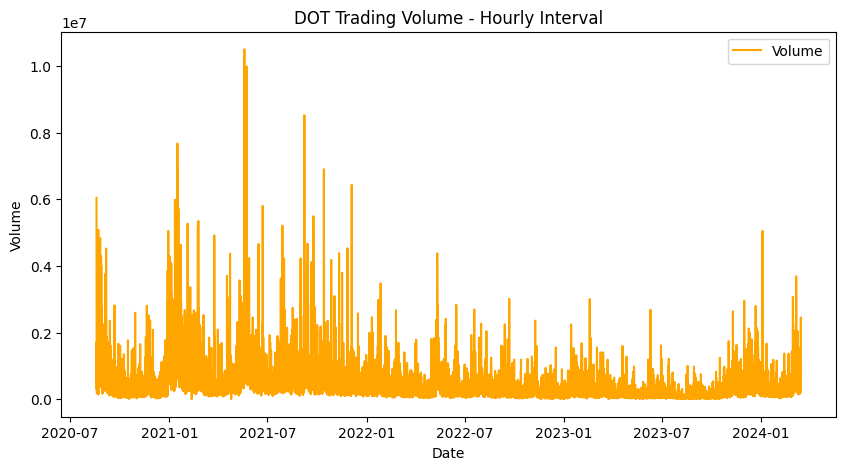


--- Volume Plot (4-Hourly Interval) ---


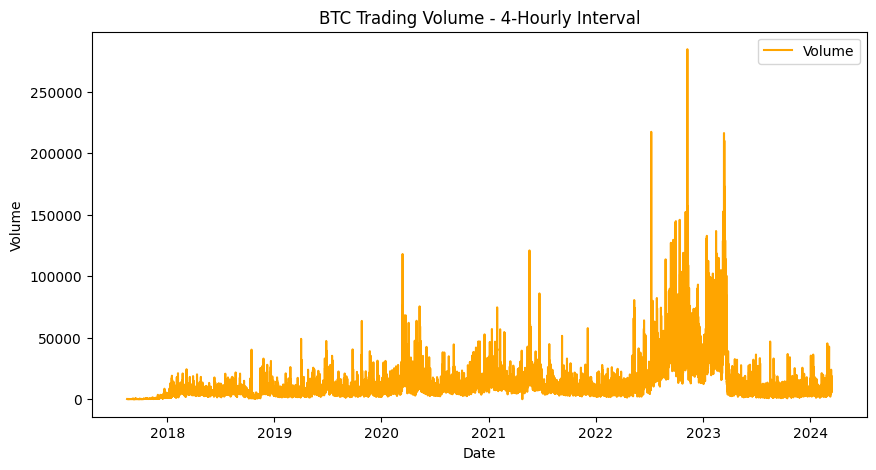

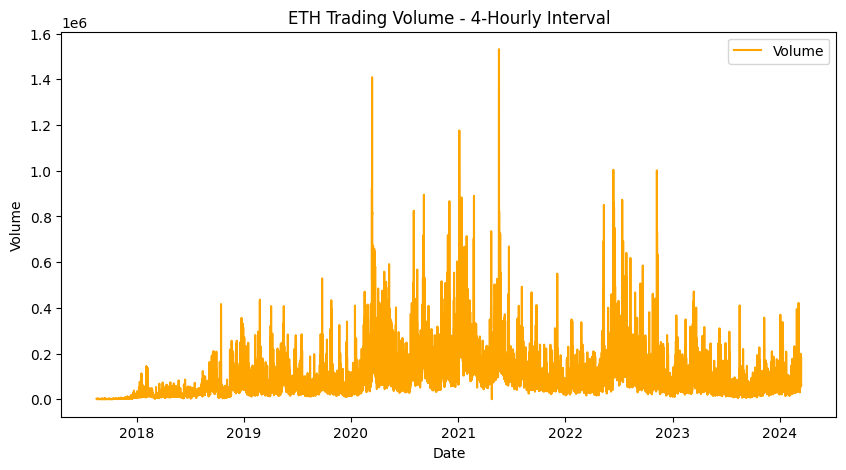

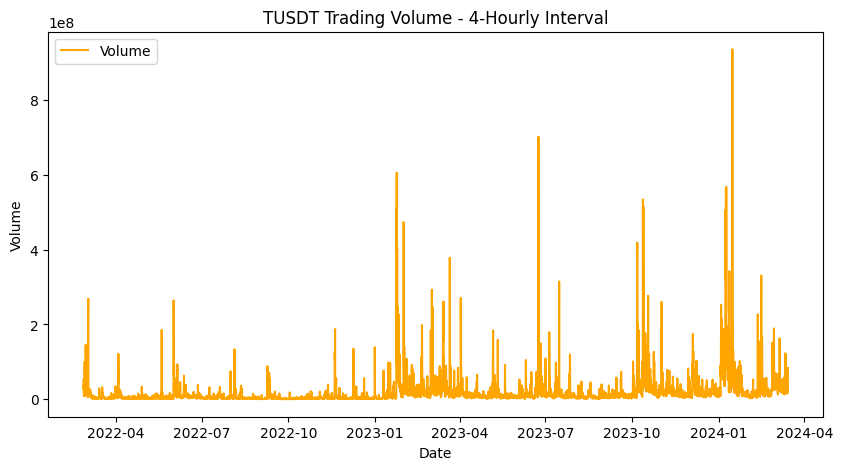

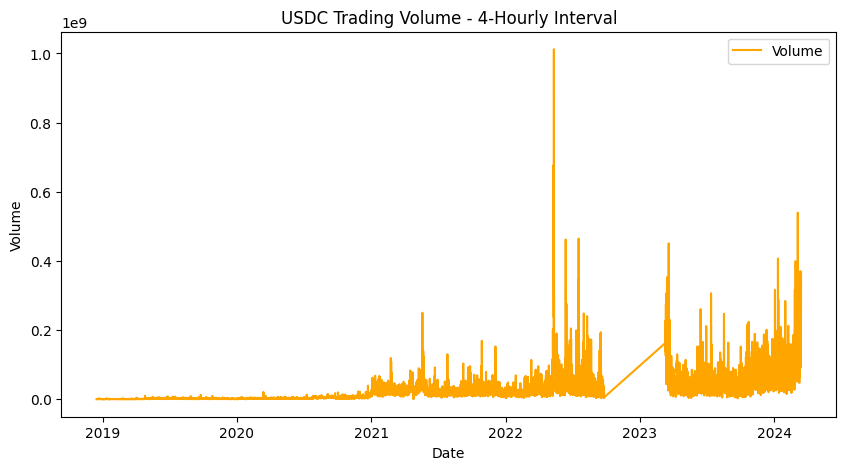

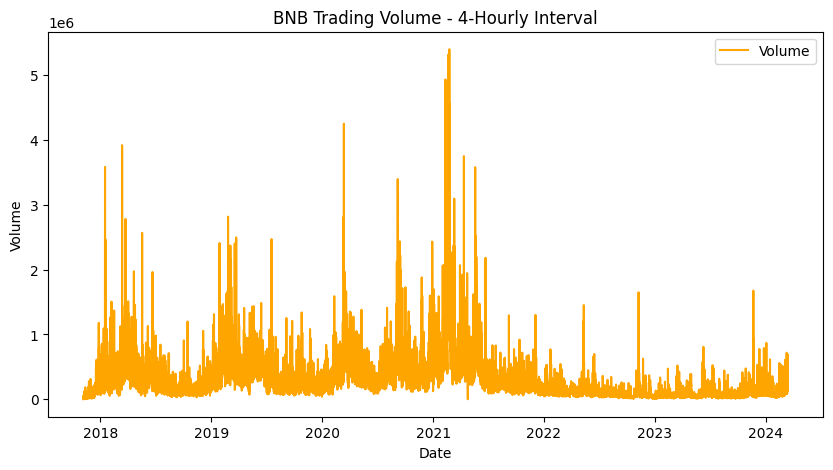

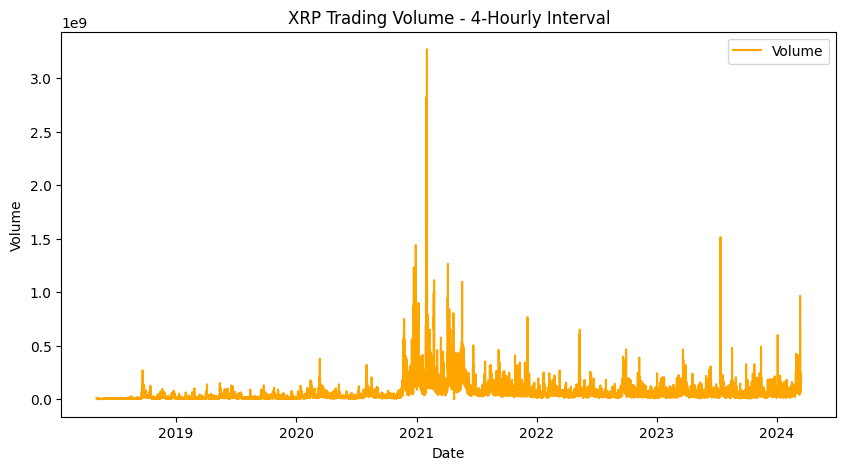

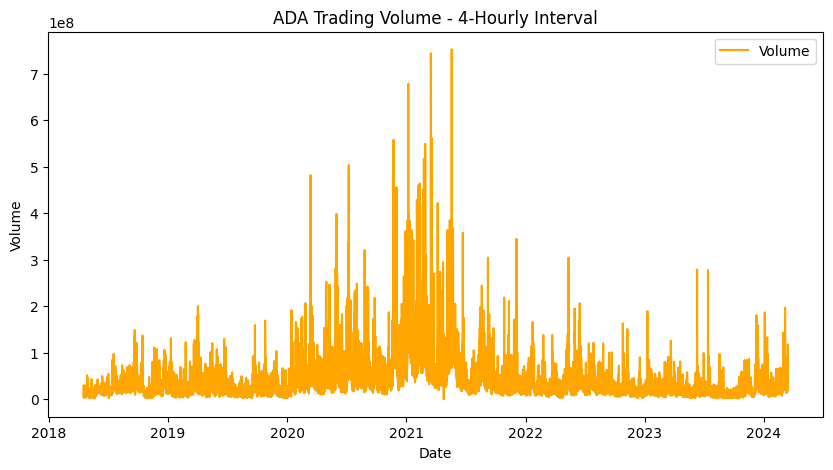

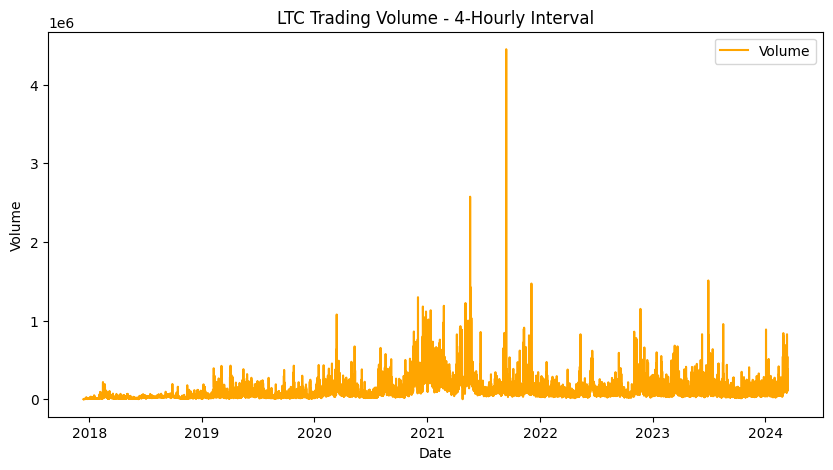

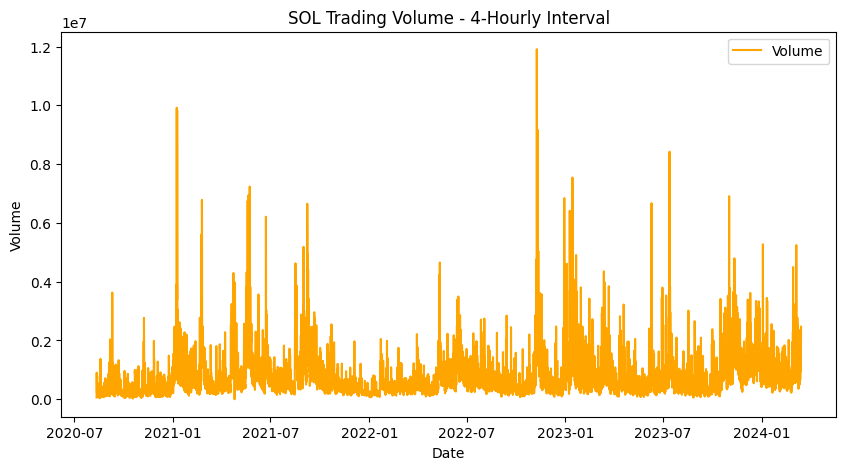

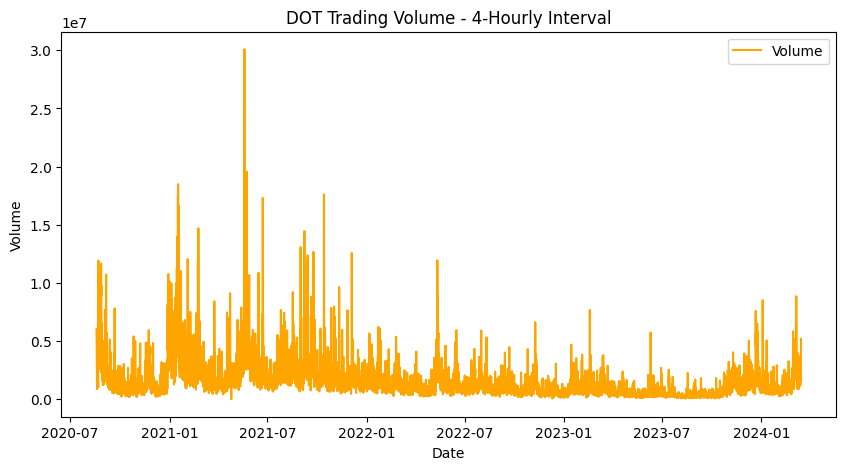


--- Volume Plot (5-Minute Interval) ---


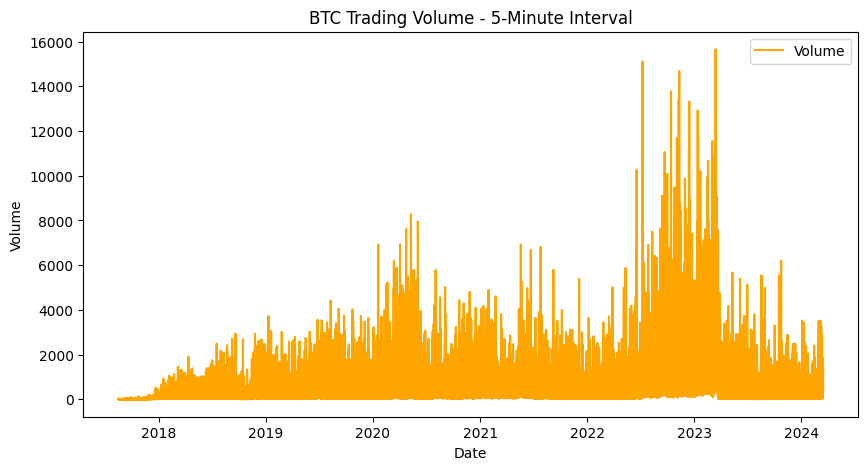

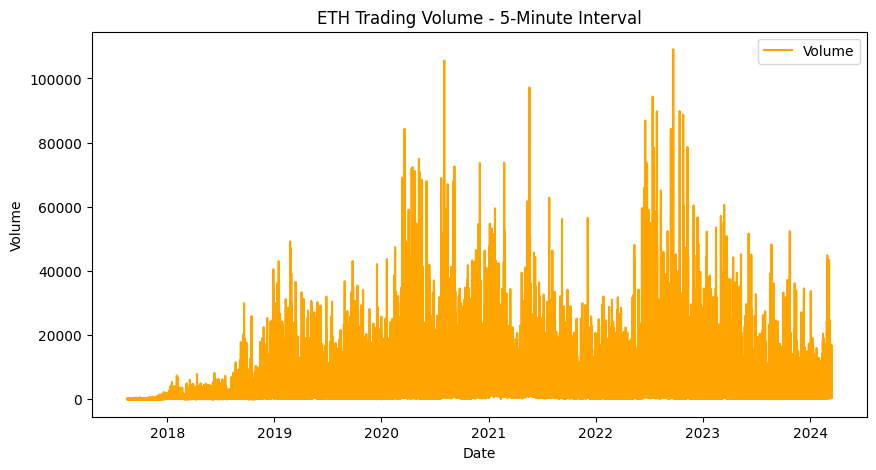

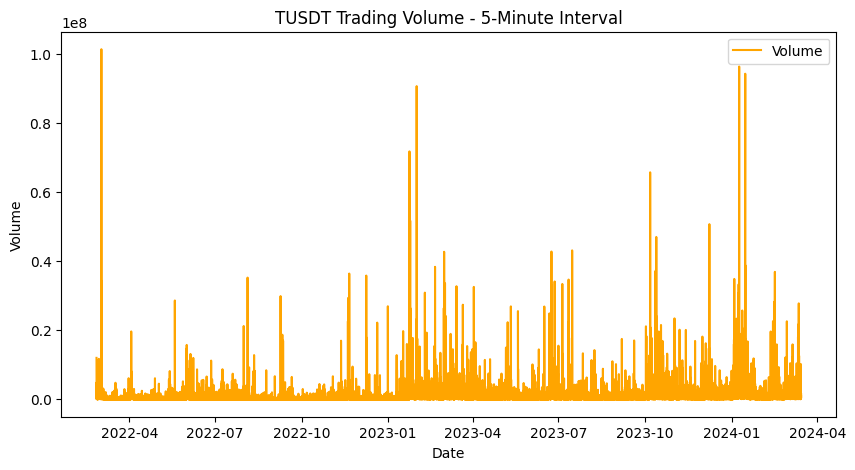

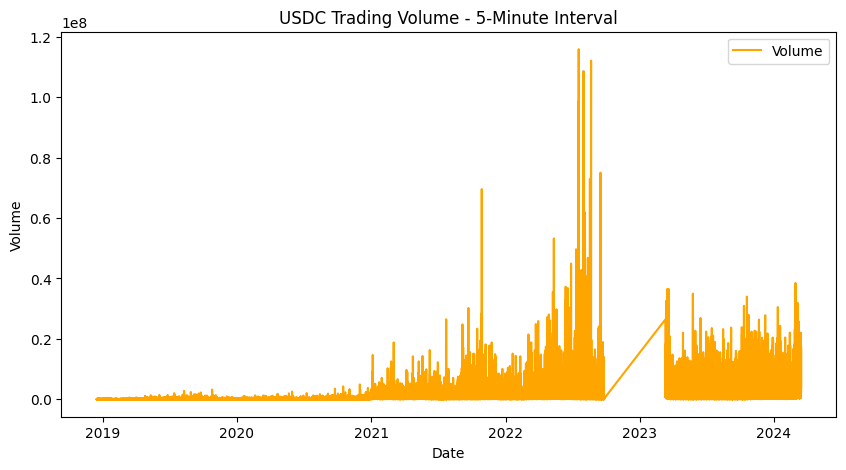

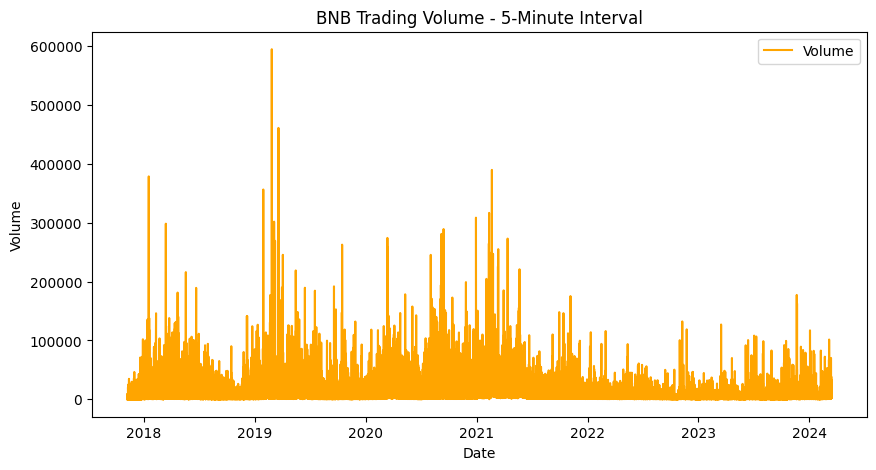

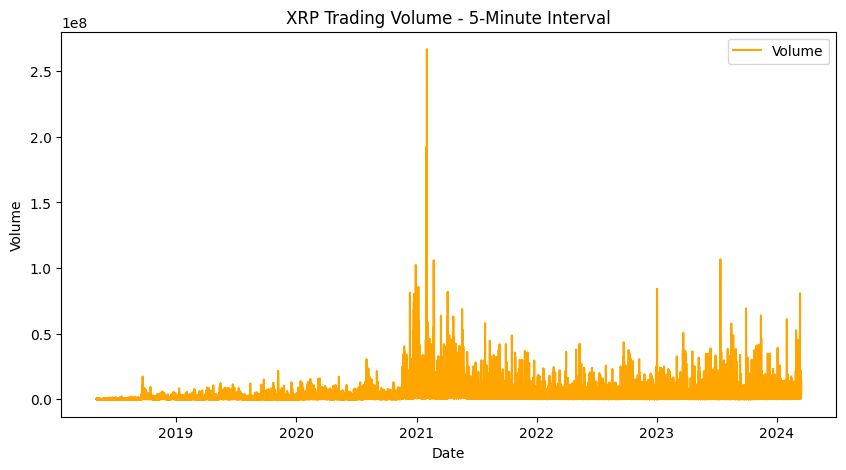

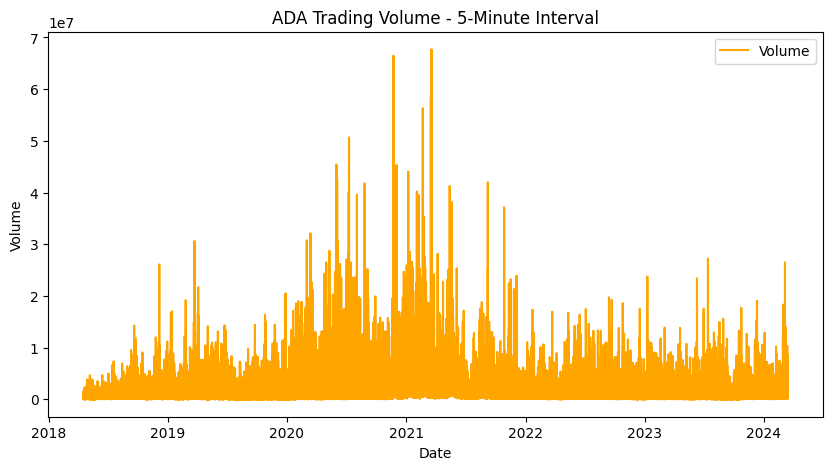

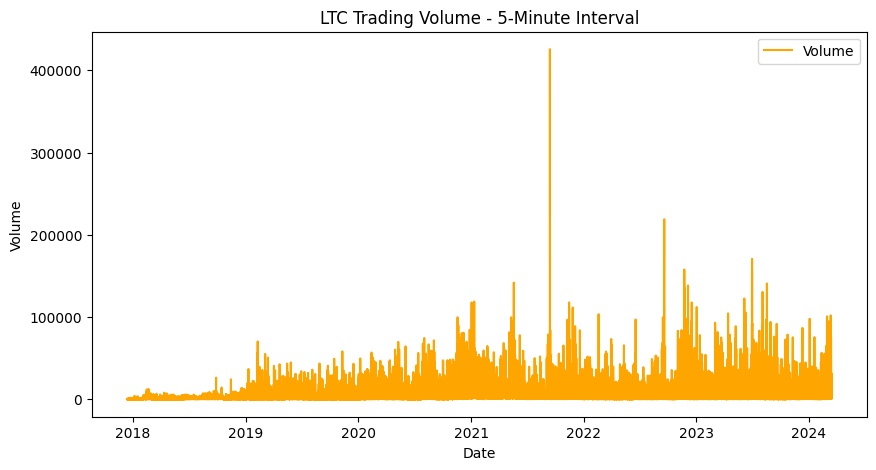

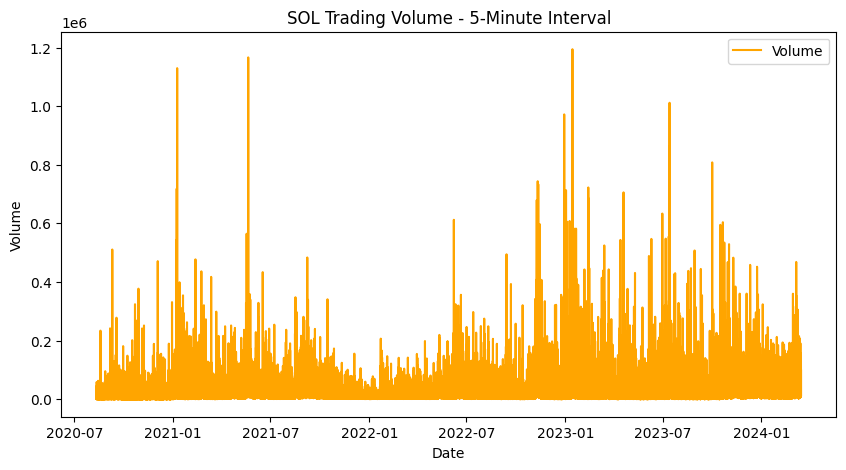

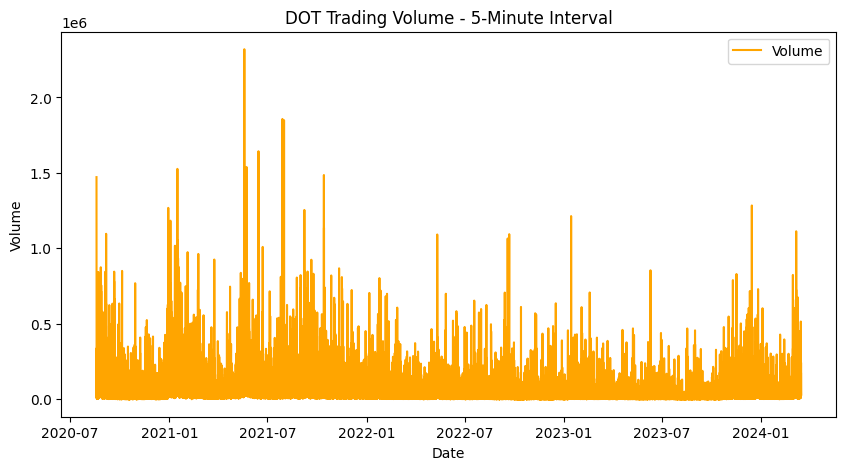


--- Volume Plot (15-Minute Interval) ---


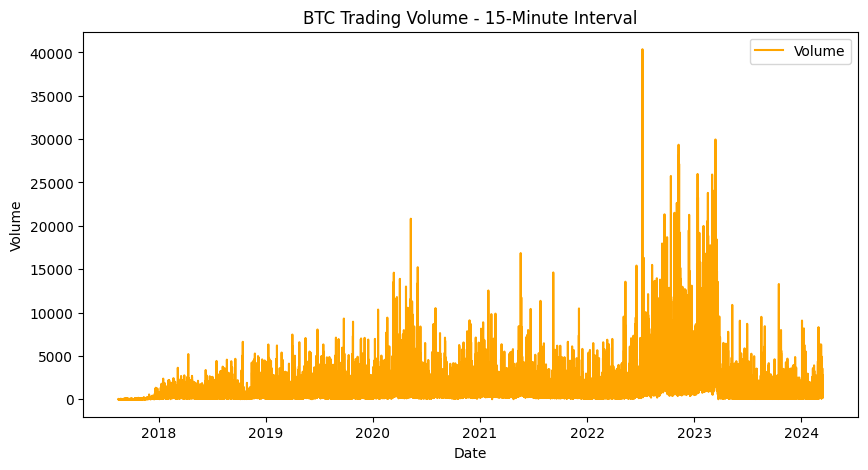

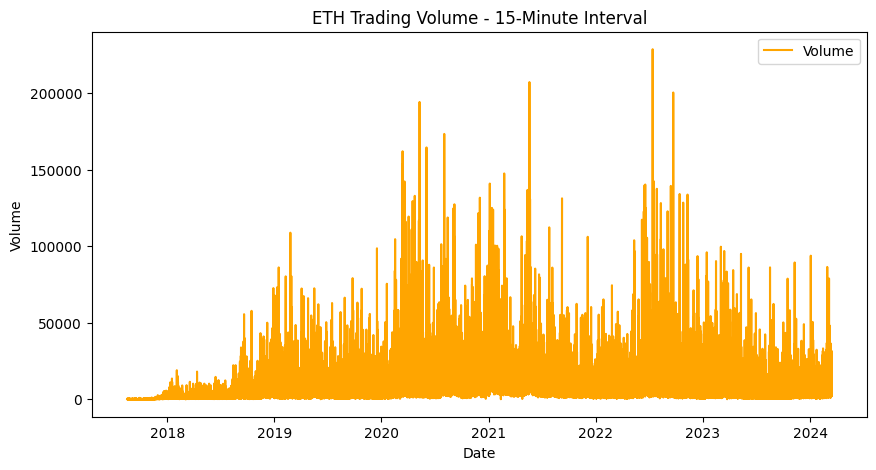

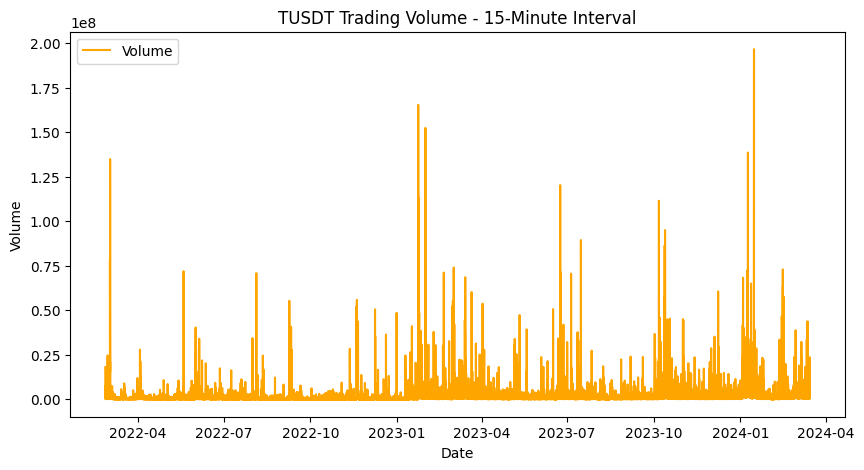

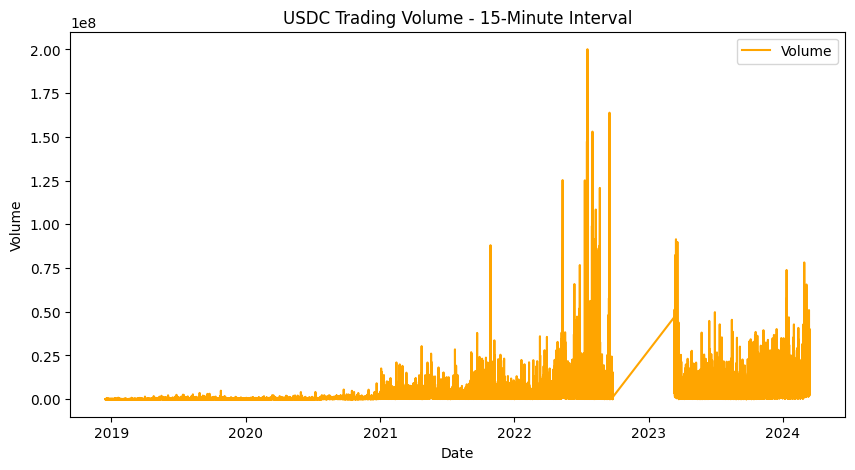

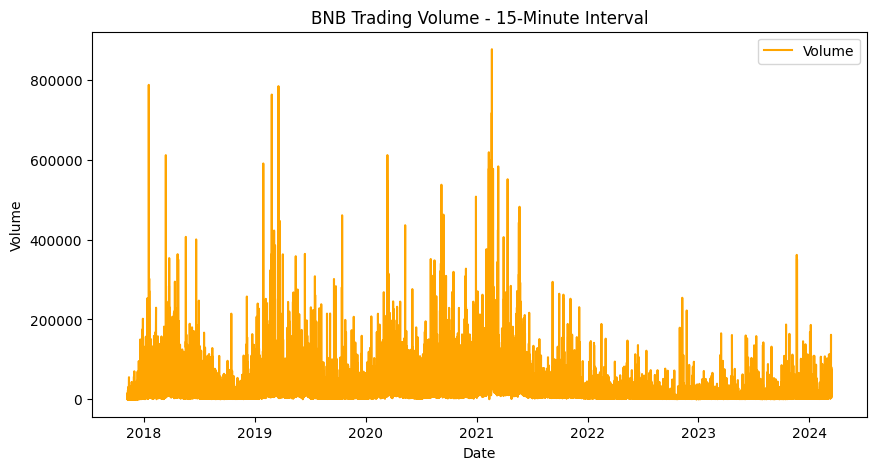

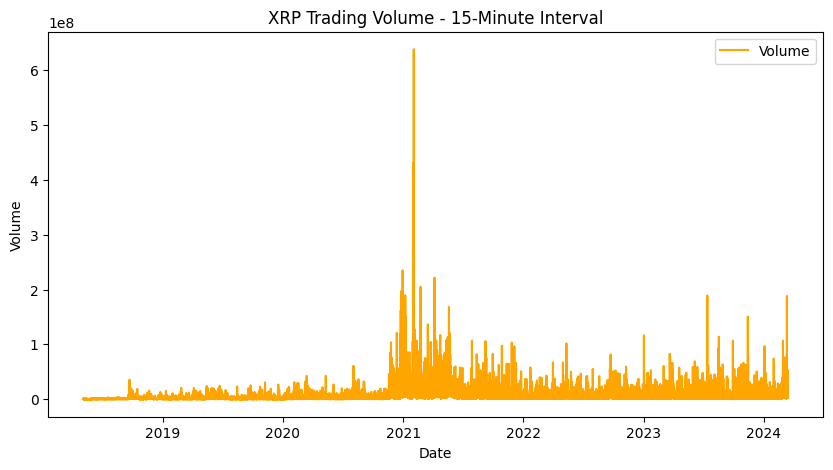

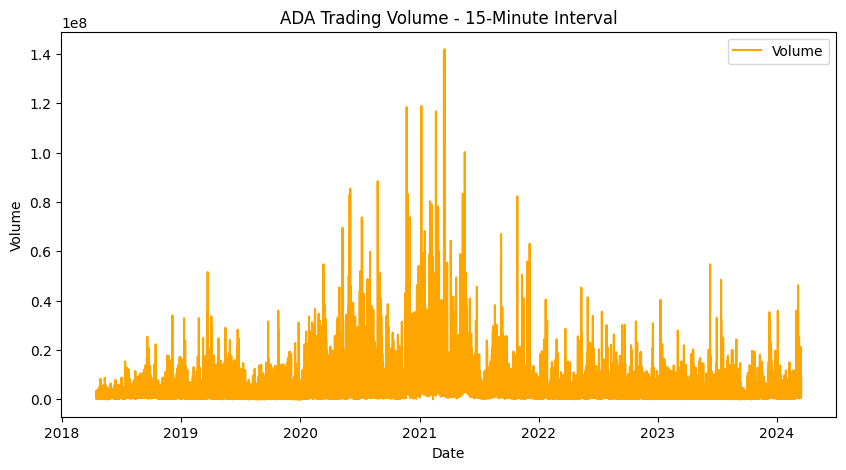

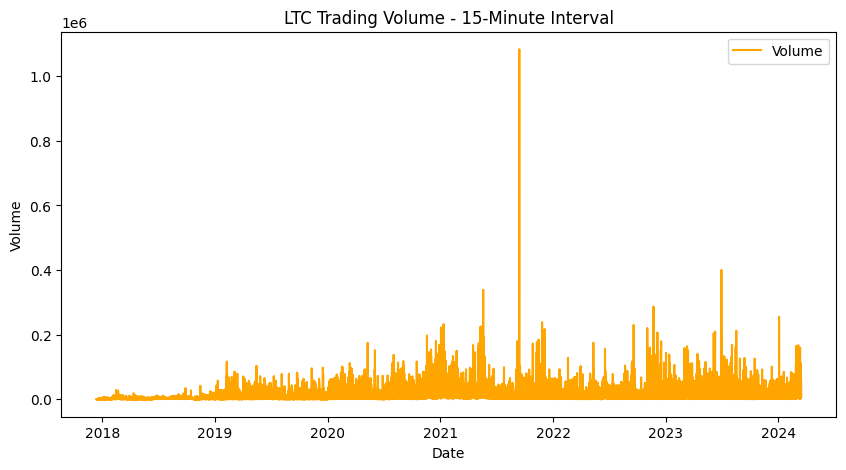

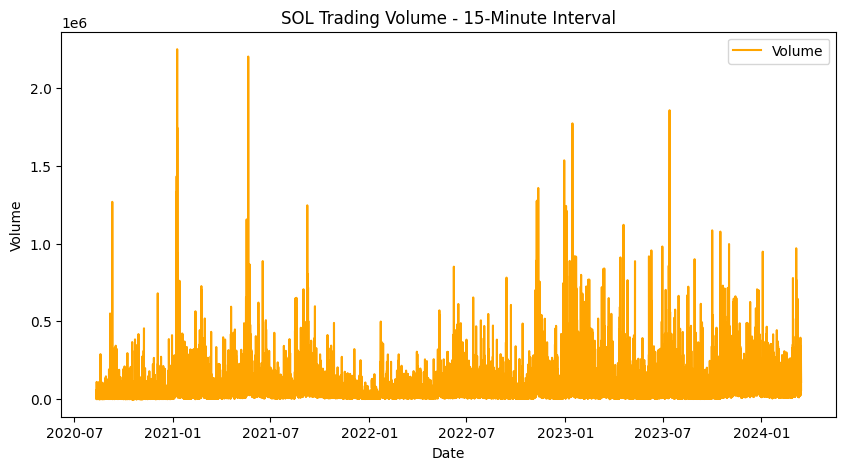

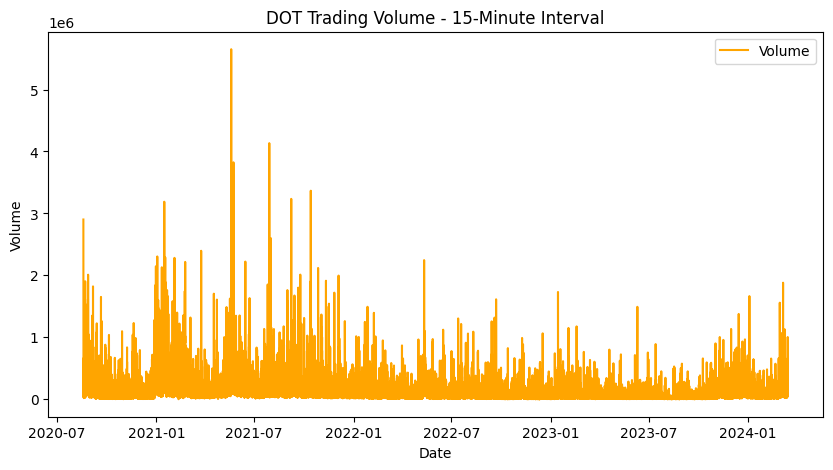


--- Volume Plot (30-Minute Interval) ---


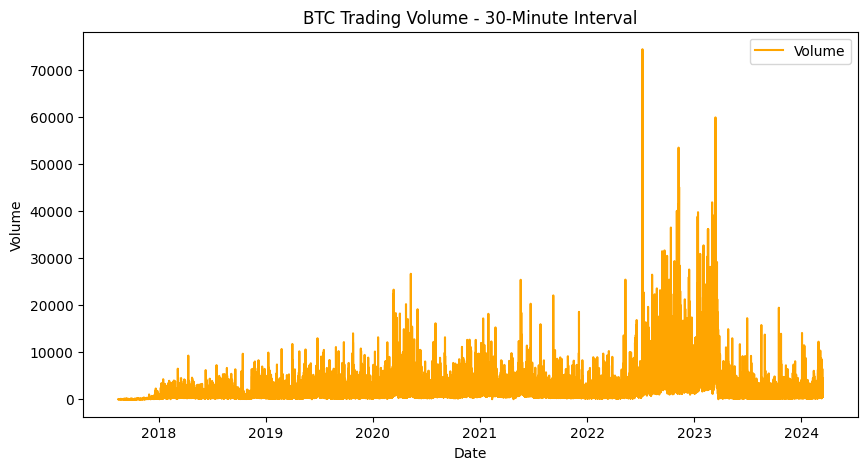

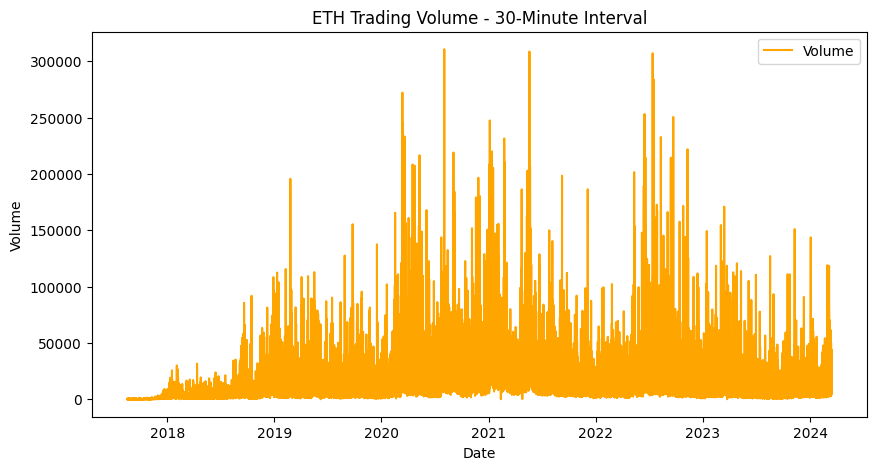

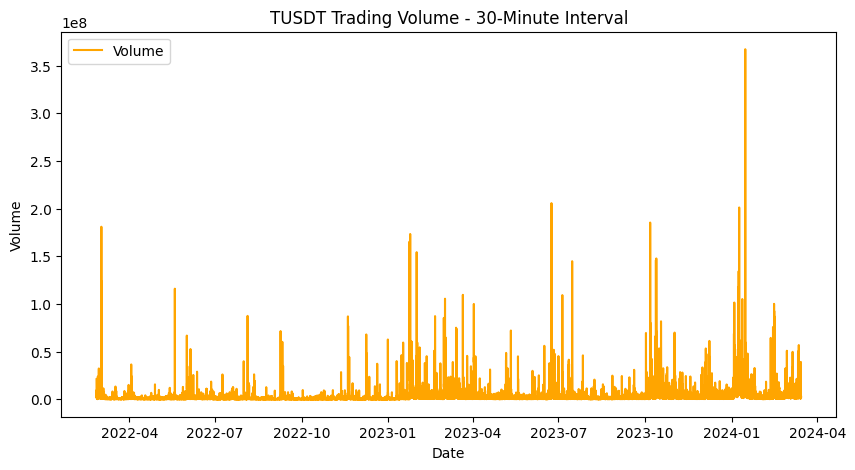

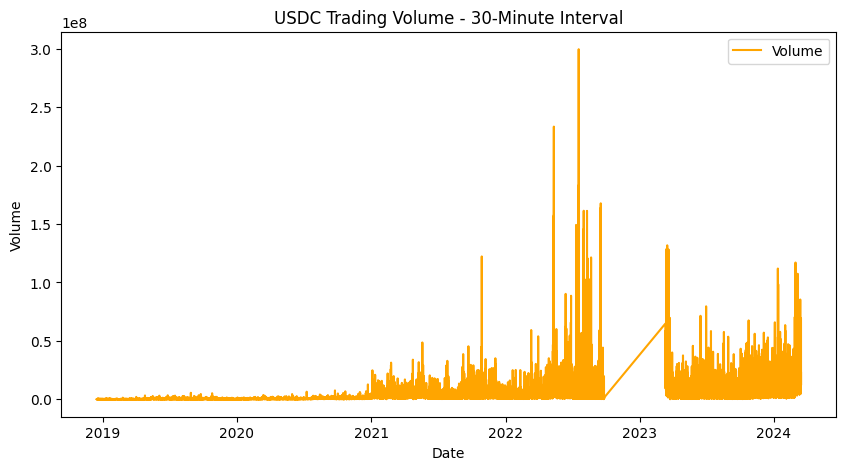

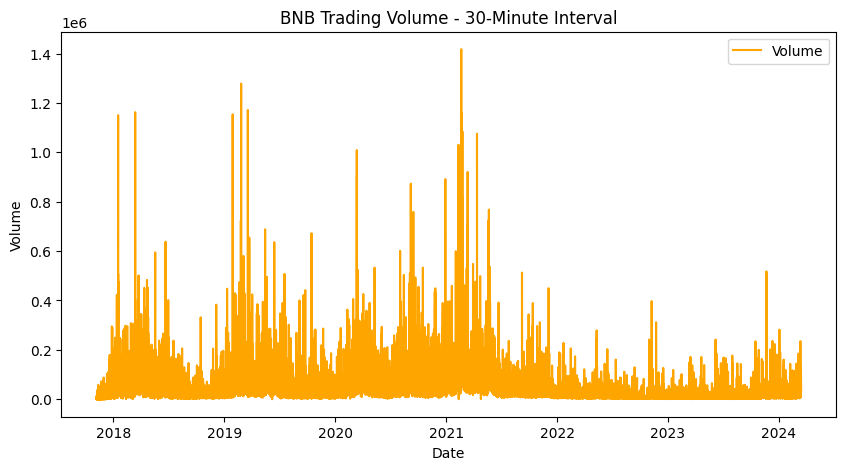

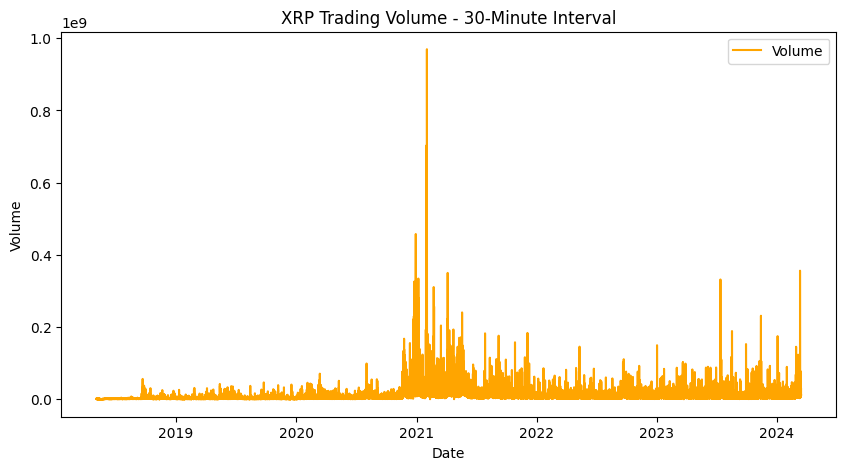

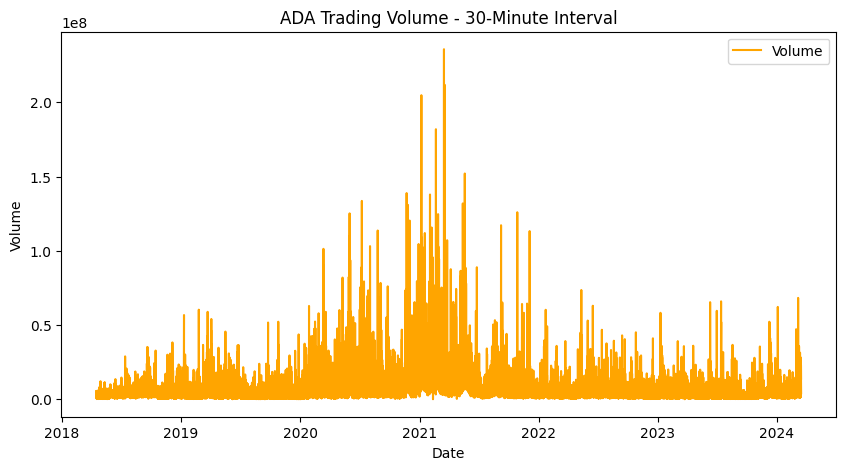

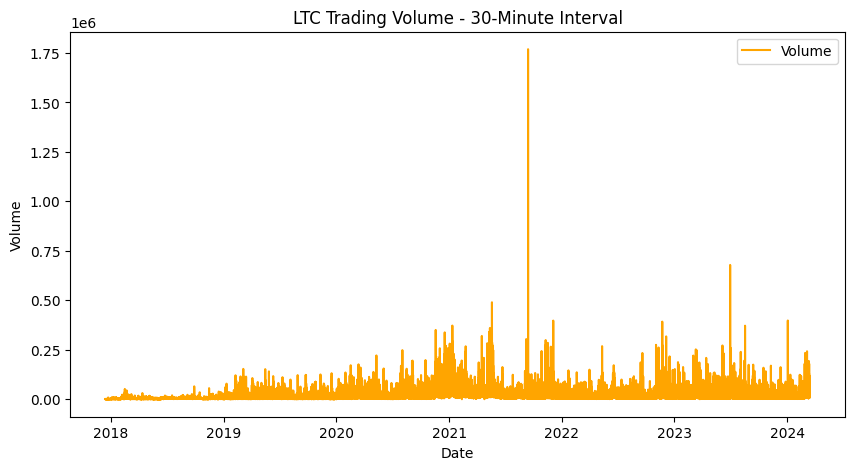

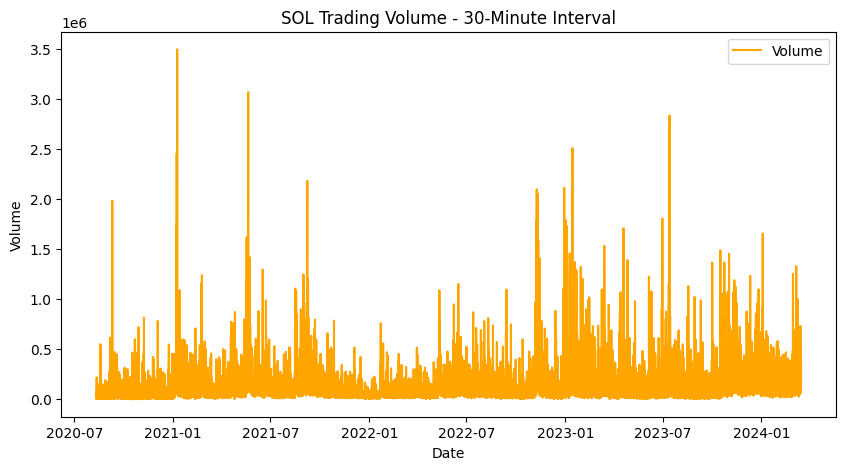

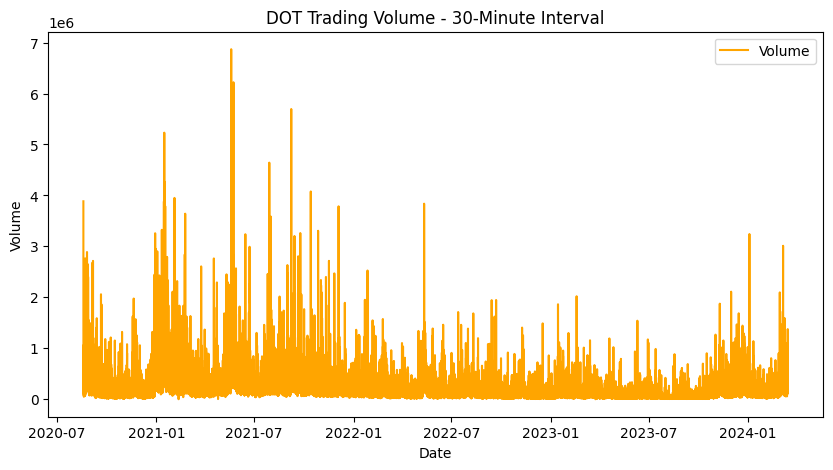


--- Volume Plot (Weekly Interval) ---


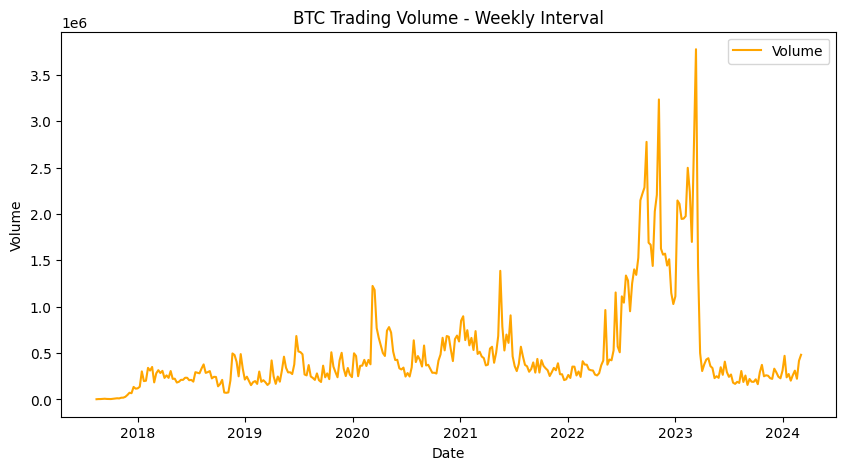

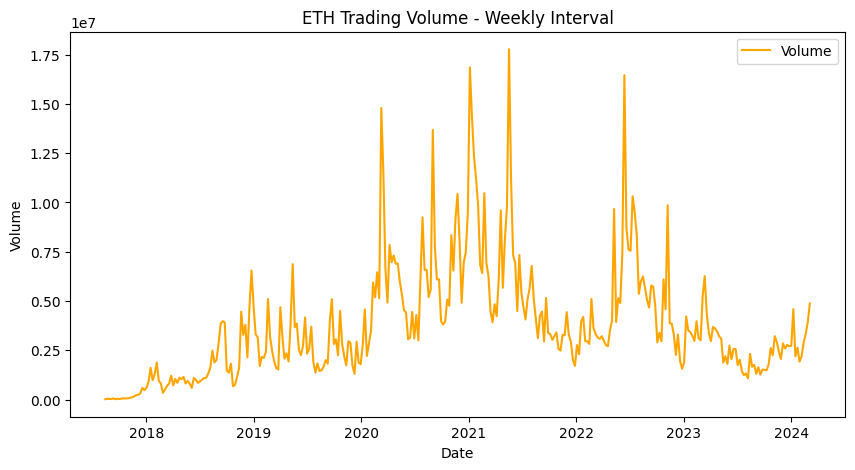

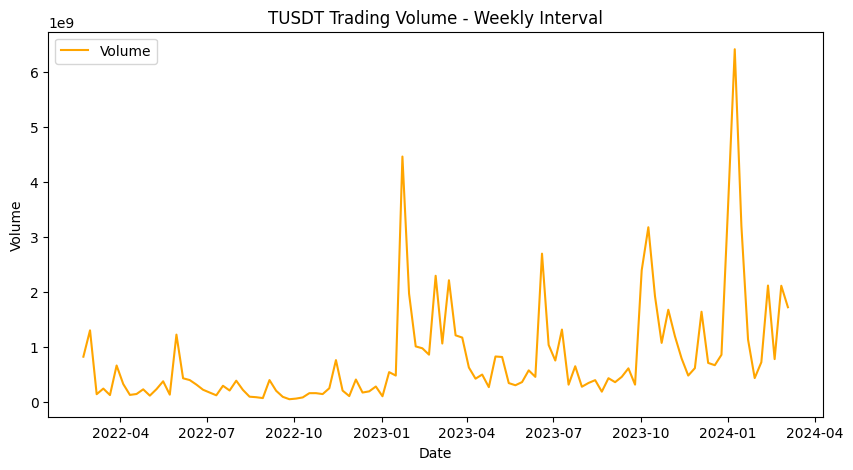

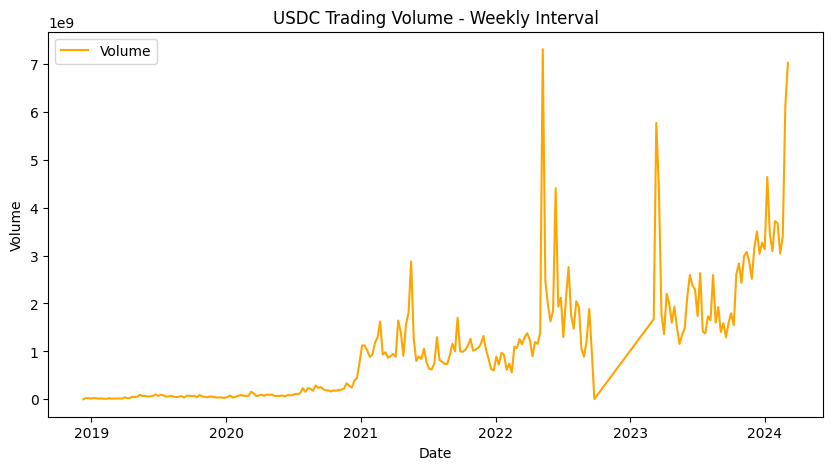

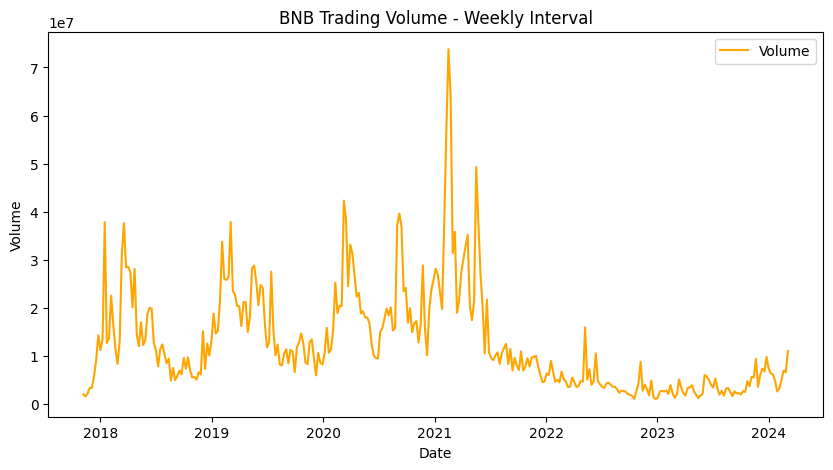

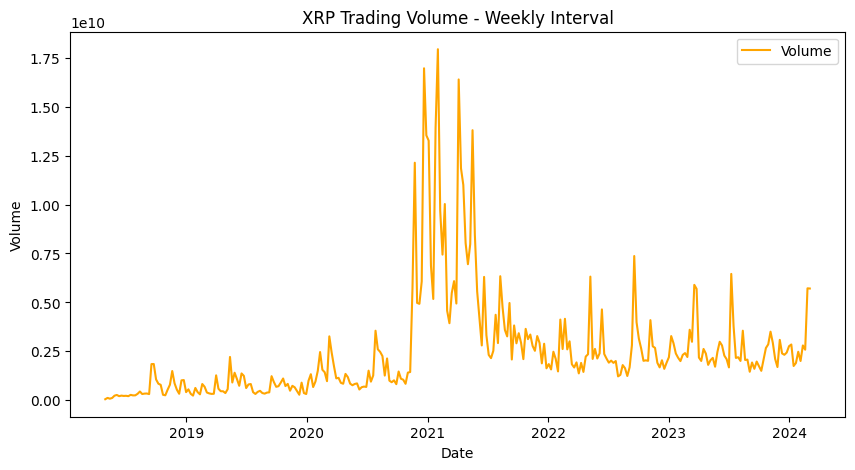

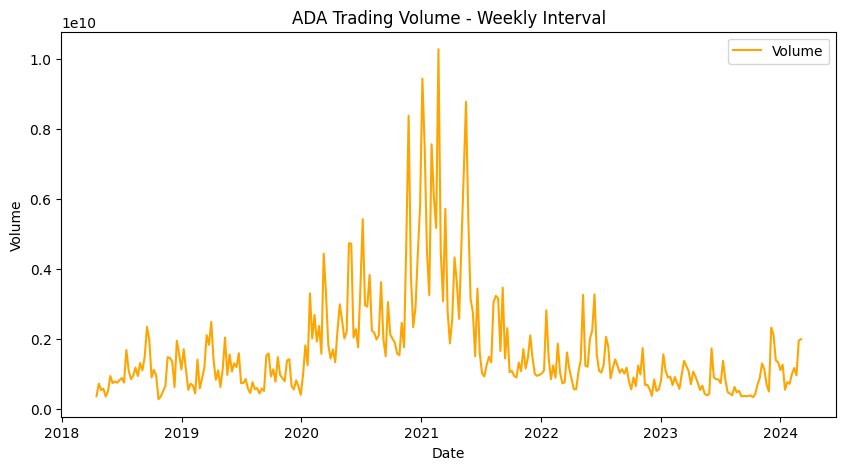

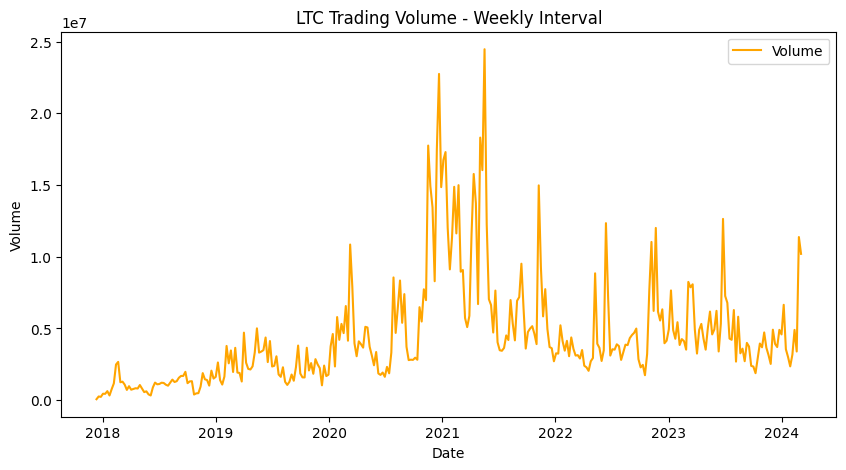

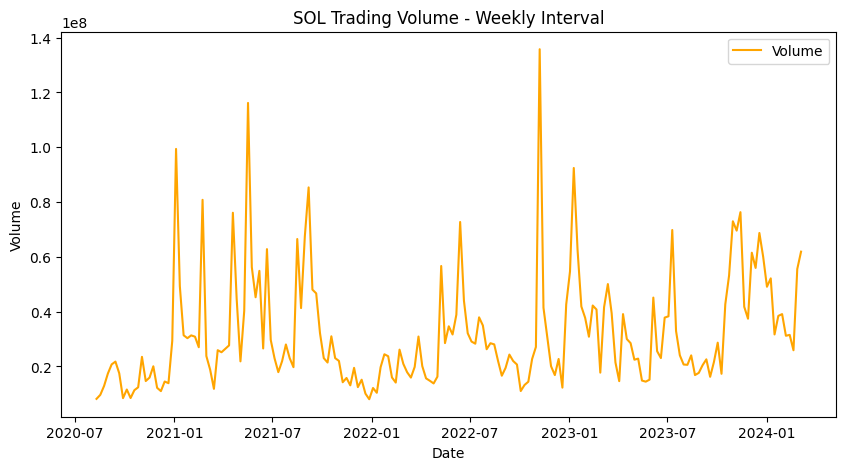

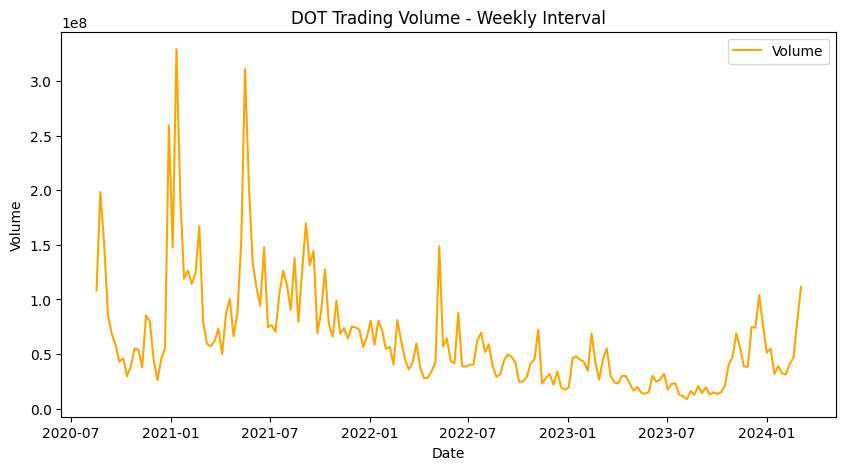

In [ ]:
# Volume plot for each cryptocurrency by interval
for interval, folder_name in intervals.items():
    print(f"\n--- Volume Plot ({folder_name} Interval) ---")
    for crypto, data in interval_data[interval].items():
        if data.empty:
            print(f"No data for {crypto} in {folder_name} interval.")
            continue

        plt.figure(figsize=(10, 5))
        plt.plot(pd.to_datetime(data['datetime']), data['volume'], label='Volume', color='orange')
        plt.title(f'{crypto} Trading Volume - {folder_name} Interval')
        plt.xlabel('Date')
        plt.ylabel('Volume')
        plt.legend()
        plt.show()


### Conclusions from Daily Trading Volume Analysis:

1. BTC (Bitcoin):
   
   - Volume for BTC shows significant spikes around 2021 and 2022, correlating with BTC’s price peaks and increased market activity.
   - Recent months have seen comparatively lower volume, suggesting less trading activity, although still active compared to the early years.
--------------------------------------------------------------------------------

2. ETH (Ethereum):

   - ETH's volume peaked around mid-2021, aligning with its price surge. Volume has remained strong but with reduced spikes post-2022.

   - The consistent volume suggests that ETH remains a highly traded cryptocurrency.
--------------------------------------------------------------------------------

3. TUSDT (Tether USD Token):

   - The volume has periodic spikes but remains lower than other cryptocurrencies.
   - Higher volume peaks in early 2023 may indicate periods of increased trading activity for stability or arbitrage purposes.

--------------------------------------------------------------------------------

4. USDC (USD Coin):

  - USDC volume shows a notable peak in early 2022, indicating increased demand during market volatility.
  - Since 2023, volume has shown growth, reflecting its use as a stablecoin in times of volatility or uncertainty.

--------------------------------------------------------------------------------

5. BNB (Binance Coin):

   - Volume spiked significantly around 2021, concurrent with Binance Coin’s price surge.

   - Post-2022, volume has decreased, but there are periodic spikes indicating investor interest.

--------------------------------------------------------------------------------

6. XRP (Ripple):

  - XRP’s trading volume peaked around 2021, during significant market events and speculation.

  - Volume has reduced but remains steady, reflecting consistent trading activity among users.

--------------------------------------------------------------------------------

7. ADA (Cardano):

- Cardano saw high volume around 2021, during its price peak.
- Volume has since decreased, indicating a drop in speculative trading or investor activity.

--------------------------------------------------------------------------------

8. LTC (Litecoin):

- Litecoin’s volume shows peaks around 2021, aligning with broader crypto market trends.
- Volume remains moderate, suggesting sustained interest but less speculative trading.

--------------------------------------------------------------------------------

9. SOL (Solana):

- Solana’s volume spiked with its rapid price increase in 2021 but has seen reduced activity afterward.
- Recent increases in volume in early 2024 suggest renewed interest as the price recovers.

--------------------------------------------------------------------------------

10. DOT (Polkadot):

- Polkadot’s volume peaked around late 2021 and has been lower since then, with some spikes in 2024.
- This volume trend suggests waning interest, with occasional activity as the market fluctuates.

---------------------------------------X----------------------------------------


### Conclusions from Hourly Trading Volume Analysis:


1. BTC (Bitcoin): The trading volume exhibits significant spikes in early 2021 and again in early 2023, reflecting increased trading activities possibly associated with market speculation or major events affecting BTC. Overall, volume is trending slightly downward, indicating reduced trading intensity compared to peak levels.

--------------------------------------------------------------------------------

2. ETH (Ethereum): Trading volume in Ethereum saw a steady increase through 2020 and reached notable peaks in early 2021. Post-2022, the volume appears more consistent, with fewer extreme spikes, suggesting stabilized interest but at lower volumes than during the initial rally phases.

--------------------------------------------------------------------------------

3. TUSDT (TrueUSD Tether): TUSDT shows substantial volume peaks in early 2023 and early 2024, with periods of low volume between these peaks. This pattern may indicate sporadic high trading demand possibly influenced by specific events or market fluctuations in stablecoin usage.

--------------------------------------------------------------------------------

4. USDC (USD Coin):
   USDC displays significant volume surges beginning in late 2021, with an especially high peak in early 2023. This pattern suggests growing demand for stablecoins, likely linked to increased usage in trading or as a safe-haven during volatile periods.

--------------------------------------------------------------------------------

5. BNB (Binance Coin):
   The volume for BNB saw high fluctuations in 2021, aligning with its price surge during this period. Post-2021, trading volume became more subdued, possibly indicating a decreased speculative interest as the market matured.

--------------------------------------------------------------------------------

6. XRP (Ripple):
   XRP volume peaked significantly in 2021, coinciding with its price volatility due to legal developments and market speculation. Since then, volume trends downward, suggesting a decrease in speculative trading.

--------------------------------------------------------------------------------

7. ADA (Cardano):

   ADA's trading volume surged during its price rally in 2021, then gradually stabilized with fewer extreme spikes. This trend reflects decreasing volatility and potentially a more mature trading interest.

--------------------------------------------------------------------------------

8. LTC (Litecoin):

   LTC volume has remained relatively steady, with significant peaks observed around early 2021. Since then, trading volume is generally low, indicating decreased speculative trading or investment interest.


--------------------------------------------------------------------------------

9. SOL (Solana):

   SOL's volume showed high trading activity during its rapid price increase in 2021, with the volume tapering off afterward. The pattern aligns with the market cycle of hype followed by stabilization.


--------------------------------------------------------------------------------

10. DOT (Polkadot):

  DOT exhibited elevated trading volumes throughout 2021, aligning with its price peak and ecosystem growth. The trading volume has since stabilized, with fewer extreme variations, indicating a more consistent trading interest at moderate levels.

---------------------------------------X----------------------------------------




### Conclusions from 4-Hourly Trading Volume Analysis:

1. BTC (Bitcoin):

  - Consistent trading volume growth over the years, with major peaks during the market rallies in 2021 and early 2023.
  - High volume spikes correspond to both price rallies and market corrections, indicating strong trading activity during periods of high volatility.

--------------------------------------------------------------------------------

2. ETH (Ethereum):

- Significant increase in trading volume from late 2020 through early 2022, aligned with price surges.
- Notable volume decline since 2022, though periodic spikes suggest interest during market events or Ethereum-specific updates.

--------------------------------------------------------------------------------

3. TUSDT (Tether USD Token):

- Volume relatively low but with intermittent high spikes, especially during volatile market periods in 2023 and early 2024.
- Volume patterns likely indicate Tether’s role as a stablecoin, used for transactions rather than speculation.


--------------------------------------------------------------------------------

4. USDC (USD Coin):

- Steady increase in trading volume from 2020, reflecting its growing adoption as a stablecoin.
- Major spikes in early 2022 and 2023, possibly due to increased demand during market fluctuations.

--------------------------------------------------------------------------------

5. BNB (Binance Coin):

- High trading volume during 2021, aligning with the crypto bull market.
- Volume has declined since 2022 but with occasional spikes, reflecting continued trading interest.

--------------------------------------------------------------------------------

6. XRP (Ripple):

- Dramatic volume spike in early 2021, likely related to regulatory developments and speculative interest.
- Trading volume has stabilized since then, with occasional increases during price movements.


--------------------------------------------------------------------------------


7. ADA (Cardano):

- Volume surged in 2021, corresponding with ADA’s price rally and increased interest in the Cardano ecosystem.

- Gradual decline in volume post-2022, with minor spikes indicating moments of increased trading activity.


--------------------------------------------------------------------------------


8. LTC (Litecoin):

- Volume followed a similar pattern as other altcoins, peaking around 2021 and reducing afterward.

- Volume spikes indicate moments of renewed interest but have not sustained long-term growth.

--------------------------------------------------------------------------------


9. SOL (Solana):

- Rapid volume increase starting from mid-2021, associated with Solana’s ecosystem growth and price surge.

- Significant drops post-2022, though spikes are seen in 2023, reflecting intermittent market interest.


--------------------------------------------------------------------------------


10. DOT (Polkadot):

- Volume saw growth from late 2020 to 2021, associated with DOT’s popularity and price gains.

- Volume has decreased post-2021, with occasional spikes corresponding to market events.

-----------------------\\----------------------------------------------------


The 4-hourly interval volume data generally shows high trading activity during bull market phases, especially in 2021, with a reduction in sustained volume as the market cooled. Stablecoins like TUSDT and USDC show unique patterns, with volume spikes indicating their utility during volatile periods. Each cryptocurrency displays volume spikes that correlate with market events or specific developments, illustrating a strong relationship between trading volume and periods of heightened market interest.


---------------------------------------X----------------------------------------


### Conclusions from 5-Minute Trading Volume Analysis:


1. BTC (Bitcoin):

   - The trading volume for BTC in the 5-minute interval displays a gradual increase in volume over time, with significant spikes around late 2020 and early 2021, coinciding with the major bull market period.
   - However, volumes tapered in late 2023, indicating a decline in short-term trading interest or reduced market volatility.

--------------------------------------------------------------------------------

2. ETH (Ethereum):

- Similar to BTC, ETH trading volume increased steadily with major peaks around 2020-2021.
- Notably, the spikes are sustained, showing considerable interest in Ethereum, especially during periods of high market movement. Volumes have become relatively stable but remain significant.

--------------------------------------------------------------------------------

3. TUSDT (TrueUSD Tether):

- TUSDT shows sporadic volume spikes without a consistent pattern, which may indicate irregular trading interest or specific events influencing its trading volume.
- Large peaks in early 2024 could be related to specific market news or liquidity events.

--------------------------------------------------------------------------------

4. USDC (USD Coin):

- USDC demonstrates low but consistent trading volume, reflecting its role as a stablecoin with utility primarily for stability and transactions rather than speculative trading.

- Spikes in 2022 align with major market corrections, where liquidity might have shifted into stable assets.

--------------------------------------------------------------------------------

5. BNB (Binance Coin):

- BNB has a relatively high trading volume, especially around late 2019 and early 2021.
- These spikes coincide with periods when Binance expanded its services and the Binance Smart Chain gained popularity. Volumes remain active, reflecting ongoing interest in the token.

--------------------------------------------------------------------------------


6. XRP (Ripple):

- XRP displays substantial trading volume spikes, particularly during regulatory news or partnerships.
- The most notable spike in early 2021 aligns with regulatory actions, indicating market response to legal developments impacting XRP's future.

--------------------------------------------------------------------------------

7. ADA (Cardano):

- ADA's trading volume grew significantly around the 2020-2021 bull run, with peaks correlating with major developments in Cardano's ecosystem.

- The steady volume in later periods suggests sustained interest as Cardano's network grows.


--------------------------------------------------------------------------------


8. LTC (Litecoin):

- Litecoin exhibits gradual increases in volume with noticeable peaks around early 2021, aligning with its historical role as a "silver to Bitcoin's gold."

- Activity remains relatively lower compared to BTC and ETH, suggesting less speculative interest in recent times.

--------------------------------------------------------------------------------


9. SOL (Solana):

- Solana’s trading volume shows growth from late 2020, reflecting its rapid adoption and popularity as an alternative to Ethereum.

- Significant peaks in early 2023 coincide with periods of high volatility and network developments.

--------------------------------------------------------------------------------


10. DOT (Polkadot):

- DOT’s trading volume increased notably around early 2021, corresponding with Polkadot's network development phases.

- Subsequent declines in volume suggest a reduction in speculative interest but maintain steady trading activity through 2023.

-----------------\\-----------------------------------------------------------

In summary, most cryptocurrencies exhibit significant trading volume spikes during bull runs, new network developments, or regulatory news. BTC and ETH maintain higher and more consistent volumes, reflecting their dominant market roles.


---------------------------------------X----------------------------------------


### Conclusions from 15-Minute Trading Volume Analysis:

1. BTC (Bitcoin):

  - The trading volume shows an upward trend from 2018, peaking significantly in late 2021 and early 2023.
 - After these peaks, the volume generally stabilizes but at a relatively higher baseline than in earlier years.

--------------------------------------------------------------------------------

 2. ETH (Ethereum):

  - Similar to Bitcoin, Ethereum's trading volume gradually increases from 2018, with major peaks around 2021.
- Post-2021, the volume fluctuates but remains elevated, indicating sustained trading interest.

--------------------------------------------------------------------------------


3. TUSDT (Tether USD Token):

 - The trading volume is relatively low until 2022, when it shows intermittent
   spikes, with a particularly high peak at the beginning of 2023.
   - This suggests that trading interest in TUSDT has grown more recently.


--------------------------------------------------------------------------------

4. USDC (USD Coin):

 - The trading volume for USDC starts rising substantially around 2021, with prominent peaks throughout 2022.
 - This increase in volume may reflect its increased use as a stablecoin during market volatility.

--------------------------------------------------------------------------------

5. BNB (Binance Coin):

   - BNB shows increased trading volume from 2018, with considerable peaks in 2021.
   - The volume stabilizes but remains relatively high, indicating continued interest in BNB even after the 2021 peaks.


--------------------------------------------------------------------------------


6. XRP (Ripple):

   - Trading volume for XRP shows a sharp spike in early 2021, which is a standout period.
   - Since then, the volume has seen fluctuations but generally remains subdued compared to the 2021 peak.

--------------------------------------------------------------------------------


7. ADA (Cardano):

   - ADA’s trading volume peaks prominently in 2021.

   - Post-2021, the trading volume stabilizes at a moderate level, though lower than its peak period.

--------------------------------------------------------------------------------


8. LTC (Litecoin):

   - Litecoin experiences a surge in volume around 2021, with a significant spike that outpaces other intervals.

   - The trading volume then levels off, showing reduced fluctuations.


--------------------------------------------------------------------------------


9. SOL (Solana):

   - SOL shows a noticeable increase in trading volume starting in 2021, with intermittent peaks but generally high trading activity until early 2023.

--------------------------------------------------------------------------------


10. DOT (Polkadot):

   - The trading volume for DOT rises markedly from 2021, with a few substantial peaks.

   - The volume tapers off slightly but maintains moderate fluctuations through 2023.


--------------------------------------------------------------------------------


Across most cryptocurrencies, the trading volume at a 15-minute interval displays significant growth, especially around 2021, coinciding with a major crypto bull run. The volumes tend to stabilize post-2021 but generally remain higher than earlier years, suggesting sustained trading interest in these assets.


---------------------------------------X----------------------------------------



### Conclusions from 30-Minute Trading Volume Analysis:

1. BTC (Bitcoin):

   - Bitcoin trading volume spikes during late 2021 to 2023, with a notable peak in early 2023.
   - Generally, trading activity has been on a steady upward trend, with periodic peaks likely associated with significant market events.

--------------------------------------------------------------------------------


2. ETH (Ethereum):

   - Ethereum shows consistent trading volume growth over time, with several sharp increases, particularly in late 2021.
   - Similar to Bitcoin, Ethereum’s volume experiences periodic surges, indicating market-driven interest spikes.

--------------------------------------------------------------------------------


3. USDT (Tether):

   - Tether exhibits relatively stable trading volumes with occasional peaks, mostly around early 2023.
   - The volume data suggests USDT’s role as a stablecoin, used primarily in high-transaction periods across the market.

--------------------------------------------------------------------------------

4. USDC (USD Coin):

   - USD Coin has witnessed gradual volume increases, with a significant rise in trading activity from 2022 onward.

   - Sharp volume increases suggest a growing preference for USDC as a stablecoin in volatile market conditions.

--------------------------------------------------------------------------------

5. BNB (Binance Coin):

   - BNB's trading volume peaked notably in 2021, aligning with overall market activity surges.

   - Post-2021, the volume has decreased slightly but remains higher than pre-2021 levels, suggesting a retained interest in Binance Coin.

--------------------------------------------------------------------------------

6. XRP (Ripple):

   - Ripple trading volume experienced a massive spike in 2021, which appears to be a unique event, likely due to regulatory or legal developments.

   - The subsequent period shows a more consistent volume, but much lower compared to the 2021 peak.

--------------------------------------------------------------------------------

7. ADA (Cardano):

   - Cardano trading volume surged during 2021, similar to other cryptocurrencies, with a declining trend afterward.

   - Cardano shows a stable but lower trading volume post-2021, suggesting a steady interest without major fluctuations.

--------------------------------------------------------------------------------

8. LTC (Litecoin):

   - Litecoin’s trading volume shows a similar pattern to BTC and ETH, with a peak around 2021 and a subsequent drop.

   - The volume stabilizes at a lower level post-2022, indicating reduced but consistent trading activity.

--------------------------------------------------------------------------------

9. SOL (Solana):

  - Solana saw increasing trading volumes, especially during 2021-2023, with several peaks in early 2023.

  - Volume stabilizes post-2023, suggesting a sustained, moderate interest in Solana trading.

--------------------------------------------------------------------------------


10. DOT (Polkadot):

    - Polkadot experienced high trading volumes during 2021, with gradual declines afterward.

    - The 30-minute interval data indicates stable trading activity at a reduced volume post-2021, aligning with broader market trends.

---------------------------------\\---------------------------------------------

These observations from the 30-minute interval volume data highlight a common trend across most cryptocurrencies: major volume peaks during 2021-2023, likely linked to heightened market interest and external events. The volume patterns offer insights into market activity cycles and the role of stablecoins like USDT and USDC during volatile periods.


--------------------------------------------X-----------------------------------


### Conclusions from Weekly Trading Volume Analysis:

1. BTC (Bitcoin):

   - The trading volume has increased over time, with significant spikes around early 2023, indicating high trading activity, likely due to market events or price volatility. The volume has decreased but remains stable.

--------------------------------------------------------------------------------

2. ETH (Ethereum):

   - Ethereum's trading volume shows substantial growth, peaking during 2021, likely influenced by the rise of decentralized finance (DeFi) and NFTs.

   - The trading volume has stabilized post-2022 but shows some periodic increases.

--------------------------------------------------------------------------------


3. TUSDT (Tether USD):

   - The trading volume for Tether USD has increased dramatically, especially from 2022 onwards.
   - Major peaks correspond to times of increased volatility or demand for stablecoins during uncertain market conditions.

--------------------------------------------------------------------------------

4. USDC (USD Coin):

   - USDC’s trading volume has shown a steady increase, with sharp spikes in 2022, likely due to the demand for stablecoins in turbulent market phases.
   - The trend shows continued interest and usage.

--------------------------------------------------------------------------------

5. BNB (Binance Coin):

   - BNB trading volume had prominent peaks around 2021, aligning with Binance's growth in the crypto market.
   - The trading volume has since declined but remains active, reflecting sustained interest.

--------------------------------------------------------------------------------


6. XRP (Ripple):
   
  - XRP experienced massive trading volume spikes around 2021, possibly due to regulatory news or legal proceedings.
  - The volume has since decreased, with sporadic increases.

--------------------------------------------------------------------------------


7. ADA (Cardano):

   - Cardano's trading volume grew significantly until 2021, driven by network upgrades and high interest in smart contract platforms.
   - The volume has moderated but maintains periodic increases.

--------------------------------------------------------------------------------


8. LTC (Litecoin):

   - Litecoin trading volume saw peaks in early 2021 and then moderated.
   - Interest remains steady, with sporadic increases during market events.

--------------------------------------------------------------------------------

9. SOL (Solana):

   -  Solana’s trading volume surged around 2021, likely due to its popularity as a high-performance blockchain.
   - The volume has since stabilized with occasional spikes.

--------------------------------------------------------------------------------

10. DOT (Polkadot):

    -  Polkadot's trading volume peaked during 2021, reflecting increased interest in its ecosystem.
    - Since then, the volume has decreased, with occasional increases indicating ongoing but reduced interest.

--------------------------------------------------------------------------------



### Overall Observations based on Volume Analysis:

  - Most cryptocurrencies saw their peak trading volumes around 2021 to early 2023, driven by bull markets, increased retail participation, and specific technological or regulatory developments.


  - Stablecoins like Tether and USDC exhibit high and sustained trading volumes, reflecting their role as safe-haven assets during volatile periods.


  - The trading volume trends generally correlate with major market events, technological upgrades, or regulatory developments, illustrating how external factors impact trading activities in the cryptocurrency market.

## 1.5   Determining Distribution of Closing Prices


--- Distribution of Closing Prices (Daily Interval) ---


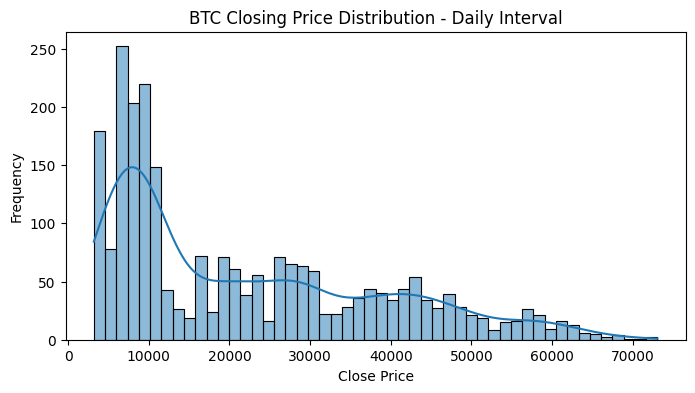

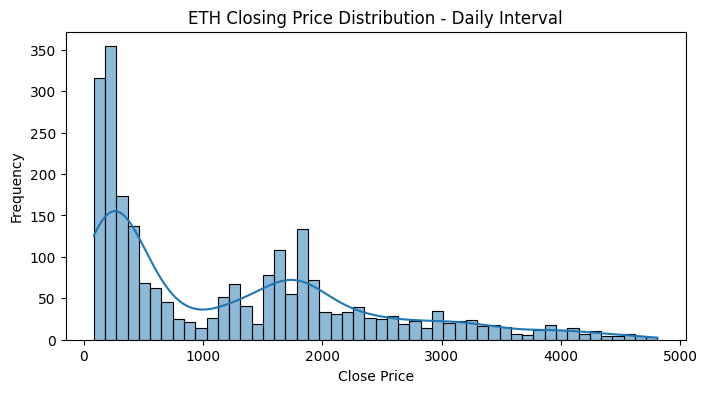

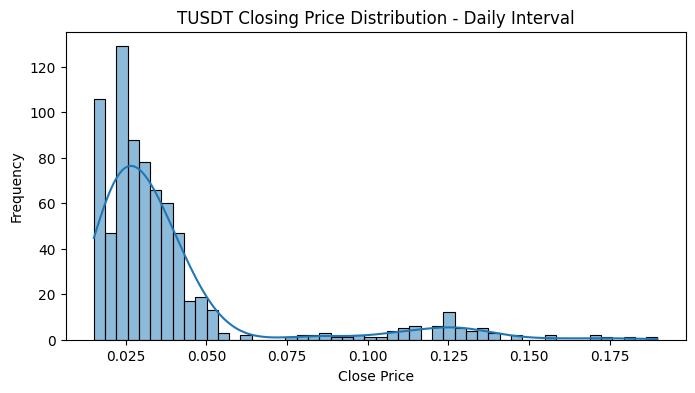

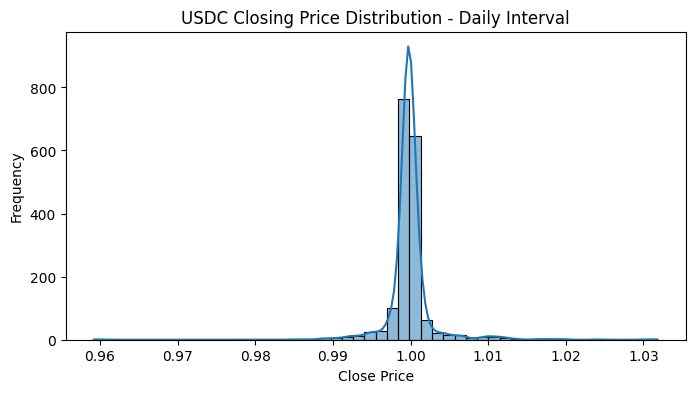

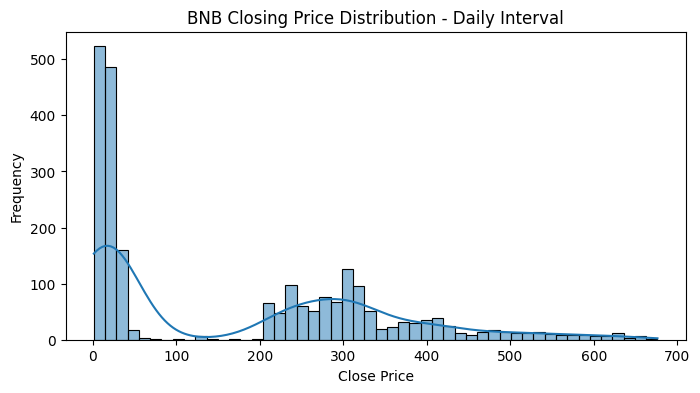

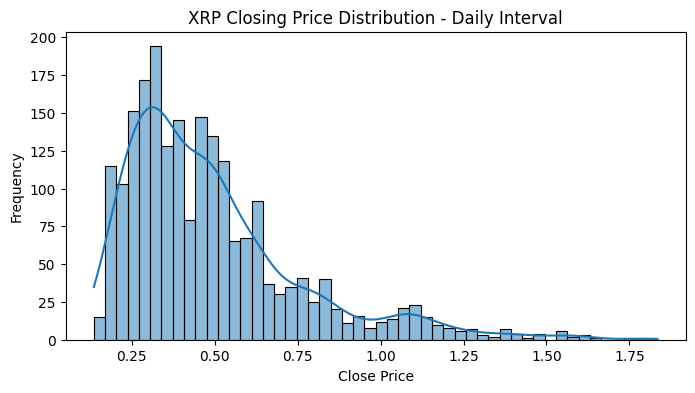

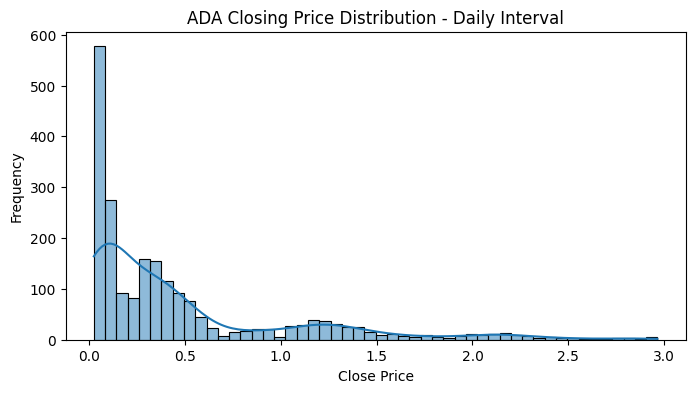

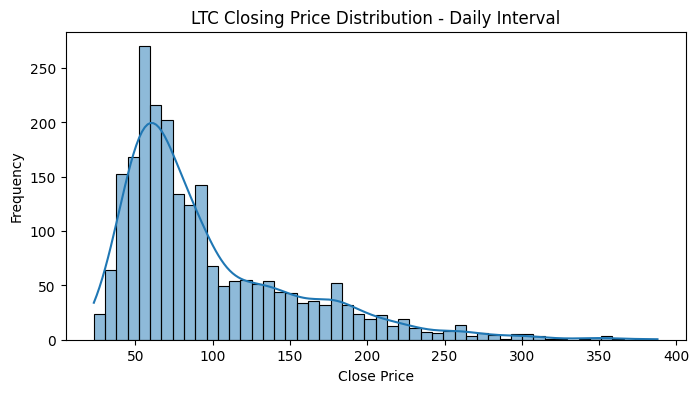

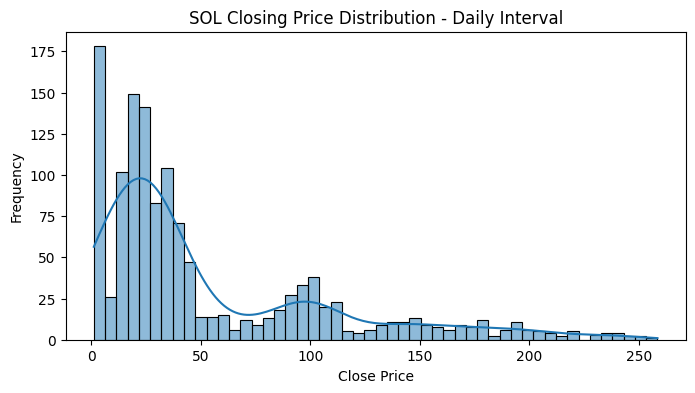

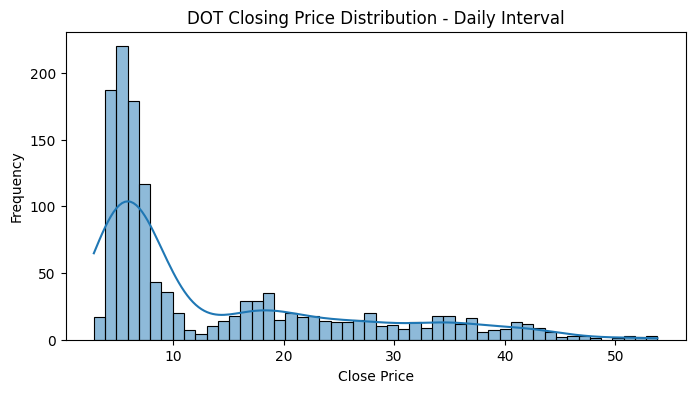


--- Distribution of Closing Prices (Hourly Interval) ---


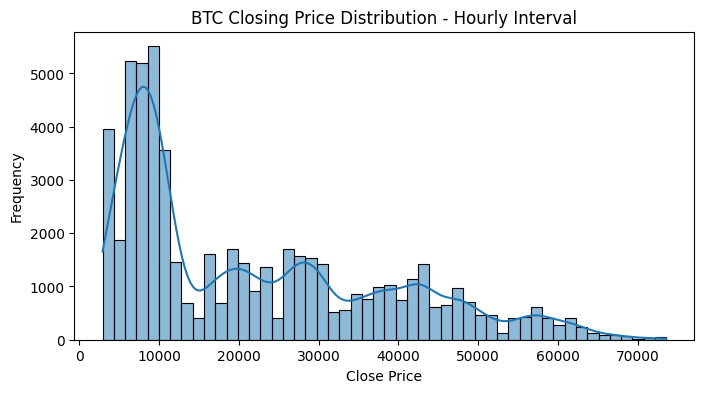

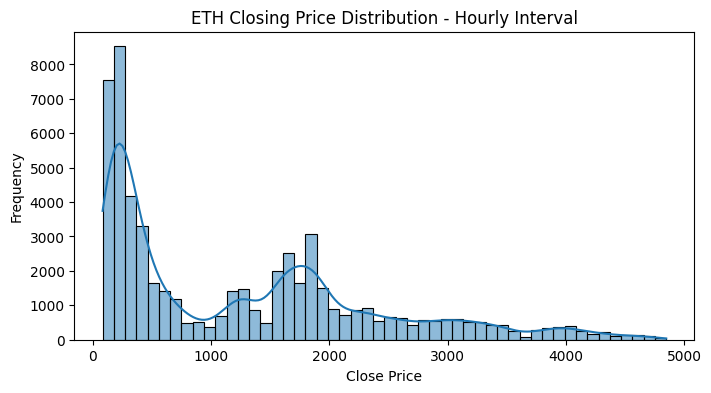

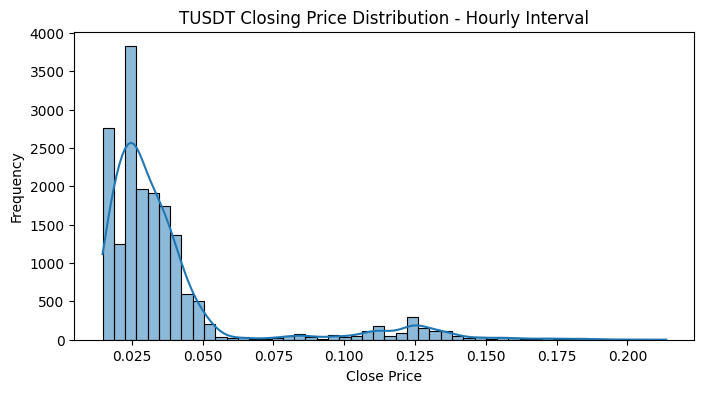

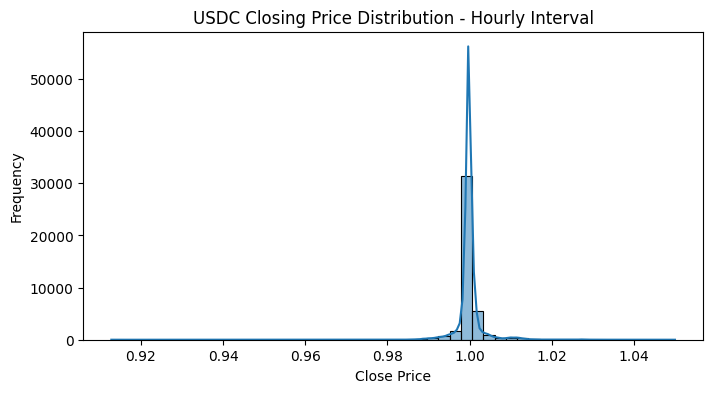

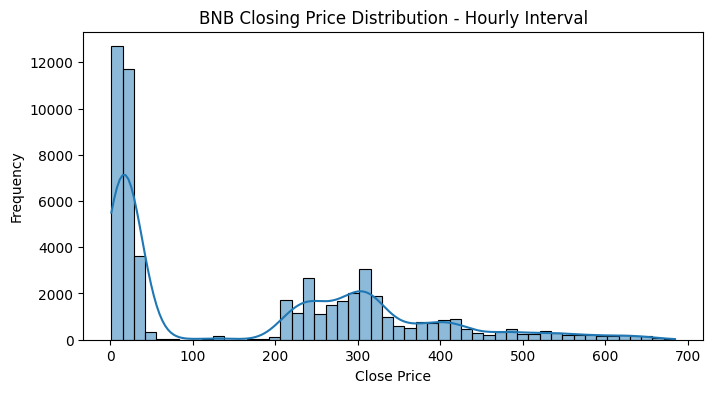

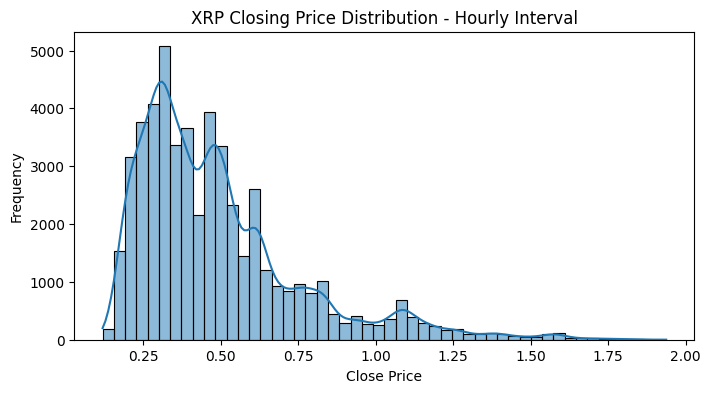

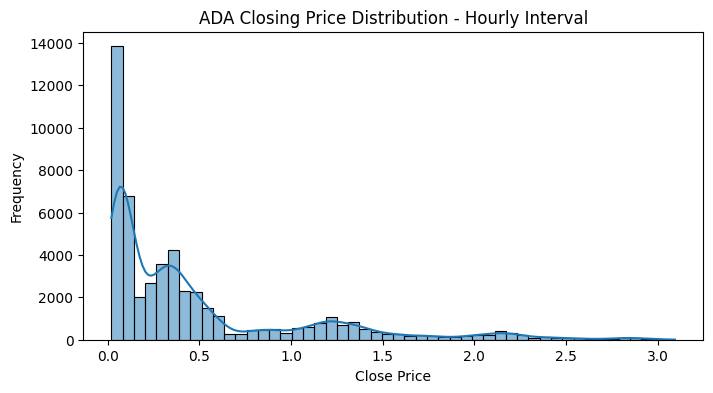

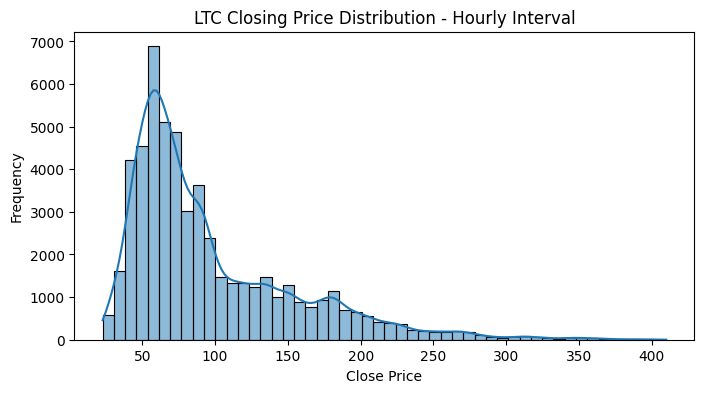

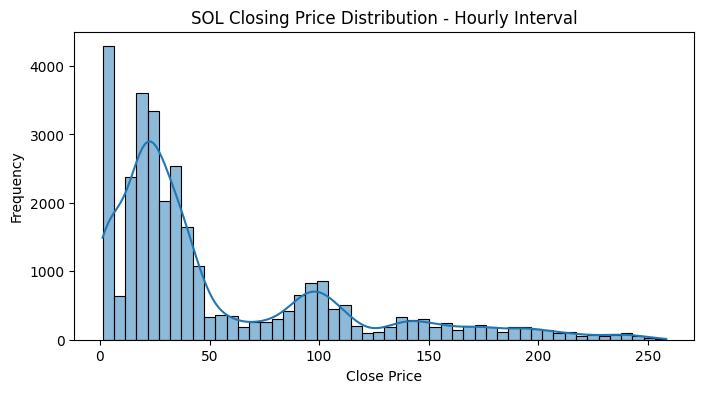

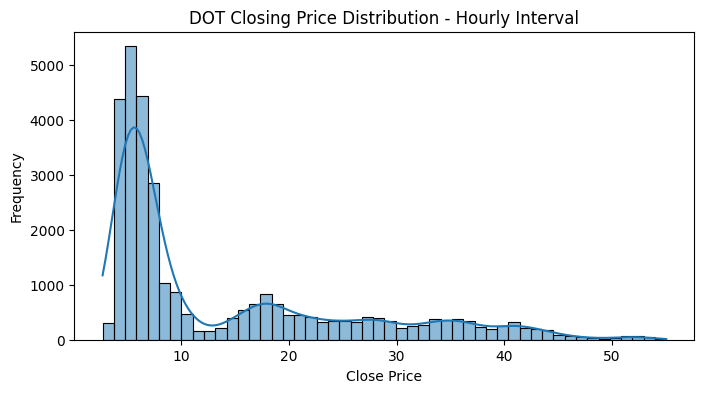


--- Distribution of Closing Prices (4-Hourly Interval) ---


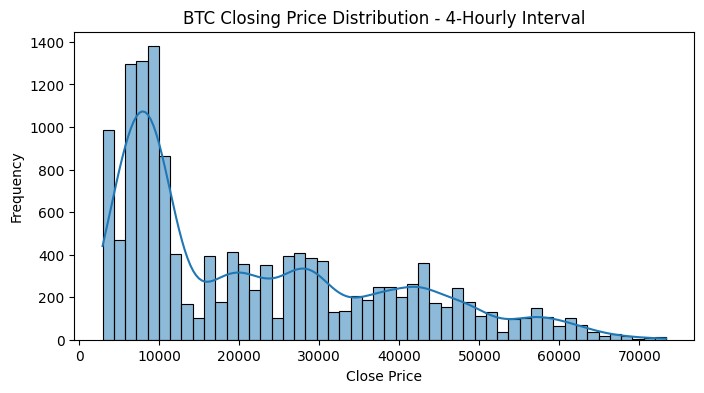

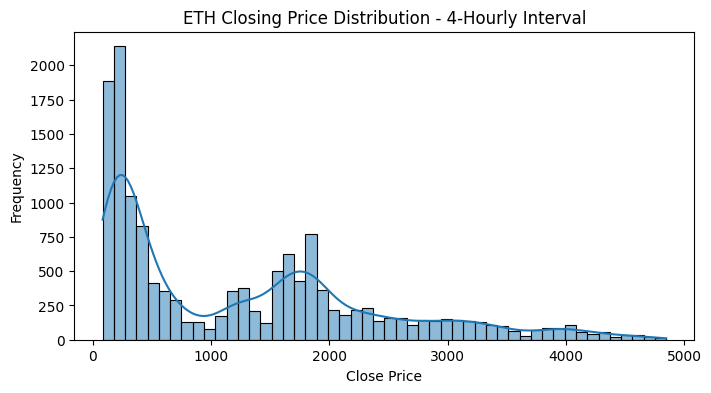

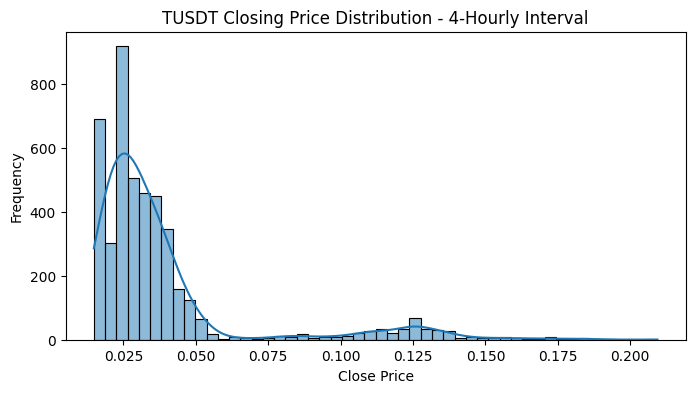

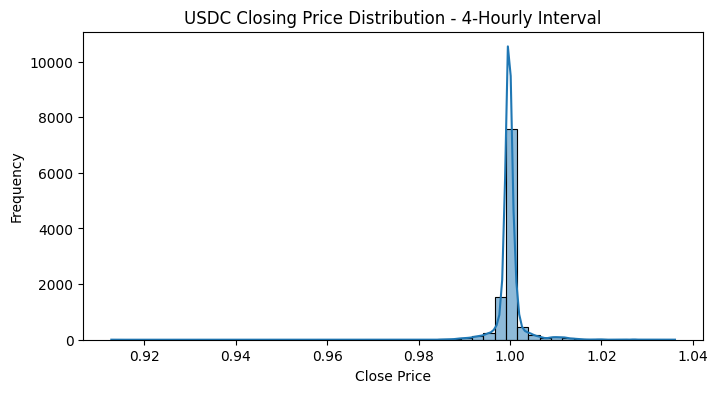

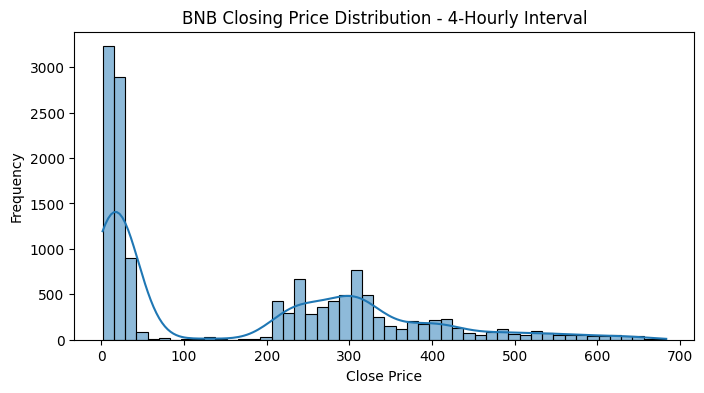

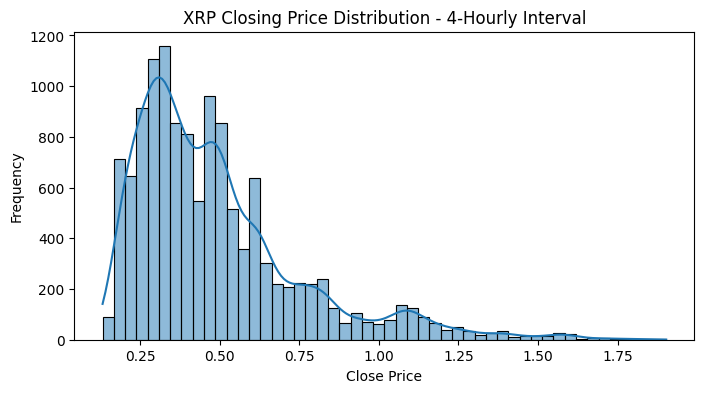

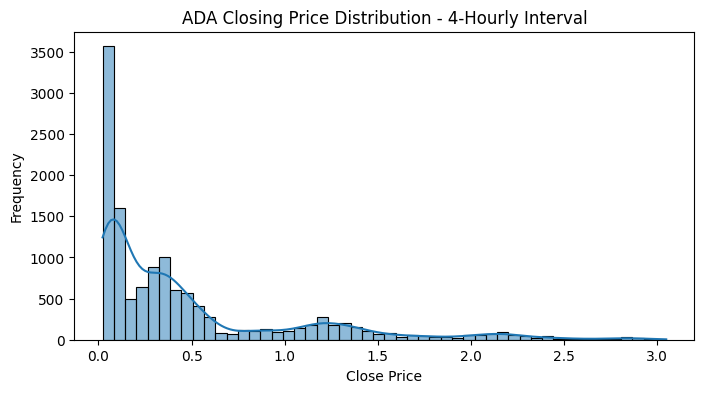

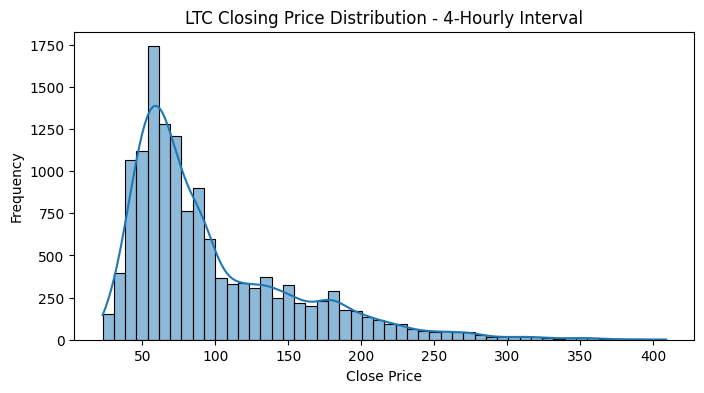

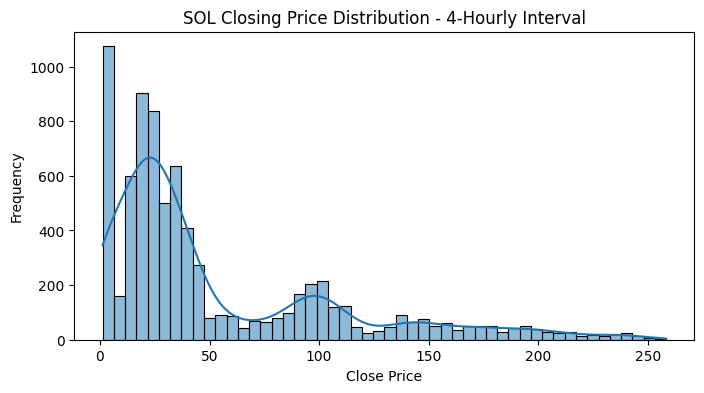

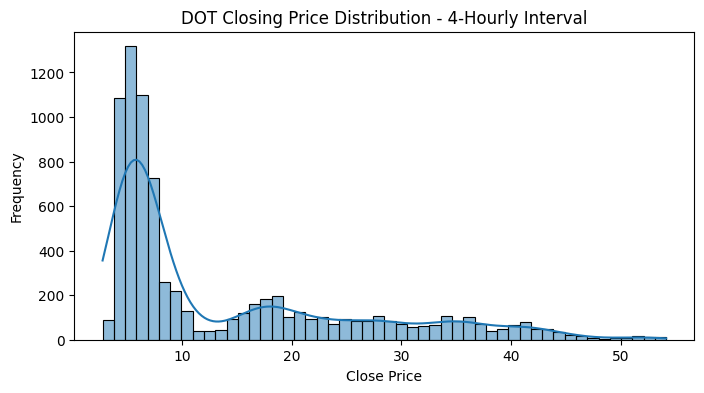


--- Distribution of Closing Prices (5-Minute Interval) ---


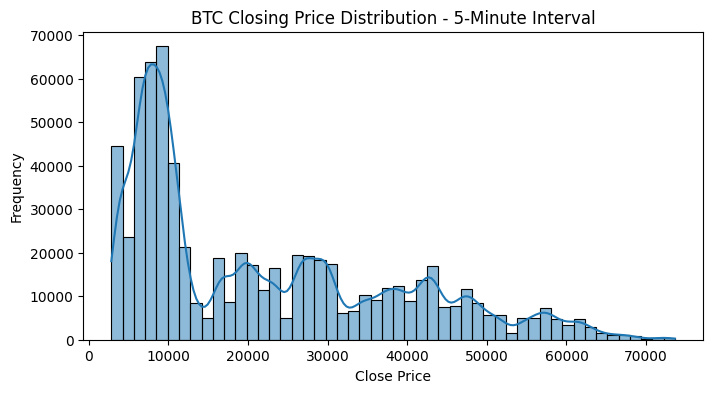

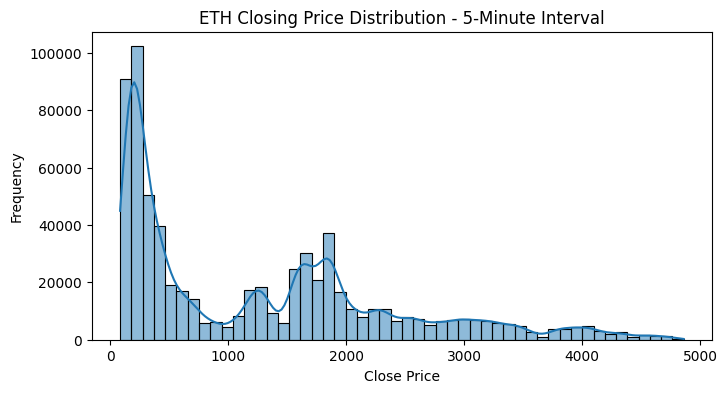

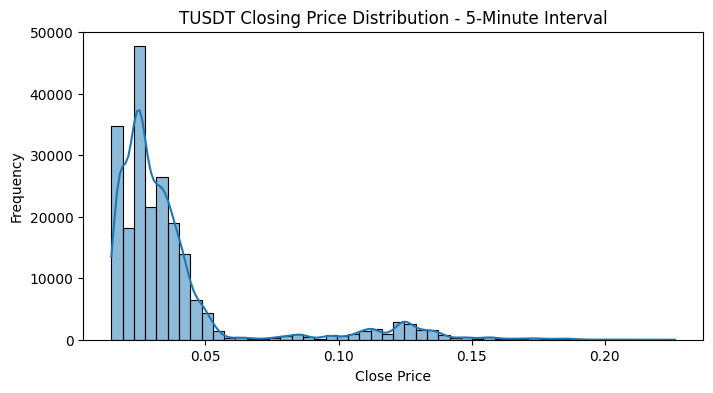

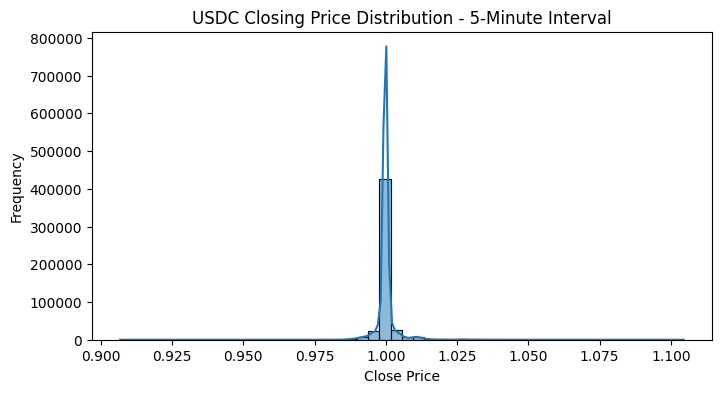

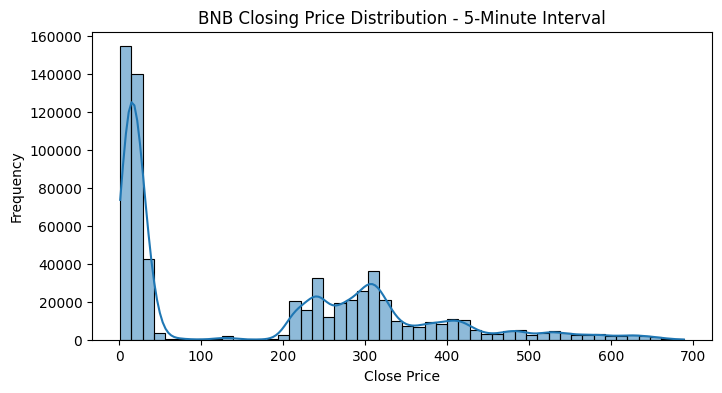

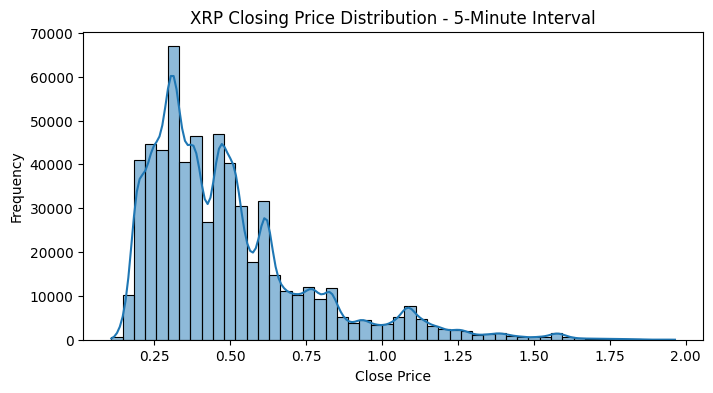

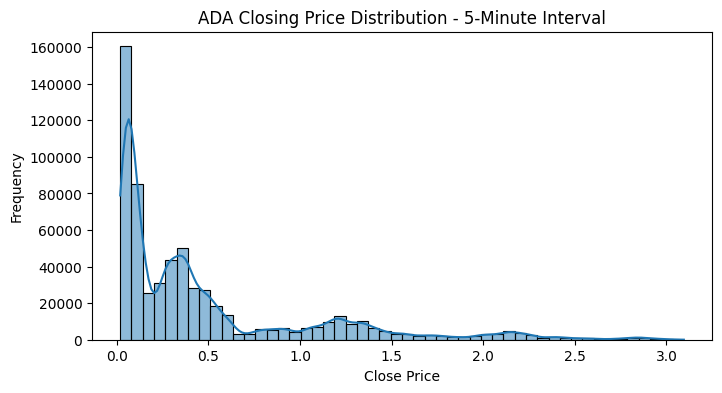

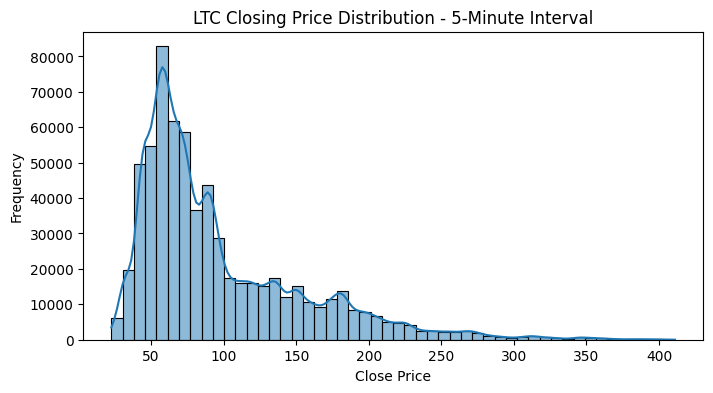

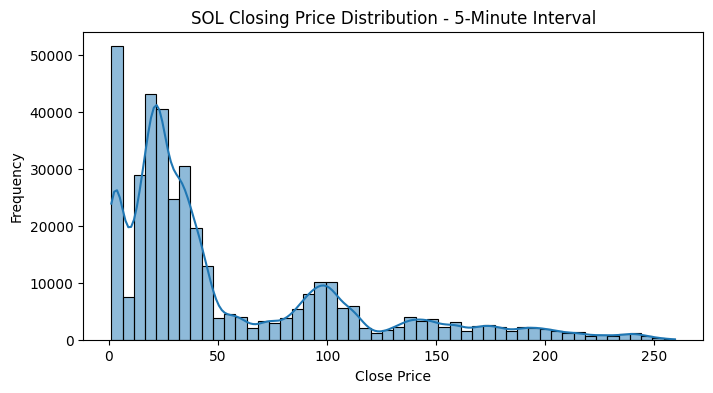

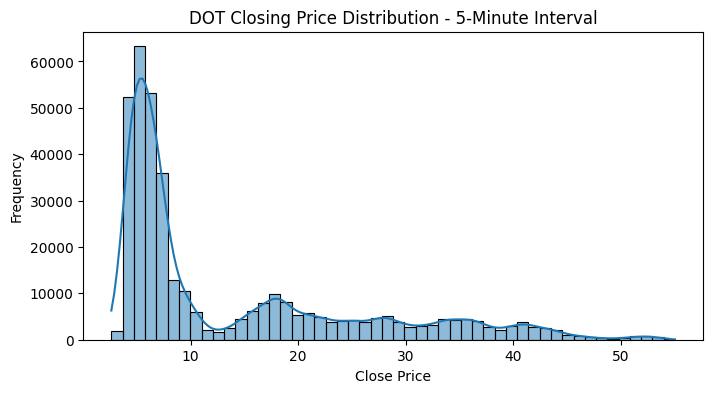


--- Distribution of Closing Prices (15-Minute Interval) ---


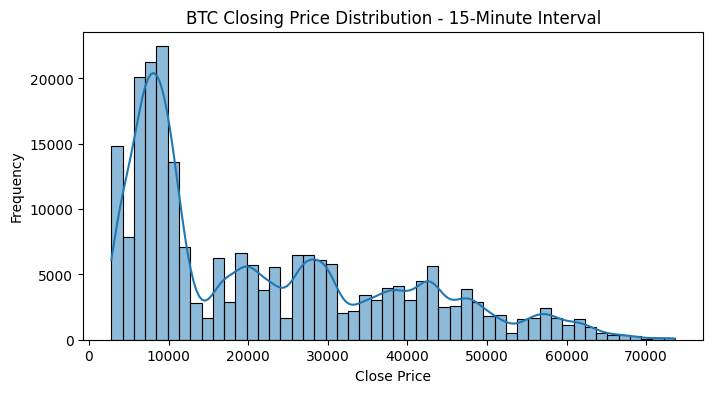

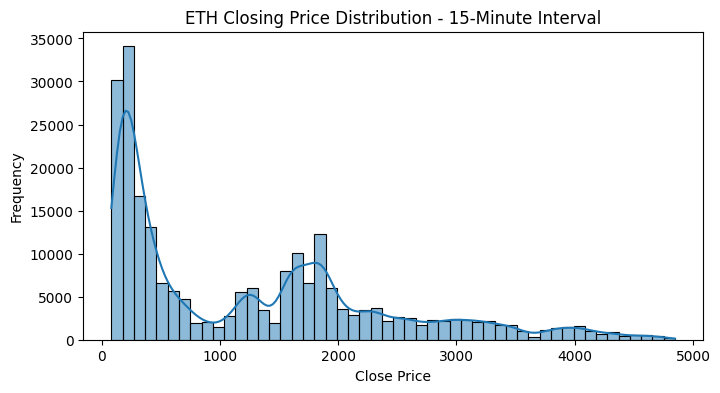

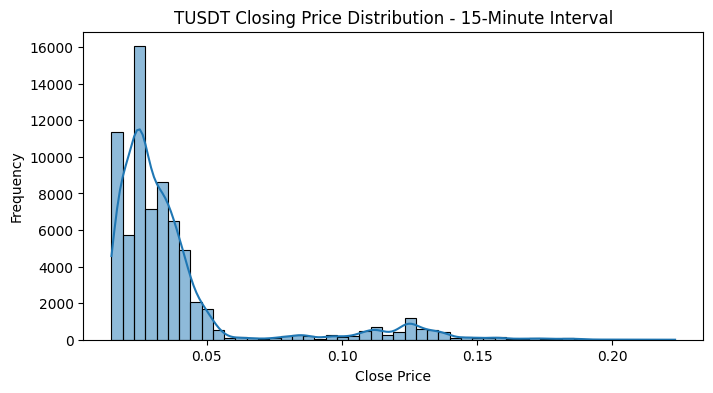

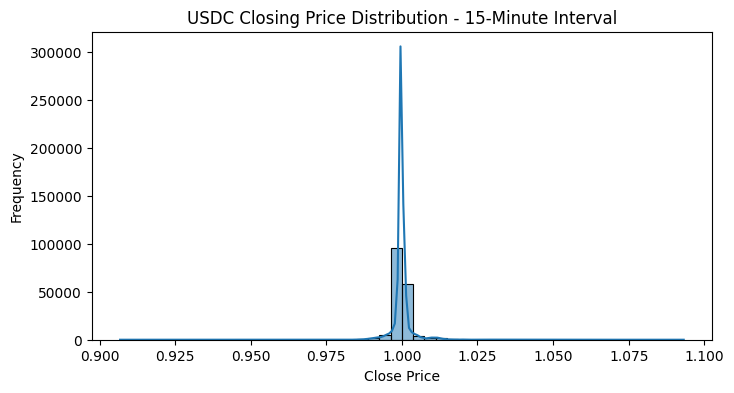

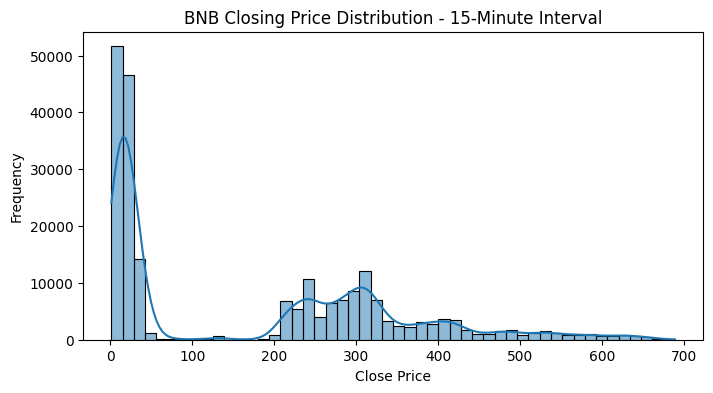

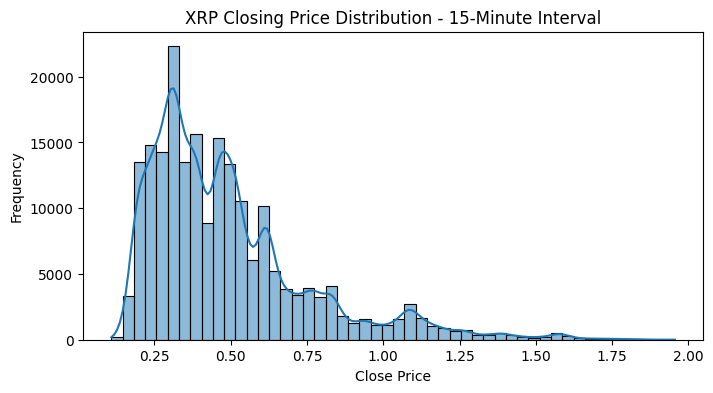

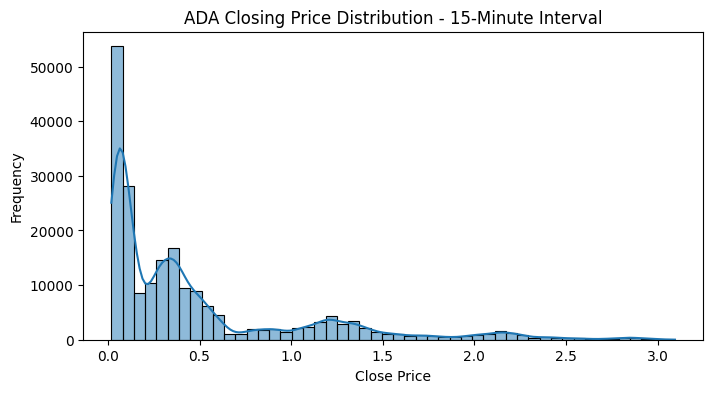

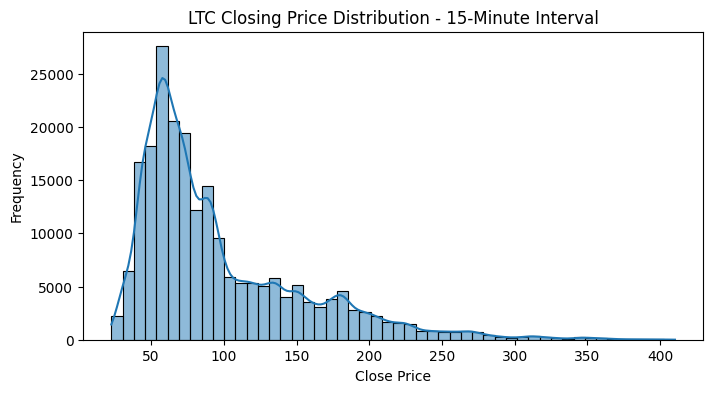

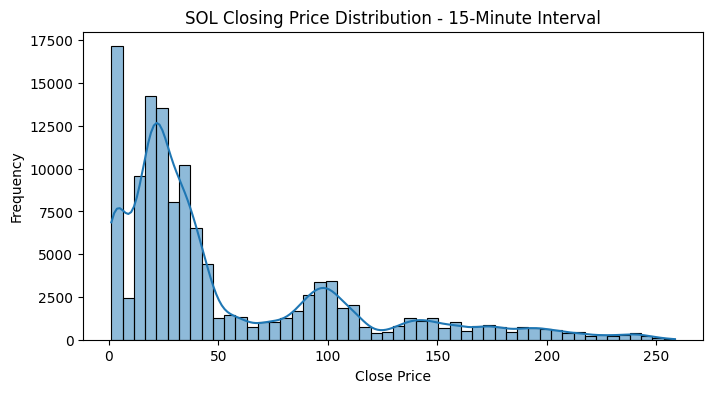

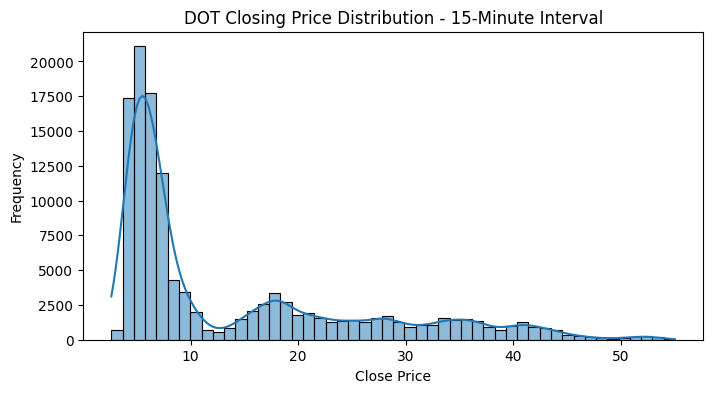


--- Distribution of Closing Prices (30-Minute Interval) ---


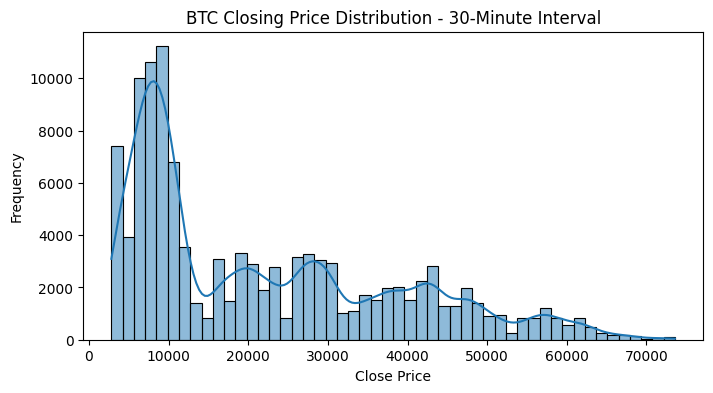

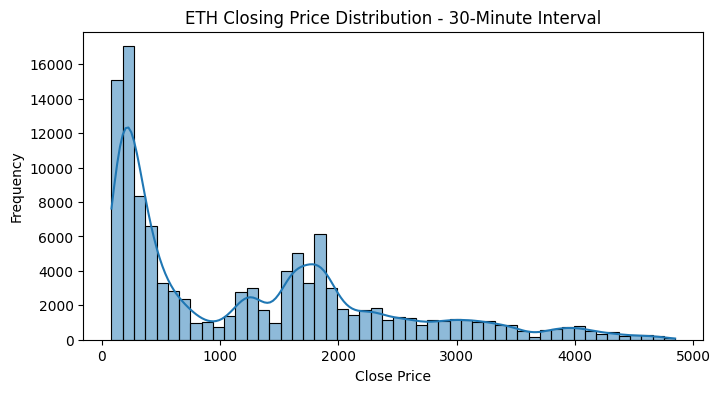

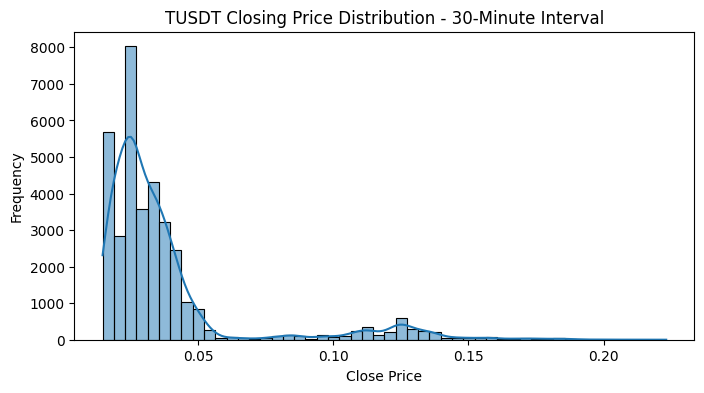

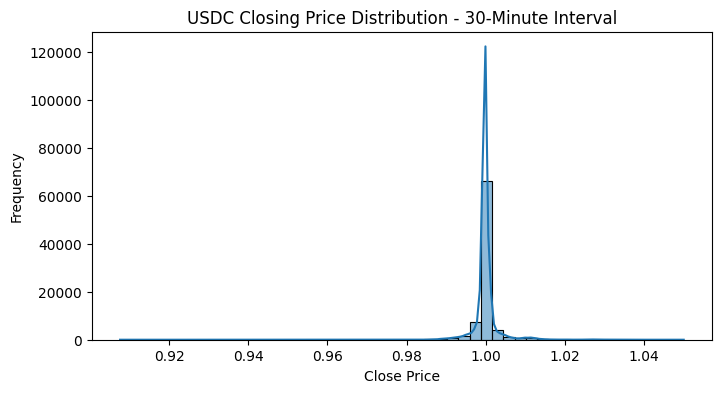

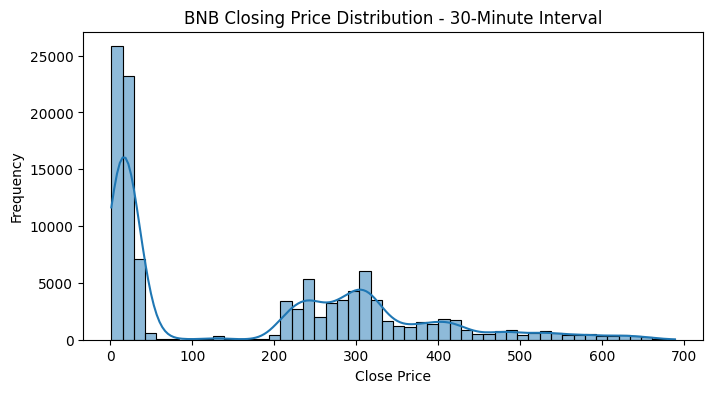

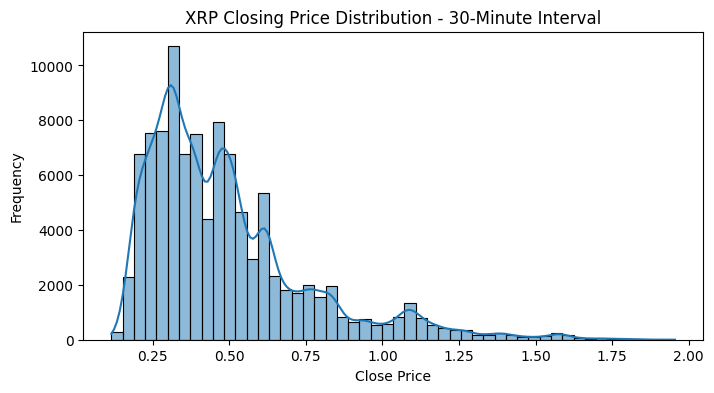

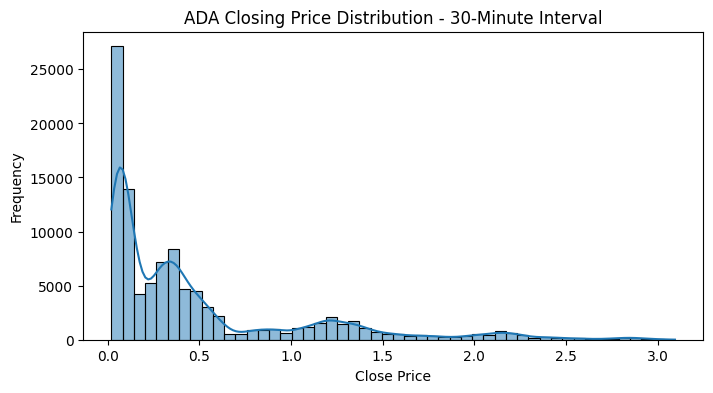

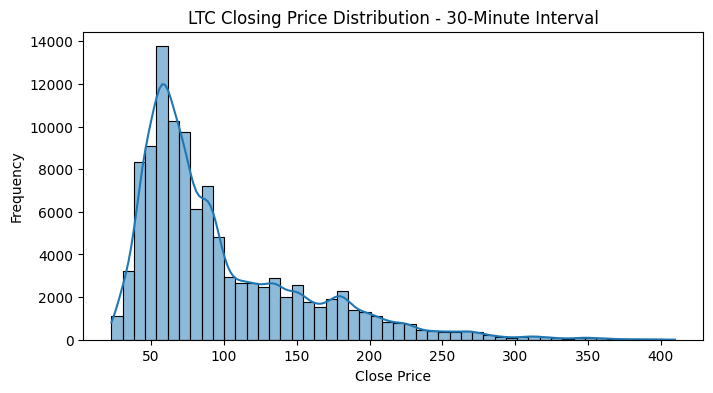

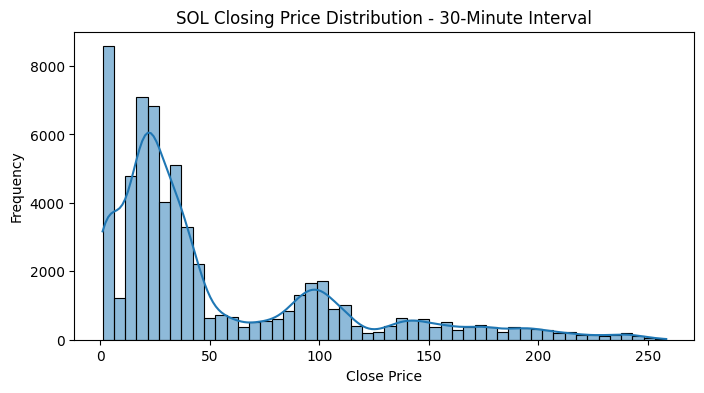

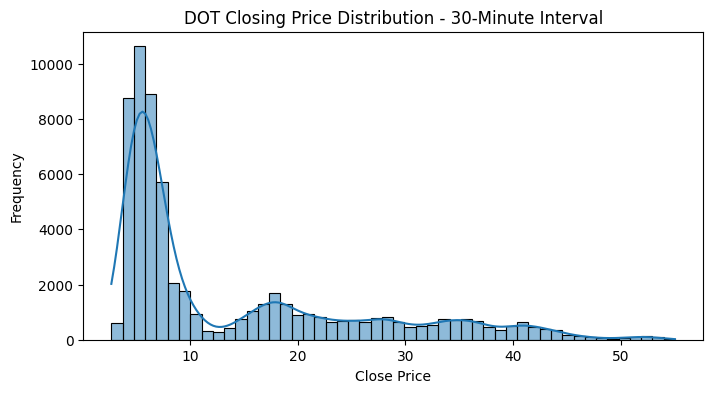


--- Distribution of Closing Prices (Weekly Interval) ---


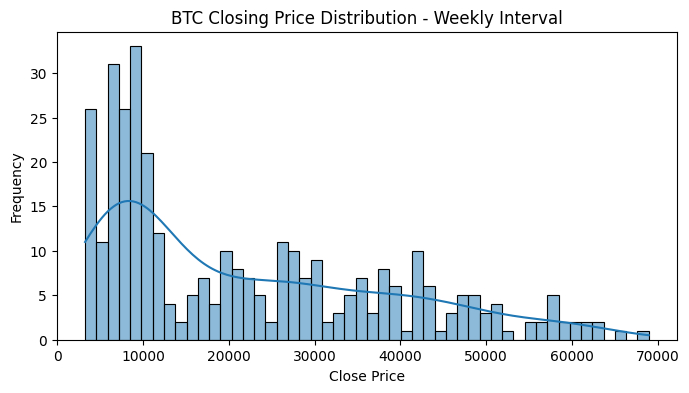

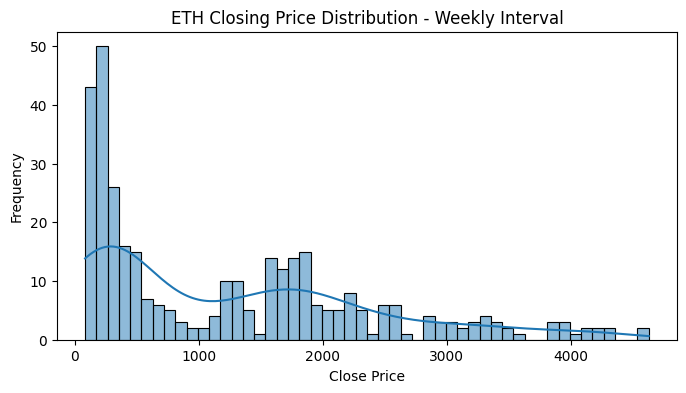

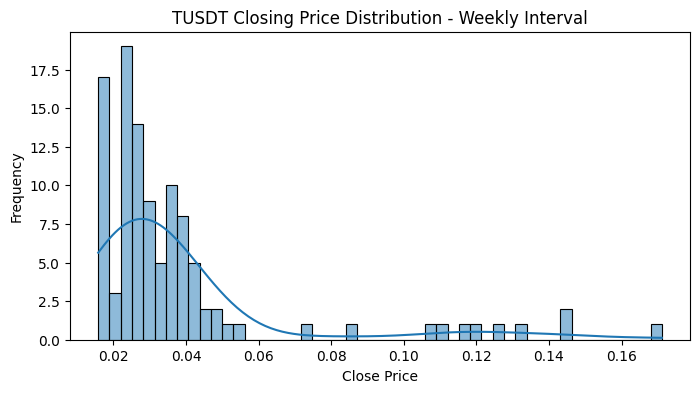

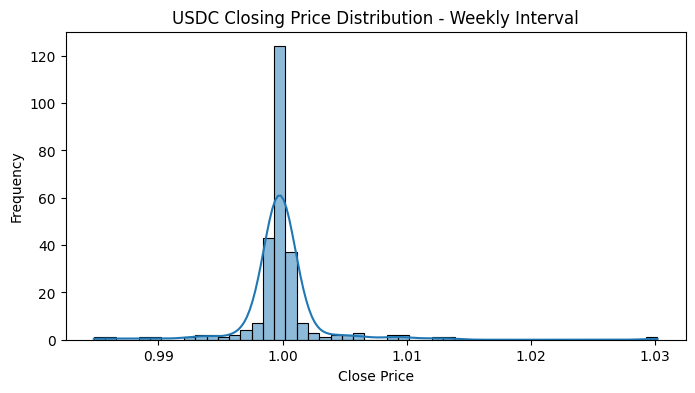

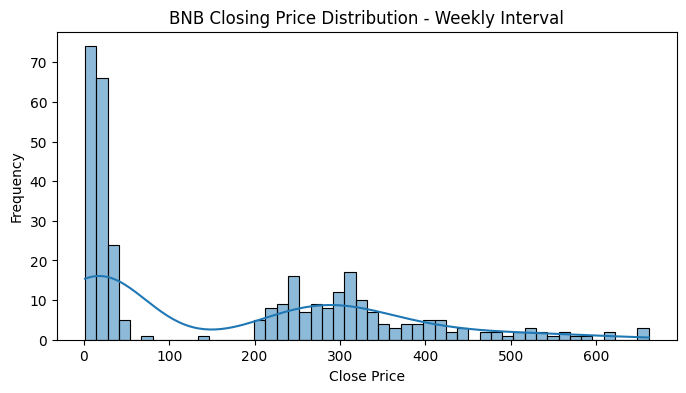

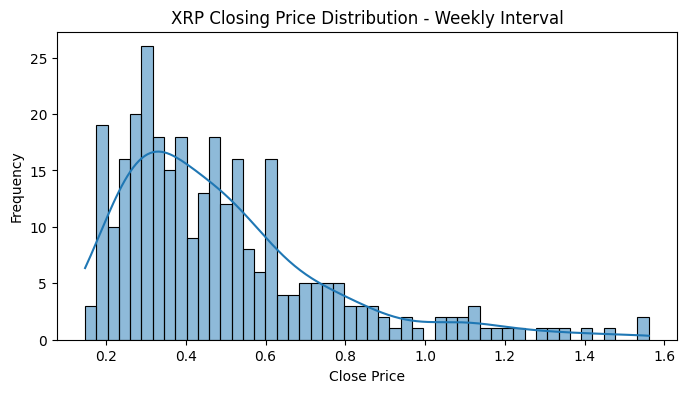

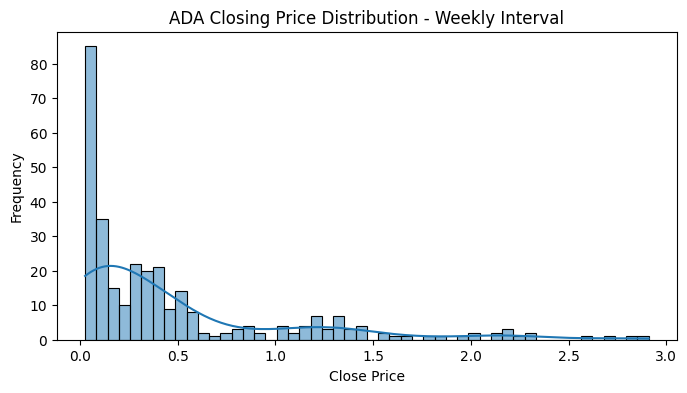

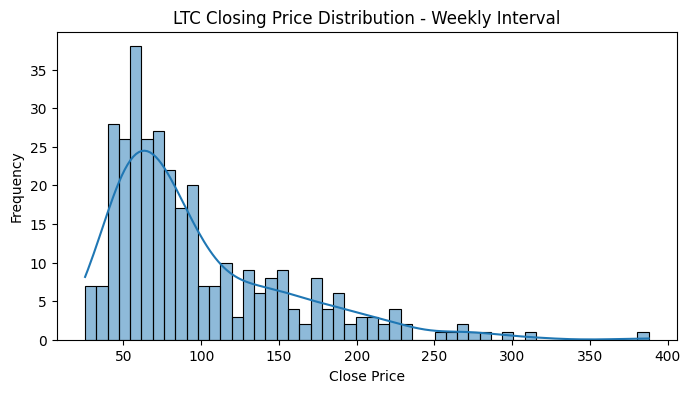

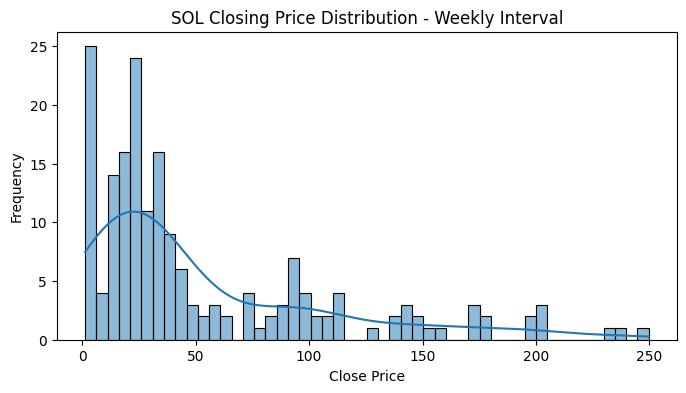

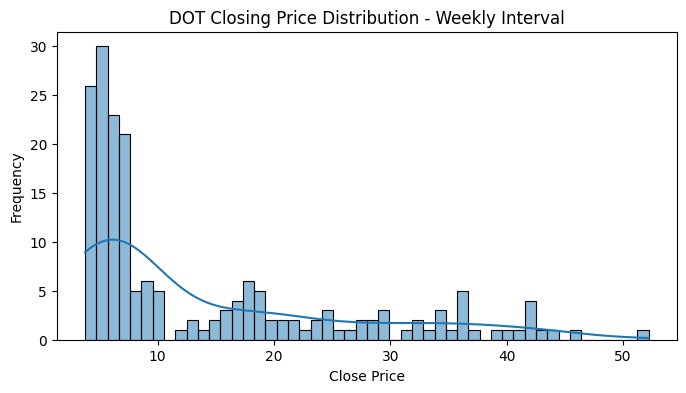

In [ ]:
# Distribution plot for closing prices for each cryptocurrency by interval
for interval, folder_name in intervals.items():
    print(f"\n--- Distribution of Closing Prices ({folder_name} Interval) ---")
    for crypto, data in interval_data[interval].items():
        if data.empty:
            print(f"No data for {crypto} in {folder_name} interval.")
            continue

        plt.figure(figsize=(8, 4))
        sns.histplot(data['close'], bins=50, kde=True)
        plt.title(f'{crypto} Closing Price Distribution - {folder_name} Interval')
        plt.xlabel('Close Price')
        plt.ylabel('Frequency')
        plt.show()


### Distribution of Closing Prices for Daily Intervals:

   1. Bitcoin (BTC):

      - The BTC closing prices distribution shows a right-skewed pattern, with a majority of trading days concentrated at lower price levels.

      - There are significant frequencies in the $5,000 to $20,000 range, with a noticeable decline in frequency as prices move beyond $30,000, reflecting BTC's historical volatility and price growth phases over time.

      - This distribution suggests that BTC has experienced both periods of price stability and sharp increases, consistent with its volatile market cycles.

--------------------------------------------------------------------------------

  2. Ethereum (ETH):

     - ETH’s distribution is also right-skewed, with a prominent frequency of trading days at lower price levels, especially below $1,000.
     
     - There are multiple peaks, indicating periods where ETH’s price remained stable at specific ranges, likely reflecting market sentiment during different adoption phases.

     - The multimodal nature suggests that ETH has experienced several market cycles, with prices clustering around distinct levels before reaching new highs.

--------------------------------------------------------------------------------


 3. Tether (TUSDT):

    - TUSDT's distribution is highly concentrated around the $0.025 to $0.05 range, showing a peaked, narrow distribution that reflects its stablecoin nature.

    - The distribution suggests minimal price fluctuations, as TUSDT is designed to maintain a relatively stable value, serving primarily as a dollar-pegged cryptocurrency.


--------------------------------------------------------------------------------


4. USD Coin (USDC):

   - The USDC distribution is very narrow, highly peaked around $1.00, which is typical for a stablecoin.

   - This tight clustering around $1 indicates USDC’s stability as a dollar-pegged stablecoin, maintaining value with minimal fluctuations.


--------------------------------------------------------------------------------


5. Binance Coin (BNB):

   - BNB displays a right-skewed and multimodal distribution, with peaks around different price ranges.

   - This pattern reflects multiple phases of market demand, with price stability around specific levels before moving to higher ranges.

   - The distribution captures BNB's growth, especially as its utility expanded within the Binance ecosystem, influencing its valuation over time.


--------------------------------------------------------------------------------


6. Ripple (XRP):

   - XRP’s distribution is right-skewed, with a higher frequency of trading days at lower price levels.

   - There’s a concentration around 0.25 to 0.75 dollars, with a long tail extending to higher prices, reflecting XRP’s volatility and market cycles.

   - The distribution suggests XRP has experienced sharp price increases on fewer occasions, typical for assets influenced by both utility and speculation.

--------------------------------------------------------------------------------


7. Cardano (ADA):

   - ADA exhibits a right-skewed, unimodal distribution with most trading days clustered at lower prices, particularly below $1.

   - There’s a peak around 0.1 to 0.5 dollars, with a decline in frequency for prices above $1, reflecting ADA’s adoption phases and market sentiment shifts.

   - The distribution implies ADA has grown in stages, with notable stability at lower price levels.


--------------------------------------------------------------------------------


8. Litecoin (LTC):

   - LTC’s closing prices are right-skewed, with most trading days concentrated in the 50 to 100 dollar range.

   - The distribution suggests that while LTC has experienced periods of growth, its trading levels have largely remained within this range over time.

   - There is a decline in frequency as prices increase, reflecting fewer instances of high valuations, typical for established but less volatile assets.

--------------------------------------------------------------------------------


9. Solana (SOL):

   - SOL displays a right-skewed distribution, with trading days mostly below $50, reflecting its relatively newer presence in the market.

   - The distribution has multiple peaks, indicating that SOL's valuation shifted as it gained adoption, especially around the 20 to 50 dollar range.

   - This pattern suggests that SOL has seen rapid growth with some periods of stability at specific price levels, reflecting market interest in newer blockchain projects.

--------------------------------------------------------------------------------


10. Polkadot (DOT):

    - DOT’s distribution is right-skewed with most prices below $20, and a peak around $5 to $10.

    - The long tail indicates that while higher prices have been achieved, they are less frequent, consistent with its early adoption and market cycles.

    - DOT’s distribution suggests significant clustering around initial adoption prices, with higher valuations occurring during market peaks.

---------------------------------------X----------------------------------------



### Distribution of Closing Prices for Hourly Intervals:

  1. Bitcoin (BTC):

     - The distribution shows a right-skewed pattern, with the majority of prices concentrated around 10,000 – 20,000, but with a significant tail extending up to $70,000, reflecting BTC's high volatility.

--------------------------------------------------------------------------------


2. Ethereum (ETH):

   - The distribution is also right-skewed, with a high frequency around the $500–$1,000 range, showing sporadic increases in the $2,000 – $3,000 range.

   - This pattern highlights ETH's substantial price growth phases.

--------------------------------------------------------------------------------


3. Tether (TUSDT):

   -  Tether's distribution is heavily right-skewed with most values around $0.025 to 0.05, reflecting its stability as a stablecoin, with occasional minor fluctuations.

--------------------------------------------------------------------------------


4. USD Coin (USDC):

   - The distribution is sharply peaked and highly concentrated around $1, indicating its role as a stablecoin with minimal deviation from its pegged value.


--------------------------------------------------------------------------------


5. Binance Coin (BNB):

   - BNB shows a multi-modal distribution with prominent price ranges around $50–$100 and $300–$400, indicating phases of growth and stabilization in its price trajectory.

--------------------------------------------------------------------------------


6. Ripple (XRP):
   
  - XRP has a right-skewed distribution, with most prices concentrated below 1 dollar, demonstrating its relative stability compared to more volatile cryptocurrencies, though it has occasionally exceeded $1.

--------------------------------------------------------------------------------


7. Cardano (ADA):

   - ADA's distribution is right-skewed, with prices predominantly under 1 dollar, but it has sporadic increases up to $3, reflecting periods of growth in its value.

--------------------------------------------------------------------------------


8. Litecoin (LTC):

   - The distribution for LTC is right-skewed with a concentration around $50–$100, suggesting consistent lower values with occasional peaks up to $400.

--------------------------------------------------------------------------------


9. Solana (SOL):

   - SOL's distribution is heavily skewed to the right, with the majority of prices below $50 and intermittent increases, indicating sharp but infrequent price surges.

--------------------------------------------------------------------------------


10. Polkadot (DOT):

    -  DOT shows a concentration of prices under 10 Dollars with occasional spikes to $50, displaying a similar skewed distribution that highlights both stability and volatility phases.

---------------------------------------X----------------------------------------

### Distribution of Closing Prices for 4-Hourly Intervals:

  1. BTC (Bitcoin):

     - The distribution of BTC's closing price at the 4-hourly interval is positively skewed, with a peak around the lower price levels, particularly between $5,000 and $15,000.

     - The distribution shows a long tail extending toward higher price levels, indicating a few instances of higher prices up to around $70,000.

--------------------------------------------------------------------------------


  2. ETH (Ethereum):

     - Similar to BTC, ETH's distribution is positively skewed, with a high frequency of prices clustered around lower values, particularly between $0 and $1,000.

     - The distribution tail extends toward higher price levels, with prices occasionally reaching around $4,000.


--------------------------------------------------------------------------------


   3. TUSDT (Tether):

      - TUSDT's distribution is heavily skewed towards lower values, with the majority of prices clustered around $0.02 to $0.05.

      - The distribution is narrow with occasional higher prices but remains relatively stable around its initial cluster.

--------------------------------------------------------------------------------


 4. USDC (USD Coin):

    - USDC's distribution is highly concentrated around the $1.00 mark, showing a stable, near-normal distribution around this value.

    - This consistency aligns with its status as a stablecoin pegged to the USD.

--------------------------------------------------------------------------------


 5. BNB (Binance Coin):

    - BNB's price distribution is positively skewed, with a peak around lower prices, especially between $0 and $100.

    - The distribution gradually extends to higher values, with prices reaching around $600.

--------------------------------------------------------------------------------


6. XRP (Ripple):

   -  XRP’s distribution is concentrated around lower price levels, particularly between 0.25 and $0.75. Similar to other coins, the distribution is positively skewed, with fewer instances of higher prices.

--------------------------------------------------------------------------------


7. ADA (Cardano):

   - ADA's distribution is heavily concentrated at lower prices, especially around 0 to $0.5.

   -  The distribution has a long tail extending to around $3, suggesting that higher prices are less frequent.

--------------------------------------------------------------------------------


8. LTC (Litecoin):

   - LTC’s price distribution at the 4-hourly interval shows a positive skew, with most prices concentrated between 50 and $100.

   - The distribution extends to higher prices, occasionally reaching up to $400.

--------------------------------------------------------------------------------


9. SOL (Solana):

   - SOL’s distribution is concentrated at lower price points, especially around 0 to $50.

   -  The tail extends to higher prices, reaching around $250, showing occasional spikes in price.

--------------------------------------------------------------------------------


10. DOT (Polkadot):

    - DOT's distribution is positively skewed with a peak around lower prices, particularly between $5 and $10.

    - There are a few instances of prices reaching up to around $50, indicating some price variability but with fewer occurrences.

---------------------------------------X----------------------------------------





### Distribution of Closing Prices for 5-Minute Intervals:


 1. Bitcoin (BTC):

    - The distribution is heavily right-skewed with a high concentration around lower prices, predominantly between $0 to $10,000, with frequency gradually tapering as the price increases.
    
    -  This skewness reflects a clustering of trading at lower price levels, while higher prices are less frequently observed.


--------------------------------------------------------------------------------


2. Ethereum (ETH):

   - Similar to BTC, ETH's distribution is also right-skewed, with a peak around lower price ranges, specifically from 0 to $500.

   - The frequency decreases as the price level increases, indicating that most trading activity occurred at lower price levels.


--------------------------------------------------------------------------------


3. Tether (TUSDT):

   - The distribution shows a strong peak around the 0.025 to $0.05 range, which is in line with Tether’s stable price range.

   - The frequency diminishes quickly beyond this range, with very few instances above $0.10, showing stability around a lower price range typical for stablecoins.

--------------------------------------------------------------------------------


4. USD Coin (USDC):

   - USDC exhibits a very tight distribution around the $1 mark, as expected for a stablecoin pegged to the US dollar.

   - There is minimal deviation, with almost all closing prices clustering around $1, affirming its stability.

--------------------------------------------------------------------------------


5. Binance Coin (BNB):

   - BNB has a long right tail with a peak in the lower price range near 0 to $100, and a gradual decrease in frequency as the price rises.

   - This distribution indicates that most trades occur at lower price levels, with decreasing activity at higher prices.

--------------------------------------------------------------------------------


6. Ripple (XRP):

   - XRP's distribution is heavily right-skewed, with the highest frequency of trades concentrated around the 0.25 to $0.50 range.

   - There are occasional higher prices, but these are less frequent, indicating concentrated activity in the lower price bracket.

--------------------------------------------------------------------------------


7. Cardano (ADA):

   - ADA shows a sharp peak at the lower end, particularly around 0.10 to $0.50, and gradually decreases as prices increase.

   - The distribution is right-skewed, which is typical for lower-priced altcoins.

--------------------------------------------------------------------------------


8. Litecoin (LTC):

   - LTC also follows a right-skewed distribution, with most closing prices clustering around 50 to $100.

   - There is a gradual reduction in frequency at higher prices, with fewer trades as the price exceeds $100.

--------------------------------------------------------------------------------


9. Solana (SOL):

   - SOL's distribution is concentrated around the $0 to $50 range, with a decline in frequency as prices rise.

   - Like other altcoins, this distribution indicates that trading activity is more frequent at lower price levels.

--------------------------------------------------------------------------------


10. Polkadot (DOT):

   - DOT has a peak in frequency around the $5 to $10 range, with frequency decreasing at higher prices.

   - This right-skewed distribution suggests most trading activity happens at lower prices.

---------------------------------------X----------------------------------------

### Distribution of Closing Prices for 15-Minute Intervals:

  1. BTC (Bitcoin):

     - The distribution shows a right-skewed pattern, with a majority of the closing prices clustered below $20,000.

     - There is a secondary mode around $40,000, indicating significant trading activity at that level, but the frequency diminishes as prices go higher.

--------------------------------------------------------------------------------


2. ETH (Ethereum):

   - The distribution is heavily right-skewed, with a large concentration of closing prices below $1,000.

   - There is some trading activity peaking around $2,000 but reduces sharply beyond this level.

--------------------------------------------------------------------------------


3. TUSDT (Tether):

   - Tether's closing price distribution is tightly clustered around 0.025 to $0.05, reflecting its stablecoin nature and minimal volatility, with most prices concentrated near a narrow range.

--------------------------------------------------------------------------------

4. USDC (USD Coin):

   - The distribution is sharply peaked at around $1.00, consistent with its stablecoin purpose, with very low deviation.

   - This reflects its role as a fiat-backed stablecoin maintaining a peg close to $1.

--------------------------------------------------------------------------------

 5. BNB (Binance Coin):

    - The distribution is skewed to the right, with most of the prices concentrated under $100, but with notable activity up to $300-$400, likely reflecting Binance Coin's price growth and volatility.

--------------------------------------------------------------------------------

6. XRP (Ripple):

  - Most of the trading activity is concentrated below  1.00 dollar, with a few higher peaks around 0.25 and $0.5, showing volatility within a narrow range, typical of XRP's price behavior.


--------------------------------------------------------------------------------


7. ADA (Cardano):

   - Cardano's distribution shows clustering below 0.5, with some activity up to $1, indicating concentrated trading within a lower price range.

--------------------------------------------------------------------------------


8. LTC (Litecoin):
   
   -  Most closing prices are below 100, with a long tail reaching up to $400, indicating Litecoin's occasional volatility but with most prices staying in a lower range.

--------------------------------------------------------------------------------


9. SOL (Solana):

   - Solana has a right-skewed distribution, with a large concentration below 50. There is some spread up to $100, indicating price growth phases in the past.

--------------------------------------------------------------------------------


10. DOT (Polkadot):

    - The distribution is right-skewed, with most activity below $20, reflecting trading behavior in a relatively low price range compared to other cryptocurrencies.

### Distribution of Closing Prices for 30-Minute Intervals:

  1. BTC (Bitcoin):
     
    - Displays a positively skewed distribution.

    - Most frequent closing prices are clustered around $10,000 to $15,000, with a long tail extending up to $70,000, indicating some high-value peaks.

--------------------------------------------------------------------------------


2. ETH (Ethereum):

  - Shows a right-skewed distribution.

  - Frequent closing prices range between $0 to $1,000, with a significant frequency around 1,000 to $2,000.

  - The distribution has a tail up to around 5,000, reflecting Ethereum's price variations over time.

--------------------------------------------------------------------------------


3. TUSDT (Tether USD):

   - Characterized by a sharp peak around $0.03, indicating a highly concentrated value in this range.

   - The distribution quickly drops off, with a minor long tail extending up to $0.20.

--------------------------------------------------------------------------------

4. USDC (USD Coin):

   - Shows a very narrow, sharply peaked distribution centered around $1, reflecting its stablecoin nature.

   - Little deviation from this central value, with minimal fluctuation in closing prices.


--------------------------------------------------------------------------------


5. BNB (Binance Coin):

   - Positively skewed distribution with frequent values around 0 to $100.

   - Extended tail with periodic spikes around 200 to $400, showing some volatility in higher price ranges.

--------------------------------------------------------------------------------


6. XRP (Ripple):

   - Has a strong peak around $0.25, with a right-skewed distribution.

   - Secondary peaks and variations occur up to $1.00, with diminishing frequencies beyond this range.

--------------------------------------------------------------------------------


7. ADA (Cardano):

   - Exhibits a concentration around 0.00 to $0.50, with a significant skew to the right.

   - Tail extends to around 3.00, though frequencies drop notably after $1.00.


--------------------------------------------------------------------------------


8. LTC (Litecoin):

   - Displays a peak around 50 to $100 with a right-skewed distribution.
    
  - Values extend up to $400, indicating that while the majority of trades happen at lower values, there are occasional spikes.


--------------------------------------------------------------------------------


9. SOL (Solana):

   - High concentration of prices around 0 to $50.

   - Extended tail with secondary peaks, reflecting occasional higher price points reaching up to $250.

--------------------------------------------------------------------------------


10. DOT (Polkadot):

    - Shows a peak at 5 to $10, with a right-skewed distribution.

    - Frequency diminishes gradually with a tail extending to around $50, indicating price variations within this range.


---------------------------------------X----------------------------------------

### Distribution of Closing Prices for Weekly Intervals:

   1. Bitcoin (BTC):

      - The distribution of BTC's closing prices is right-skewed, with the highest frequencies in the lower price ranges (around 10,000–15,000).

      - Prices extend up to around 70,000, showing significant variation and long-tail behavior due to occasional higher prices.

--------------------------------------------------------------------------------


  2. Ethereum (ETH):

     - ETH also exhibits a right-skewed distribution with a peak in the lower price ranges (under 500) and a long tail that reaches up to around 4,000–5,000.

     - This reflects periods of high growth interspersed with price stability.

--------------------------------------------------------------------------------


 3. Tether (USDT):

    - As expected, USDT maintains a stable price distribution centered closely around 1.00, confirming its role as a stablecoin with minimal price deviation.

--------------------------------------------------------------------------------


4. USD Coin (USDC):

   - Similar to USDT, USDC has a distribution centered around 1.00 with very low variance, characteristic of its function as a stablecoin.


--------------------------------------------------------------------------------



5. Binance Coin (BNB):
    
     - BNB's distribution is skewed right, with a high frequency of prices under 100 and notable occurrences around 200–400.

     - The spread suggests BNB's volatility, especially at higher prices.


--------------------------------------------------------------------------------


6. Ripple (XRP):

   - XRP shows a peak in the 0.20–0.40 range, tapering off gradually toward higher prices, indicating most activity in lower price ranges and occasional surges.

--------------------------------------------------------------------------------


7. Cardano (ADA):

   - ADA has the highest frequency around 0.10–0.50, with a sharp decrease toward higher prices.

   - The distribution highlights periods of significant price increases but largely remains in the lower ranges.


--------------------------------------------------------------------------------


8. Litecoin (LTC):

   - LTC's closing price distribution is skewed, with the most frequent prices around 50–100 and diminishing frequency at higher prices, indicating high volatility.

--------------------------------------------------------------------------------


9. Solana (SOL):

   - SOL shows a concentration of closing prices below 50, with sporadic peaks reaching up to 250.

   - This suggests that while SOL has surged in value occasionally, most activity remains in the lower range.


--------------------------------------------------------------------------------


10. Polkadot (DOT):

    - DOT's distribution peaks below 10 and has a tail extending to about 50. The data shows higher price ranges are less frequent, with most values under 20.

---------------------------------------X----------------------------------------


# Overall Summary of Cryptocurrency Closing Price Distributions Across All Intervals

## General Observations

1. **Right-Skewed Distributions**:
   - Most cryptocurrencies exhibit a right-skewed distribution, regardless of the interval. The majority of prices cluster in lower ranges, with a long tail extending toward higher prices. This skewness indicates frequent lower price values and occasional spikes to higher levels, highlighting the volatility inherent in these assets.
   - Cryptocurrencies like **Bitcoin (BTC)** and **Ethereum (ETH)** have the highest frequency of closing prices in lower ranges across all intervals, with tails extending as they occasionally surge to higher price points.

2. **Stablecoins (USDT and USDC)**:
   - **USDT (Tether)** and **USDC (USD Coin)** display very narrow, nearly symmetrical distributions centered around 1.00 in every interval. These distributions confirm their role as stablecoins, with prices designed to remain stable and pegged close to 1 USD, showing minimal variance across all time intervals.

3. **Volatility**:
   - Volatility is most pronounced in assets like **BTC**, **ETH**, and **SOL**, where wider distributions are observed, especially in shorter intervals (5-minute and 15-minute). As the interval increases (e.g., weekly), the distributions become slightly less dispersed but still retain a skewed shape. This indicates that, while the short-term fluctuations are frequent, the overall longer-term trend maintains these assets in certain price ranges with periodic spikes.
   - **BNB**, **LTC**, and **DOT** also show notable price volatility, albeit with less extreme distributions compared to BTC and ETH.

4. **Interval-Based Observations**:
   - Shorter intervals (e.g., 5-minute and 15-minute) exhibit more detailed fluctuations and a higher frequency of price points, making volatility more apparent. However, as the interval increases (e.g., daily, weekly), the distributions smooth out slightly, capturing broader trends rather than short-term noise.
   - Weekly intervals tend to capture the overall price trend of each asset over time, showing consistent clustering in lower ranges with fewer occurrences in higher price ranges, particularly for volatile assets like BTC, ETH, and SOL.

5. **Range of Price Activity**:
   - **High-Value Assets**: BTC and ETH have price distributions with a wide range, often extending up to 60,000–70,000 for BTC and 3,000–4,000 for ETH in higher intervals. This range reflects their high valuation and significant fluctuations.
   - **Mid-Value Assets**: BNB, LTC, and SOL generally maintain distributions with frequent prices under 100 or 200 but extend to mid-ranges, indicating they have periods of value increases.
   - **Low-Value Assets**: ADA, XRP, and DOT consistently show most price activity in lower ranges (typically below 1 for ADA and XRP, and below 10 for DOT), reflecting lower per-unit values.

6. **Comparative Stability of Some Altcoins**:
   - **ADA**, **XRP**, and **DOT** show fewer extreme fluctuations in price compared to BTC and ETH. Although these assets are still right-skewed, their distributions don’t extend as far as those of high-value cryptocurrencies, indicating relatively less volatility over time.

## Key Insights

- **High Volatility**: Across all intervals, BTC, ETH, and SOL remain the most volatile, with distributions showcasing a wide range of values, peaking at lower ranges but with significant long tails.
- **Predictable Stability in Stablecoins**: USDT and USDC consistently show stability across all intervals, maintaining their value around 1 USD with minimal variation.
- **Interval Smoothing**: As the time interval lengthens, short-term fluctuations smooth out, and the distributions become more consolidated, capturing overarching trends rather than minute-to-minute or hourly price movements.
- **Distinctive Patterns for Each Asset**: While general right-skewed behavior is present across assets, each cryptocurrency exhibits unique characteristics, with BTC and ETH showing more extreme price variations, BNB and LTC reflecting mid-range stability with volatility, and ADA, XRP, and DOT staying predominantly in lower price ranges.

## Overall Conclusion

The multi-interval analysis reveals a common pattern of right-skewed distributions across cryptocurrencies, indicative of frequent lower price occurrences with sporadic spikes. While volatility is present across most assets, it varies by asset type, with BTC, ETH, and SOL showing the most variation. Stablecoins USDT and USDC exhibit nearly perfect stability across all intervals, as expected. This distributional insight provides a foundational understanding of each cryptocurrency's price behavior, useful for risk assessment, trading strategy, and portfolio management based on each asset's historical volatility and distribution trends.

   
    

## 1.6 Volatility Analysis  (Percentage Change)


--- Volatility Analysis (Daily Interval) ---


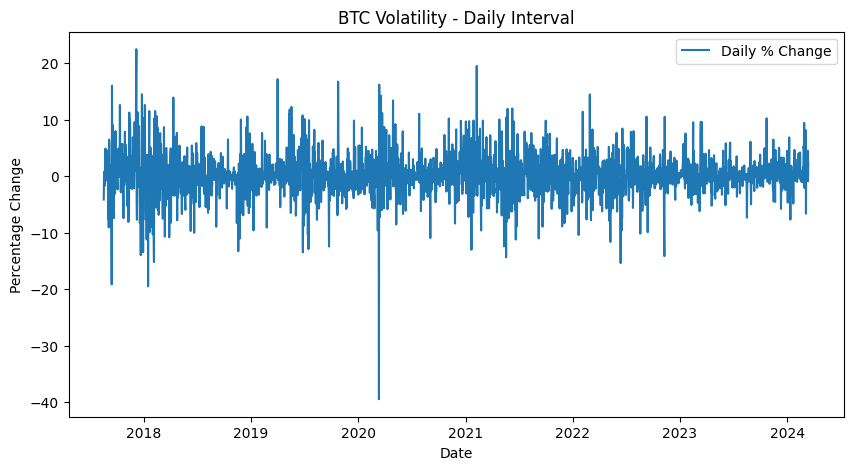

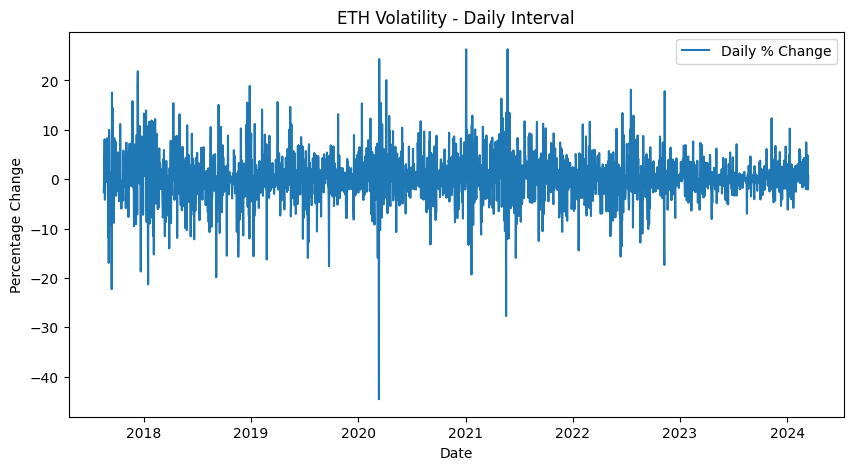

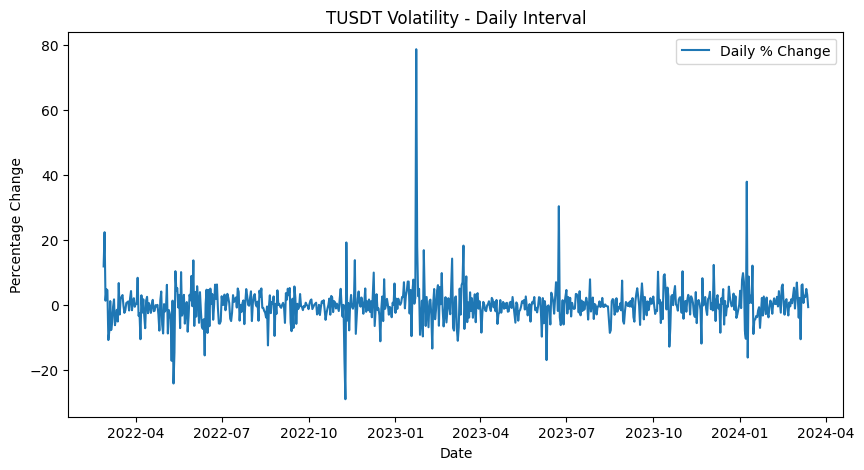

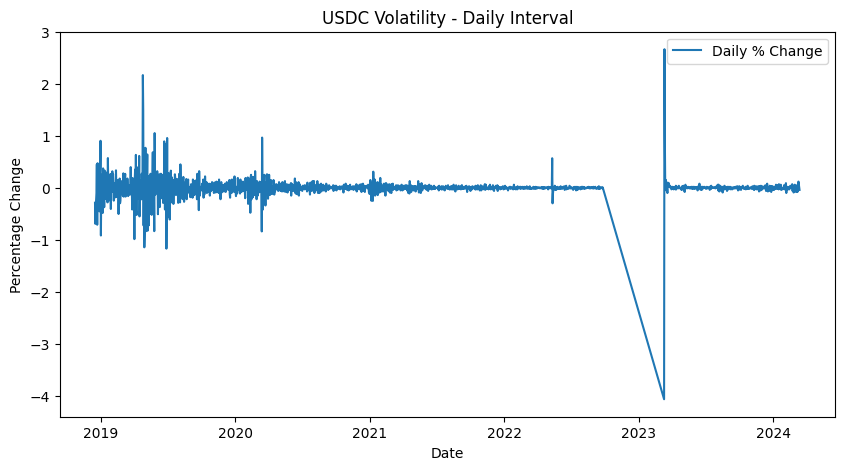

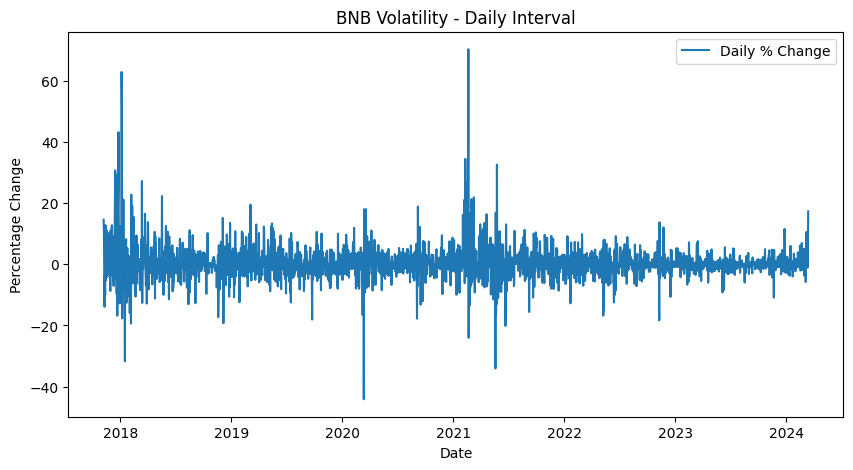

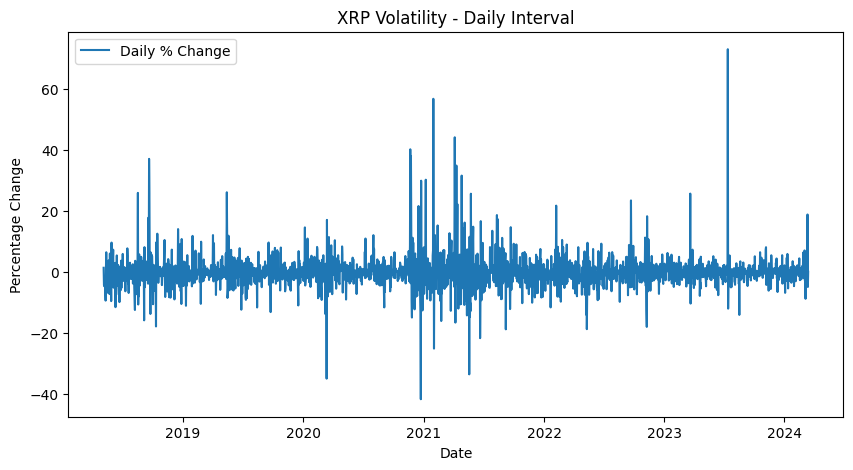

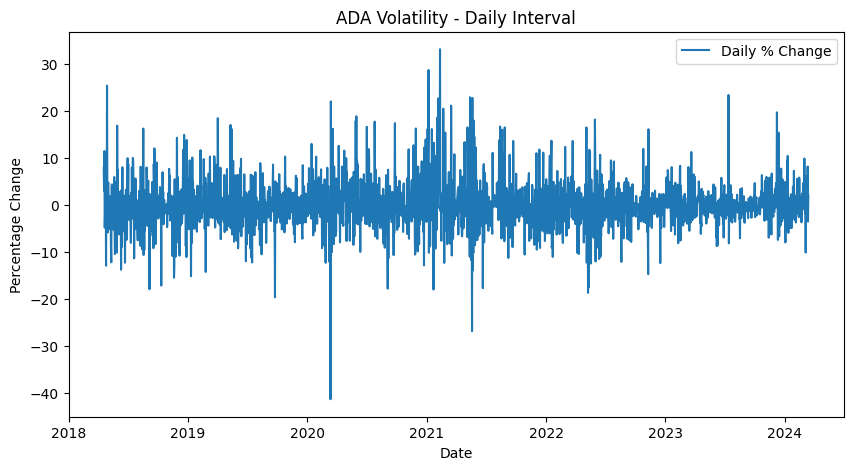

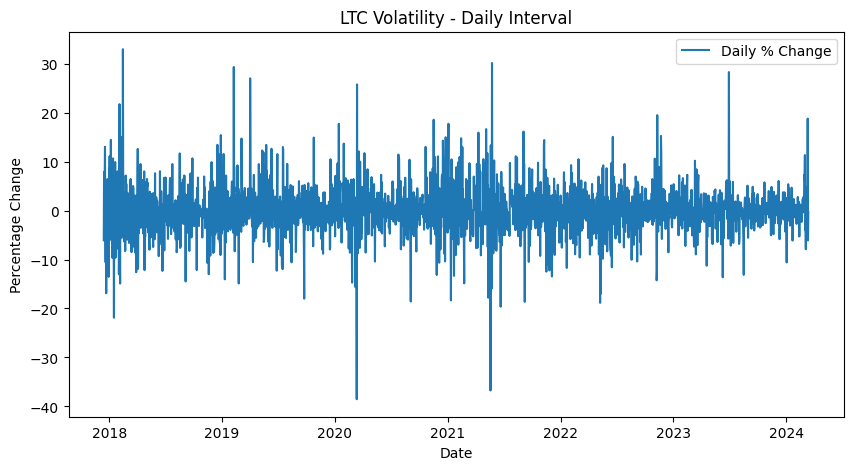

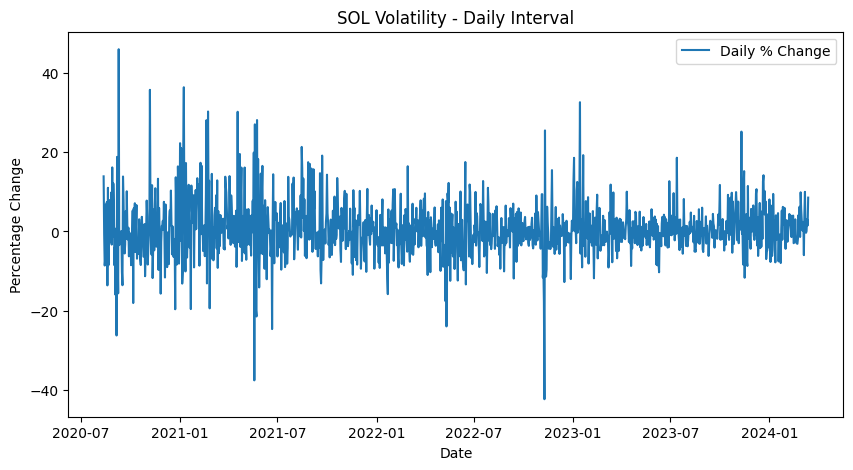

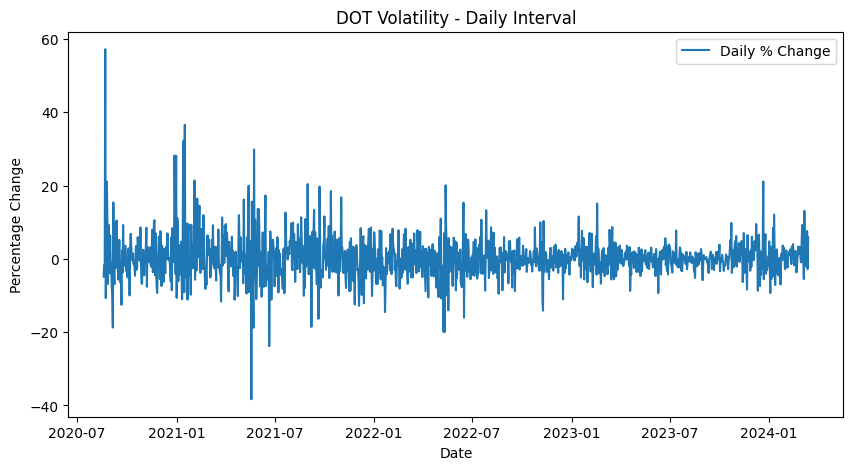


--- Volatility Analysis (Hourly Interval) ---


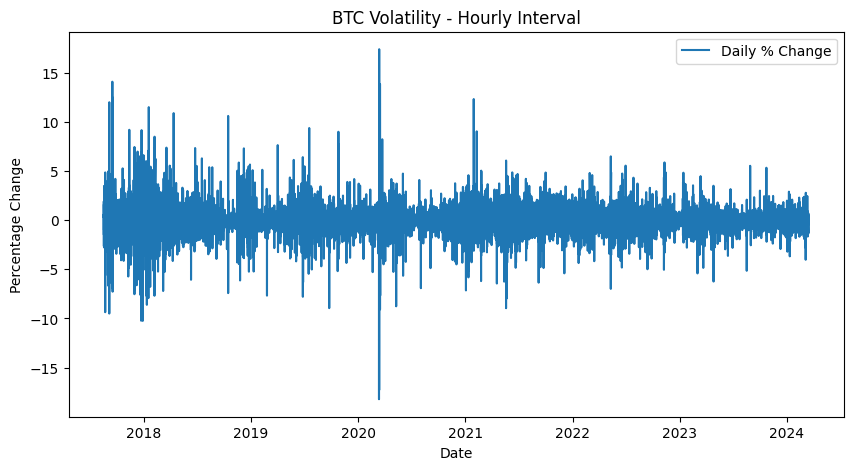

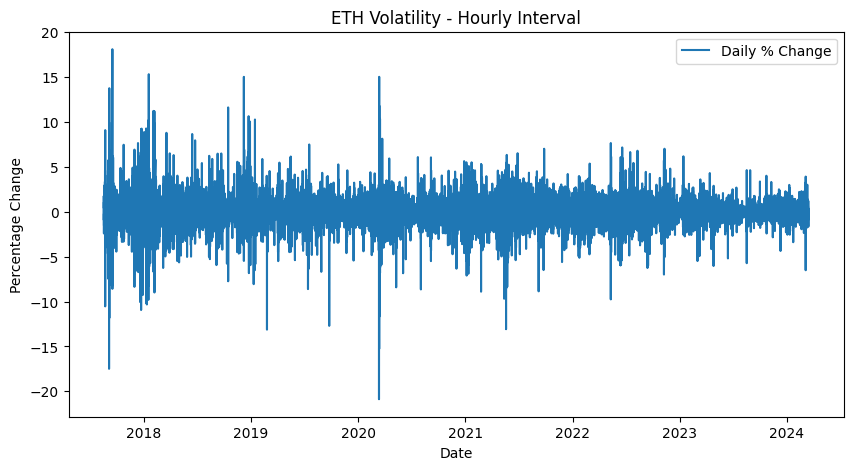

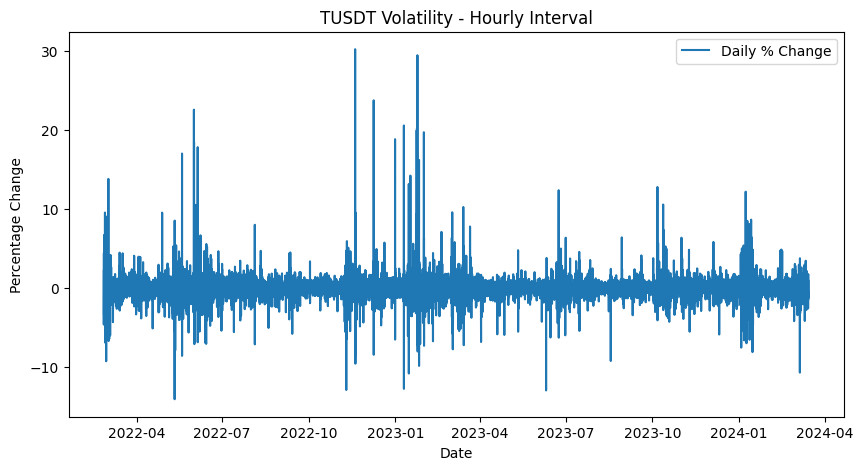

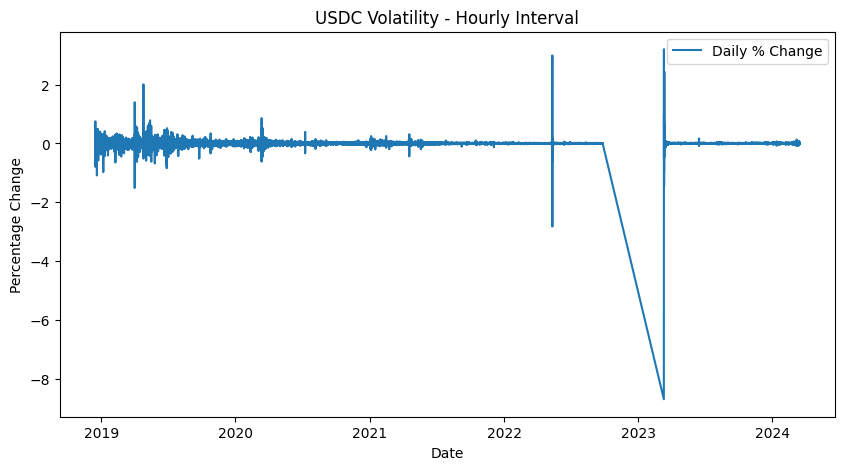

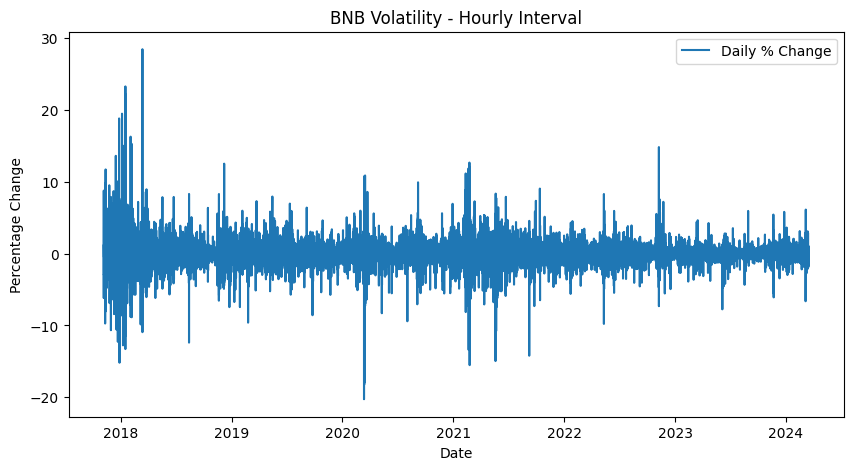

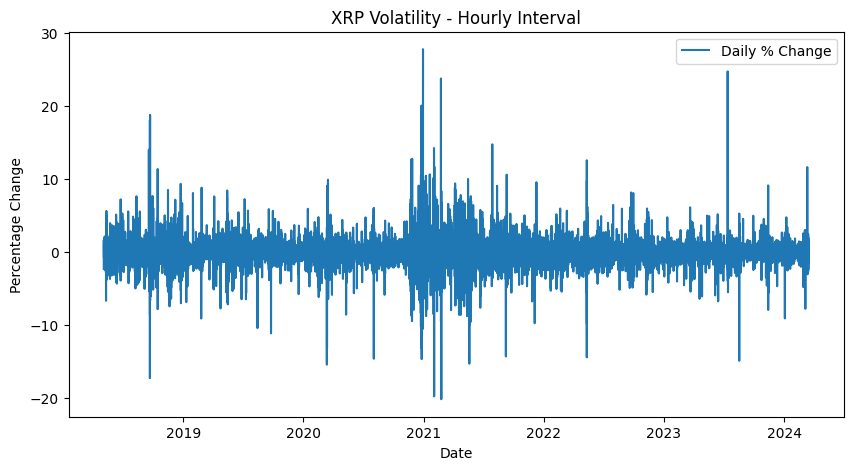

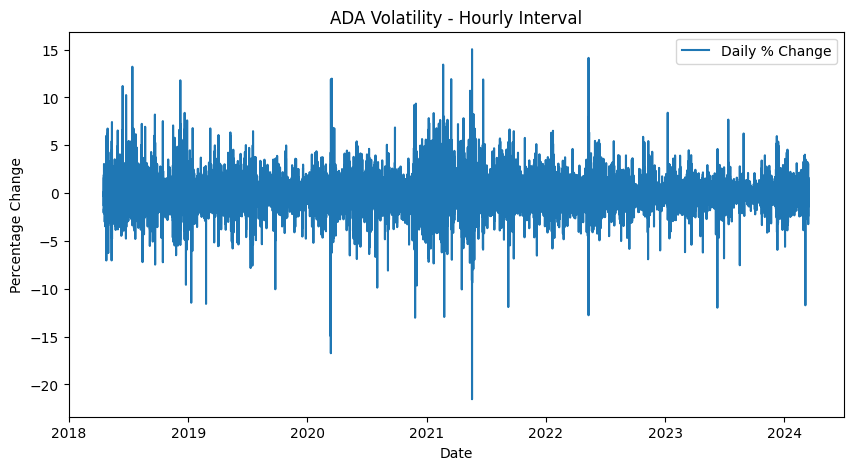

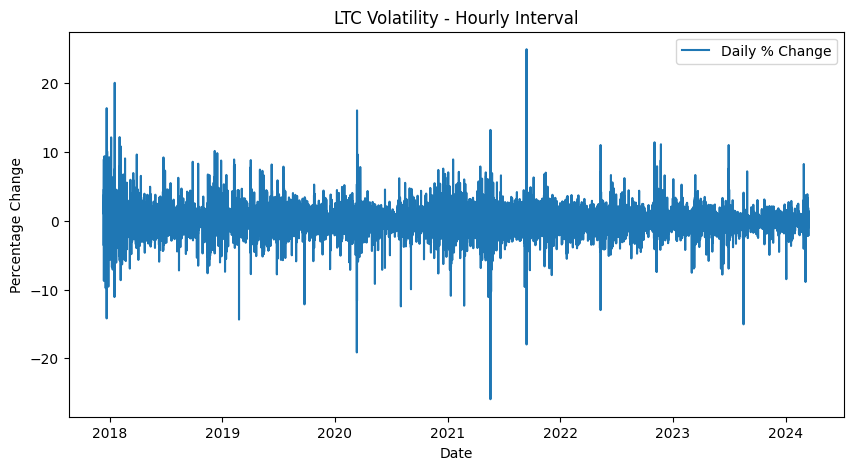

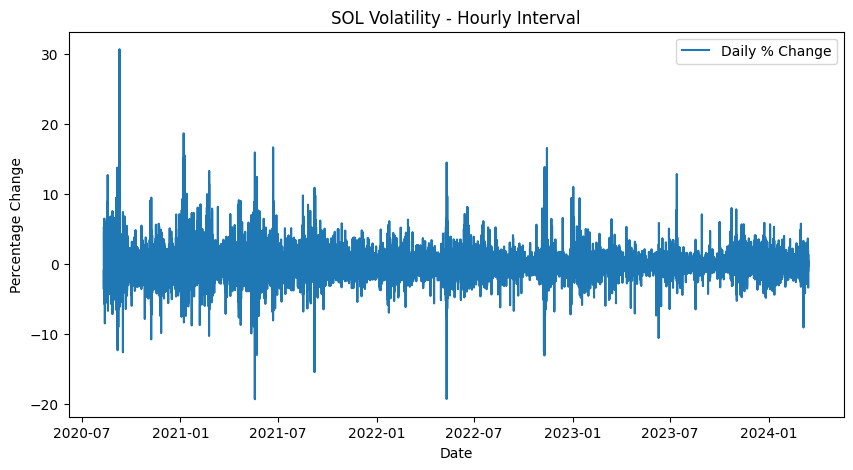

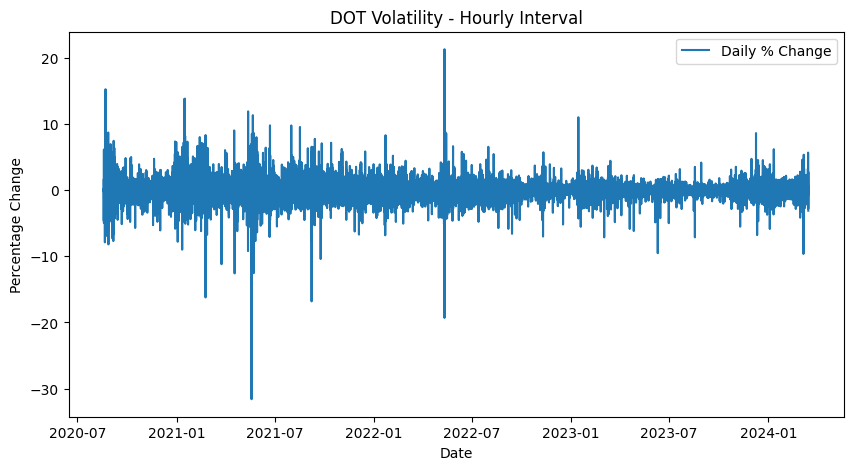


--- Volatility Analysis (4-Hourly Interval) ---


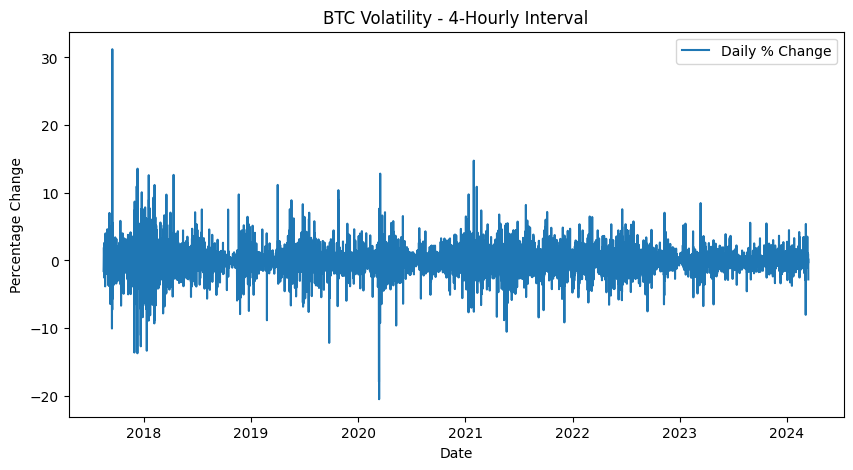

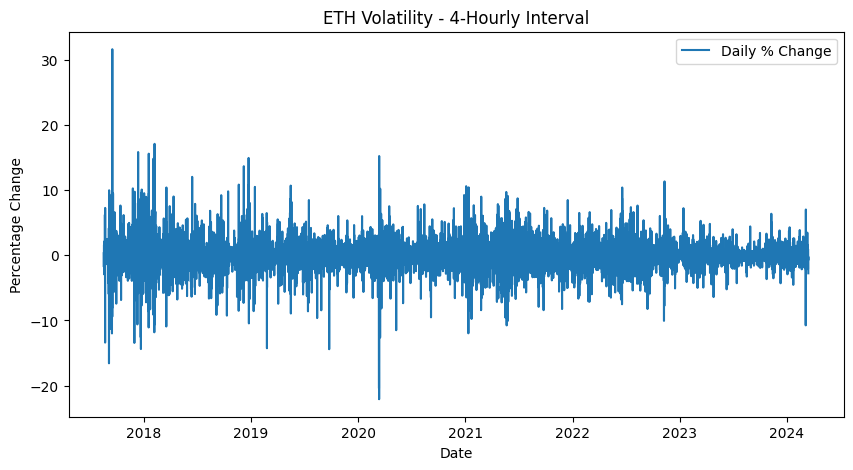

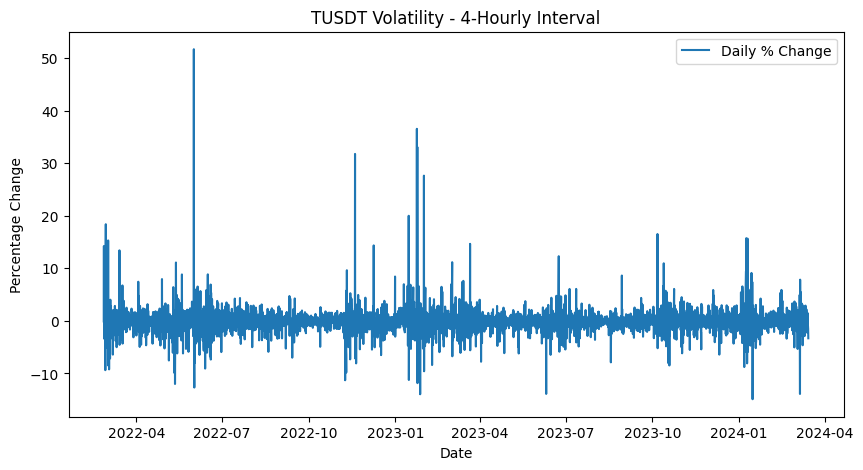

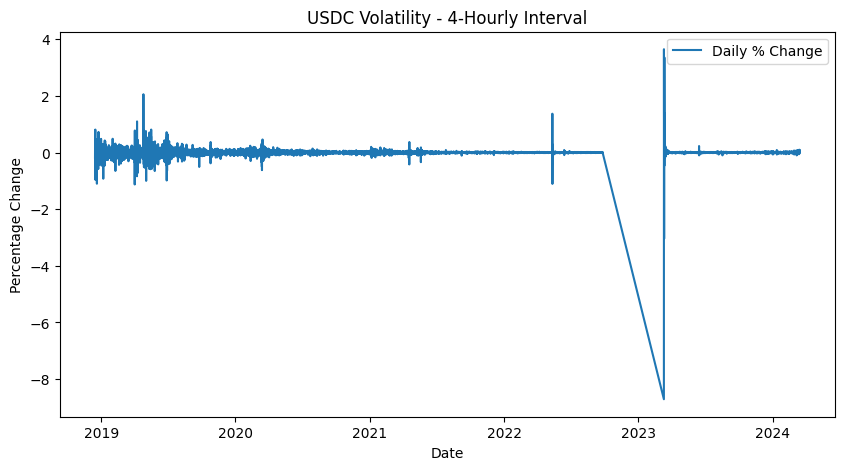

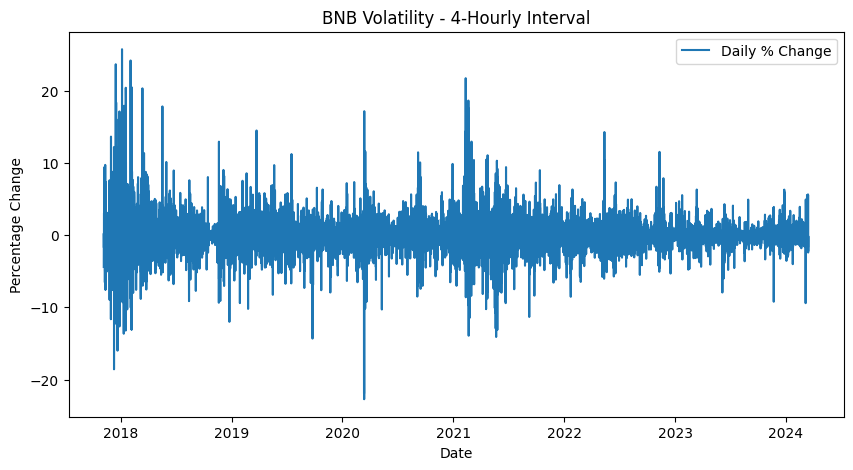

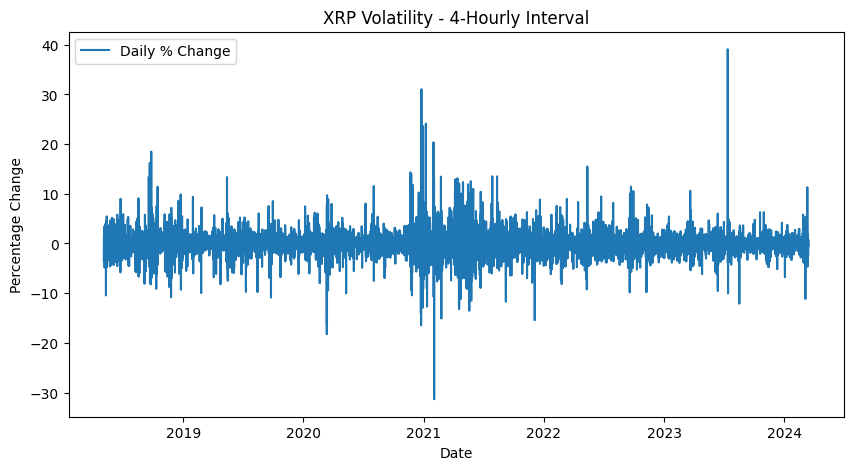

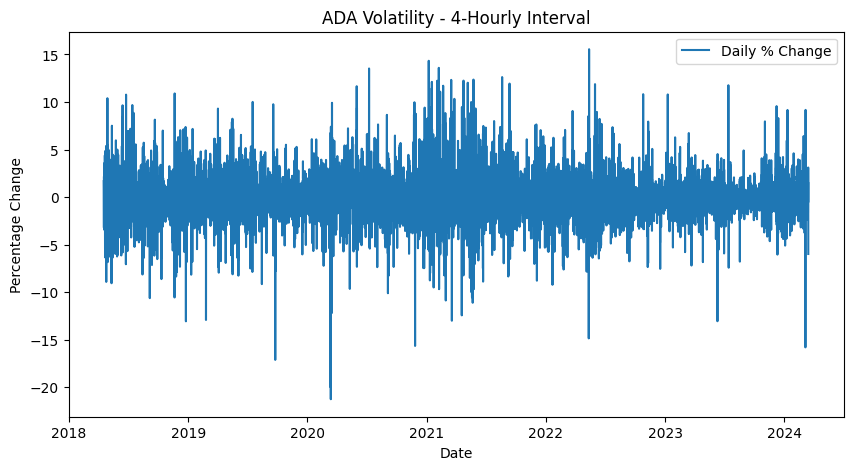

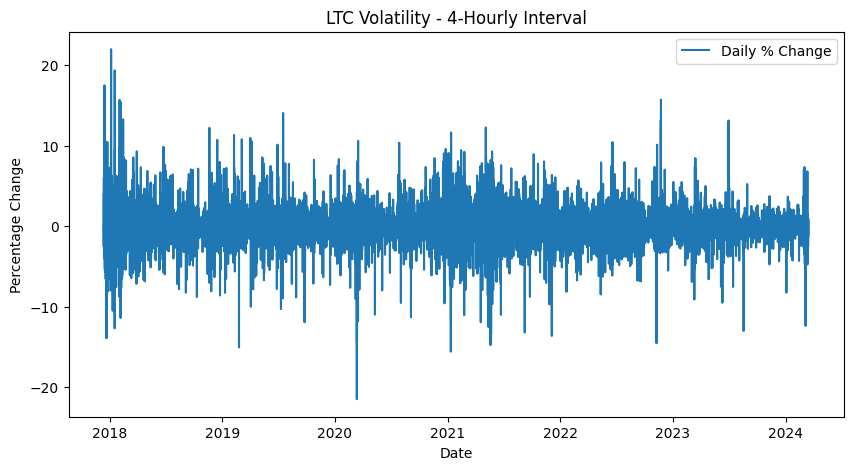

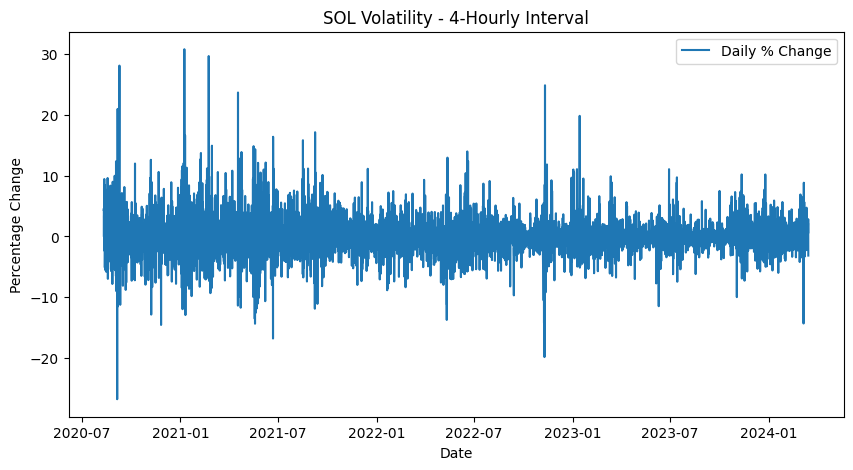

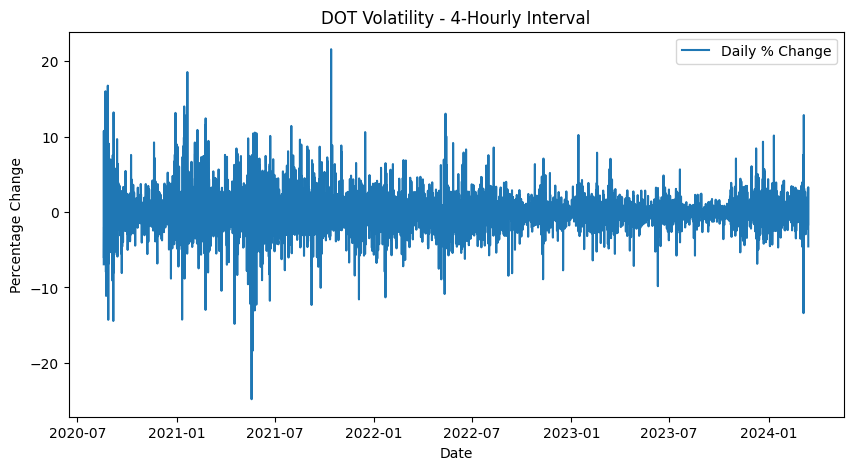


--- Volatility Analysis (5-Minute Interval) ---


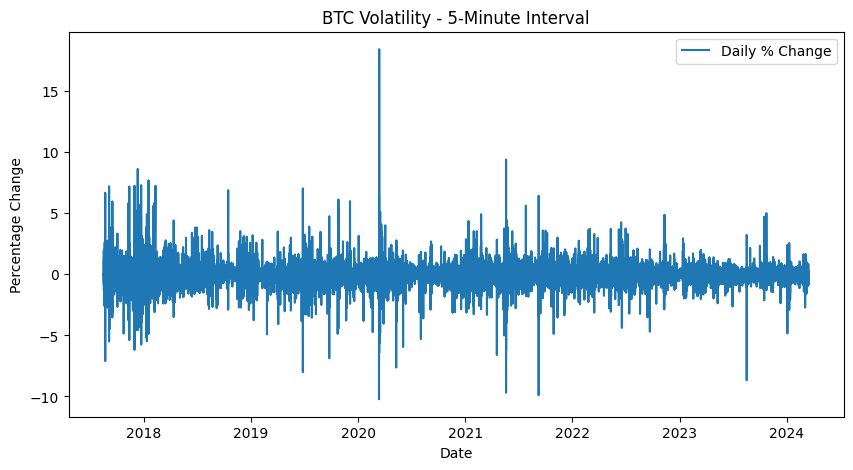

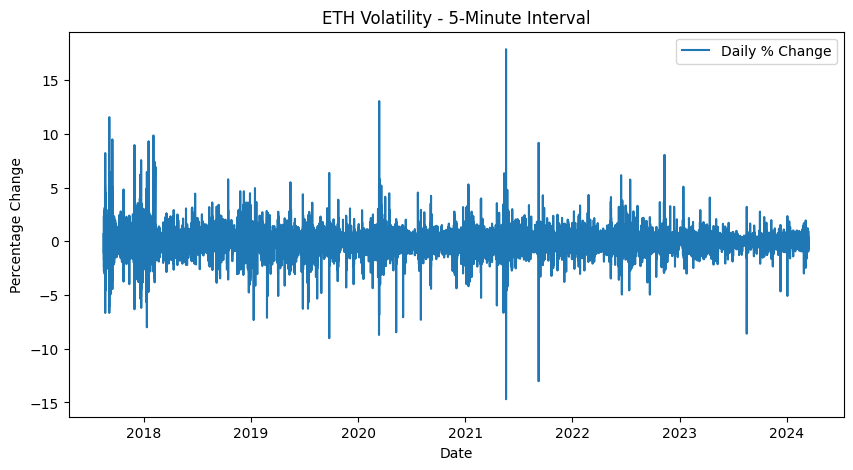

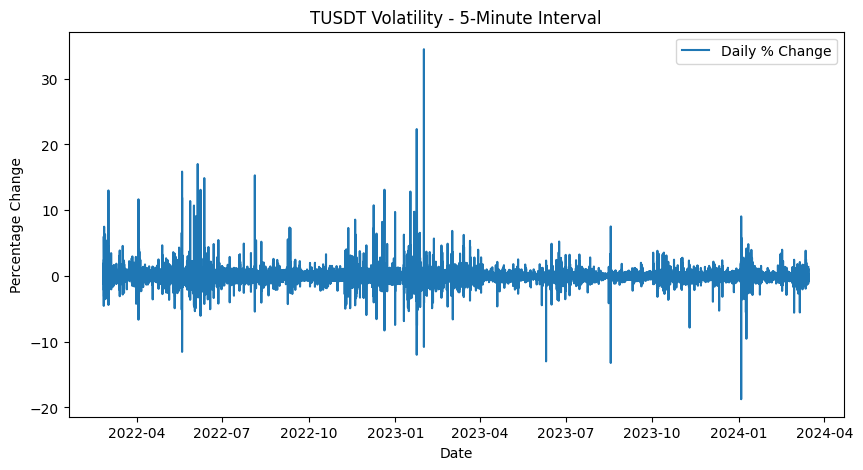

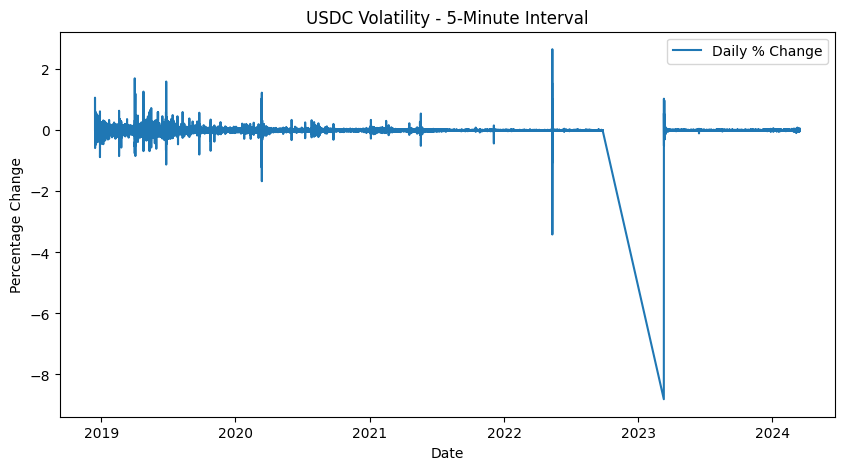

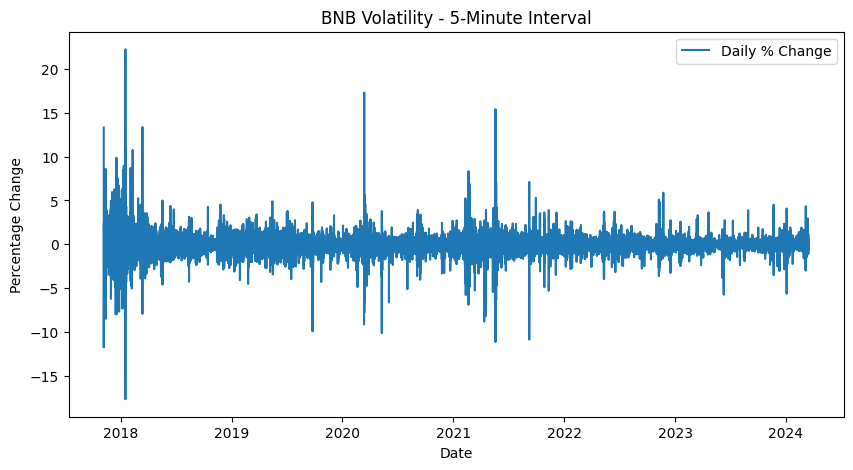

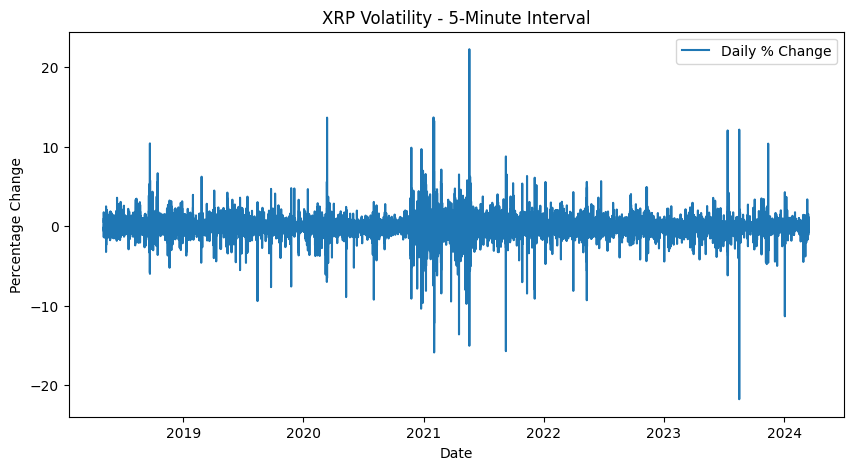

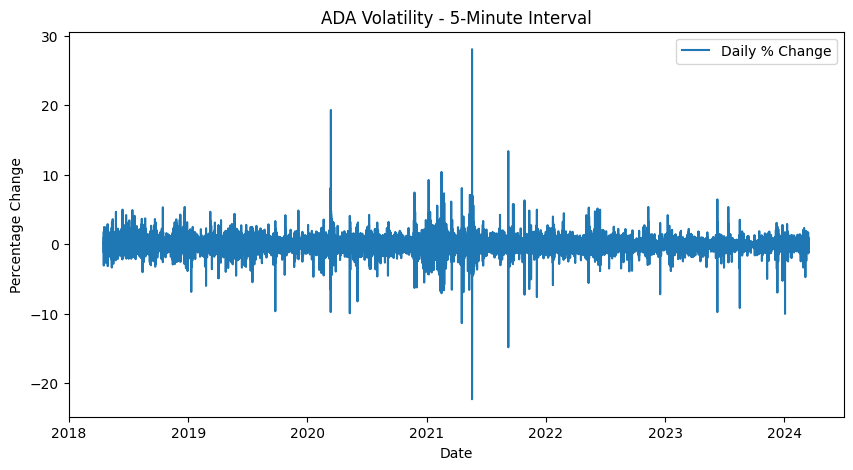

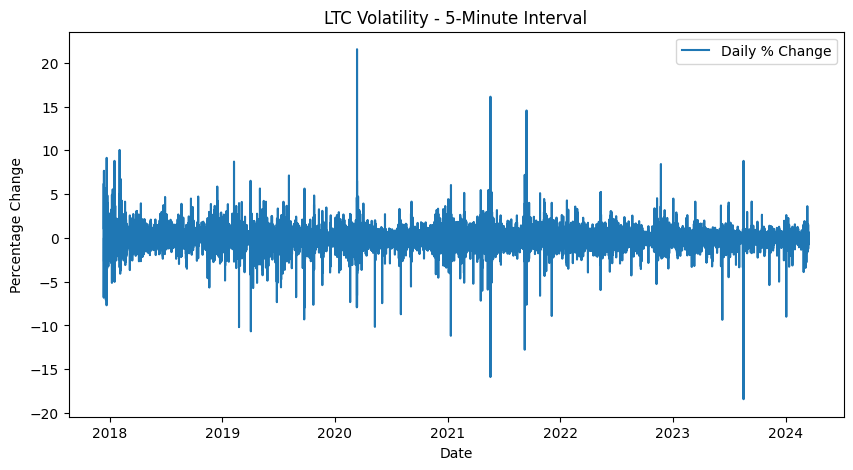

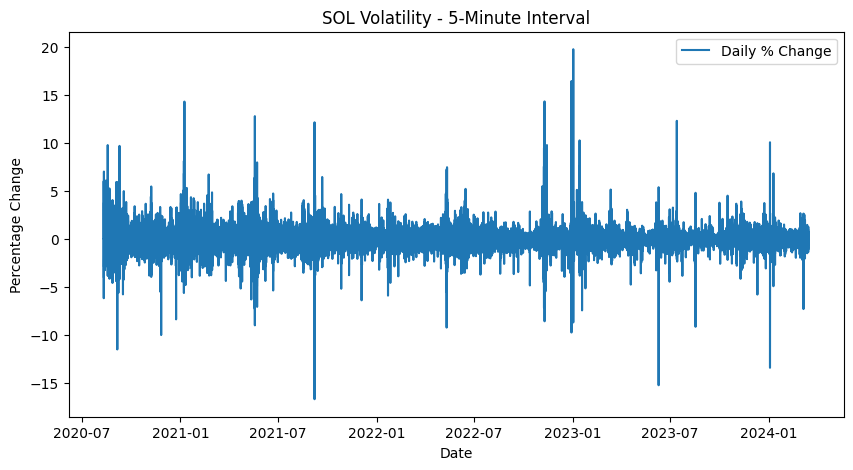

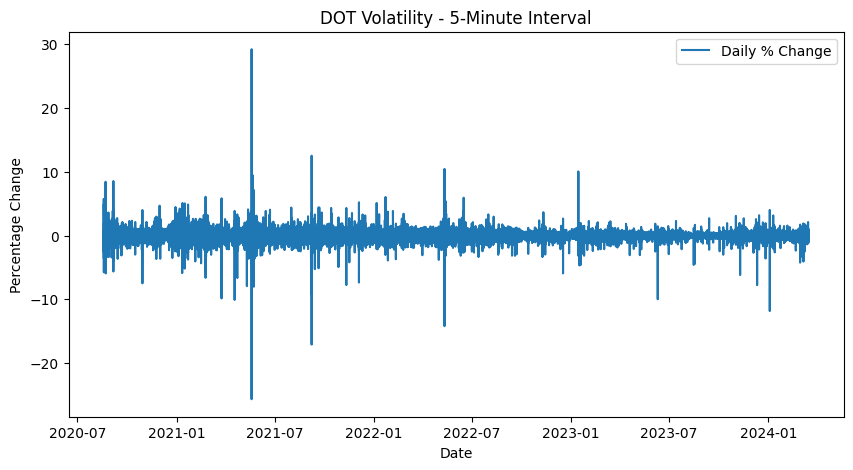


--- Volatility Analysis (15-Minute Interval) ---


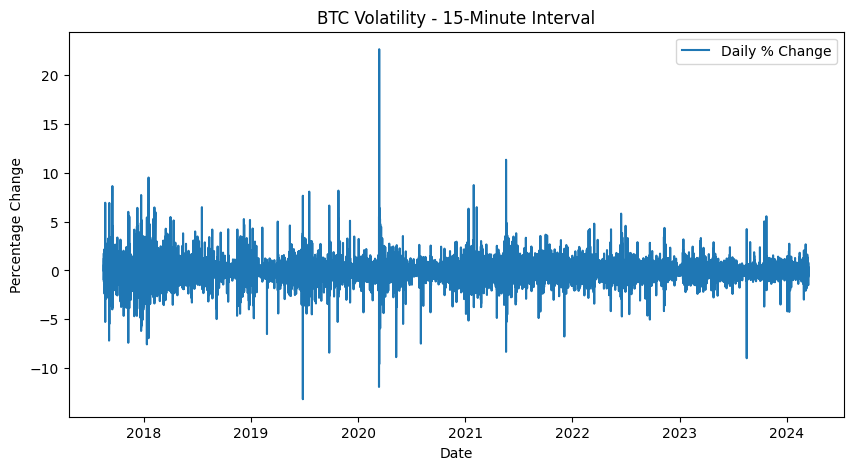

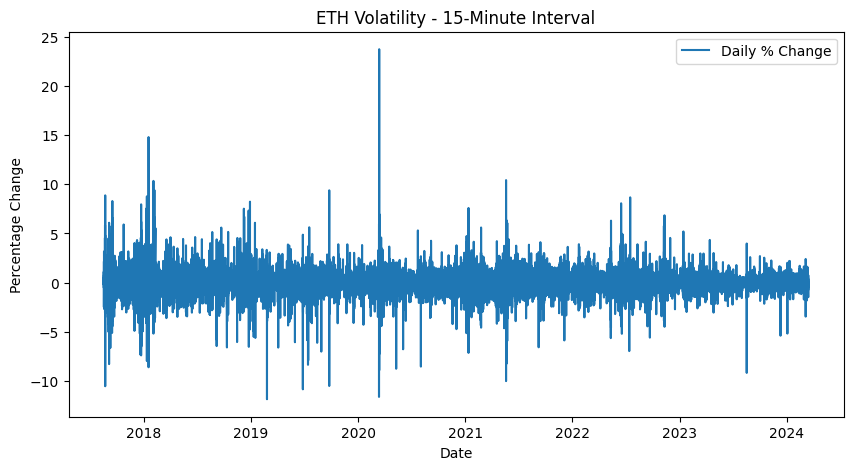

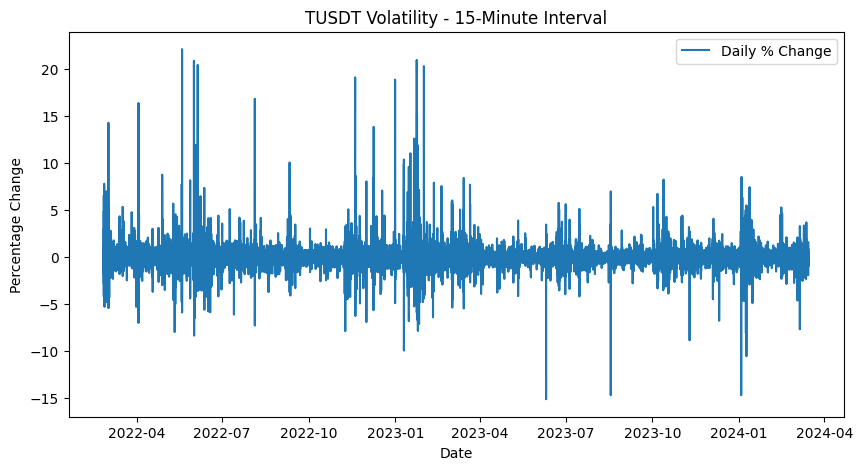

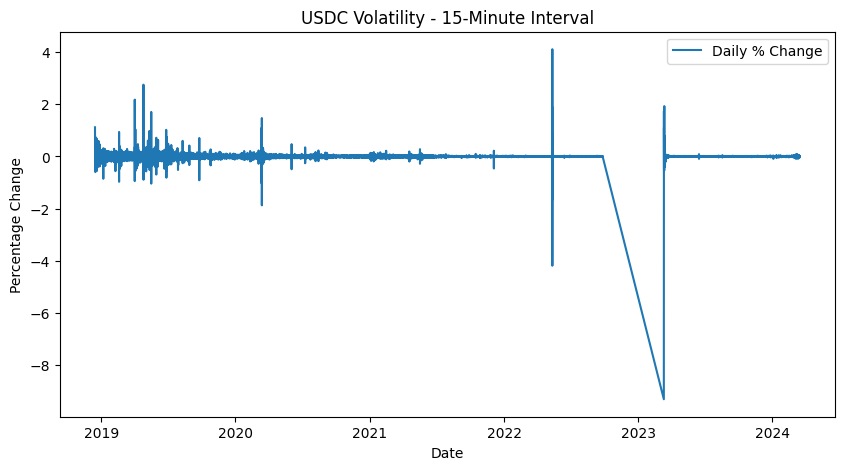

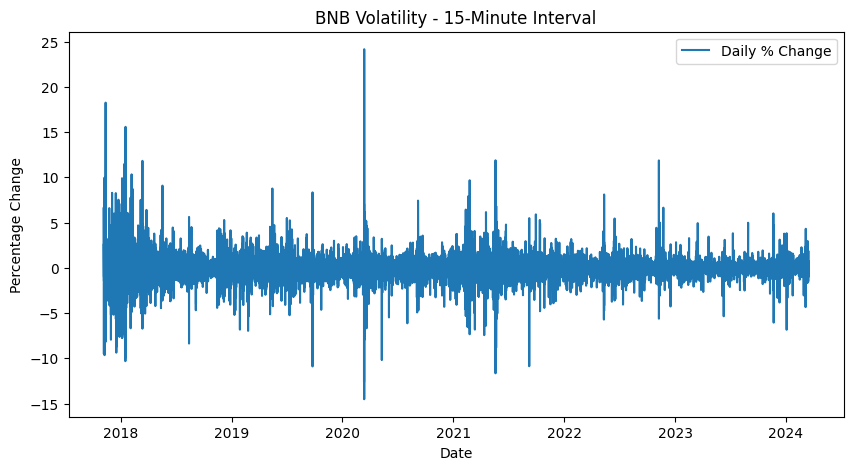

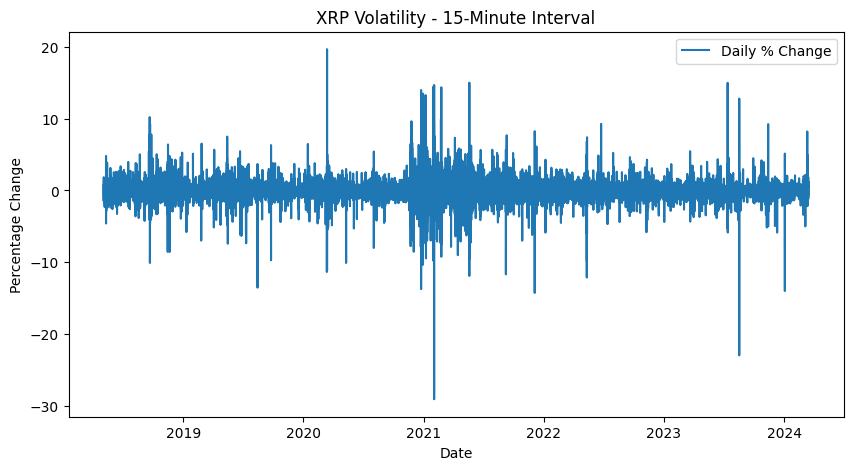

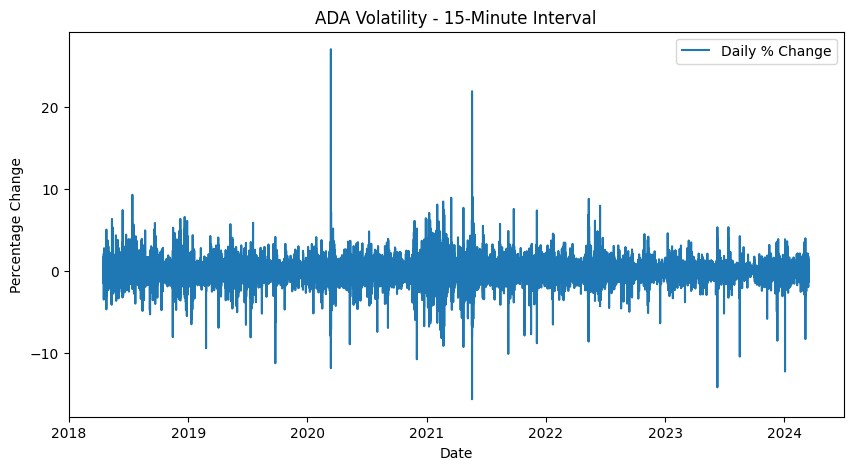

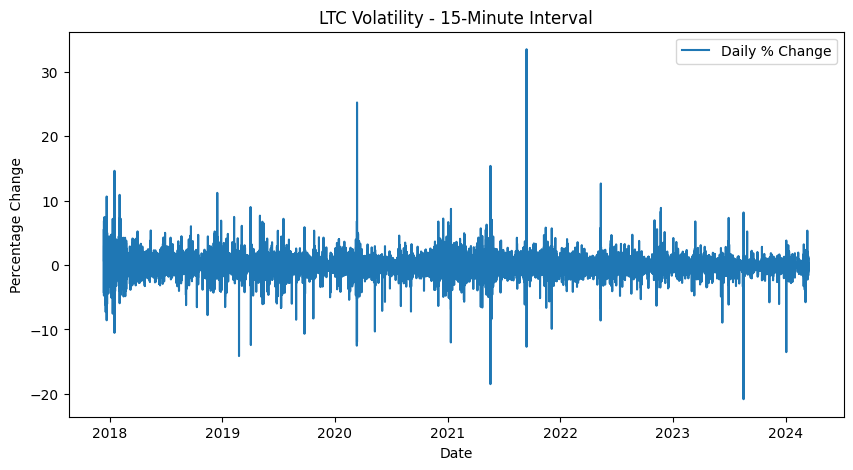

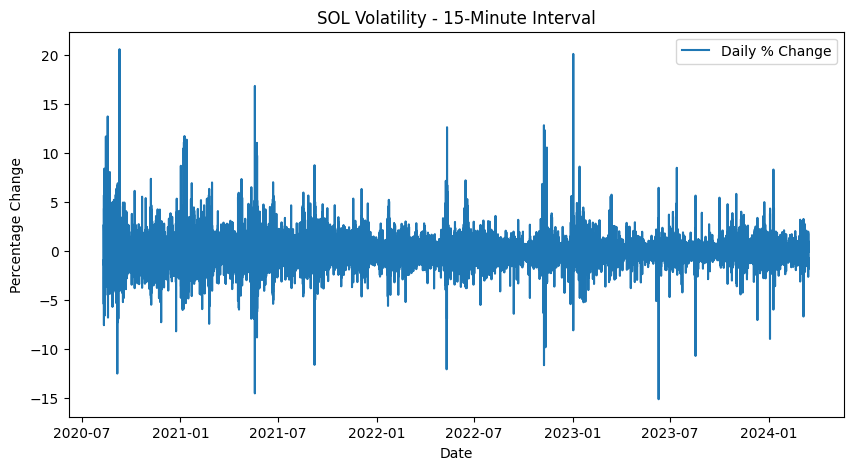

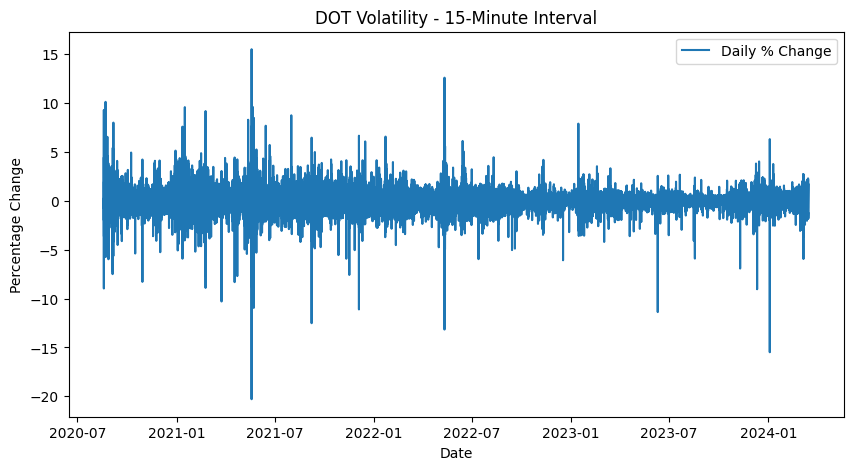


--- Volatility Analysis (30-Minute Interval) ---


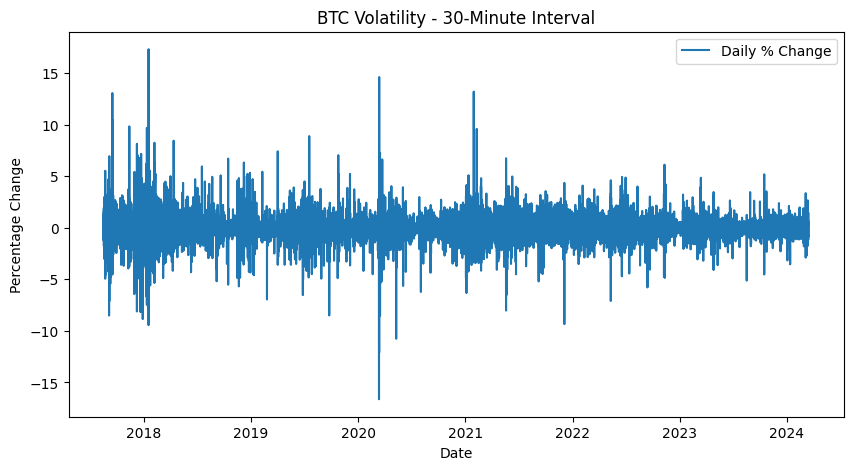

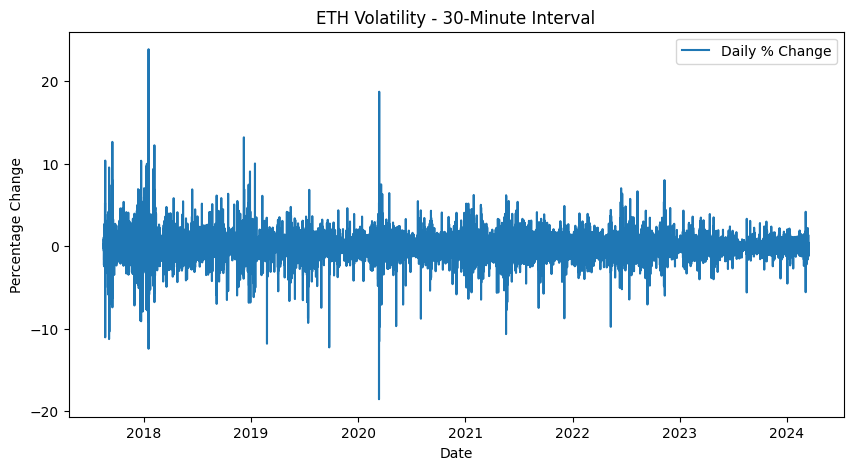

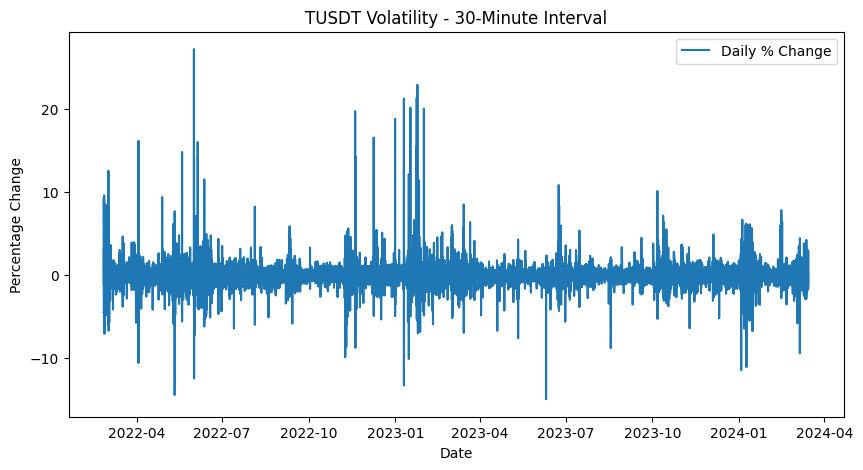

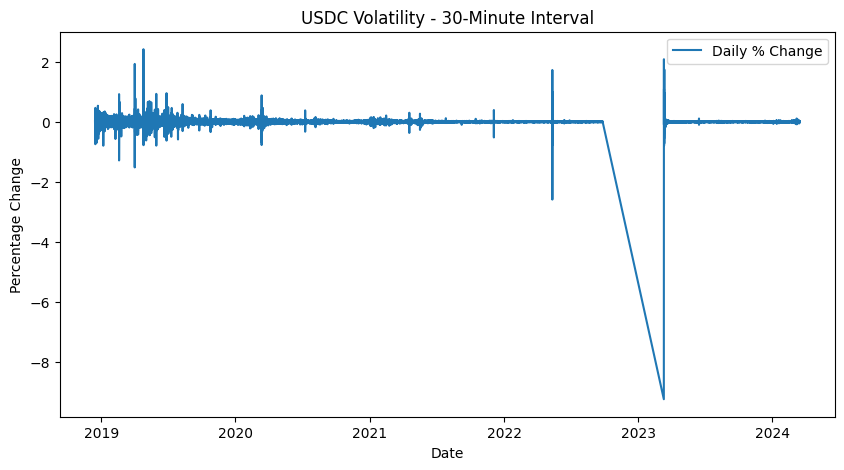

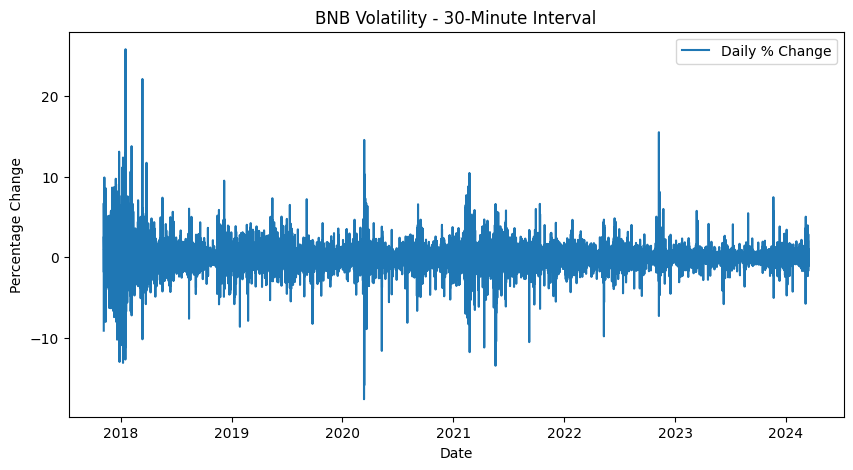

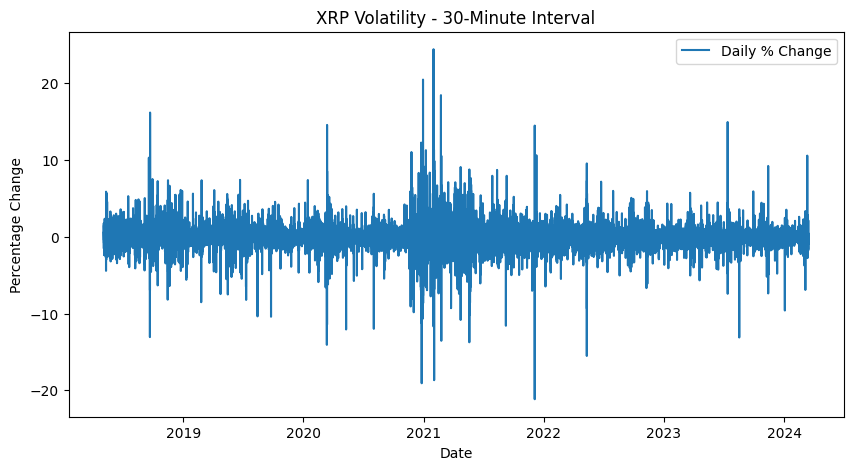

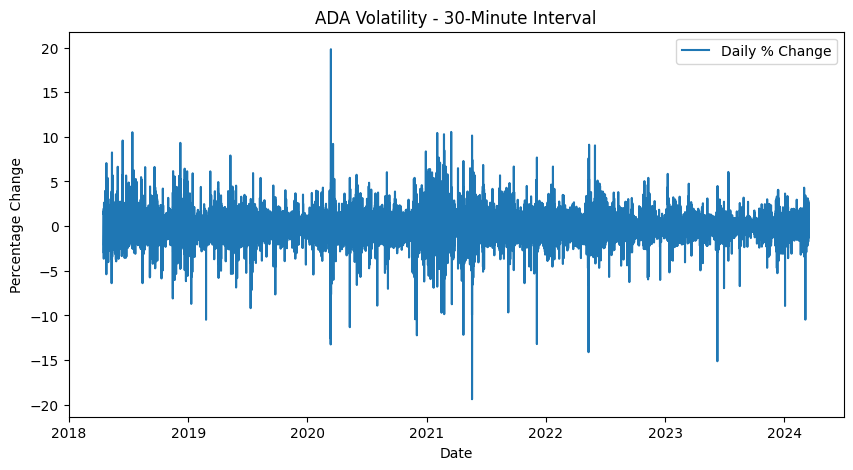

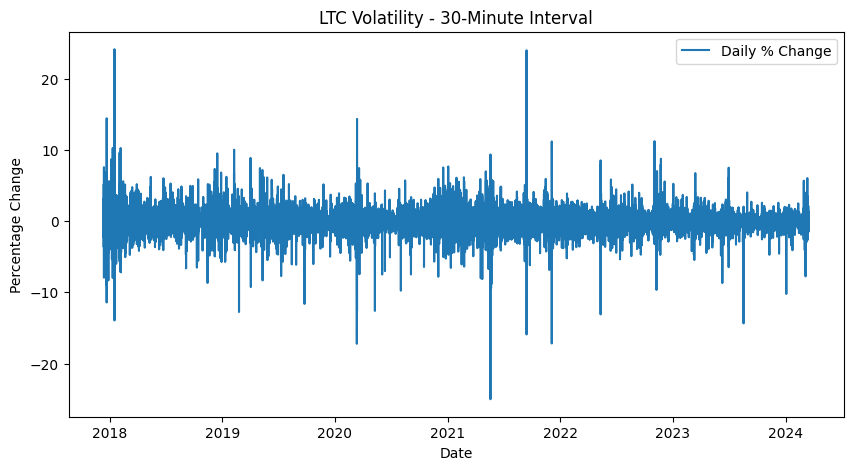

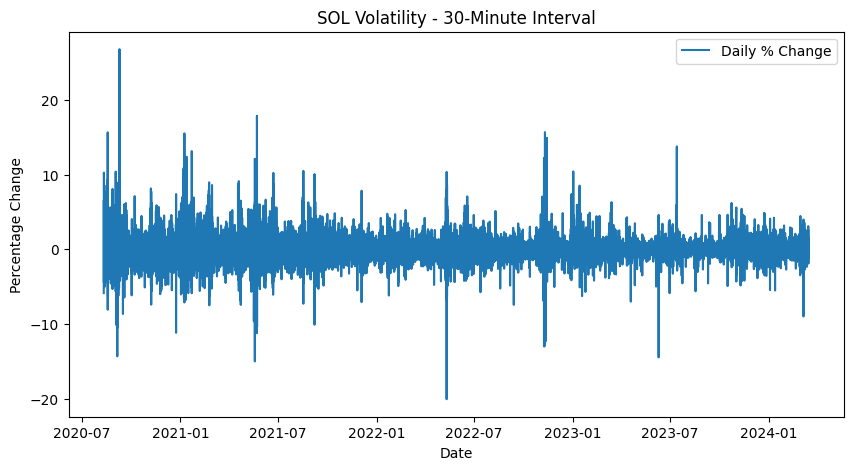

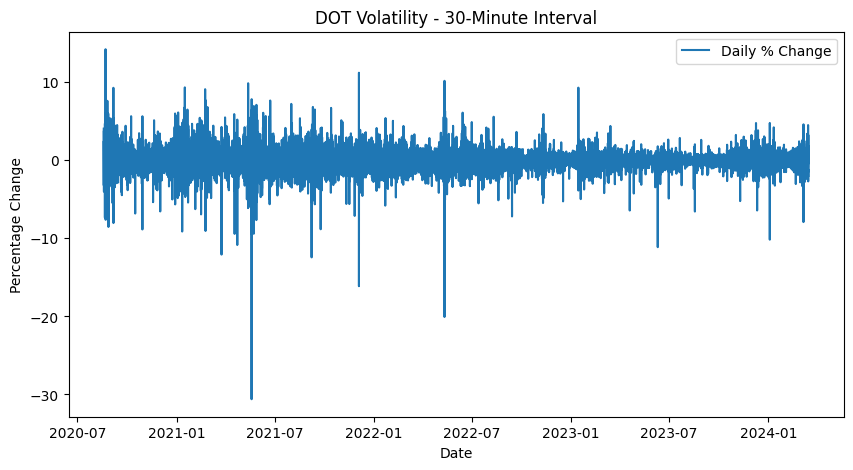


--- Volatility Analysis (Weekly Interval) ---


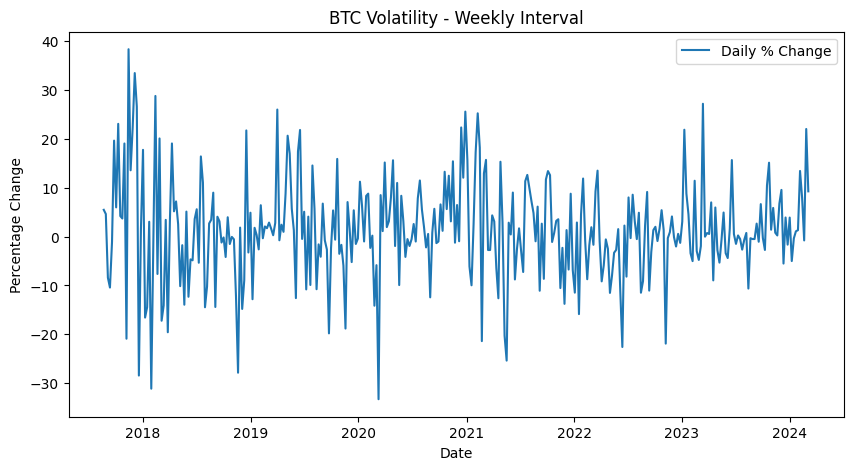

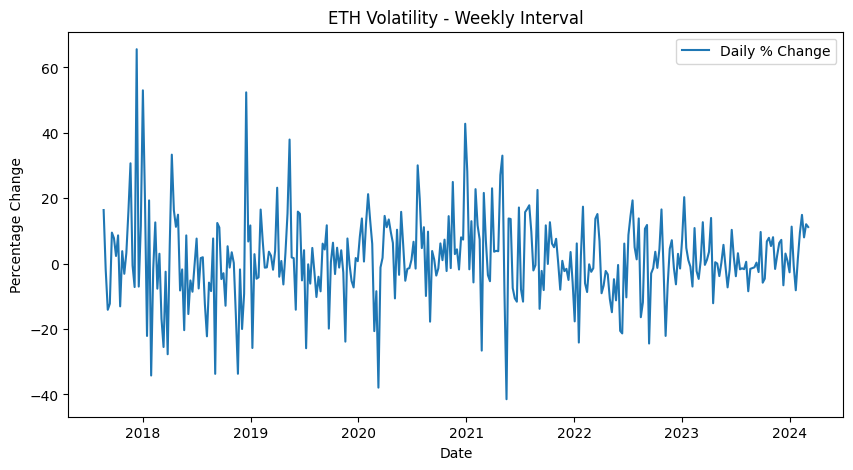

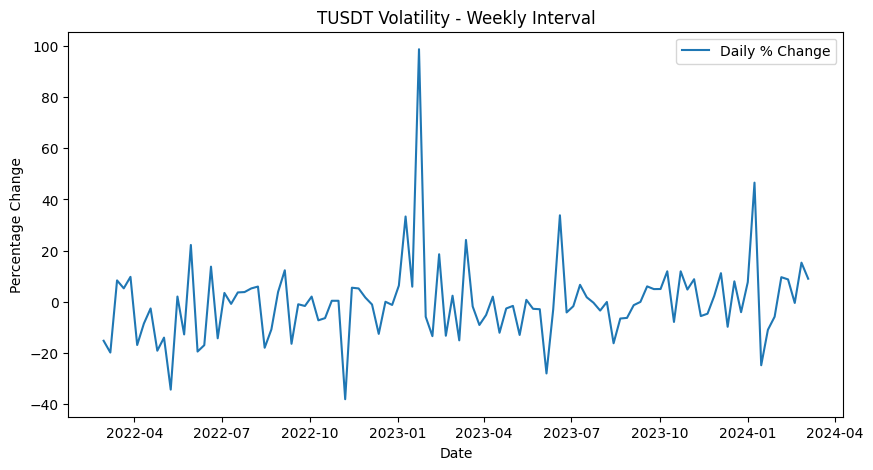

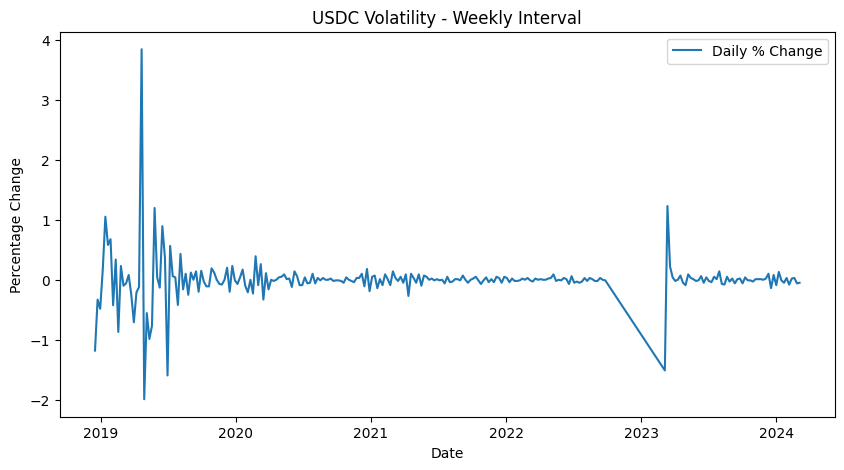

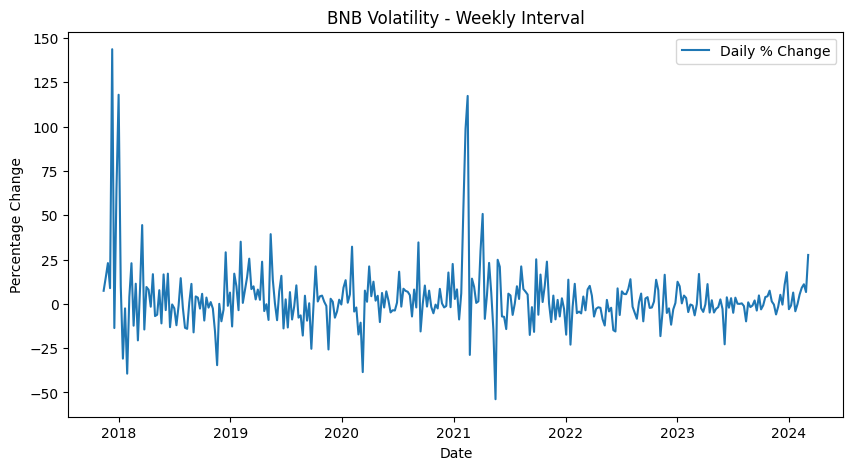

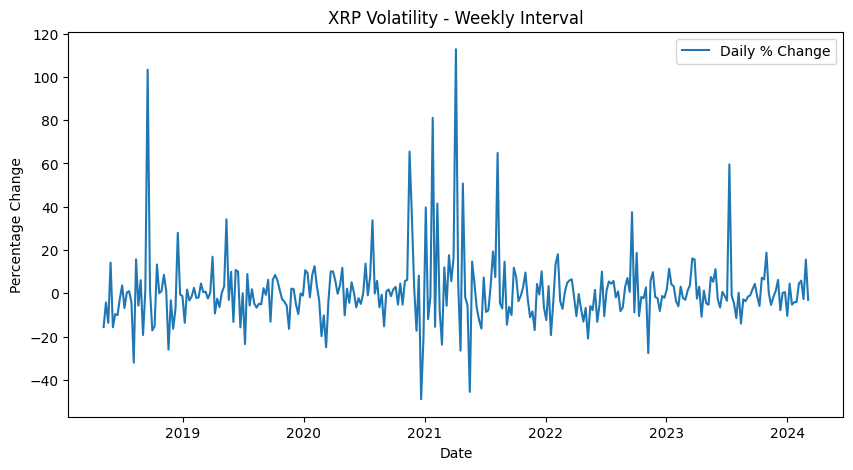

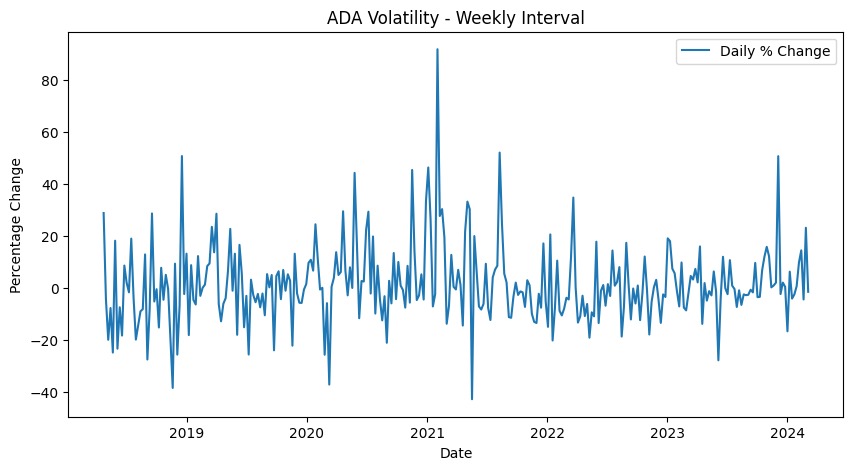

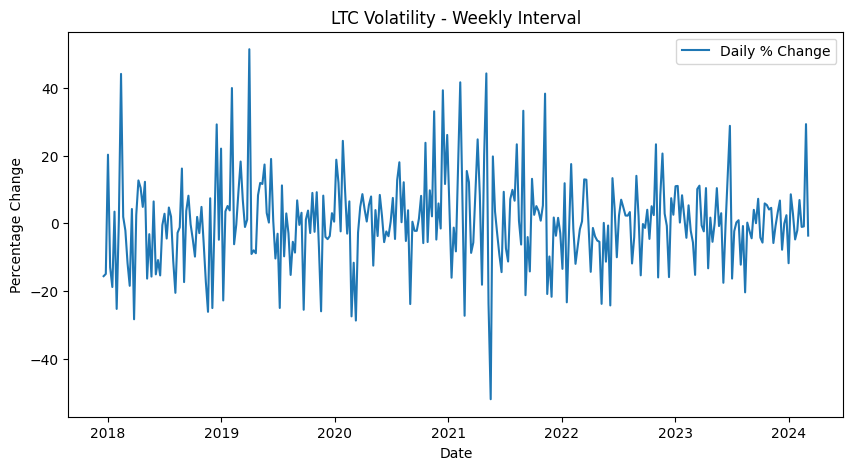

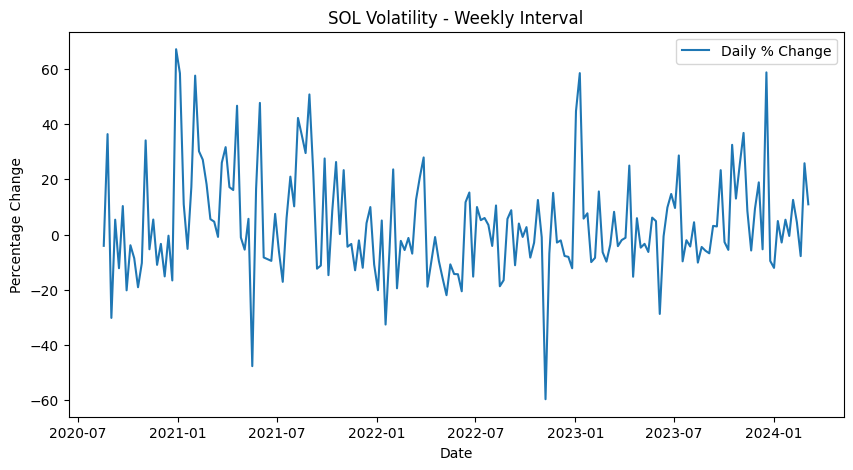

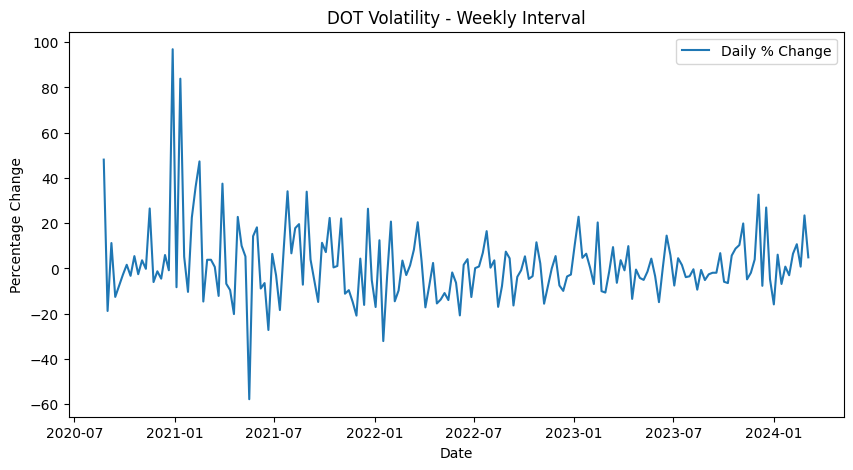

In [ ]:
# Volatility analysis for each cryptocurrency by interval
for interval, folder_name in intervals.items():
    print(f"\n--- Volatility Analysis ({folder_name} Interval) ---")
    for crypto, data in interval_data[interval].items():
        if data.empty:
            print(f"No data for {crypto} in {folder_name} interval.")
            continue

        data['pct_change'] = data['close'].pct_change() * 100
        plt.figure(figsize=(10, 5))
        plt.plot(pd.to_datetime(data['datetime']), data['pct_change'], label='Daily % Change')
        plt.title(f'{crypto} Volatility - {folder_name} Interval')
        plt.xlabel('Date')
        plt.ylabel('Percentage Change')
        plt.legend()
        plt.show()


## **Daily Volatility Analysis Summary**

1. **BTC (Bitcoin)**
   - BTC exhibits substantial daily volatility, with frequent percentage changes both positively and negatively.
   - There are notable spikes around 2020 and 2021, suggesting significant market events during those periods.
   - Overall, volatility appears consistent over the years, with some reduction in extreme fluctuations post-2022.

2. **ETH (Ethereum)**
   - Similar to BTC, ETH shows high daily volatility, with fluctuations reaching over ±20% in certain periods.
   - Major volatility spikes around 2020 and 2021 indicate market or macroeconomic impacts on ETH prices.
   - ETH's volatility has also stabilized to some extent post-2022, but fluctuations remain pronounced.

3. **TUSDT (Tether USDT)**
   - TUSDT exhibits less daily volatility compared to other cryptocurrencies, aligning with its nature as a stablecoin.
   - There are occasional spikes in volatility, likely due to temporary price discrepancies or market events.
   - Overall, TUSDT maintains a low volatility range, with the daily percentage change mostly near zero.

4. **USDC (USD Coin)**
   - USDC maintains the lowest daily volatility among all cryptocurrencies analyzed, consistent with its role as a stablecoin.
   - Minor fluctuations are observed, but the daily percentage change mostly hovers close to zero.
   - Anomalies in 2023 with larger negative fluctuations might reflect isolated market events or temporary de-pegging.

5. **BNB (Binance Coin)**
   - BNB experiences high volatility, with significant fluctuations during peak market periods like 2020 and 2021.
   - Volatility spikes reach over ±40% on certain days, reflecting BNB’s responsiveness to market trends.
   - Post-2022, BNB’s daily volatility appears somewhat moderated but remains substantial.

6. **XRP (Ripple)**
   - XRP shows consistent daily volatility with several large swings, particularly around 2021, likely due to regulatory news.
   - Volatility spikes up to ±60% are observed, indicative of XRP’s sensitivity to external news and market conditions.
   - In recent years, XRP volatility has become more stable, but occasional large fluctuations persist.

7. **ADA (Cardano)**
   - ADA displays high daily volatility, especially during the cryptocurrency market peaks around 2020 and 2021.
   - Daily percentage changes frequently reach double digits, demonstrating ADA’s price sensitivity.
   - There is a relative stabilization in volatility after 2022, though it still experiences significant fluctuations.

8. **LTC (Litecoin)**
   - LTC has noticeable volatility, with regular fluctuations and pronounced spikes around 2020 and 2021.
   - The daily changes can exceed ±20%, indicating high price volatility in response to market dynamics.
   - Recent years show slightly reduced volatility, but LTC remains susceptible to large daily swings.

9. **SOL (Solana)**
   - SOL shows substantial volatility, with high spikes around its price surges and market adoption periods in 2021.
   - Daily percentage changes often exceed ±20%, illustrating SOL’s rapid growth and price corrections.
   - Despite recent stabilization, SOL still demonstrates notable daily volatility relative to more established assets.

10. **DOT (Polkadot)**
    - DOT experiences high volatility, especially around its peak market periods in 2021.
    - Daily percentage changes frequently surpass ±20%, reflecting DOT’s market positioning and investor behavior.
    - Volatility has stabilized somewhat post-2022, but large daily changes continue to occur periodically.

## Summary
- **Overall**: Most cryptocurrencies exhibit high daily volatility, with notable peaks during market surges around 2020-2021.
- **Stablecoins (TUSDT, USDC)**: Show minimal volatility, with fluctuations largely centered around zero, maintaining stability as expected.
- **Post-2022 Trends**: There is a trend toward reduced volatility for several assets, though they remain susceptible to large swings.
- **Implications**: Investors should be aware of the high volatility in cryptocurrencies, especially during major market events, which can lead to rapid price changes. Stablecoins offer more consistency, while others like BTC, ETH, and BNB remain more volatile.

--------------------------------------------------------------------------------

## **Hourly Volatility Analysis Summary**

### 1. **BTC (Bitcoin)**
   - Shows consistent hourly volatility with occasional sharp spikes, particularly in early 2020 and 2021.
   - The majority of changes are within a range of ±5%, but some extreme fluctuations, reaching ±15%, highlight periods of high trading activity and market events.

### 2. **ETH (Ethereum)**
   - Similar to BTC, Ethereum's hourly volatility shows frequent fluctuations around the ±5% range.
   - There are spikes above ±10% during specific market events, notably in 2020 and early 2021, likely influenced by increased trading or significant market news.

### 3. **TUSDT (Tether USD)**
   - Tether, being a stablecoin, exhibits much lower volatility overall, with percentage changes typically close to zero.
   - However, there are some rare but noticeable deviations, particularly around the beginning of 2023, showing that even stablecoins can experience volatility under certain conditions.

### 4. **USDC (USD Coin)**
   - Similar to Tether, USDC shows very minimal volatility as expected from a stablecoin, with changes almost always around 0%.
   - Only a few outliers disrupt this stability, likely due to market corrections or events affecting liquidity.

### 5. **BNB (Binance Coin)**
   - BNB displays higher volatility than stablecoins, with consistent hourly fluctuations within ±5%.
   - Notable spikes, reaching ±20%, are observed during certain intervals, especially around 2020-2021, indicating periods of heightened market movement for Binance Coin.

### 6. **XRP (Ripple)**
   - XRP has periods of steady fluctuation around ±5%, but with frequent spikes in volatility, especially in early 2021.
   - Some of these spikes reach up to ±20%, reflecting the impact of regulatory and market news specific to Ripple.

### 7. **ADA (Cardano)**
   - Cardano shows stable hourly volatility within ±5% for most of the time.
   - A few spikes in volatility, particularly in early 2021, reflect market enthusiasm and significant price movements during that period.

### 8. **LTC (Litecoin)**
   - Litecoin shows frequent volatility in the range of ±5%, with some spikes around ±10%.
   - Higher volatility observed in 2020-2021, likely due to broader cryptocurrency market fluctuations.

### 9. **SOL (Solana)**
   - Solana shows steady volatility with most changes within ±5%.
   - Occasional larger fluctuations, up to ±20%, are visible, especially in late 2021 and early 2022, reflecting market events specific to Solana's ecosystem.

### 10. **DOT (Polkadot)**
   - Polkadot exhibits fluctuations within ±5% for the majority of the time.
   - There are some volatility spikes reaching ±15%, particularly around the time of Polkadot's significant developments in 2021.

---

### **Overall Insights**
- **Stablecoins (TUSDT and USDC)**: Minimal volatility, primarily close to 0% changes, reflecting their role in providing stability.
- **Major Cryptocurrencies (BTC, ETH, BNB)**: Exhibit consistent volatility with periods of higher spikes, reflecting their high trading volume and susceptibility to broader market influences.
- **Altcoins (XRP, ADA, LTC, SOL, DOT)**: Display volatility similar to major cryptocurrencies but tend to have more pronounced spikes during market events, indicating their increased sensitivity to market sentiment and specific ecosystem developments.
  
This hourly interval analysis indicates that while most cryptocurrencies maintain a steady level of volatility, they are still prone to sudden spikes due to market dynamics, regulatory news, or ecosystem-specific events.

-------------------------------------------------------------------------------

## **5-Minute Interval Volatility Analysis Summary**

### 1. Bitcoin (BTC)
- BTC shows high intraday volatility with frequent sharp movements.
- Significant price changes are observed around notable market events, especially during the 2020 and 2021 bull runs.
- Volatility has reduced somewhat in recent years, stabilizing within a narrower range, but still presents notable fluctuations.

### 2. Ethereum (ETH)
- ETH mirrors BTC with high volatility peaks, especially during periods of high trading volume.
- Similar spikes around 2020 and early 2021 indicate the impact of macroeconomic factors and market trends.
- Recent years show reduced volatility, although some intermittent spikes continue to occur.

### 3. Tether (TUSDT)
- TUSDT displays relatively low volatility, maintaining its stablecoin characteristic.
- The few noticeable spikes are likely due to market anomalies or temporary deviations from its peg.
- Overall, it remains within a narrow range of percentage changes, reflecting minimal volatility.

### 4. USD Coin (USDC)
- USDC maintains stability with minimal fluctuation in its price, aligning with its role as a stablecoin.
- Brief anomalies in 2023 indicate temporary disconnections from the peg, but these are rare and quickly corrected.
- The low volatility trend confirms its use as a low-risk asset in crypto transactions.

### 5. Binance Coin (BNB)
- BNB shows higher volatility compared to stablecoins, with notable spikes corresponding to market trends and adoption events.
- Volatility is more controlled in recent years but still presents a relatively high daily percentage change.
- As a utility token, its price is sensitive to Binance-related news and broader market conditions.

### 6. Ripple (XRP)
- XRP exhibits frequent price changes, with major spikes around market announcements and regulatory news.
- Volatility appears to stabilize but remains higher compared to stable assets, especially due to ongoing legal concerns.
- Periodic spikes in volatility reflect Ripple's exposure to legal developments and market sentiment.

### 7. Cardano (ADA)
- ADA shows significant intraday volatility, particularly around market peaks in 2020 and 2021.
- While recent data indicates some stability, volatility remains due to the coin's speculative nature.
- ADA's price movements reflect investor sentiment and speculative interest in the project.

### 8. Litecoin (LTC)
- LTC demonstrates frequent, moderate volatility spikes, echoing BTC’s patterns as one of the earlier cryptocurrencies.
- While volatility decreases over time, it continues to fluctuate based on market trends and adoption rates.
- LTC’s stable relative volatility suggests its role as a lower-risk alternative to BTC in certain portfolios.

### 9. Solana (SOL)
- SOL shows high volatility, with significant spikes during its initial growth phase in 2021.
- Volatility has been moderated in recent periods, though price changes remain sensitive to network updates and scaling issues.
- SOL's rapid growth and technological challenges contribute to its high, though stabilizing, volatility.

### 10. Polkadot (DOT)
- DOT exhibits moderate volatility with distinct spikes aligning with its development milestones and ecosystem growth.
- The price changes have somewhat stabilized as the network matures, but volatility remains due to speculative interest.
- DOT’s percentage changes are less extreme than those of newer assets, indicating maturing investor sentiment.

---

Overall, the 5-minute interval analysis reveals high-frequency volatility across non-stablecoin assets, especially during major market events. Stablecoins (TUSDT and USDC) demonstrate minimal fluctuations, fulfilling their role as stable assets. Meanwhile, other assets exhibit varying degrees of stabilization in recent periods, reflecting market maturation and reduced speculative spikes.

---

## **15-Minute Interval Volatility Analysis Summary**

1. **Bitcoin (BTC)**:
   - Exhibits periodic spikes in volatility, with occasional sharp peaks.
   - Volatility shows a relatively consistent spread over time, with some extreme fluctuations around major market events (e.g., 2020-2021).
   - The general trend stabilizes in later periods, suggesting a slight reduction in high volatility events.

2. **Ethereum (ETH)**:
   - Similar to BTC, with high volatility periods around early 2020.
   - Some larger peaks but generally consistent volatility over time.
   - Shows a reduction in extreme fluctuations as market conditions stabilize post-2021.

3. **Tether (TUSDT)**:
   - Limited volatility range, mostly under 5%, with few outliers.
   - A spike in volatility can be seen at specific points, likely due to market liquidity or pegging issues.
   - Overall, remains relatively stable with minor fluctuations, aligning with the stablecoin characteristics.

4. **USD Coin (USDC)**:
   - Minimal daily percentage changes, reflecting the stablecoin nature.
   - A sudden dip around early 2023, which could reflect a transient liquidity event.
   - Maintains close stability near zero percent change, with minor outliers.

5. **Binance Coin (BNB)**:
   - Moderate volatility, with spikes around market peaks and troughs.
   - Higher fluctuations observed around major events but generally stable.
   - Slight decline in volatility range over time, suggesting market maturity.

6. **Ripple (XRP)**:
   - High volatility around 2020-2021, stabilizing in later years.
   - Periodic high fluctuations likely due to regulatory news or market sentiment.
   - Recent years show less drastic spikes, indicating reduced speculative activity.

7. **Cardano (ADA)**:
   - High volatility spikes, particularly in 2020-2021, with gradual stabilization.
   - Initial sharp fluctuations reflect early adoption phase; recent data shows steadier values.
   - Lesser extreme movements in the most recent data, suggesting resilience.

8. **Litecoin (LTC)**:
   - Frequent but moderate volatility peaks, with some high spikes around market events.
   - Consistent fluctuations over the years, with minor declines in peak intensity.
   - Shows gradual maturity, with reduced high-frequency volatility.

9. **Solana (SOL)**:
   - Displays high volatility during initial adoption phases, especially early 2021.
   - Subsequent stability with periodic spikes in response to market trends.
   - Volatility reduces over time, indicating increasing market confidence.

10. **Polkadot (DOT)**:
    - Initial high volatility aligns with launch period excitement.
    - Moderate fluctuations with periodic peaks, reflecting market responses.
    - Stabilizes in recent data, signaling a settling phase in the market.

---

These observations provide insights into the cryptocurrency volatility across 15-minute intervals, reflecting market dynamics, adoption phases, and potential periods of stabilization. Each cryptocurrency demonstrates unique volatility characteristics, influenced by its market phase and external events.


---

## **30-Minute Interval Volatility Analysis Summary**

# Conclusions for 30-Minute Interval Volatility Analysis

1. **Bitcoin (BTC)**
   - BTC exhibits moderate volatility over time with occasional sharp spikes, especially around 2020-2021.
   - Notable high percentage changes are observed, indicating periods of high market activity.

2. **Ethereum (ETH)**
   - ETH shows similar volatility patterns to BTC, with noticeable peaks around 2020.
   - Volatility appears to stabilize over time, though significant spikes still occur, reflecting high trading activity during market shifts.

3. **Tether (USDT)**
   - USDT has relatively low volatility compared to other cryptocurrencies.
   - Occasional spikes are observed, but the changes remain within a narrow range, showing the stable nature expected of a stablecoin.

4. **USD Coin (USDC)**
   - USDC exhibits very low volatility, with minimal fluctuations around 1%.
   - Major deviations occur infrequently, demonstrating its stability as a stablecoin.

5. **Binance Coin (BNB)**
   - BNB has moderate volatility with frequent peaks, especially in 2021.
   - Significant spikes in 2021 reflect high trading activity or market news impacting Binance Coin.

6. **Ripple (XRP)**
   - XRP displays consistent volatility, with high peaks around 2021.
   - Periods of heightened activity are visible, possibly related to regulatory news or market speculation.

7. **Cardano (ADA)**
   - ADA shows moderate to high volatility, with sharp spikes, particularly in early 2021.
   - The volatility has reduced over time but still reflects active trading periods.

8. **Litecoin (LTC)**
   - LTC experiences moderate volatility, with notable spikes around 2020.
   - Volatility has stabilized but remains elevated, indicating ongoing market interest in Litecoin.

9. **Solana (SOL)**
   - SOL has relatively higher volatility, especially noticeable in early trading periods.
   - The volatility peaks around early 2023 indicate high interest or market events impacting SOL prices.

10. **Polkadot (DOT)**
    - DOT shows moderate volatility, with consistent fluctuations over time.
    - Volatility peaks around 2021 and 2022 indicate periods of increased trading or major market events impacting DOT.
---
Overall, the 30-minute interval data reveals that most major cryptocurrencies experienced high volatility around 2020-2021, a period characterized by substantial market activity. Stablecoins like USDT and USDC maintain low volatility, aligning with their purpose, while other assets exhibit varying degrees of volatility based on market demand, regulatory news, and broader economic trends.

---

## **Weekly Interval Volatility Analysis Summary**

 1. **Bitcoin (BTC)**
   - Weekly volatility shows regular periods of increased fluctuations, particularly around 2020-2021.
   - The fluctuations in BTC's weekly percentage change have become somewhat more consistent post-2021, with fewer extreme spikes.

 2. **Ethereum (ETH)**
   - ETH's weekly volatility mirrors that of BTC, with heightened volatility around early 2018 and late 2020.
   - Spikes reaching up to 60% suggest a historically high level of sensitivity to market events, particularly in its earlier years.

 3. **Tether (USDT)**
   - USDT exhibits minimal volatility, reflecting its stablecoin status.
   - The most significant anomaly occurred around early 2023, with a peak approaching 100% weekly change, which is unusual for a stablecoin.

 4. **USD Coin (USDC)**
   - USDC, another stablecoin, shows extremely low volatility throughout most of the observed period.
   - A slight dip is observed around 2023, but the values quickly stabilize, indicative of typical stablecoin behavior.

5. **Binance Coin (BNB)**
   - BNB experienced high volatility peaks early in its history, with some weeks showing extreme spikes beyond 100%.
   - Post-2021, BNB volatility appears more regulated, though significant fluctuations remain, indicating high market responsiveness.


 6. **Ripple (XRP)**
   - XRP shows occasional spikes in volatility, particularly in 2019 and 2021.
   - Despite these spikes, XRP maintains a more stable weekly percentage change compared to other cryptocurrencies like BNB and ETH.

 7. **Cardano (ADA)**
   - ADA exhibits several large volatility peaks, particularly around early 2021, with weekly changes nearing 80%.
   - Similar to BNB and ETH, ADA's fluctuations become slightly more stable post-2021, though still prone to moderate volatility.


 8. **Litecoin (LTC)**
   - LTC demonstrates moderate volatility, with consistent peaks in 2018, 2020, and early 2021.
   - Since mid-2021, volatility in LTC has somewhat stabilized, though it remains more variable than BTC.

 9. **Solana (SOL)**
   - SOL shows high volatility in weekly intervals, especially around 2021, with percentage changes reaching 60%.
   - The latter half of the timeline still presents substantial fluctuations, indicating SOL's higher risk profile compared to BTC or ETH.

 10. **Polkadot (DOT)**
   - DOT has witnessed considerable volatility since its inception, with a notable spike around early 2021.
   - Post-2021, DOT's volatility shows a slight downward trend but still exhibits considerable weekly fluctuations.

## 1.7 Moving Average (Applicable only for Daily and Weekly Data)


--- 30-Day Moving Average (Daily Interval) ---


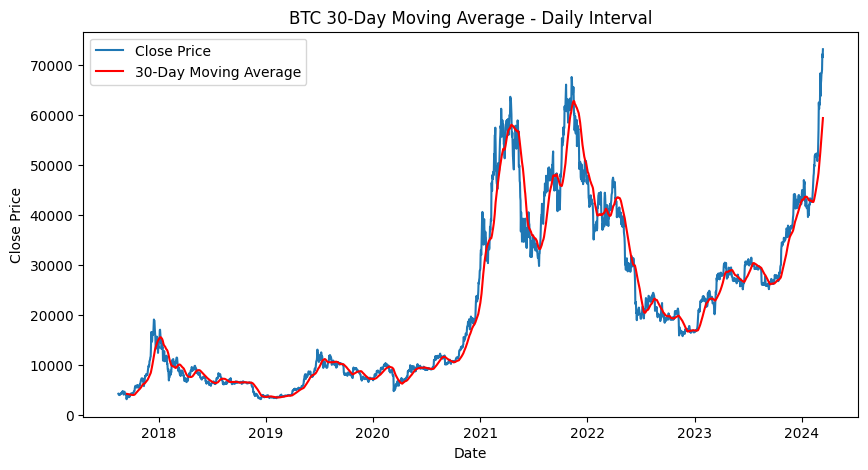

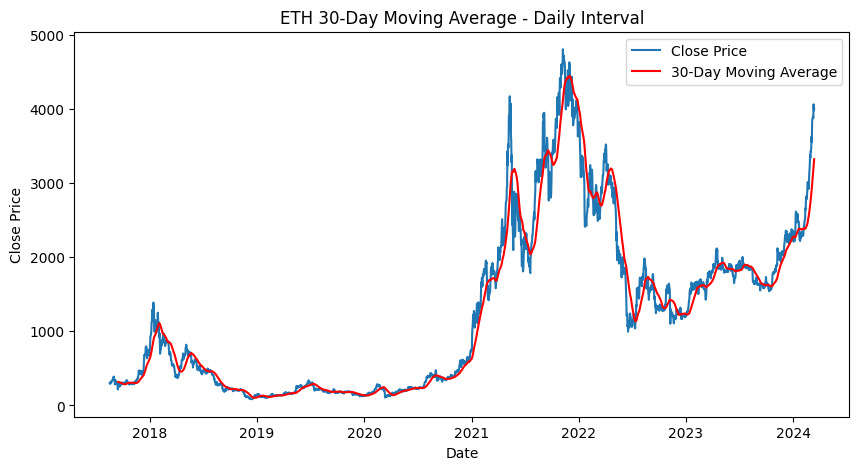

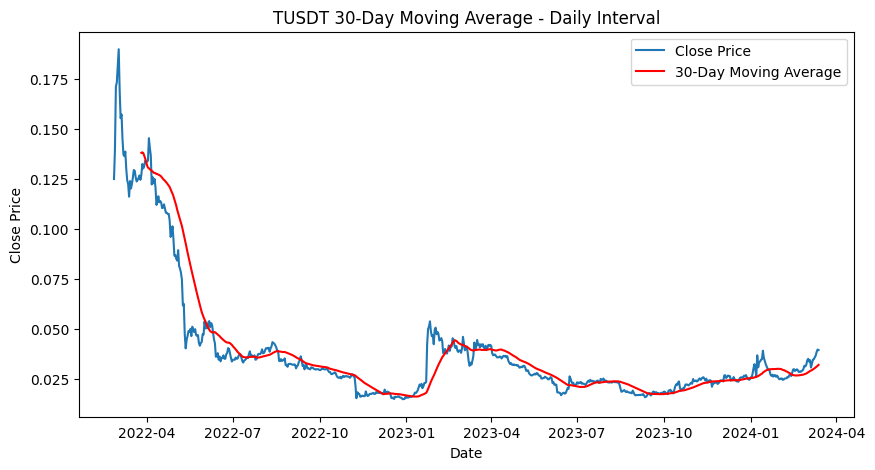

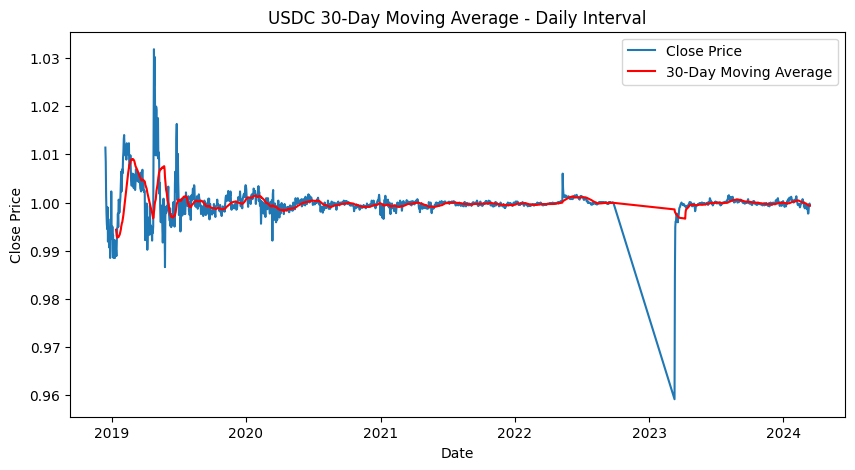

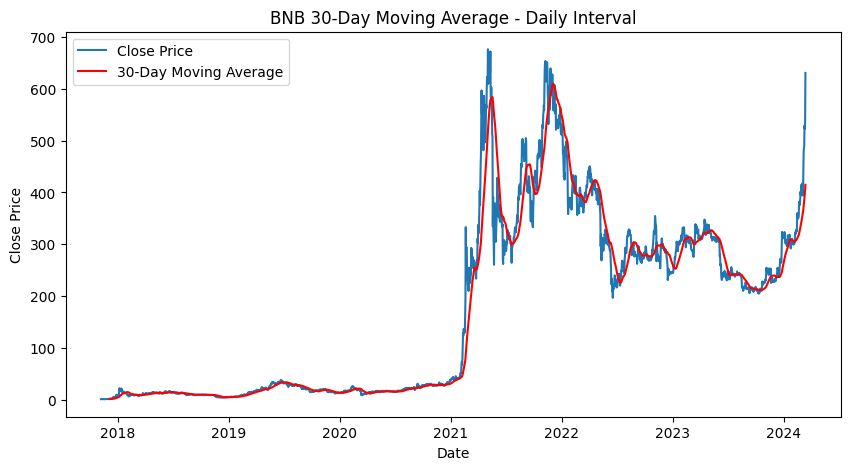

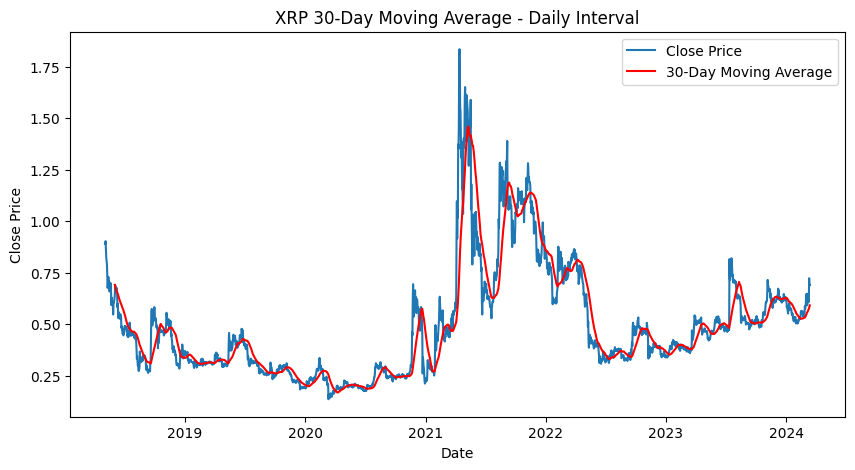

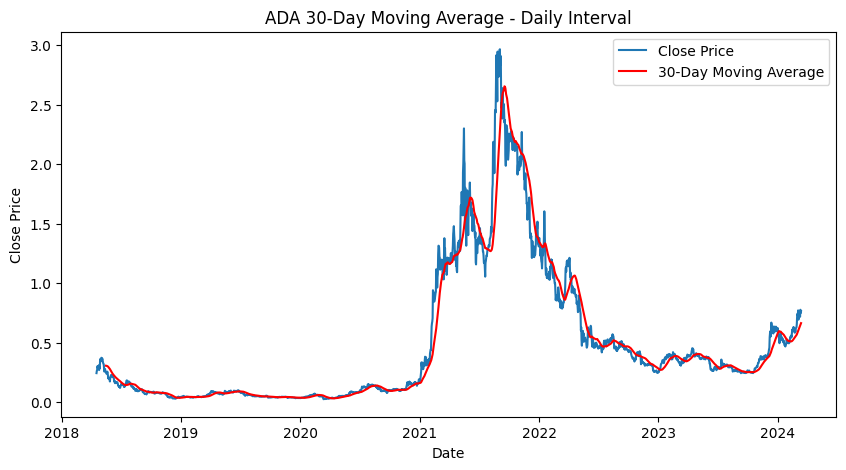

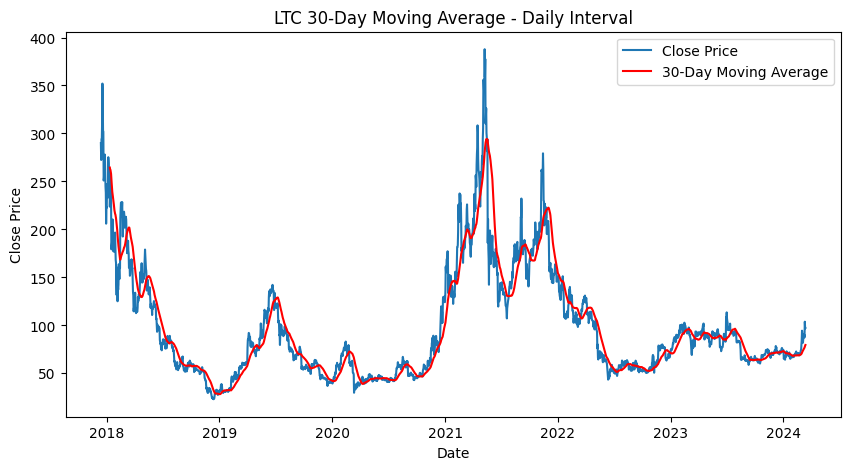

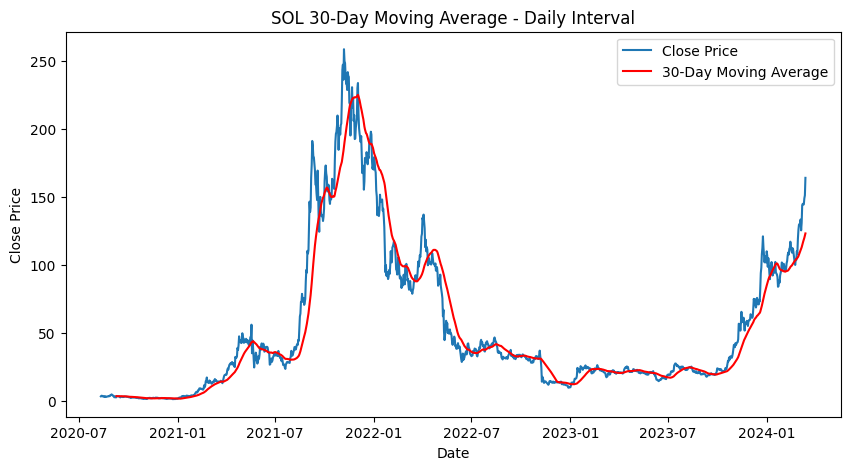

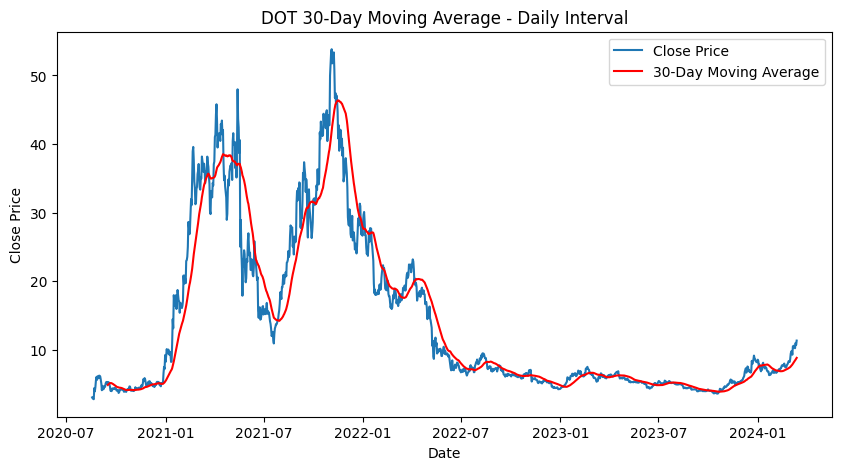


--- 30-Day Moving Average (Weekly Interval) ---


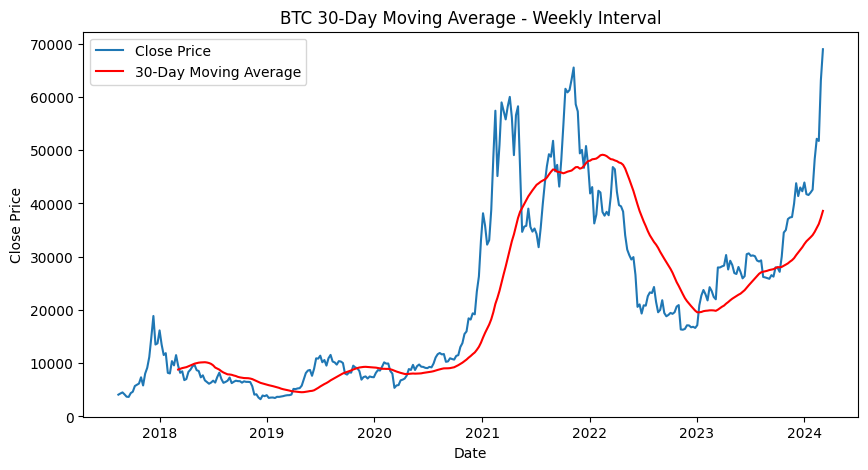

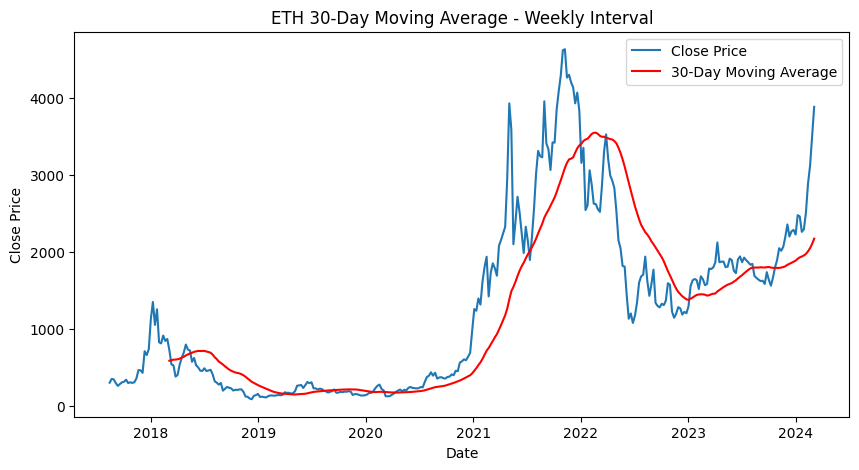

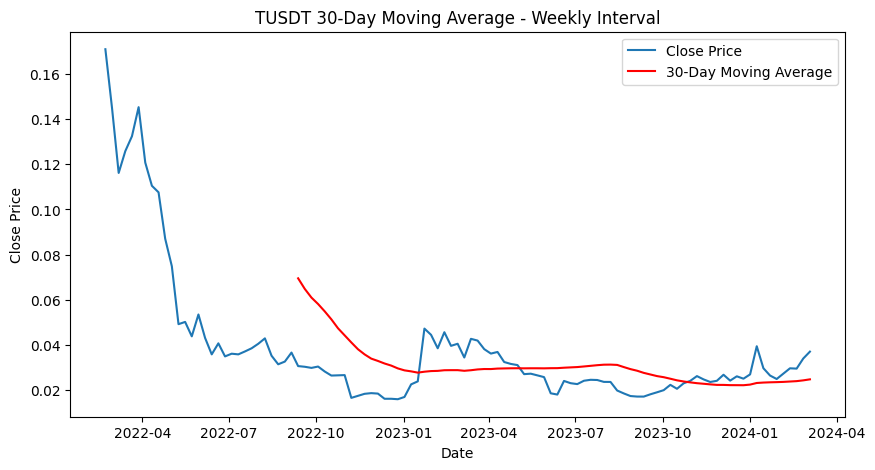

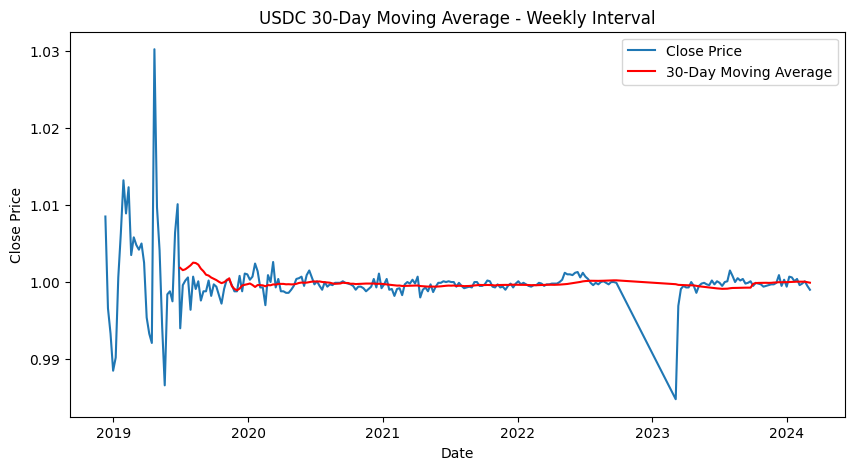

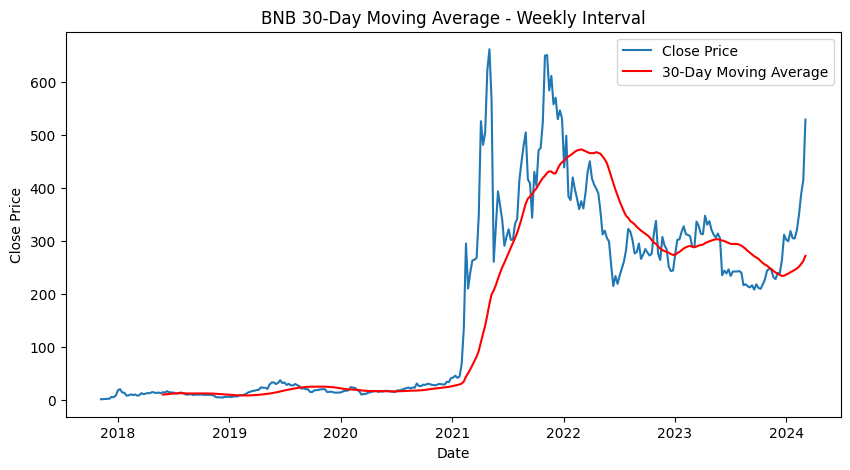

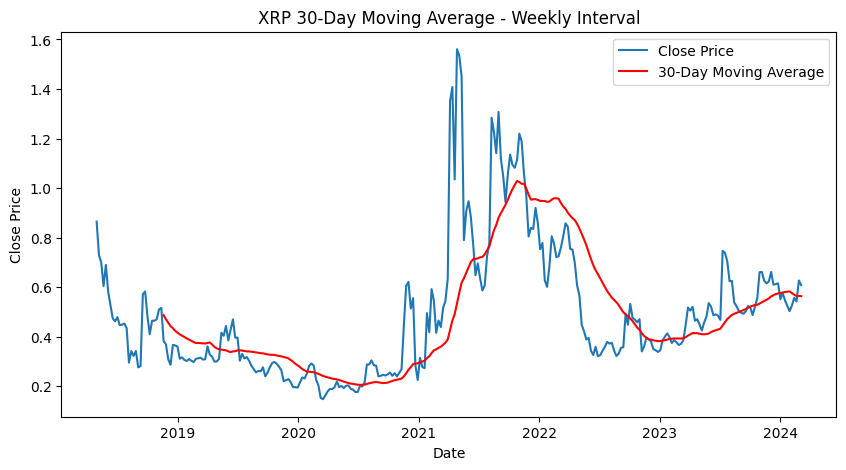

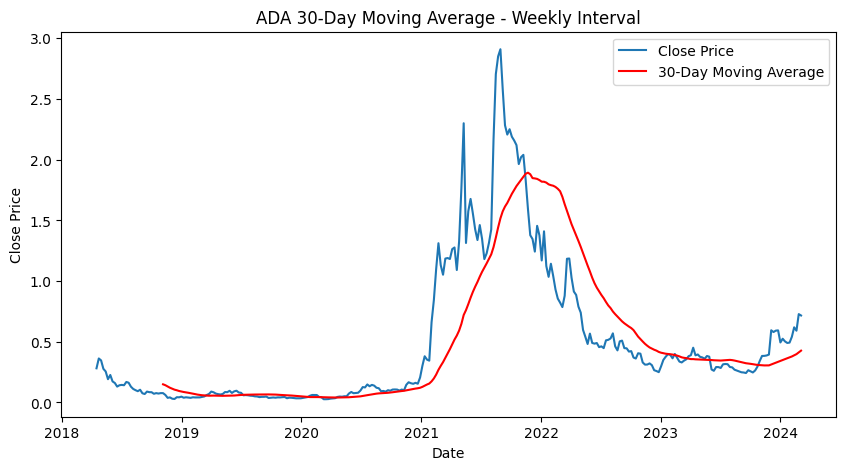

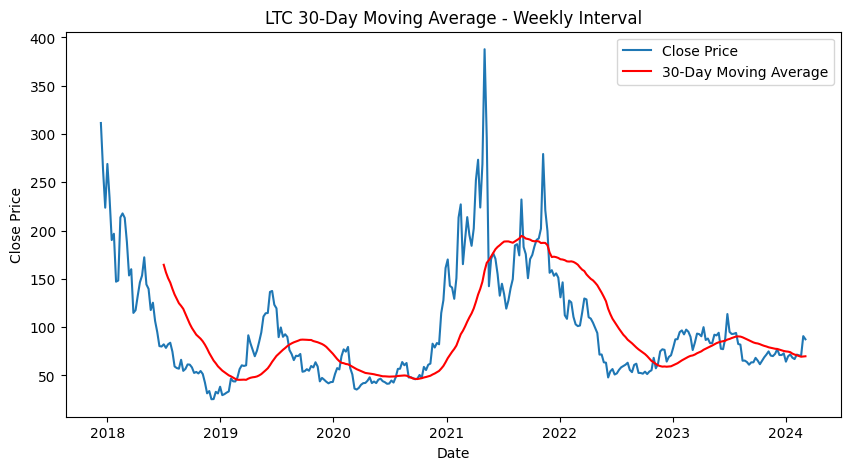

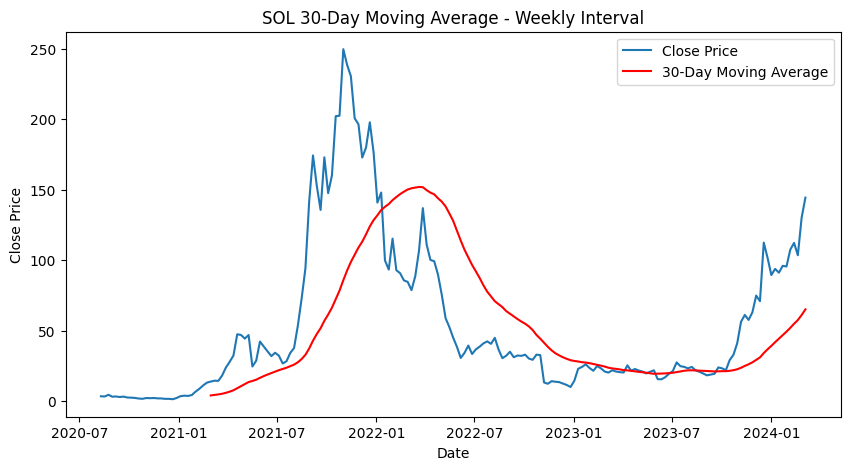

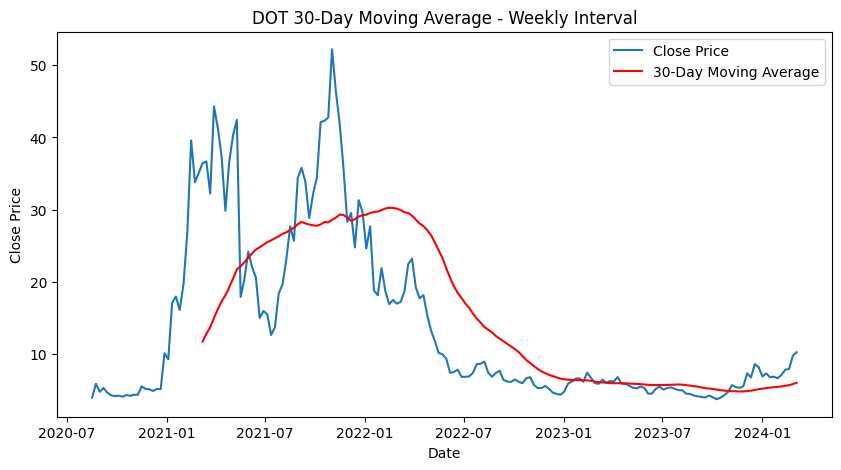

In [ ]:
# Moving average (e.g., 30-day for Daily and Weekly intervals)
for interval, folder_name in intervals.items():
    if interval not in ['D1', 'W1']:
        continue  # Skip if interval is not Daily or Weekly

    print(f"\n--- 30-Day Moving Average ({folder_name} Interval) ---")
    for crypto, data in interval_data[interval].items():
        if data.empty:
            print(f"No data for {crypto} in {folder_name} interval.")
            continue

        data['30_MA'] = data['close'].rolling(window=30).mean()
        plt.figure(figsize=(10, 5))
        plt.plot(pd.to_datetime(data['datetime']), data['close'], label='Close Price')
        plt.plot(pd.to_datetime(data['datetime']), data['30_MA'], label='30-Day Moving Average', color='red')
        plt.title(f'{crypto} 30-Day Moving Average - {folder_name} Interval')
        plt.xlabel('Date')
        plt.ylabel('Close Price')
        plt.legend()
        plt.show()


# Moving Average Analysis for Daily Intervals:

1. **BTC (Bitcoin)**
   - The 30-day moving average smoothens the high volatility of Bitcoin, showing clear trends in price increases and decreases.
   - Noticeable peaks in 2021 and a recent upward trend toward 2024 indicate significant investor interest and possible speculative trading cycles.

2. **ETH (Ethereum)**
   - The 30-day moving average effectively captures the major price surges of Ethereum, particularly around early 2021 and late 2023.
   - The consistent alignment with the price trend suggests that Ethereum closely follows market momentum, with periods of rapid growth.

3. **TUSDT (Tether)**
   - Tether’s price, being a stablecoin, mostly hovers around a specific value with minimal deviation.
   - The moving average indicates occasional deviations, particularly at the beginning of 2022, but generally remains stable.

4. **USDC (USD Coin)**
   - Similar to Tether, the USDC price remains stable around $1, with minor deviations captured by the 30-day moving average.
   - The stability of USDC reinforces its role as a stablecoin, maintaining consistent value with the USD.

5. **BNB (Binance Coin)**
   - The moving average highlights substantial growth for BNB, particularly during 2021.
   - Recent trends show increased price activity, indicating sustained interest and potential for further growth, especially as the 30-day moving average continues to align with upward trends.

6. **XRP (Ripple)**
   - XRP shows periodic surges, with the 30-day moving average smoothing these fluctuations, particularly during 2021.
   - The consistency in the moving average from late 2022 to 2024 suggests stabilized interest, though minor fluctuations continue.

7. **ADA (Cardano)**
   - The moving average reveals strong price movements around 2021, with ADA reaching new highs.
   - The recent period shows a stable pattern, with ADA’s price slowly recovering, indicating possible renewed interest.

8. **LTC (Litecoin)**
   - Litecoin shows cyclical patterns with major peaks around 2021, and the 30-day moving average smoothens these cycles.
   - The recent trend suggests recovery with moderate price growth, with the moving average aligning closely with the overall trend.

9. **SOL (Solana)**
   - Solana experienced rapid growth in 2021, captured effectively by the 30-day moving average.
   - The moving average aligns with recent upward trends in late 2023 and 2024, indicating renewed interest and growth potential.

10. **DOT (Polkadot)**
    - Polkadot’s 30-day moving average shows a sharp rise in early 2021, peaking with the broader cryptocurrency market.
    - Following the peak, the moving average entered a prolonged downward trend, indicating a correction phase through 2022.
    - In late 2023, the moving average has started to turn upwards, suggesting a potential recovery phase or renewed interest in the platform.
---

 ## Overall Summary for Daily Interval Moving Average
- The 30-day moving average is effective in smoothing out daily volatility and capturing major trends for each cryptocurrency.
- Major peaks around 2021 reflect a market-wide surge in interest and price appreciation across most cryptocurrencies.
- Stablecoins like Tether and USD Coin display minimal price movement, highlighting their stable nature.
- The trend from late 2023 into 2024 shows renewed interest in several cryptocurrencies, suggesting potential for future growth.

---


# Moving Average Analysis for Weekly Intervals:


1. **Bitcoin (BTC)**
   - The 30-day moving average shows a distinct upward trend during major bull runs, especially in late 2020 to early 2021.
   - After reaching an all-time high, BTC prices declined significantly, but recent trends indicate a resurgence toward new highs.
   - The moving average helps smooth out the volatility, showing a consistent trend rather than the extreme fluctuations in BTC prices.

2. **Ethereum (ETH)**
   - Similar to BTC, Ethereum shows strong upward movement in its moving average during the 2021 bull run.
   - The moving average peaks after price highs and gradually declines but has recently begun to rise again, indicating potential bullish momentum.
   - The moving average provides a smoother trend line, highlighting key shifts in ETH's price movement.

3. **Tether USD (TUSDT)**
   - TUSDT’s weekly moving average shows a stable and downward trend, especially post-2022.
   - The moving average reflects the asset’s gradual decline, showing minimal fluctuation.
   - The recent rise in TUSDT could indicate a shift in market sentiment or usage.

4. **USD Coin (USDC)**
   - USDC has a mostly flat moving average around 1.00 dollar, indicating its stablecoin nature.
   - Minor fluctuations are observed, but overall, the 30-day moving average remains very close to the $1 mark.
   - The moving average highlights the stability of USDC, with minor deviations around market events.

5. **Binance Coin (BNB)**
   - BNB’s moving average shows rapid price growth in 2021, with a strong bull run.
   - Following a peak, there was a consistent decline, but recent price movements show a resurgence, with the moving average indicating potential growth.
   - The moving average highlights key price trends, helping to capture the broader direction of BNB's price movement.

6. **Ripple (XRP)**
   - XRP experienced a sharp increase in its moving average around 2021, followed by a decline.
   - The moving average smooths out XRP’s volatility, reflecting gradual price changes rather than sudden spikes.
   - Recent trends show a slight increase in the moving average, indicating renewed interest or market activity.

7. **Cardano (ADA)**
   - ADA’s moving average indicates strong growth during the 2021 bull market, followed by a decrease.
   - The recent upward movement suggests renewed interest in ADA, with the moving average providing a clearer trend view.
   - ADA’s moving average showcases the asset's cyclical price trends over the years.

8. **Litecoin (LTC)**
   - Litecoin's moving average follows a pattern similar to BTC and ETH, with a strong rise in 2021 and subsequent decline.
   - Recent activity shows minor upward movement, but the long-term trend remains moderate.
   - The moving average effectively smooths out LTC's volatile price action, showing the broader trend direction.

9. **Solana (SOL)**
   - SOL’s moving average shows an aggressive rise in 2021, reflecting the asset’s rapid growth.
   - After reaching a peak, the moving average declined, indicating a correction phase.
   - The recent uptrend in the moving average suggests a possible revival in interest or market activity in SOL.

10. **Polkadot (DOT)**
    - DOT’s moving average surged during early 2021, indicating strong bullish momentum.
    - After the peak, there was a gradual decline, but recent movements hint at potential recovery.
    - The moving average provides a balanced view of DOT's price trend, capturing the broader direction amid volatility.

--------------------------------------------------------------------------------

### Overall Summary for Weekly Interval Moving Averages

- The weekly interval moving averages reveal the broader market trends for each cryptocurrency. Major peaks were observed in 2021, followed by corrections across most assets, reflecting the market's cyclical nature.
- Recent data shows a potential resurgence in interest, especially in BTC, ETH, and BNB. Stablecoins like USDC remained steady, while TUSDT showed some decline. The weekly moving averages help smooth short-term volatility, highlighting the overall trajectory of each asset.

---

## 1.8 Outlier Detection

**NOTE:** Performing this for Daily (D1), Weekly(W1), Hourly(H1) and 4-Hourly(H4) intervals, as we will be using these for the algorithms

Applying outlier detection for BTC in D1 interval.
Outliers detected for BTC (D1): {'Z-Score': 3, 'IQR': 2, 'Moving Average': 351, 'Isolation Forest': 23}


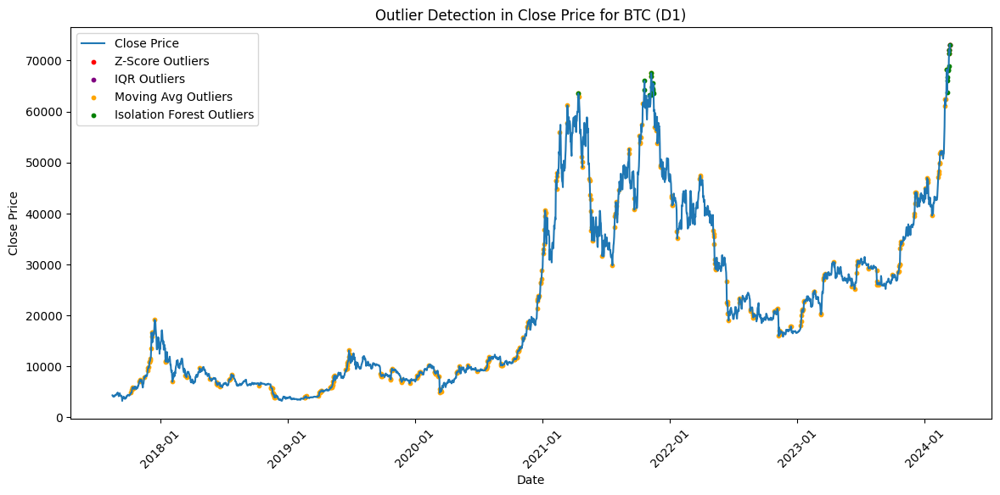

Applying outlier detection for ETH in D1 interval.
Outliers detected for ETH (D1): {'Z-Score': 5, 'IQR': 23, 'Moving Average': 342, 'Isolation Forest': 24}


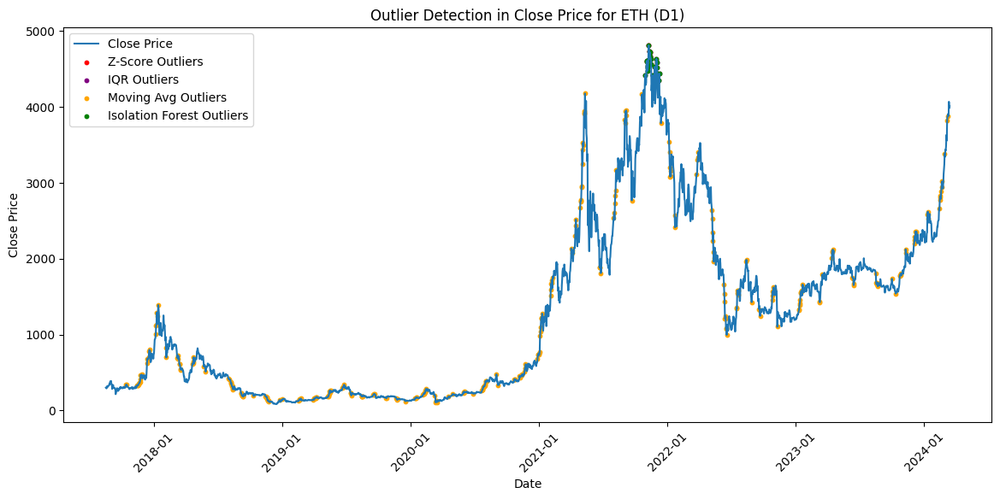

Applying outlier detection for TUSDT in D1 interval.
Outliers detected for TUSDT (D1): {'Z-Score': 25, 'IQR': 75, 'Moving Average': 87, 'Isolation Forest': 8}


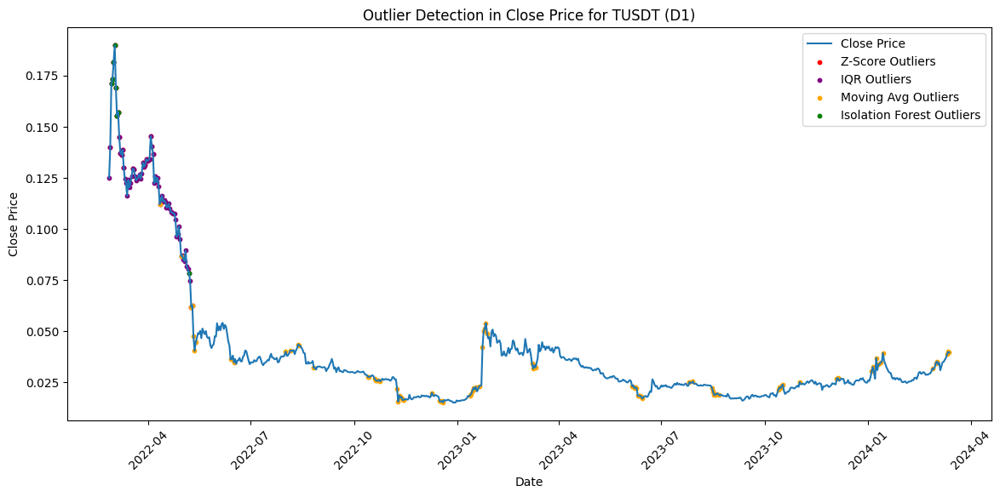

Applying outlier detection for USDC in D1 interval.
Outliers detected for USDC (D1): {'Z-Score': 50, 'IQR': 281, 'Moving Average': 117, 'Isolation Forest': 18}


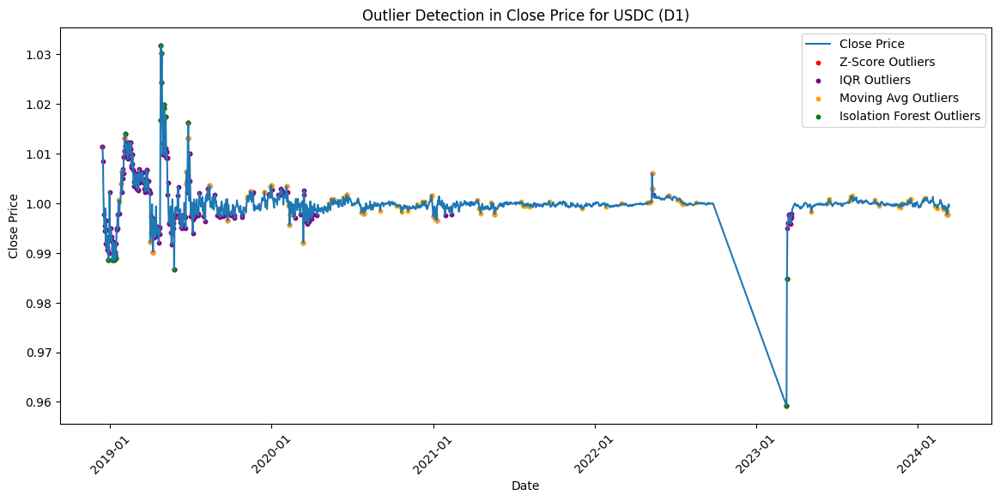

Applying outlier detection for BNB in D1 interval.
Outliers detected for BNB (D1): {'Z-Score': 0, 'IQR': 0, 'Moving Average': 324, 'Isolation Forest': 24}


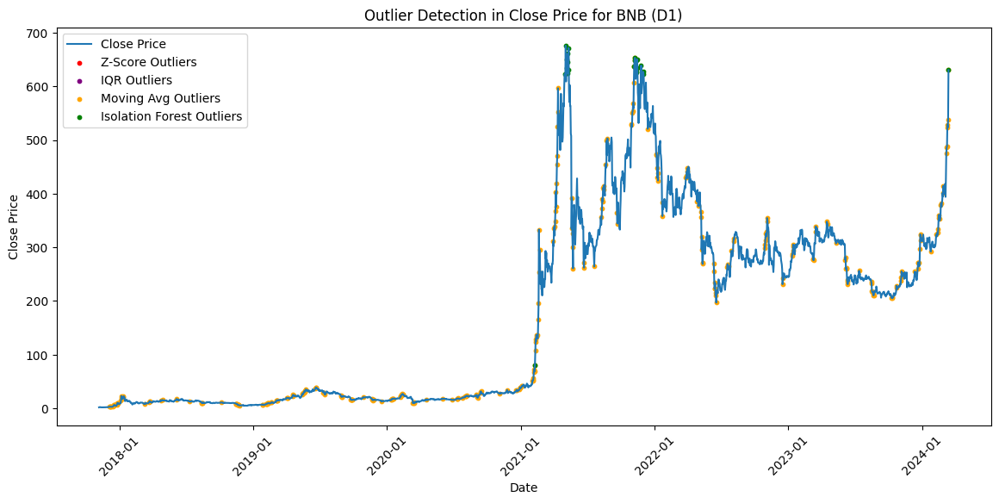

Applying outlier detection for XRP in D1 interval.
Outliers detected for XRP (D1): {'Z-Score': 35, 'IQR': 121, 'Moving Average': 255, 'Isolation Forest': 22}


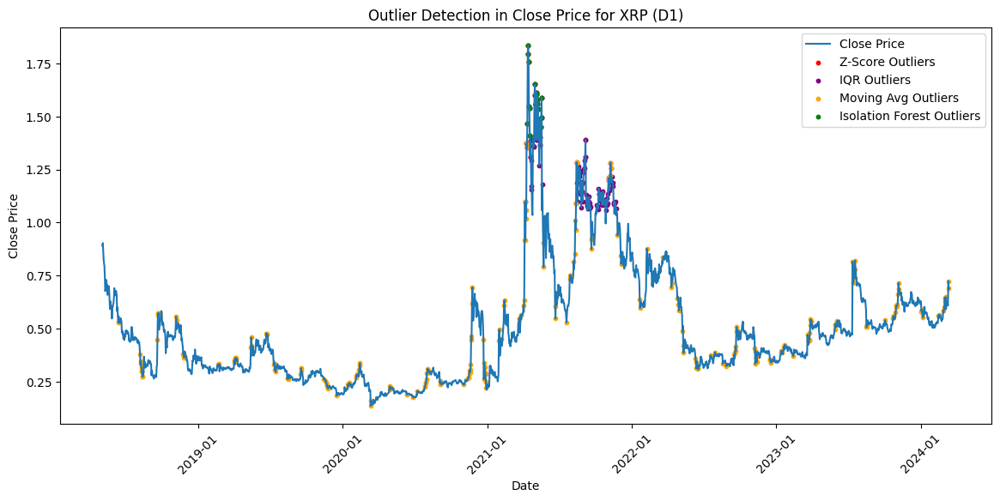

Applying outlier detection for ADA in D1 interval.
Outliers detected for ADA (D1): {'Z-Score': 45, 'IQR': 252, 'Moving Average': 298, 'Isolation Forest': 22}


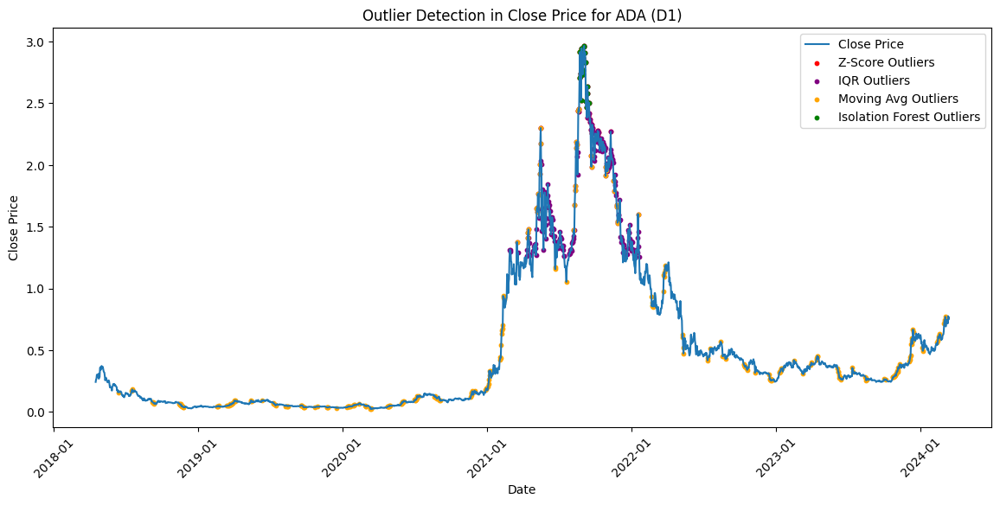

Applying outlier detection for LTC in D1 interval.
Outliers detected for LTC (D1): {'Z-Score': 35, 'IQR': 91, 'Moving Average': 288, 'Isolation Forest': 21}


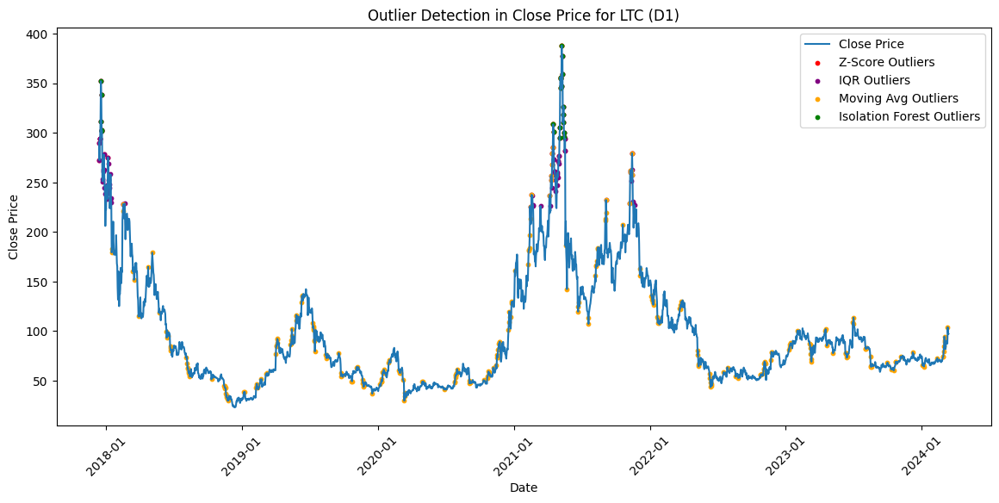

Applying outlier detection for SOL in D1 interval.
Outliers detected for SOL (D1): {'Z-Score': 21, 'IQR': 62, 'Moving Average': 214, 'Isolation Forest': 14}


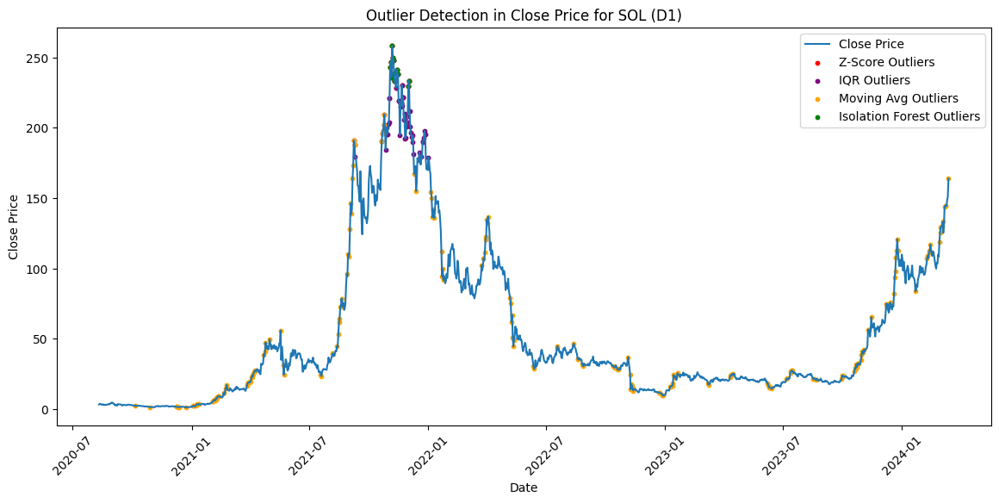

Applying outlier detection for DOT in D1 interval.
Outliers detected for DOT (D1): {'Z-Score': 9, 'IQR': 43, 'Moving Average': 178, 'Isolation Forest': 14}


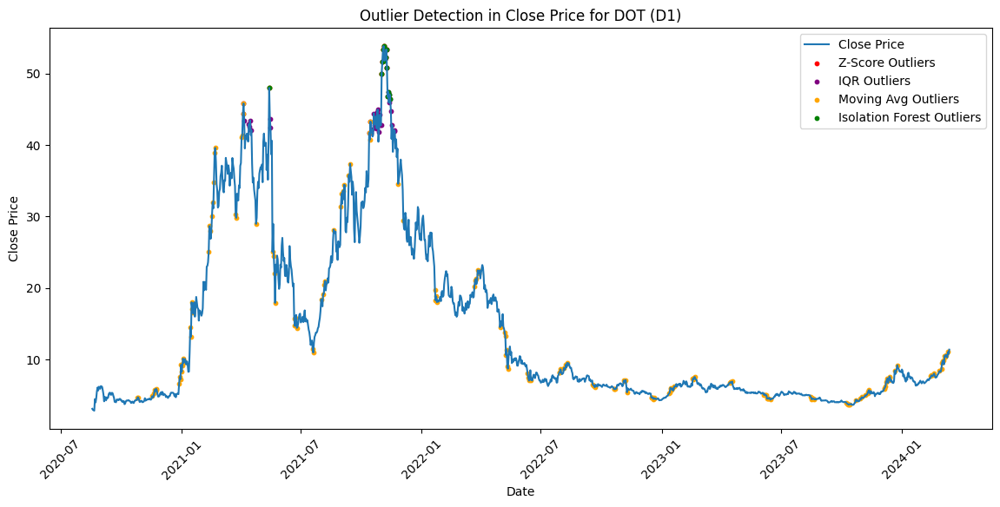

Applying outlier detection for BTC in H1 interval.
Outliers detected for BTC (H1): {'Z-Score': 70, 'IQR': 49, 'Moving Average': 7180, 'Isolation Forest': 568}


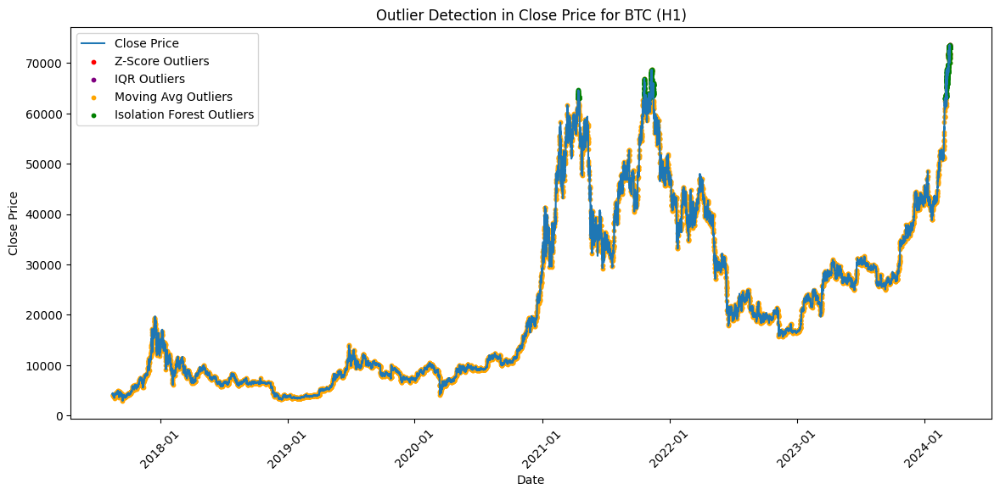

Applying outlier detection for ETH in H1 interval.
Outliers detected for ETH (H1): {'Z-Score': 153, 'IQR': 523, 'Moving Average': 7064, 'Isolation Forest': 568}


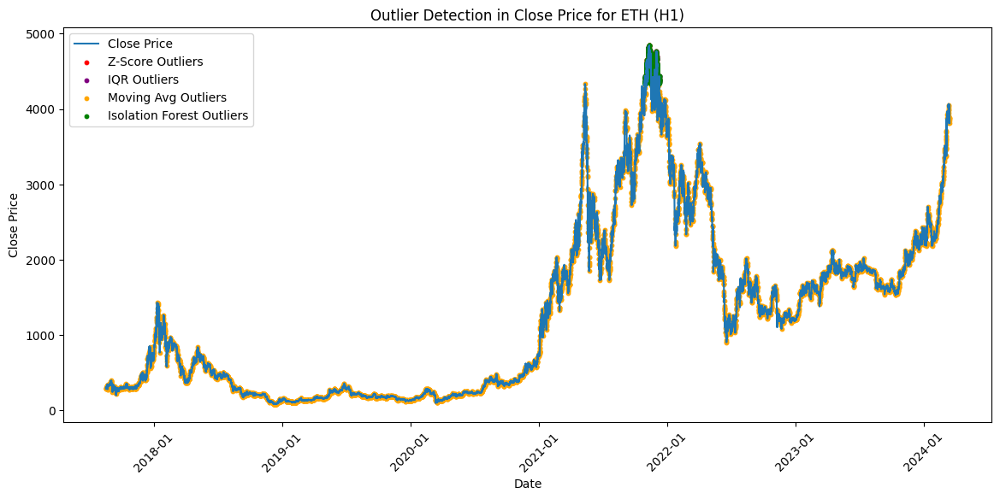

Applying outlier detection for TUSDT in H1 interval.
Outliers detected for TUSDT (H1): {'Z-Score': 613, 'IQR': 1807, 'Moving Average': 2067, 'Isolation Forest': 171}


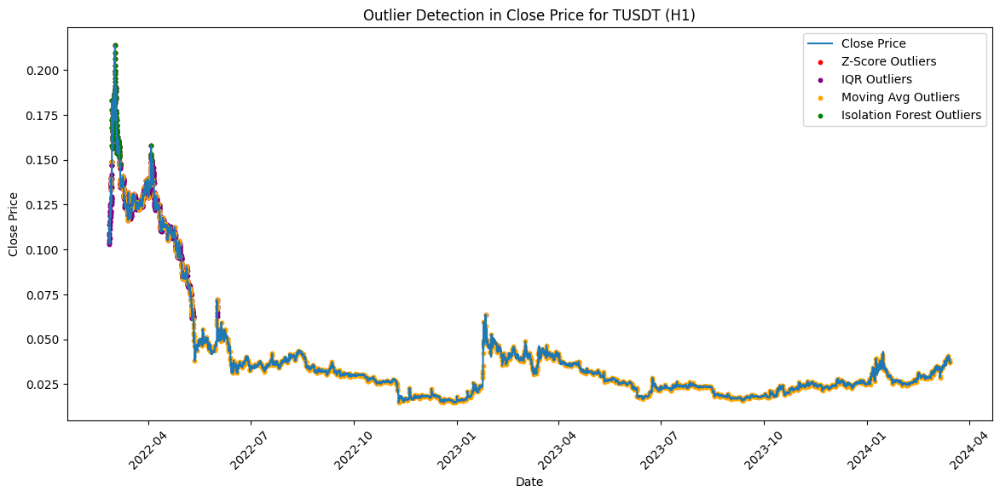

Applying outlier detection for USDC in H1 interval.
Outliers detected for USDC (H1): {'Z-Score': 1038, 'IQR': 7254, 'Moving Average': 3575, 'Isolation Forest': 409}


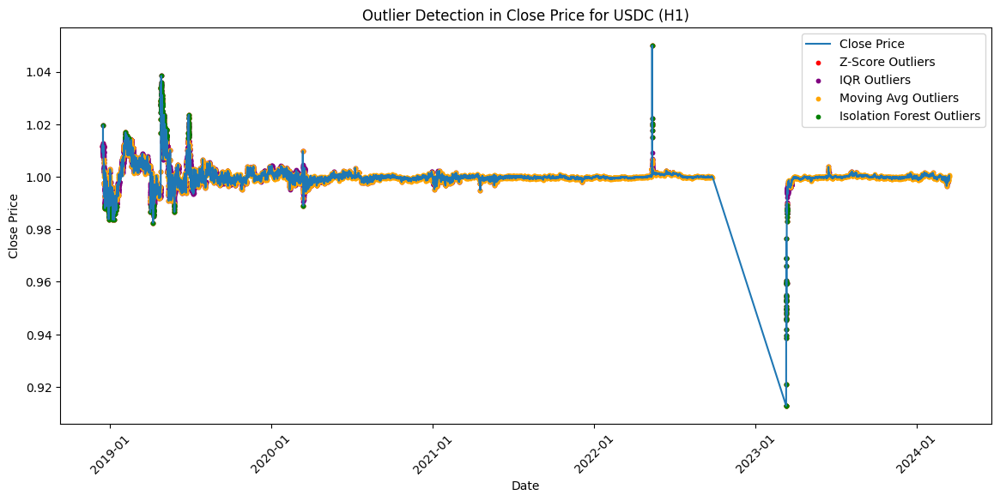

Applying outlier detection for BNB in H1 interval.
Outliers detected for BNB (H1): {'Z-Score': 0, 'IQR': 0, 'Moving Average': 6871, 'Isolation Forest': 515}


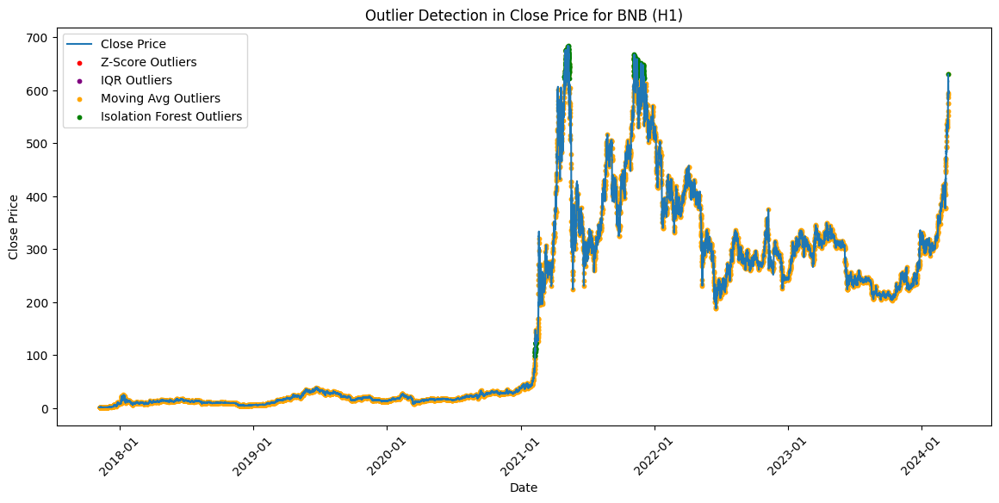

Applying outlier detection for XRP in H1 interval.
Outliers detected for XRP (H1): {'Z-Score': 863, 'IQR': 2997, 'Moving Average': 6183, 'Isolation Forest': 514}


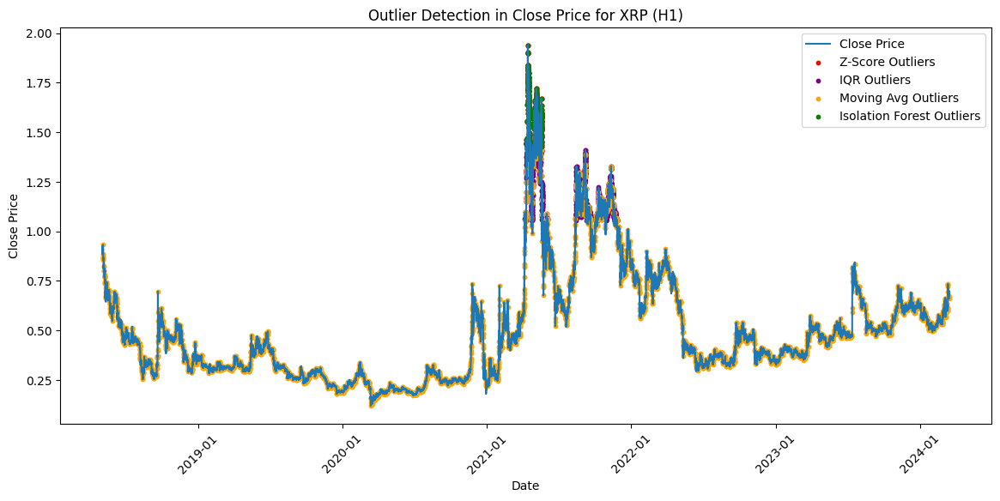

Applying outlier detection for ADA in H1 interval.
Outliers detected for ADA (H1): {'Z-Score': 1085, 'IQR': 6062, 'Moving Average': 6408, 'Isolation Forest': 515}


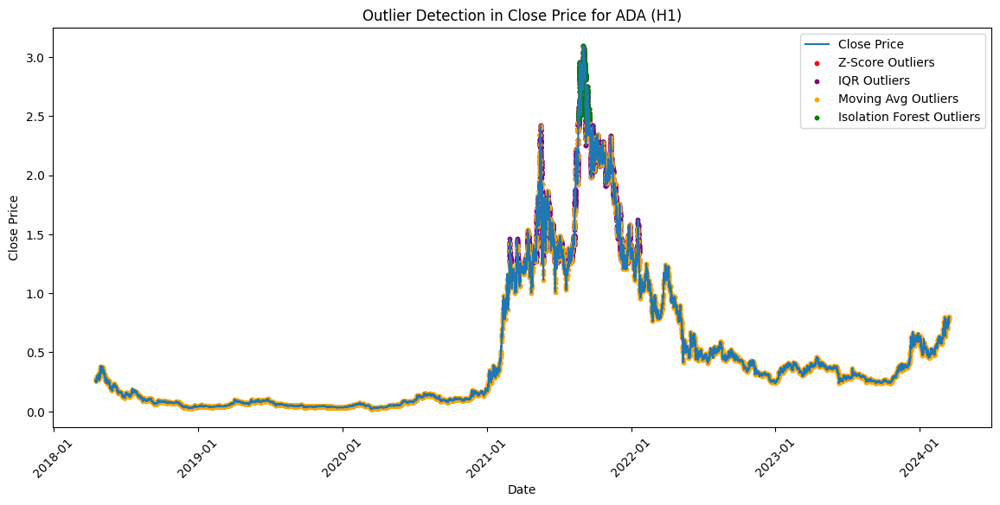

Applying outlier detection for LTC in H1 interval.
Outliers detected for LTC (H1): {'Z-Score': 855, 'IQR': 2255, 'Moving Average': 6617, 'Isolation Forest': 533}


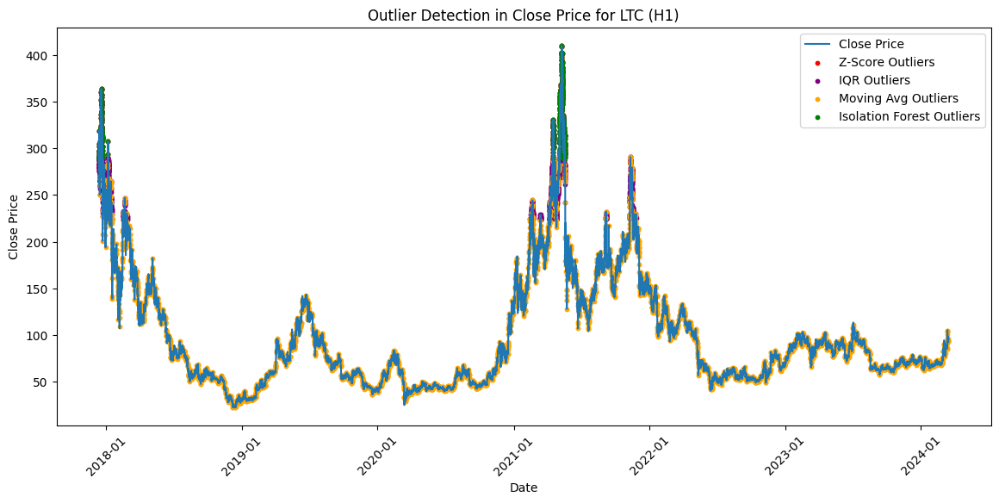

Applying outlier detection for SOL in H1 interval.
Outliers detected for SOL (H1): {'Z-Score': 453, 'IQR': 1496, 'Moving Average': 3859, 'Isolation Forest': 313}


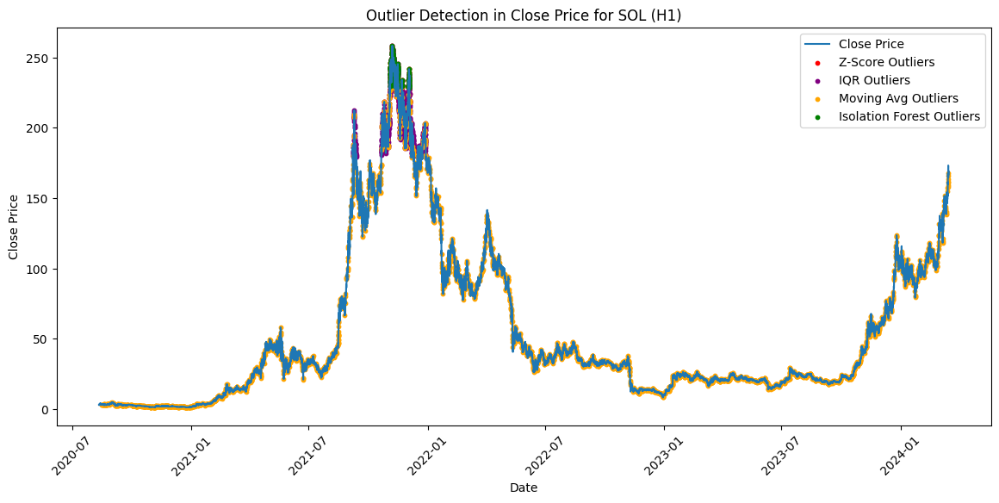

Applying outlier detection for DOT in H1 interval.
Outliers detected for DOT (H1): {'Z-Score': 212, 'IQR': 928, 'Moving Average': 3893, 'Isolation Forest': 310}


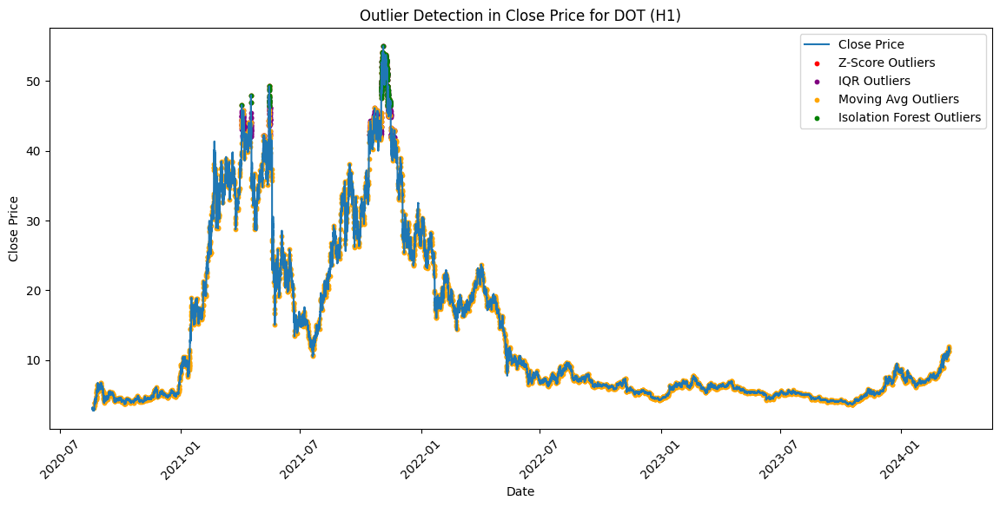

Applying outlier detection for BTC in H4 interval.
Outliers detected for BTC (H4): {'Z-Score': 18, 'IQR': 14, 'Moving Average': 1959, 'Isolation Forest': 144}


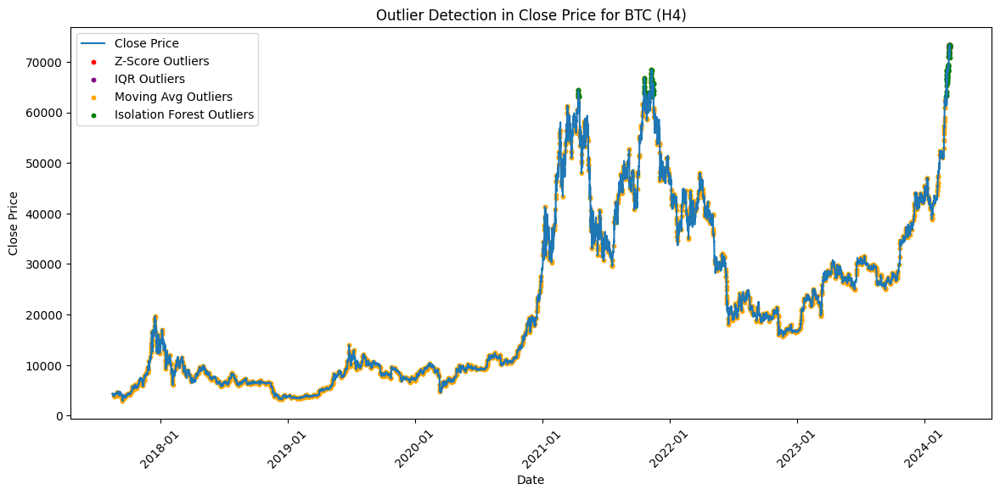

Applying outlier detection for ETH in H4 interval.
Outliers detected for ETH (H4): {'Z-Score': 39, 'IQR': 129, 'Moving Average': 1975, 'Isolation Forest': 138}


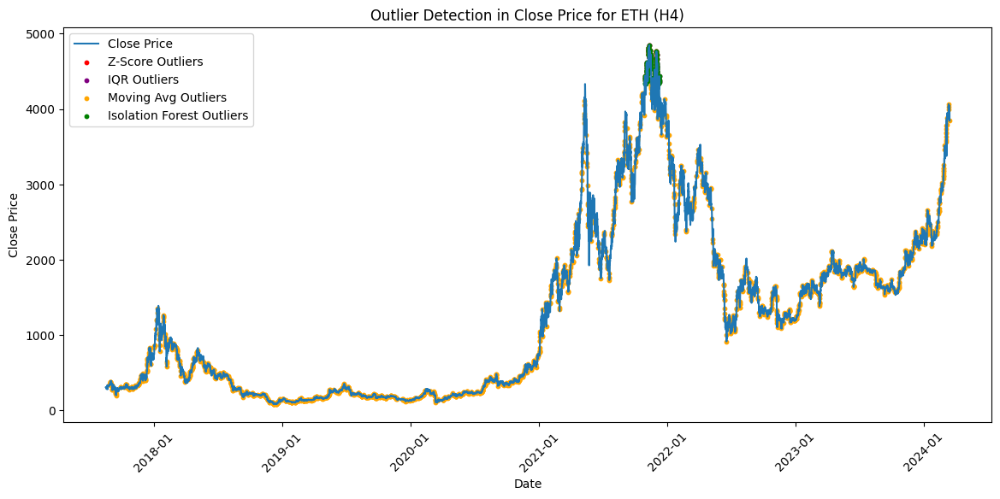

Applying outlier detection for TUSDT in H4 interval.
Outliers detected for TUSDT (H4): {'Z-Score': 152, 'IQR': 452, 'Moving Average': 548, 'Isolation Forest': 45}


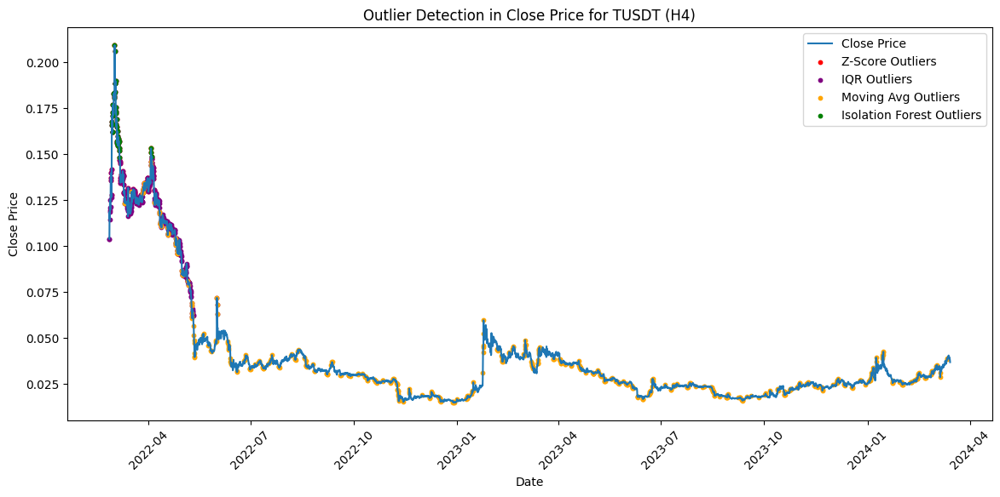

Applying outlier detection for USDC in H4 interval.
Outliers detected for USDC (H4): {'Z-Score': 253, 'IQR': 1701, 'Moving Average': 858, 'Isolation Forest': 105}


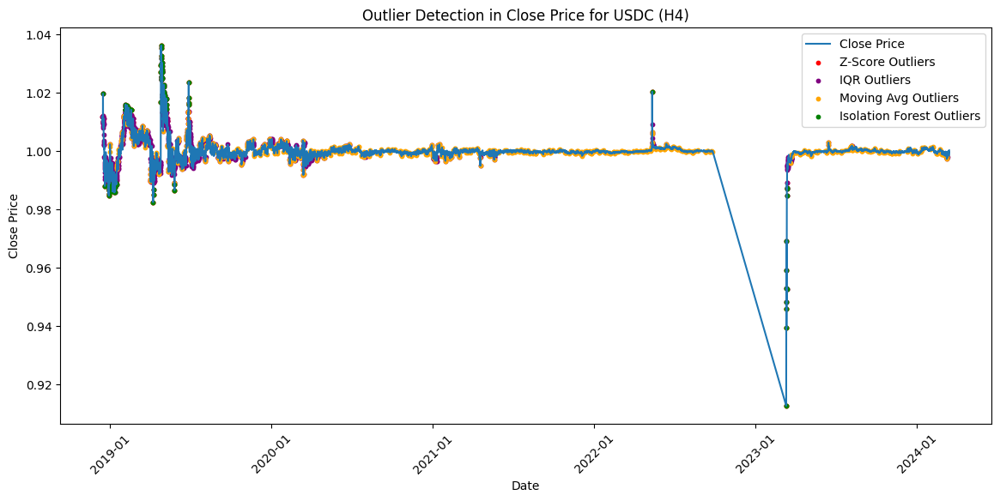

Applying outlier detection for BNB in H4 interval.
Outliers detected for BNB (H4): {'Z-Score': 0, 'IQR': 0, 'Moving Average': 1868, 'Isolation Forest': 139}


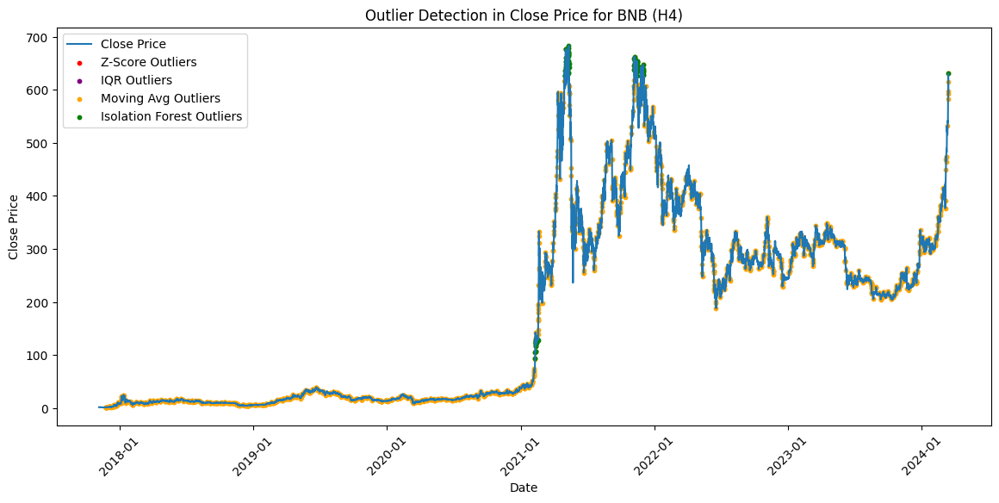

Applying outlier detection for XRP in H4 interval.
Outliers detected for XRP (H4): {'Z-Score': 214, 'IQR': 754, 'Moving Average': 1604, 'Isolation Forest': 128}


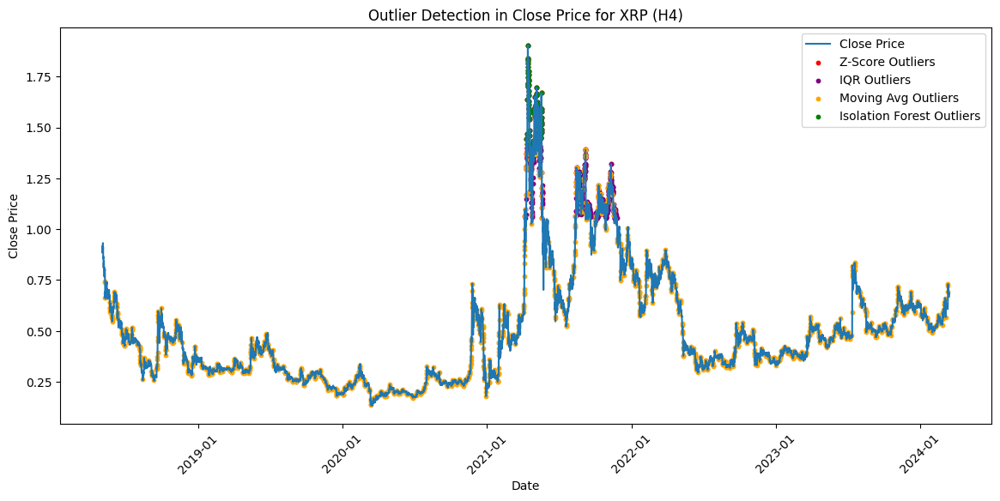

Applying outlier detection for ADA in H4 interval.
Outliers detected for ADA (H4): {'Z-Score': 270, 'IQR': 1513, 'Moving Average': 1692, 'Isolation Forest': 129}


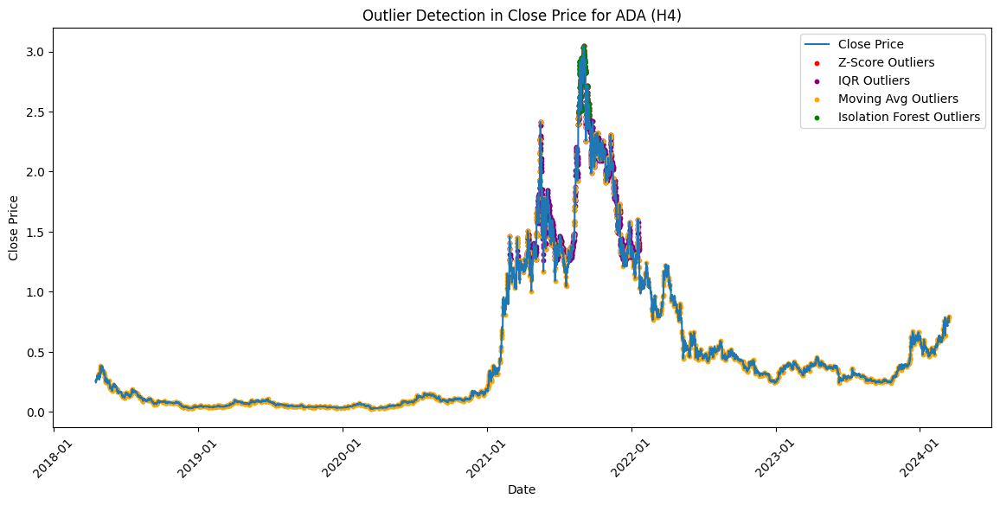

Applying outlier detection for LTC in H4 interval.
Outliers detected for LTC (H4): {'Z-Score': 218, 'IQR': 552, 'Moving Average': 1734, 'Isolation Forest': 135}


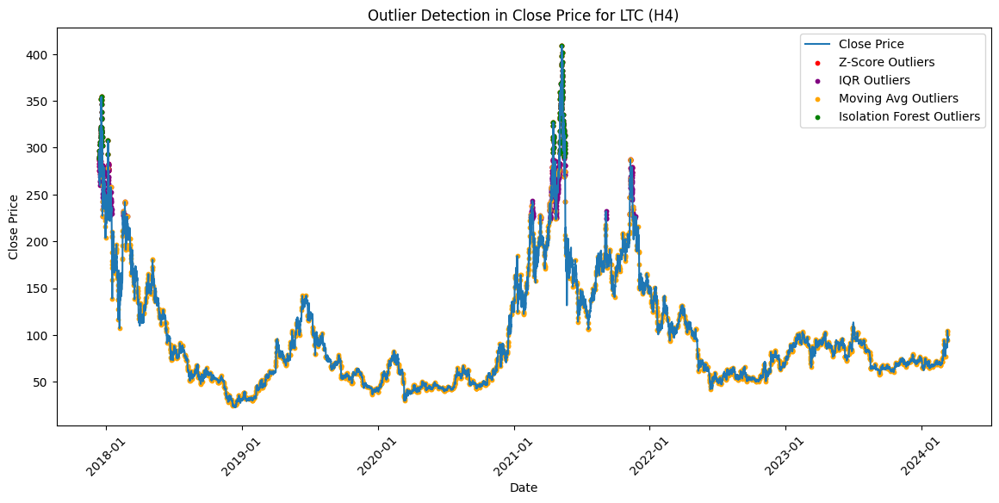

Applying outlier detection for SOL in H4 interval.
Outliers detected for SOL (H4): {'Z-Score': 112, 'IQR': 383, 'Moving Average': 1068, 'Isolation Forest': 79}


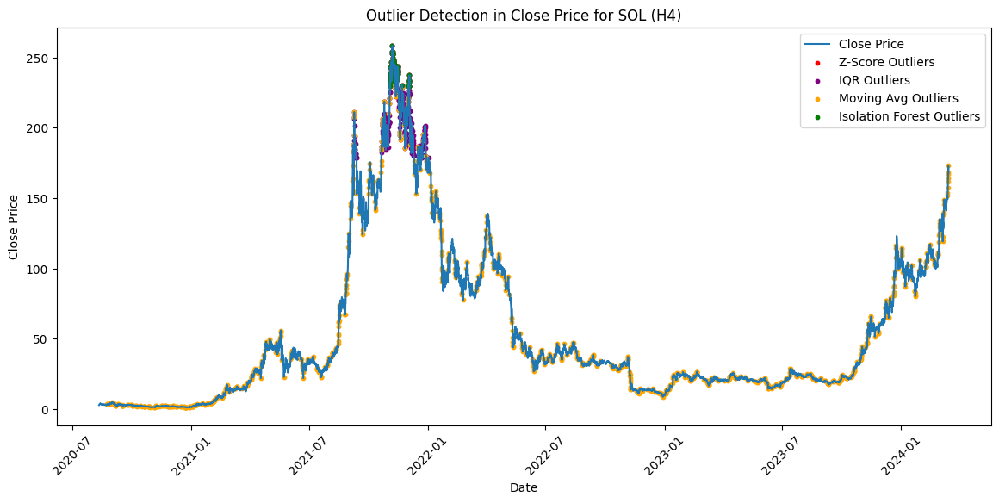

Applying outlier detection for DOT in H4 interval.
Outliers detected for DOT (H4): {'Z-Score': 55, 'IQR': 226, 'Moving Average': 999, 'Isolation Forest': 79}


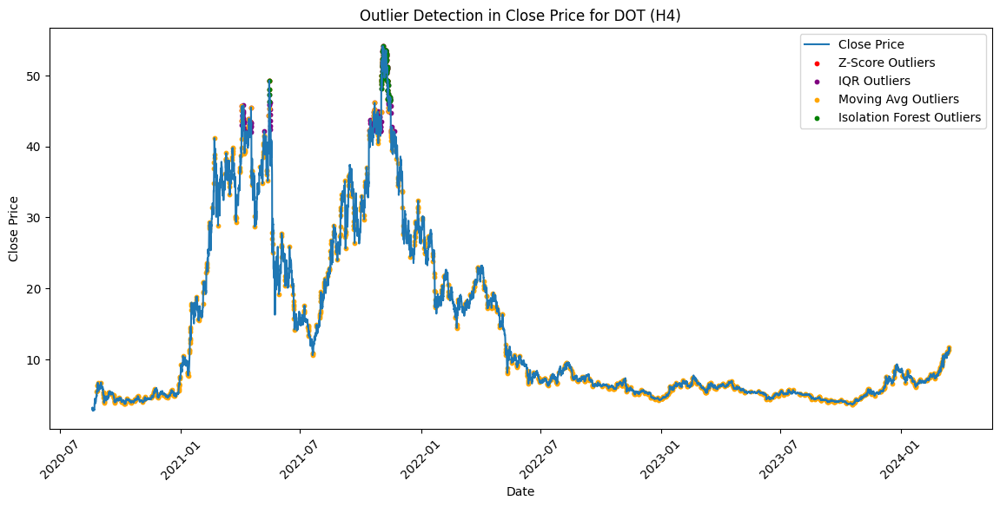

Applying outlier detection for BTC in M5 interval.
Outliers detected for BTC (M5): {'Z-Score': 856, 'IQR': 645, 'Moving Average': 80715, 'Isolation Forest': 6650}


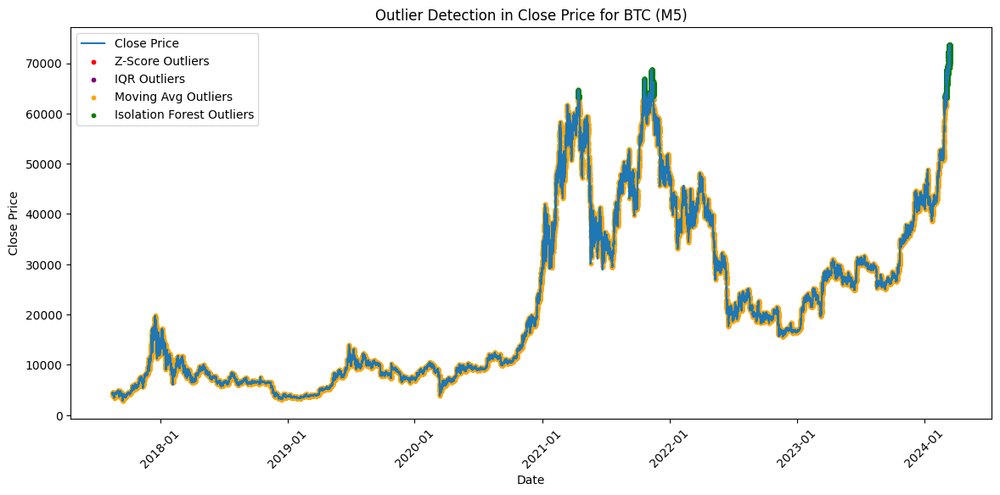

Applying outlier detection for ETH in M5 interval.
Outliers detected for ETH (M5): {'Z-Score': 1853, 'IQR': 6298, 'Moving Average': 83321, 'Isolation Forest': 6883}


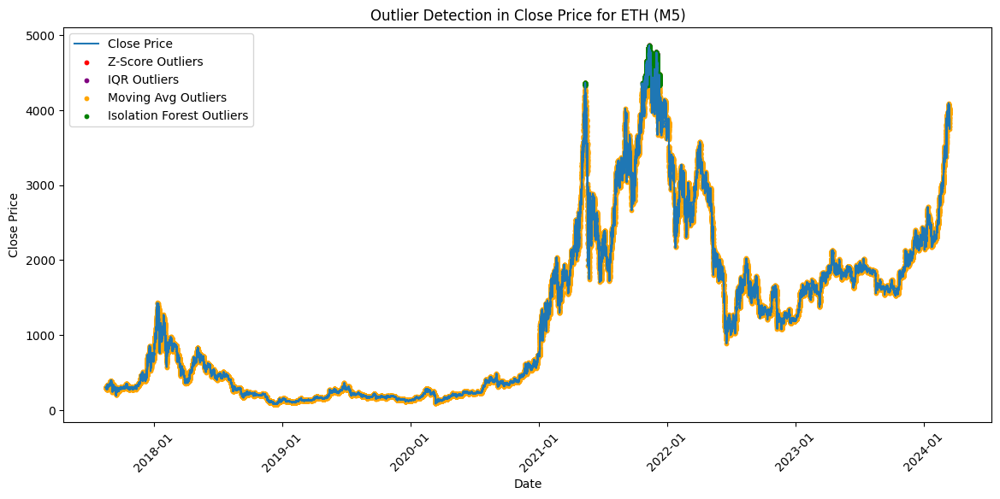

Applying outlier detection for TUSDT in M5 interval.
Outliers detected for TUSDT (M5): {'Z-Score': 7347, 'IQR': 21668, 'Moving Average': 24575, 'Isolation Forest': 2149}


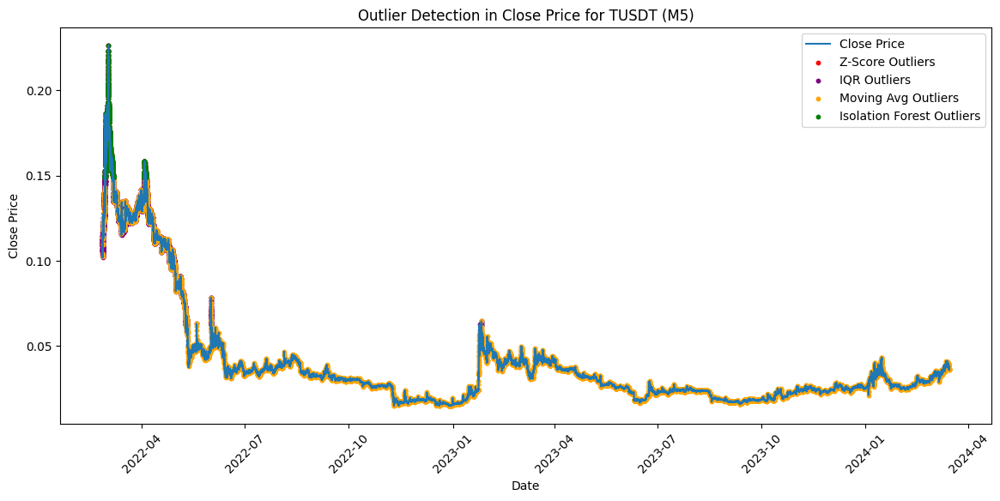

Applying outlier detection for USDC in M5 interval.
Outliers detected for USDC (M5): {'Z-Score': 12068, 'IQR': 87273, 'Moving Average': 33652, 'Isolation Forest': 4970}


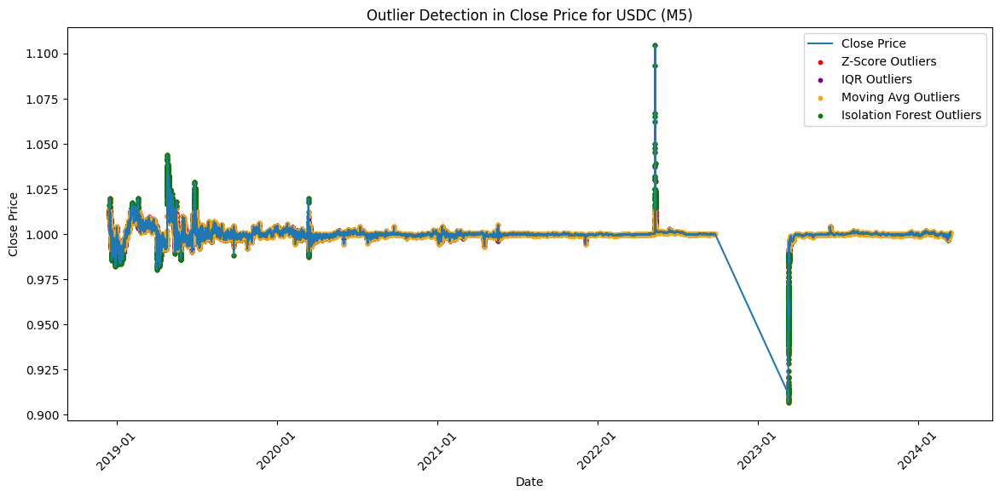

Applying outlier detection for BNB in M5 interval.
Outliers detected for BNB (M5): {'Z-Score': 0, 'IQR': 0, 'Moving Average': 79662, 'Isolation Forest': 6375}


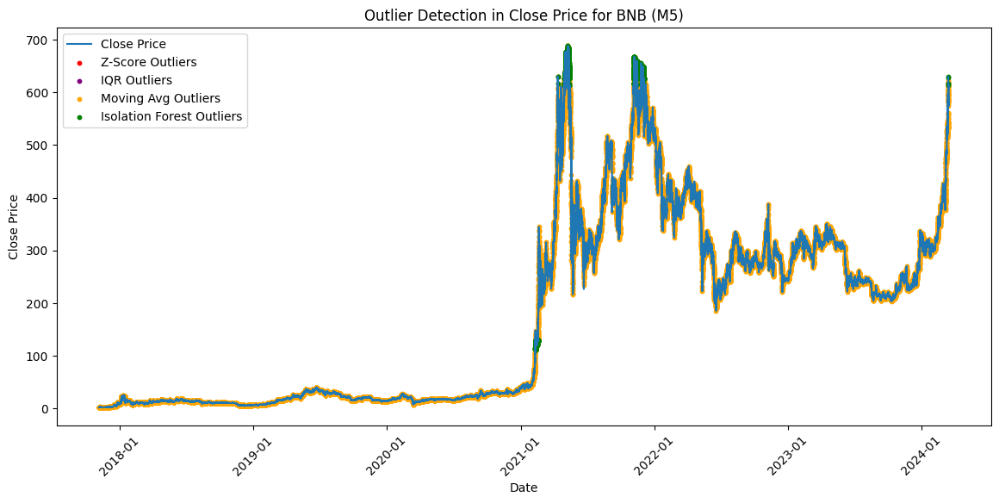

Applying outlier detection for XRP in M5 interval.
Outliers detected for XRP (M5): {'Z-Score': 10420, 'IQR': 35994, 'Moving Average': 71985, 'Isolation Forest': 6101}


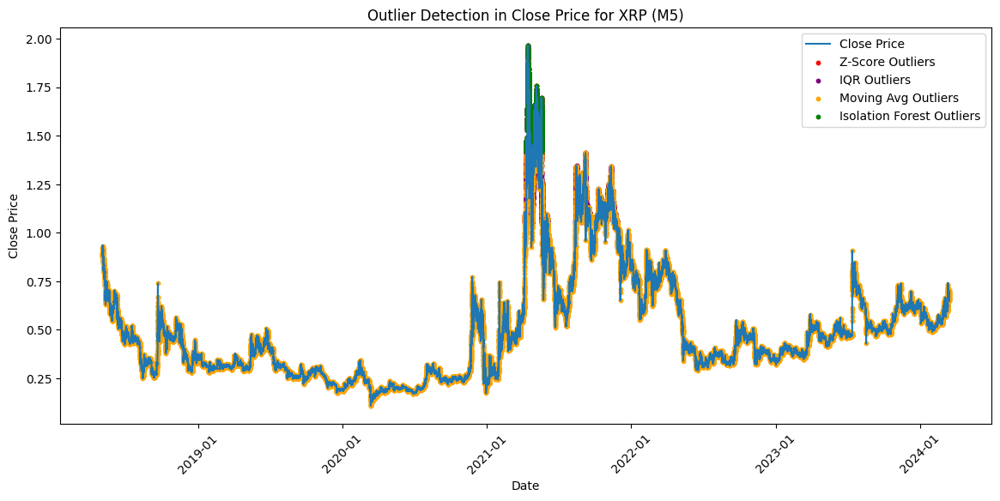

Applying outlier detection for ADA in M5 interval.
Outliers detected for ADA (M5): {'Z-Score': 12917, 'IQR': 72755, 'Moving Average': 74252, 'Isolation Forest': 6194}


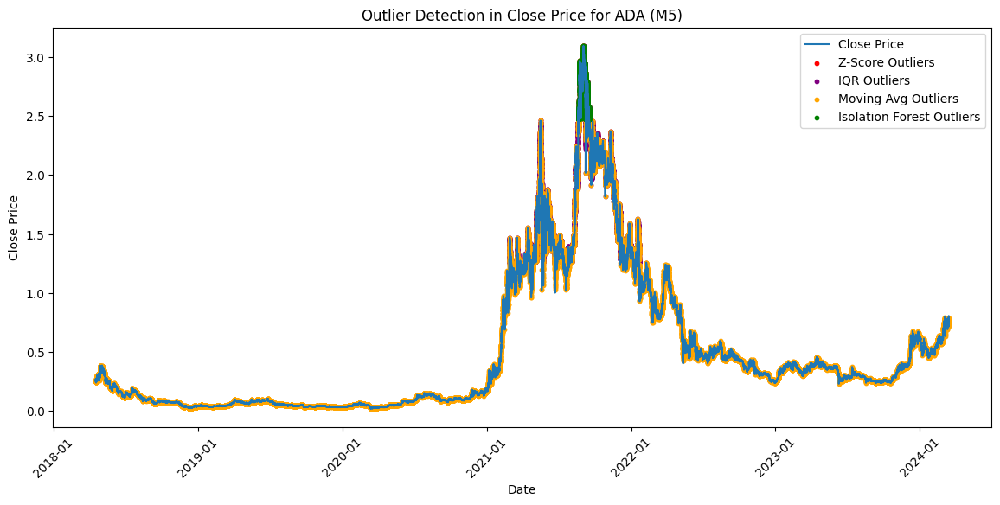

Applying outlier detection for LTC in M5 interval.
Outliers detected for LTC (M5): {'Z-Score': 10281, 'IQR': 26890, 'Moving Average': 78266, 'Isolation Forest': 6452}


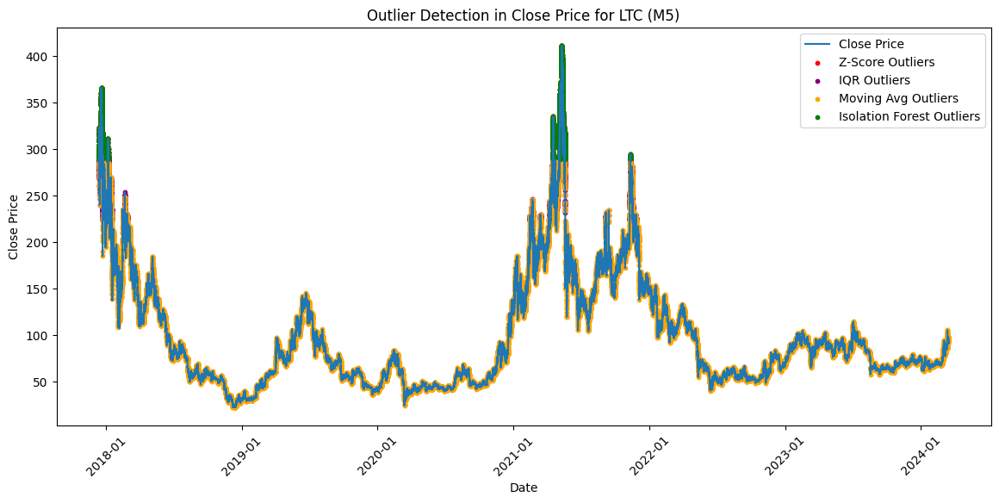

Applying outlier detection for SOL in M5 interval.
Outliers detected for SOL (M5): {'Z-Score': 5448, 'IQR': 17885, 'Moving Average': 45891, 'Isolation Forest': 3763}


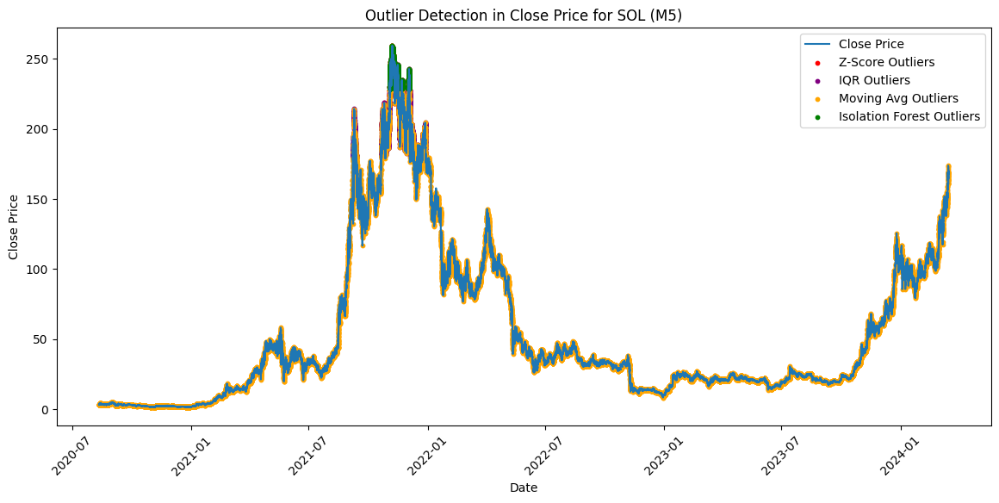

Applying outlier detection for DOT in M5 interval.
Outliers detected for DOT (M5): {'Z-Score': 2519, 'IQR': 11173, 'Moving Average': 44484, 'Isolation Forest': 3728}


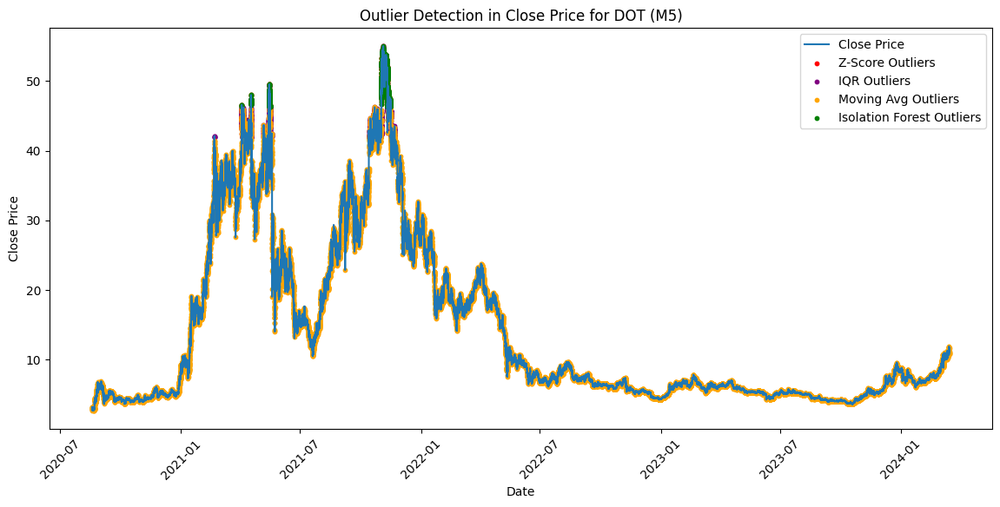

Applying outlier detection for BTC in M15 interval.
Outliers detected for BTC (M15): {'Z-Score': 284, 'IQR': 210, 'Moving Average': 27947, 'Isolation Forest': 2300}


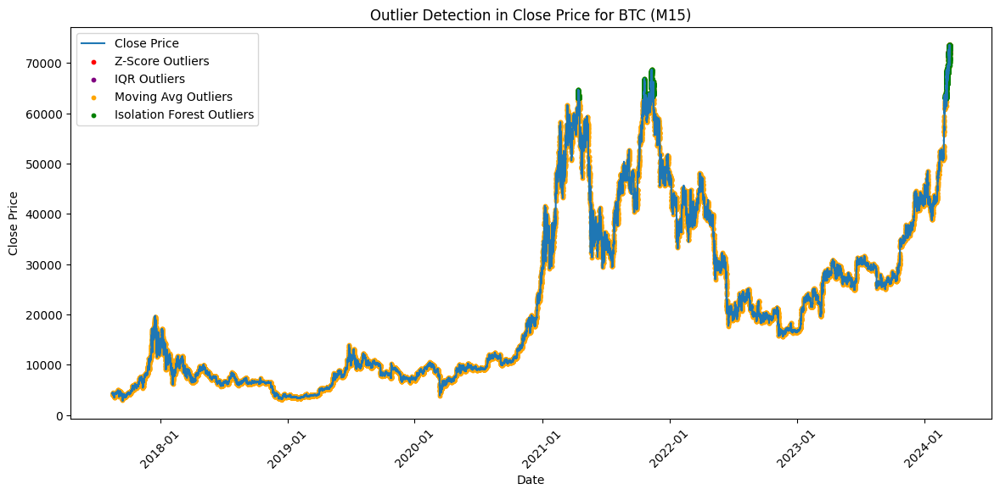

Applying outlier detection for ETH in M15 interval.
Outliers detected for ETH (M15): {'Z-Score': 619, 'IQR': 2099, 'Moving Average': 28414, 'Isolation Forest': 2292}


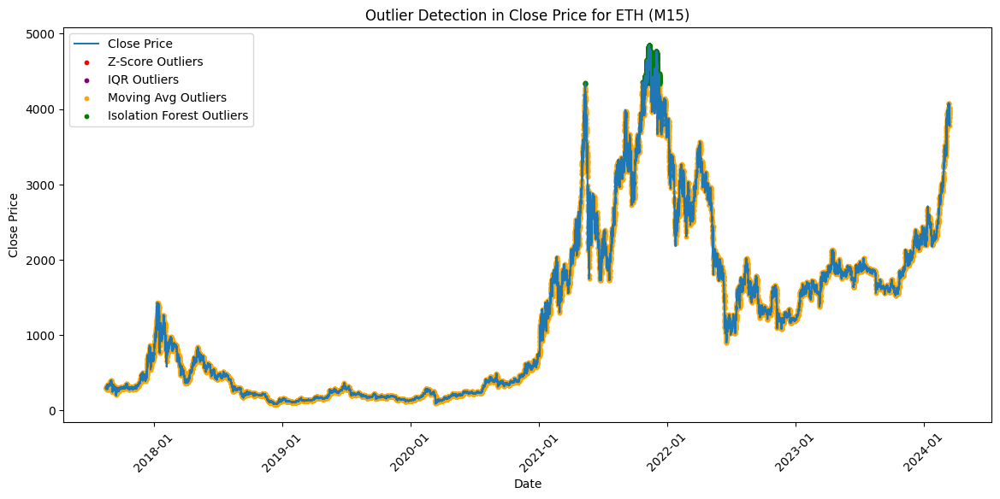

Applying outlier detection for TUSDT in M15 interval.
Outliers detected for TUSDT (M15): {'Z-Score': 2452, 'IQR': 7222, 'Moving Average': 8314, 'Isolation Forest': 705}


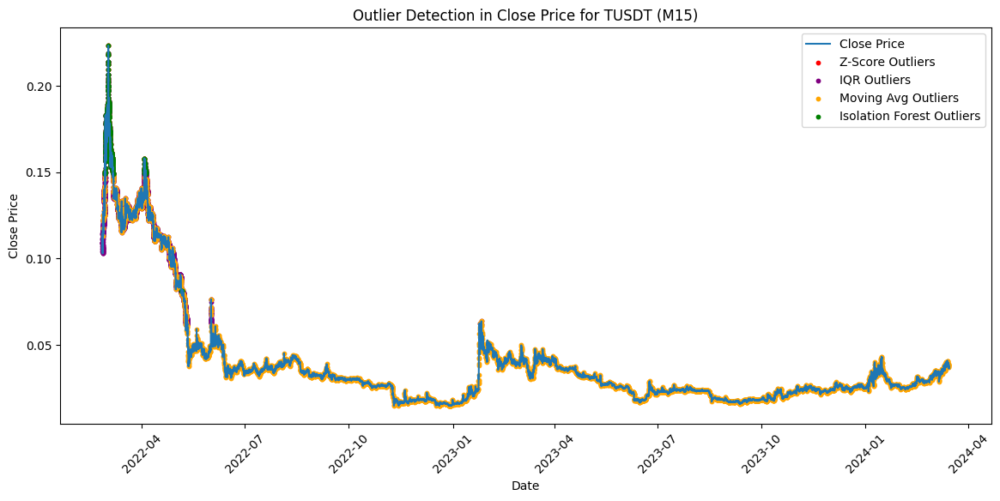

Applying outlier detection for USDC in M15 interval.
Outliers detected for USDC (M15): {'Z-Score': 4025, 'IQR': 29120, 'Moving Average': 13025, 'Isolation Forest': 1665}


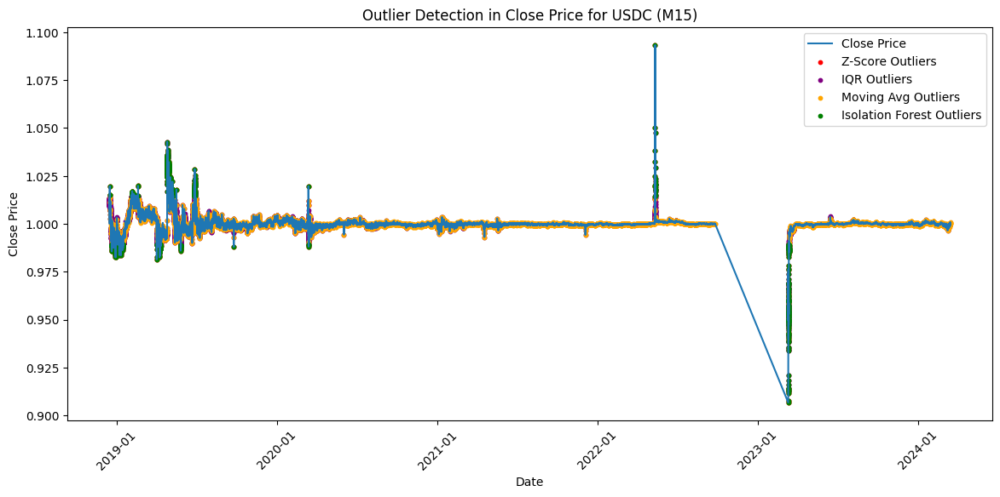

Applying outlier detection for BNB in M15 interval.
Outliers detected for BNB (M15): {'Z-Score': 0, 'IQR': 0, 'Moving Average': 27207, 'Isolation Forest': 2133}


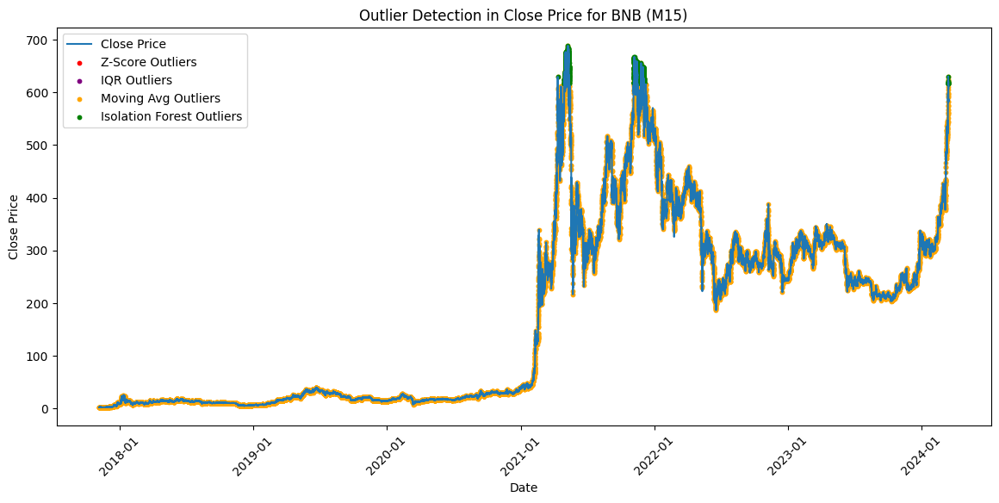

Applying outlier detection for XRP in M15 interval.
Outliers detected for XRP (M15): {'Z-Score': 3480, 'IQR': 12009, 'Moving Average': 24174, 'Isolation Forest': 2034}


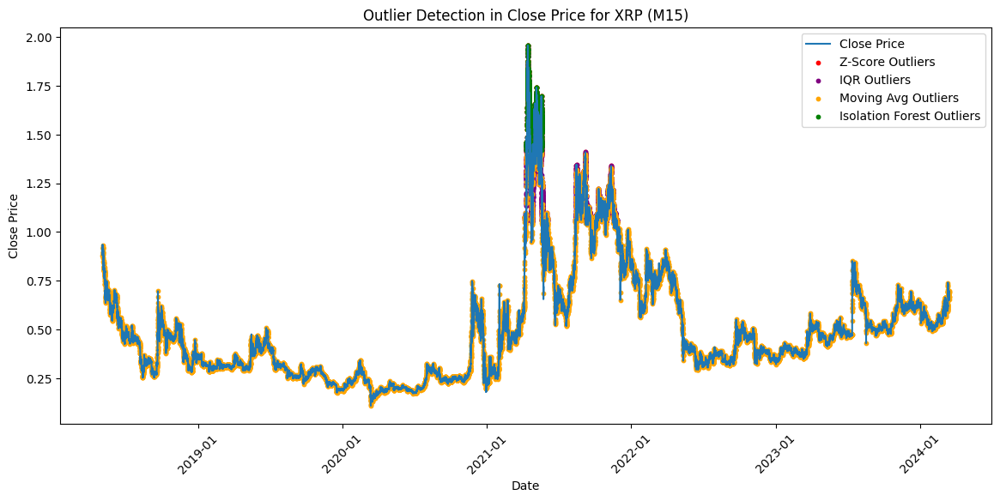

Applying outlier detection for ADA in M15 interval.
Outliers detected for ADA (M15): {'Z-Score': 4310, 'IQR': 24245, 'Moving Average': 24973, 'Isolation Forest': 2059}


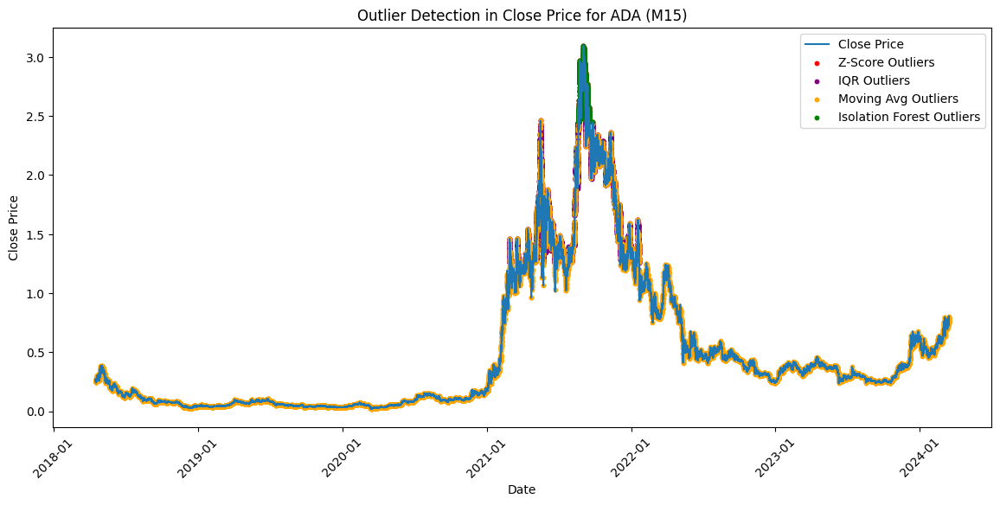

Applying outlier detection for LTC in M15 interval.
Outliers detected for LTC (M15): {'Z-Score': 3421, 'IQR': 8967, 'Moving Average': 26535, 'Isolation Forest': 2156}


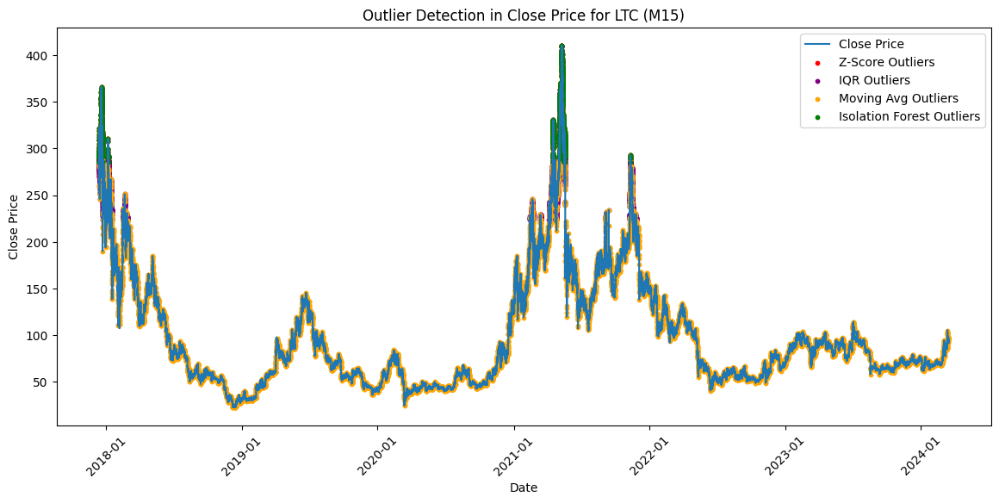

Applying outlier detection for SOL in M15 interval.
Outliers detected for SOL (M15): {'Z-Score': 1816, 'IQR': 5981, 'Moving Average': 15727, 'Isolation Forest': 1240}


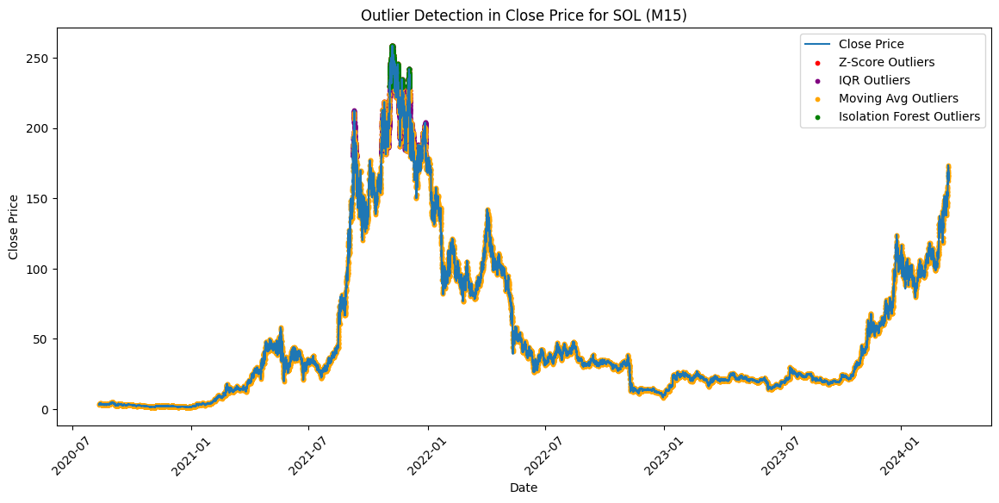

Applying outlier detection for DOT in M15 interval.
Outliers detected for DOT (M15): {'Z-Score': 841, 'IQR': 3719, 'Moving Average': 15168, 'Isolation Forest': 1230}


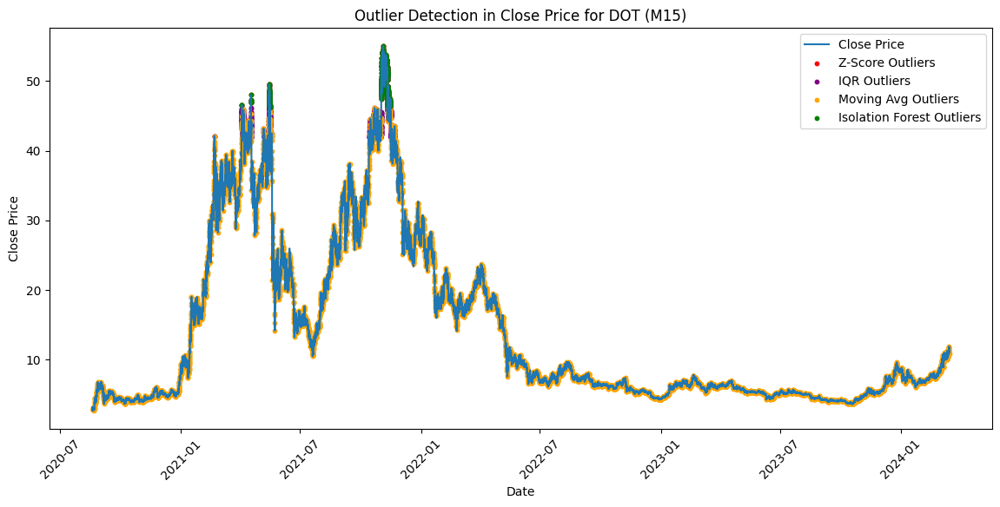

Applying outlier detection for BTC in M30 interval.
Outliers detected for BTC (M30): {'Z-Score': 141, 'IQR': 112, 'Moving Average': 14418, 'Isolation Forest': 1140}


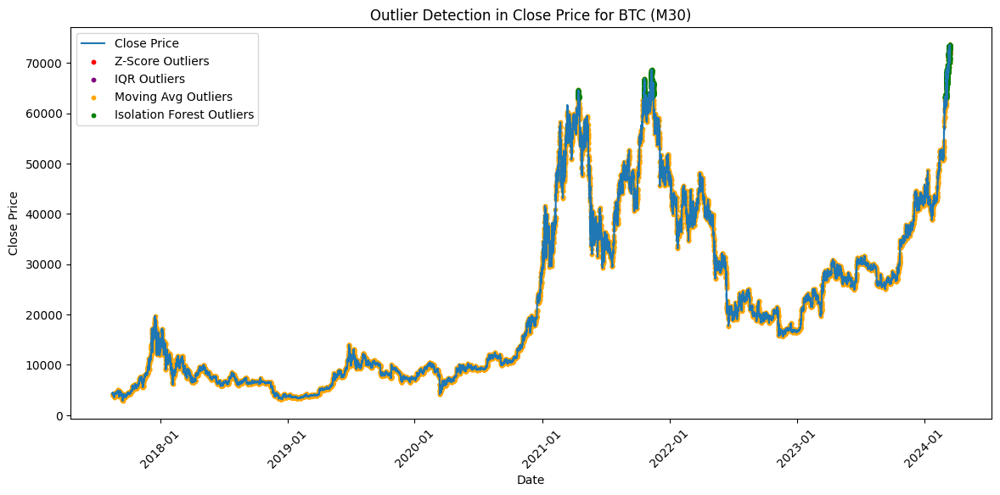

Applying outlier detection for ETH in M30 interval.
Outliers detected for ETH (M30): {'Z-Score': 308, 'IQR': 1050, 'Moving Average': 14549, 'Isolation Forest': 1151}


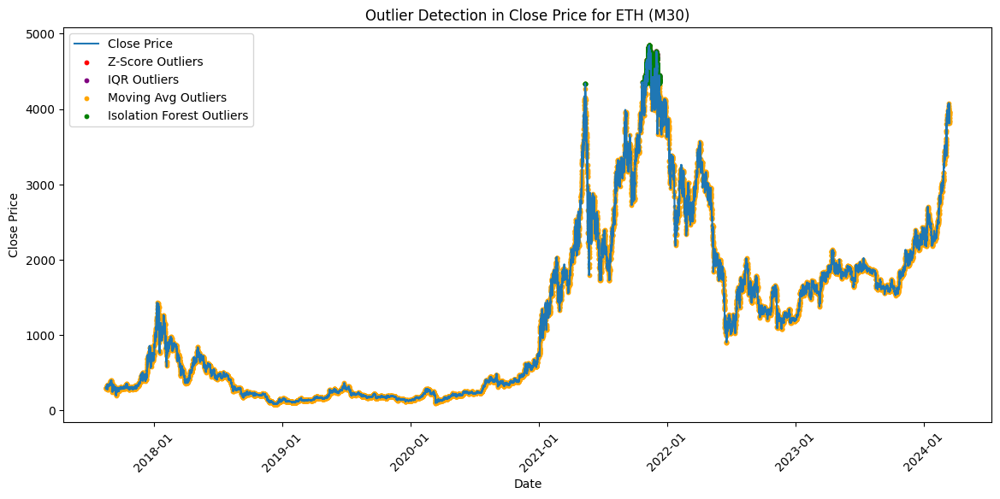

Applying outlier detection for TUSDT in M30 interval.
Outliers detected for TUSDT (M30): {'Z-Score': 1227, 'IQR': 3614, 'Moving Average': 4180, 'Isolation Forest': 339}


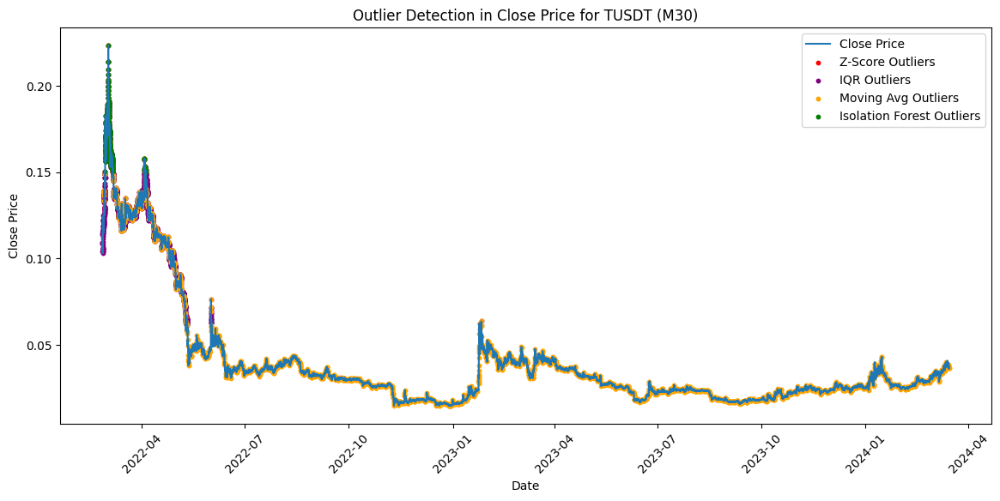

Applying outlier detection for USDC in M30 interval.
Outliers detected for USDC (M30): {'Z-Score': 2067, 'IQR': 14532, 'Moving Average': 6998, 'Isolation Forest': 831}


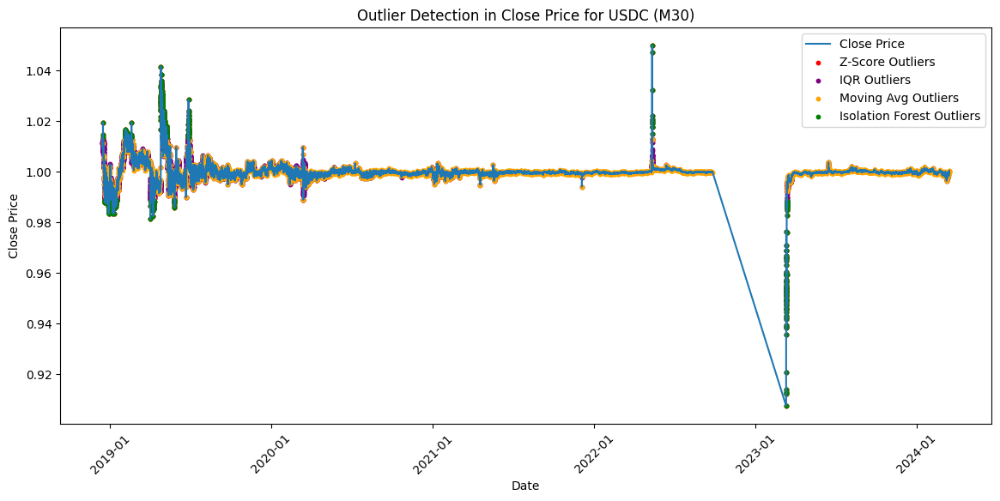

Applying outlier detection for BNB in M30 interval.
Outliers detected for BNB (M30): {'Z-Score': 0, 'IQR': 0, 'Moving Average': 13584, 'Isolation Forest': 1093}


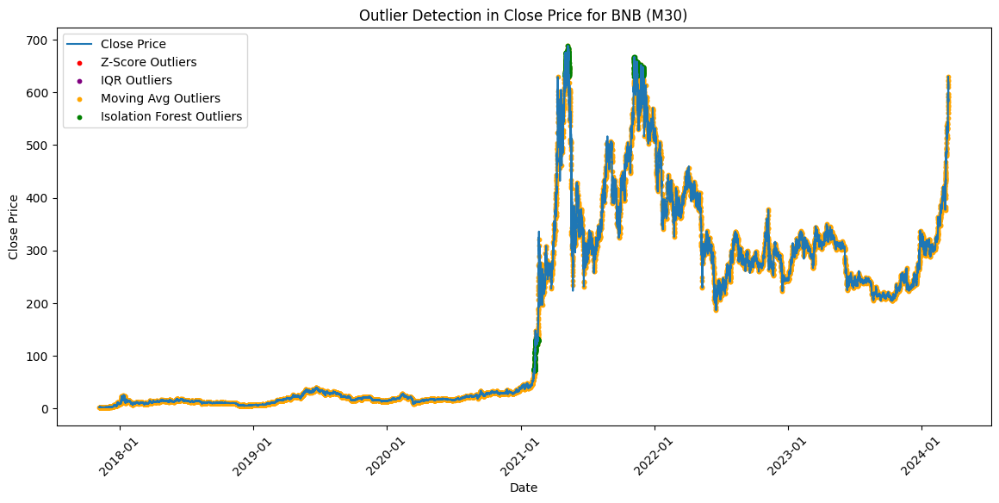

Applying outlier detection for XRP in M30 interval.
Outliers detected for XRP (M30): {'Z-Score': 1736, 'IQR': 6001, 'Moving Average': 12147, 'Isolation Forest': 1023}


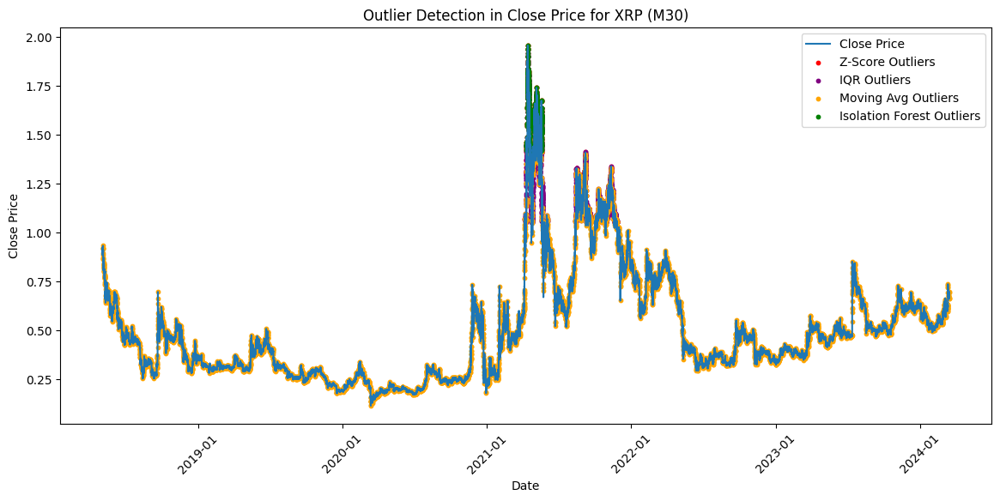

Applying outlier detection for ADA in M30 interval.
Outliers detected for ADA (M30): {'Z-Score': 2158, 'IQR': 12128, 'Moving Average': 12571, 'Isolation Forest': 1032}


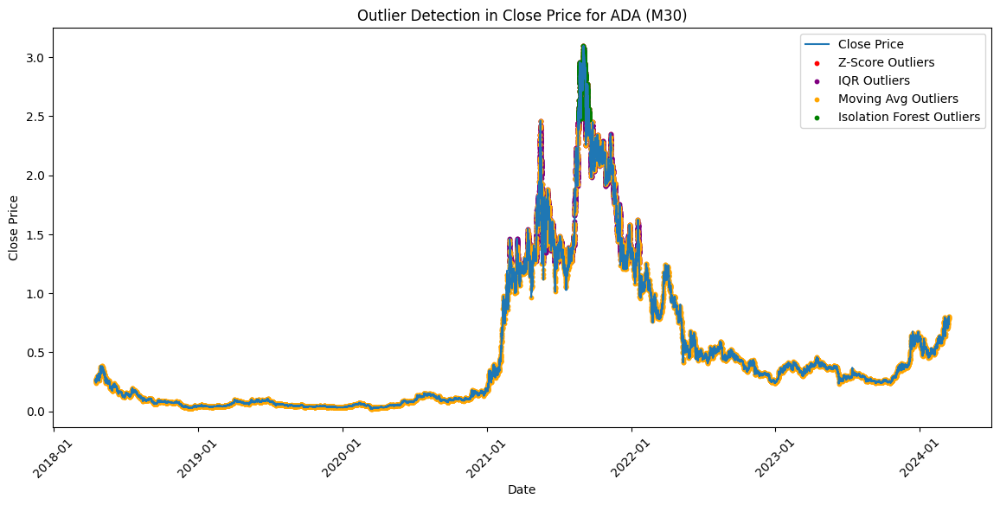

Applying outlier detection for LTC in M30 interval.
Outliers detected for LTC (M30): {'Z-Score': 1712, 'IQR': 4488, 'Moving Average': 13222, 'Isolation Forest': 1090}


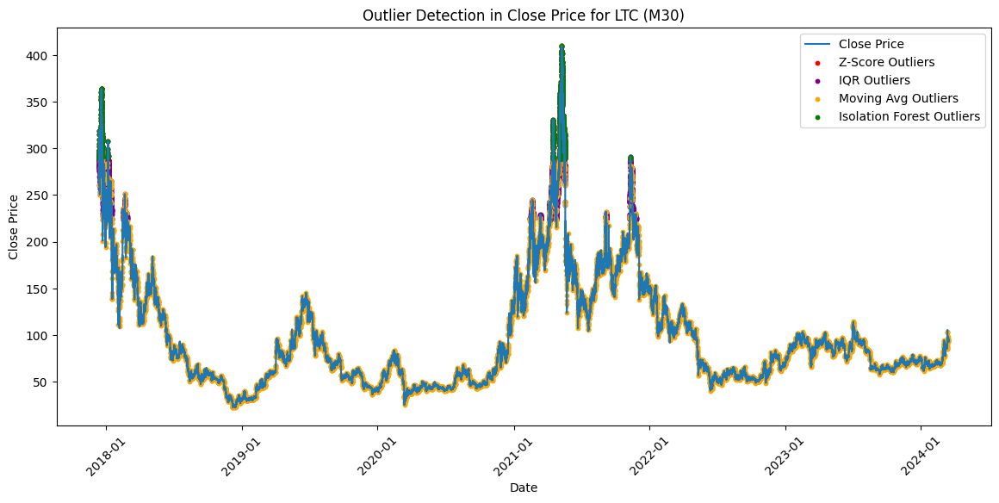

Applying outlier detection for SOL in M30 interval.
Outliers detected for SOL (M30): {'Z-Score': 909, 'IQR': 3003, 'Moving Average': 7843, 'Isolation Forest': 623}


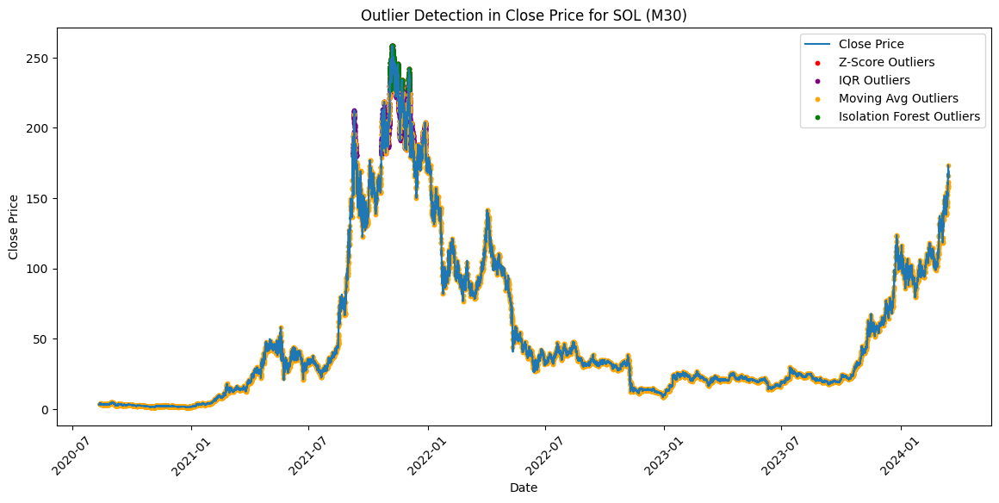

Applying outlier detection for DOT in M30 interval.
Outliers detected for DOT (M30): {'Z-Score': 423, 'IQR': 1851, 'Moving Average': 7670, 'Isolation Forest': 625}


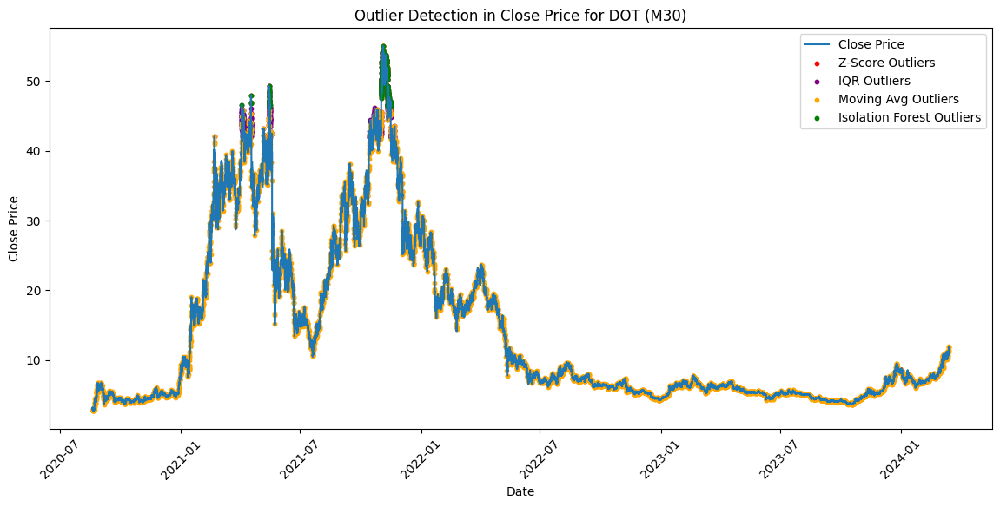

Applying outlier detection for BTC in W1 interval.
Outliers detected for BTC (W1): {'Z-Score': 0, 'IQR': 0, 'Moving Average': 50, 'Isolation Forest': 4}


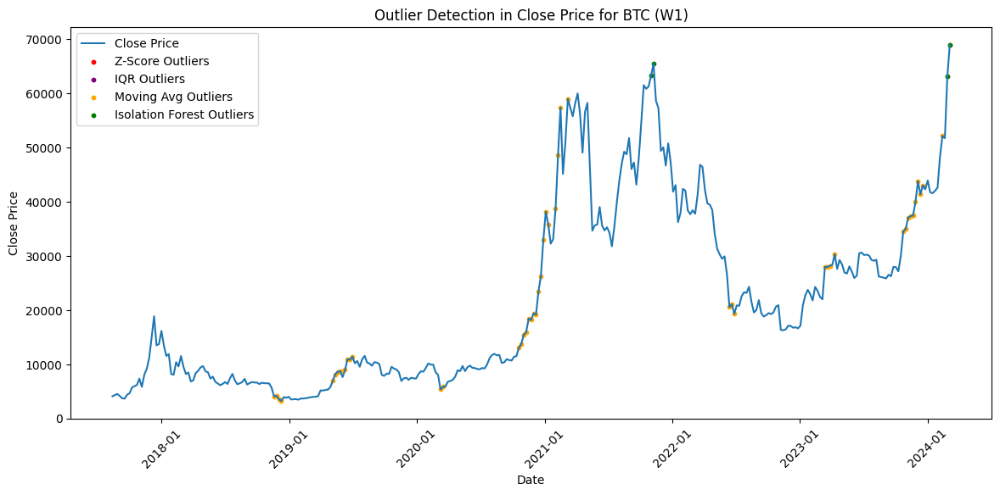

Applying outlier detection for ETH in W1 interval.
Outliers detected for ETH (W1): {'Z-Score': 0, 'IQR': 2, 'Moving Average': 42, 'Isolation Forest': 4}


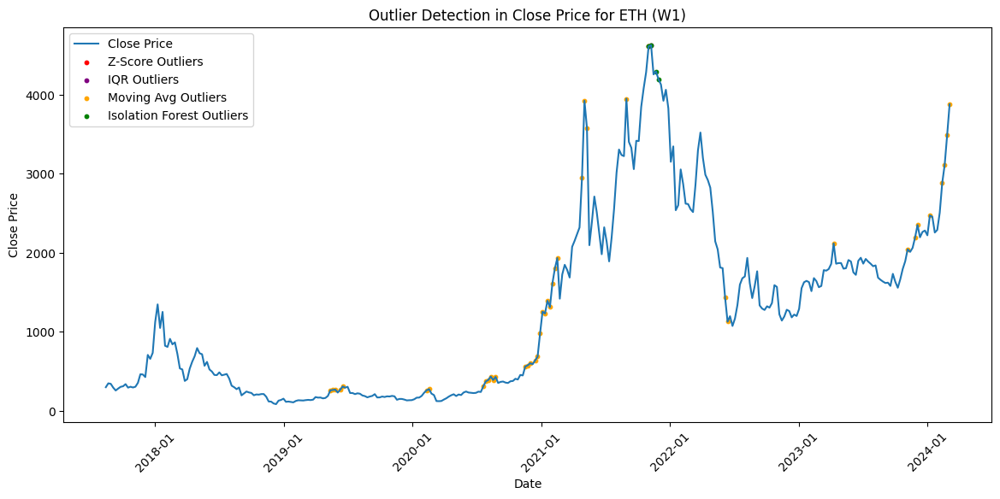

Applying outlier detection for TUSDT in W1 interval.
Outliers detected for TUSDT (W1): {'Z-Score': 4, 'IQR': 11, 'Moving Average': 3, 'Isolation Forest': 2}


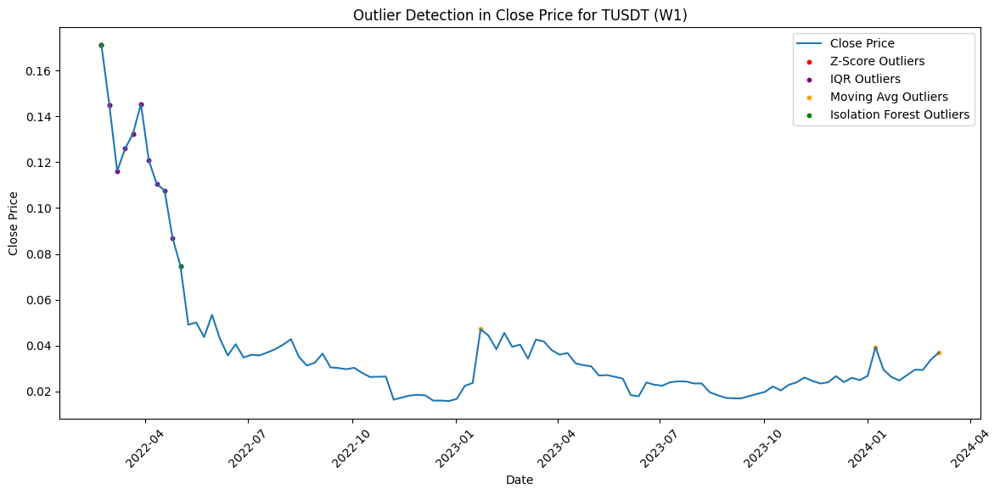

Applying outlier detection for USDC in W1 interval.
Outliers detected for USDC (W1): {'Z-Score': 7, 'IQR': 35, 'Moving Average': 12, 'Isolation Forest': 3}


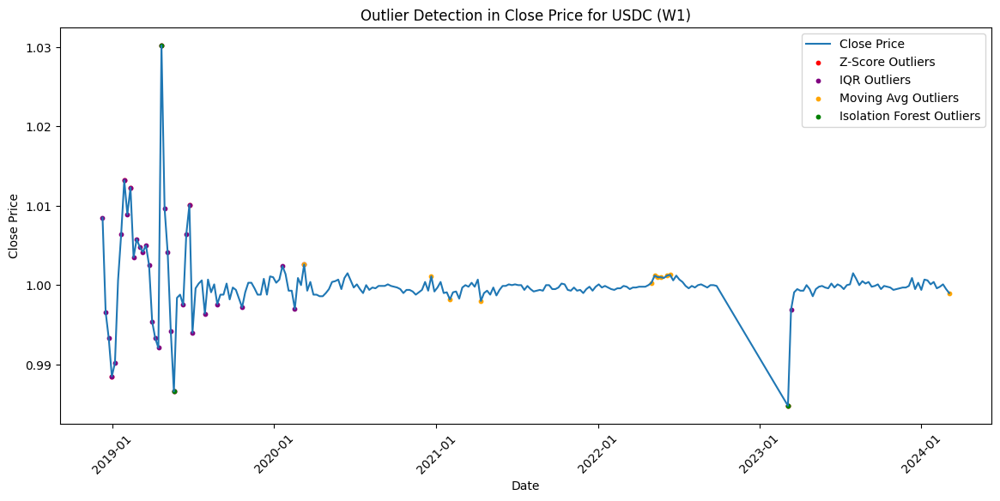

Applying outlier detection for BNB in W1 interval.
Outliers detected for BNB (W1): {'Z-Score': 0, 'IQR': 0, 'Moving Average': 46, 'Isolation Forest': 4}


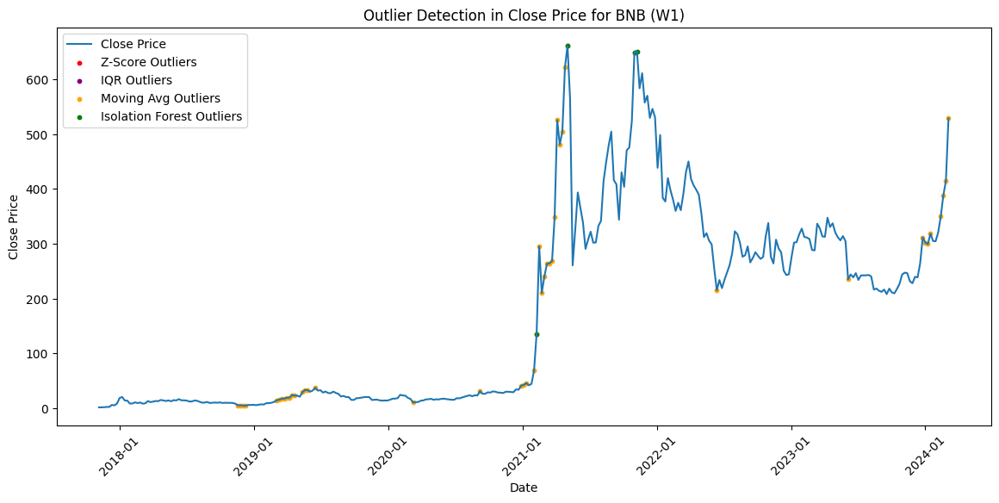

Applying outlier detection for XRP in W1 interval.
Outliers detected for XRP (W1): {'Z-Score': 6, 'IQR': 16, 'Moving Average': 24, 'Isolation Forest': 4}


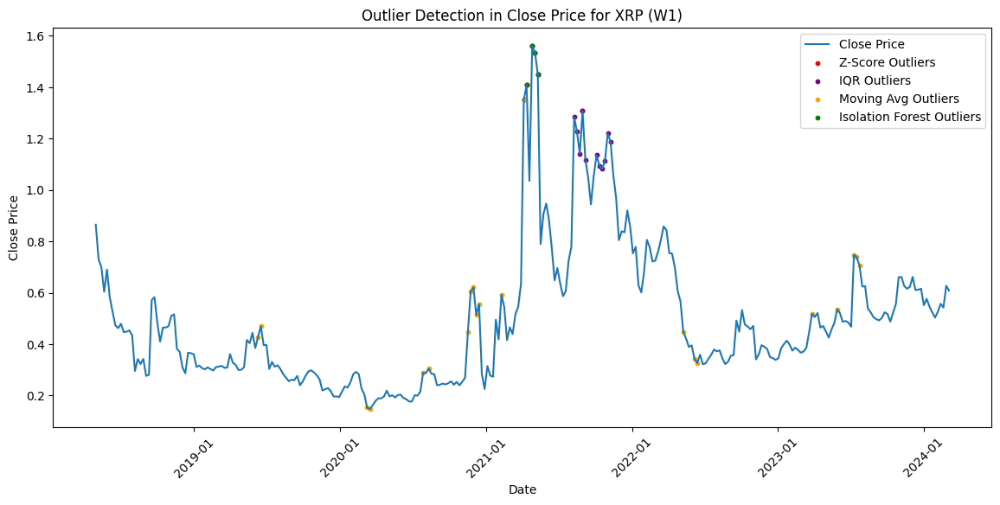

Applying outlier detection for ADA in W1 interval.
Outliers detected for ADA (W1): {'Z-Score': 7, 'IQR': 37, 'Moving Average': 36, 'Isolation Forest': 4}


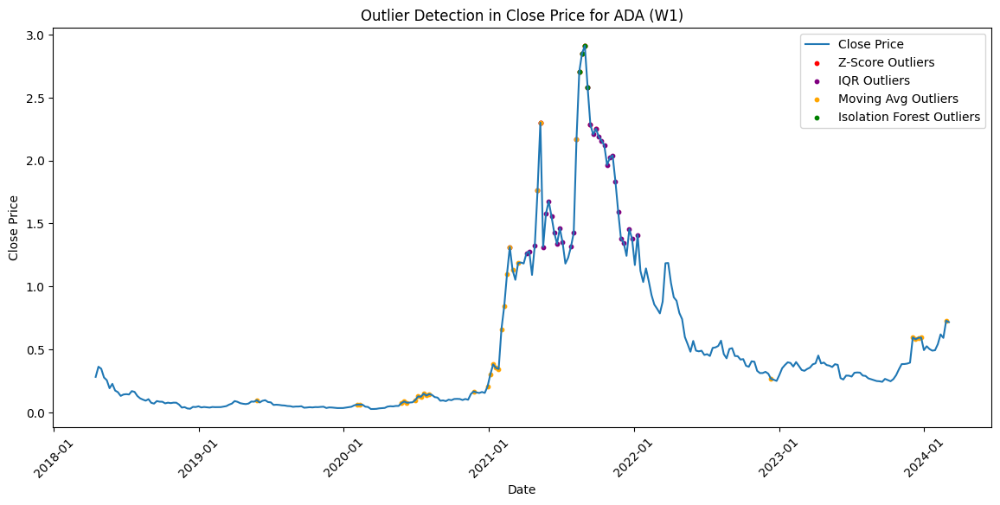

Applying outlier detection for LTC in W1 interval.
Outliers detected for LTC (W1): {'Z-Score': 5, 'IQR': 11, 'Moving Average': 34, 'Isolation Forest': 4}


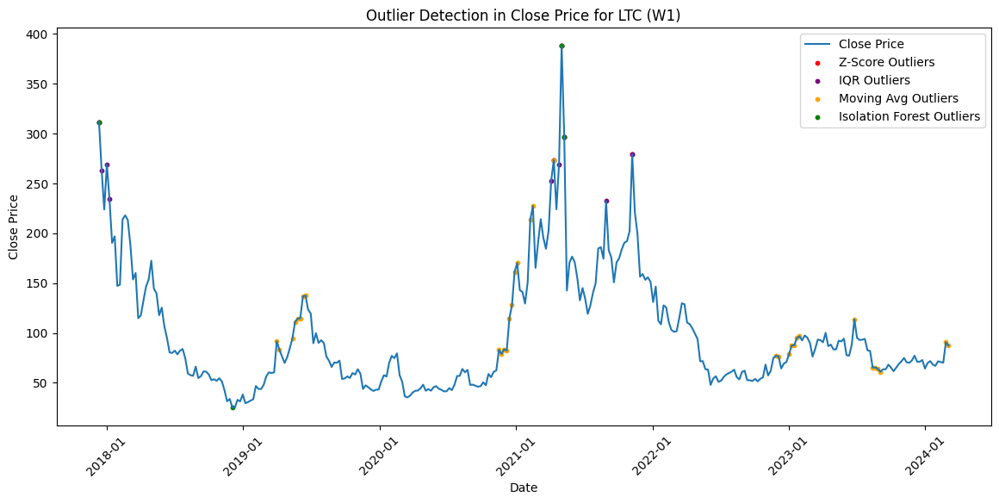

Applying outlier detection for SOL in W1 interval.
Outliers detected for SOL (W1): {'Z-Score': 3, 'IQR': 10, 'Moving Average': 33, 'Isolation Forest': 2}


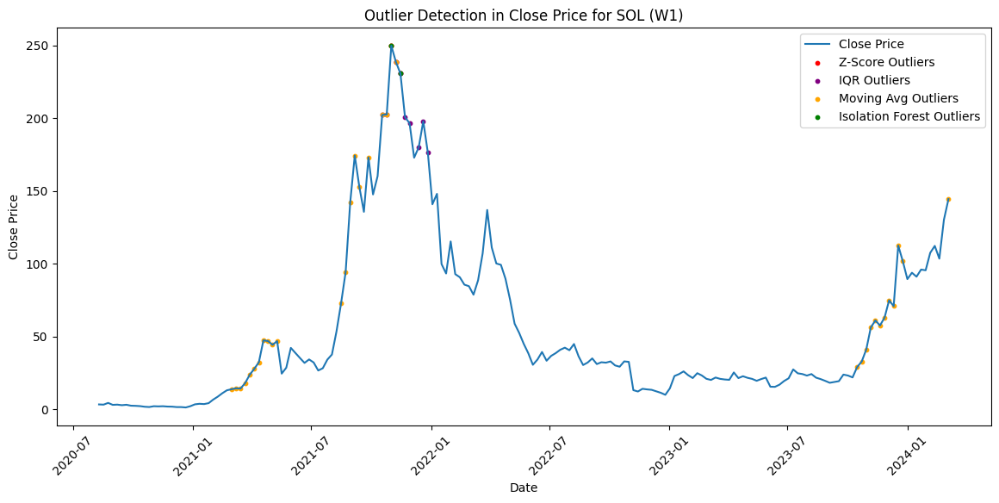

Applying outlier detection for DOT in W1 interval.
Outliers detected for DOT (W1): {'Z-Score': 1, 'IQR': 10, 'Moving Average': 9, 'Isolation Forest': 2}


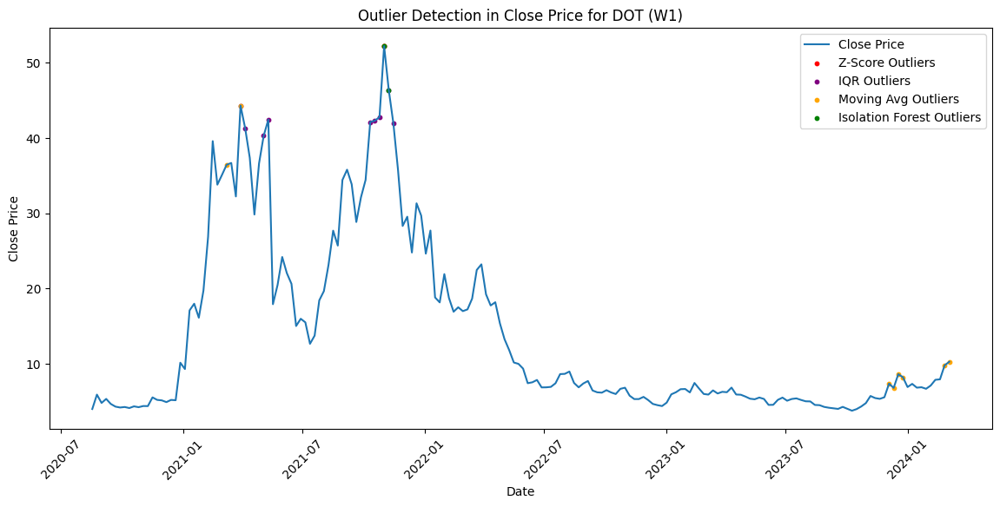

In [ ]:
import pandas as pd
import numpy as np
from scipy.stats import zscore
from sklearn.ensemble import IsolationForest
import matplotlib.pyplot as plt
import matplotlib.dates as mdates

# Define Outlier Detection Methods
def detect_outliers_zscore(data, threshold=3):
    data['z_score'] = zscore(data['close'], nan_policy='omit')
    data['outlier_zscore'] = data['z_score'].abs() > threshold
    return data

def detect_outliers_iqr(data):
    Q1 = data['close'].quantile(0.25)
    Q3 = data['close'].quantile(0.75)
    IQR = Q3 - Q1
    data['outlier_iqr'] = (data['close'] < (Q1 - 1.5 * IQR)) | (data['close'] > (Q3 + 1.5 * IQR))
    return data

def detect_outliers_moving_avg(data, window=30, threshold=2):
    data['moving_avg'] = data['close'].rolling(window=window).mean()
    data['moving_std'] = data['close'].rolling(window=window).std()
    data['outlier_moving_avg'] = ((data['close'] - data['moving_avg']).abs() > threshold * data['moving_std'])
    return data

def detect_outliers_isolation_forest(data):
    isolation_forest = IsolationForest(contamination=0.01, random_state=42)
    data['outlier_isolation'] = isolation_forest.fit_predict(data[['close']])
    data['outlier_isolation'] = data['outlier_isolation'] == -1
    return data

# Ensure datetime column is in datetime format and apply Outlier Detection
for interval, crypto_data in interval_data.items():
    for crypto, df in crypto_data.items():
        if not df.empty:
            print(f"Applying outlier detection for {crypto} in {interval} interval.")

            # Convert datetime column if not already in datetime format
            if not pd.api.types.is_datetime64_any_dtype(df['datetime']):
                df['datetime'] = pd.to_datetime(df['datetime'], errors='coerce')

            # Apply outlier detection methods
            df = detect_outliers_zscore(df)
            df = detect_outliers_iqr(df)
            df = detect_outliers_moving_avg(df)
            df = detect_outliers_isolation_forest(df)

            # Summarize Outliers
            outlier_counts = {
                'Z-Score': df['outlier_zscore'].sum(),
                'IQR': df['outlier_iqr'].sum(),
                'Moving Average': df['outlier_moving_avg'].sum(),
                'Isolation Forest': df['outlier_isolation'].sum()
            }
            print(f"Outliers detected for {crypto} ({interval}): {outlier_counts}")

            # Plotting with improved x-axis formatting
            plt.figure(figsize=(14, 6))
            plt.plot(df['datetime'], df['close'], label='Close Price')
            plt.scatter(df[df['outlier_zscore']]['datetime'], df[df['outlier_zscore']]['close'], color='red', label='Z-Score Outliers', s=10)
            plt.scatter(df[df['outlier_iqr']]['datetime'], df[df['outlier_iqr']]['close'], color='purple', label='IQR Outliers', s=10)
            plt.scatter(df[df['outlier_moving_avg']]['datetime'], df[df['outlier_moving_avg']]['close'], color='orange', label='Moving Avg Outliers', s=10)
            plt.scatter(df[df['outlier_isolation']]['datetime'], df[df['outlier_isolation']]['close'], color='green', label='Isolation Forest Outliers', s=10)

            # Set x-axis to show fewer date ticks for better readability
            plt.gca().xaxis.set_major_locator(mdates.AutoDateLocator())
            plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m'))

            plt.legend()
            plt.title(f'Outlier Detection in Close Price for {crypto} ({interval})')
            plt.xlabel('Date')
            plt.ylabel('Close Price')
            plt.xticks(rotation=45)
            plt.show()


# Conclusion: Outlier Detection Analysis

The following conclusions are drawn based on the outlier detection methods (Z-Score, IQR, Moving Average, Isolation Forest) applied to the top 10 cryptocurrencies across different intervals:

## Daily Interval (D1)
- **BTC:** Z-Score: 3, IQR: 2, Moving Average: 351, Isolation Forest: 23
- **ETH:** Z-Score: 5, IQR: 23, Moving Average: 342, Isolation Forest: 24
- **TUSDT:** Z-Score: 25, IQR: 75, Moving Average: 87, Isolation Forest: 8
- **USDC:** Z-Score: 50, IQR: 281, Moving Average: 117, Isolation Forest: 18
- **BNB:** Z-Score: 0, IQR: 0, Moving Average: 324, Isolation Forest: 24
- **XRP:** Z-Score: 35, IQR: 121, Moving Average: 255, Isolation Forest: 22
- **ADA:** Z-Score: 45, IQR: 252, Moving Average: 298, Isolation Forest: 22
- **LTC:** Z-Score: 35, IQR: 91, Moving Average: 288, Isolation Forest: 21
- **SOL:** Z-Score: 21, IQR: 62, Moving Average: 214, Isolation Forest: 14
- **DOT:** Z-Score: 9, IQR: 43, Moving Average: 178, Isolation Forest: 14

## Hourly Interval (H1)
- **BTC:** Z-Score: 70, IQR: 49, Moving Average: 7180, Isolation Forest: 568
- **ETH:** Z-Score: 153, IQR: 523, Moving Average: 7064, Isolation Forest: 568
- **TUSDT:** Z-Score: 613, IQR: 1807, Moving Average: 2067, Isolation Forest: 171
- **USDC:** Z-Score: 1038, IQR: 7254, Moving Average: 3575, Isolation Forest: 409
- **BNB:** Z-Score: 0, IQR: 0, Moving Average: 6871, Isolation Forest: 515
- **XRP:** Z-Score: 863, IQR: 2997, Moving Average: 6183, Isolation Forest: 514
- **ADA:** Z-Score: 1085, IQR: 6062, Moving Average: 6408, Isolation Forest: 515
- **LTC:** Z-Score: 855, IQR: 2255, Moving Average: 6617, Isolation Forest: 533
- **SOL:** Z-Score: 453, IQR: 1496, Moving Average: 3859, Isolation Forest: 313
- **DOT:** Z-Score: 212, IQR: 928, Moving Average: 3893, Isolation Forest: 310

## 4-Hourly Interval (H4)
- **BTC:** Z-Score: 18, IQR: 14, Moving Average: 1959, Isolation Forest: 144
- **ETH:** Z-Score: 39, IQR: 129, Moving Average: 1975, Isolation Forest: 138
- **TUSDT:** Z-Score: 152, IQR: 452, Moving Average: 548, Isolation Forest: 45
- **USDC:** Z-Score: 253, IQR: 1701, Moving Average: 858, Isolation Forest: 105
- **BNB:** Z-Score: 0, IQR: 0, Moving Average: 1868, Isolation Forest: 139
- **XRP:** Z-Score: 214, IQR: 754, Moving Average: 1604, Isolation Forest: 128
- **ADA:** Z-Score: 270, IQR: 1513, Moving Average: 1692, Isolation Forest: 129
- **LTC:** Z-Score: 218, IQR: 552, Moving Average: 1734, Isolation Forest: 135
- **SOL:** Z-Score: 112, IQR: 383, Moving Average: 1068, Isolation Forest: 79
- **DOT:** Z-Score: 55, IQR: 226, Moving Average: 999, Isolation Forest: 79

## Weekly Interval (W1)
- **BTC:** Z-Score: 0, IQR: 0, Moving Average: 50, Isolation Forest: 4
- **ETH:** Z-Score: 0, IQR: 2, Moving Average: 42, Isolation Forest: 4
- **TUSDT:** Z-Score: 4, IQR: 11, Moving Average: 3, Isolation Forest: 2
- **USDC:** Z-Score: 7, IQR: 35, Moving Average: 12, Isolation Forest: 3
- **BNB:** Z-Score: 0, IQR: 0, Moving Average: 46, Isolation Forest: 4
- **XRP:** Z-Score: 6, IQR: 16, Moving Average: 24, Isolation Forest: 4
- **ADA:** Z-Score: 7, IQR: 37, Moving Average: 36, Isolation Forest: 4
- **LTC:** Z-Score: 5, IQR: 11, Moving Average: 34, Isolation Forest: 4
- **SOL:** Z-Score: 3, IQR: 10, Moving Average: 33, Isolation Forest: 2
- **DOT:** Z-Score: 1, IQR: 10, Moving Average: 9, Isolation Forest: 2

## Key Observations:
1. **Z-Score:** Most coins exhibited a low count of extreme outliers, reflecting stable price movements except in shorter intervals like M5.
2. **IQR:** Interquartile range detected more outliers in shorter intervals, especially for TUSDT and USDC.
3. **Moving Average Deviation:** Moving Average was most sensitive, detecting a higher number of anomalies due to short-term fluctuations.
4. **Isolation Forest:** Effectively identified a reasonable number of anomalies, balancing between sensitivity and robustness.

The choice of interval and method should depend on the project's goal, as shorter intervals (e.g., M5) yield more outliers, which might include noise, while longer intervals (e.g., W1) are more focused on significant events.


# STEP 2: Implementation of ML Algorithms

 ## 2.1 Implementing ARIMA (Autoregressive Integrated Moving Averages)

 NOTE: ARIMA is preferable mostly for Daily and Weekly Intervals as this is seasonal data and ARIMA cannot capture high volatility present in Hourly and Minute based intervals

 ### Performing ADF (Augmented Dickey Fuller) Test to determine stationarity of the data
 NOTE : 'datetime' column is being used as an index

In [ ]:
# Just for verifying
for crypto, data in interval_data['W1'].items():
    if not data.empty:
        print(f"Checking index for {crypto} (W1): {data.index}")
        if isinstance(data.index, pd.DatetimeIndex):
            print(f"'datetime' is set as the index for {crypto} (W1).")
        else:
            print(f"Index type for {crypto} (W1): {type(data.index)}")
    else:
        print(f"No data for {crypto} in W1 interval.")

Checking index for BTC (W1): RangeIndex(start=0, stop=343, step=1)
Index type for BTC (W1): <class 'pandas.core.indexes.range.RangeIndex'>
Checking index for ETH (W1): RangeIndex(start=0, stop=343, step=1)
Index type for ETH (W1): <class 'pandas.core.indexes.range.RangeIndex'>
Checking index for TUSDT (W1): RangeIndex(start=0, stop=107, step=1)
Index type for TUSDT (W1): <class 'pandas.core.indexes.range.RangeIndex'>
Checking index for USDC (W1): RangeIndex(start=0, stop=252, step=1)
Index type for USDC (W1): <class 'pandas.core.indexes.range.RangeIndex'>
Checking index for BNB (W1): RangeIndex(start=0, stop=331, step=1)
Index type for BNB (W1): <class 'pandas.core.indexes.range.RangeIndex'>
Checking index for XRP (W1): RangeIndex(start=0, stop=306, step=1)
Index type for XRP (W1): <class 'pandas.core.indexes.range.RangeIndex'>
Checking index for ADA (W1): RangeIndex(start=0, stop=308, step=1)
Index type for ADA (W1): <class 'pandas.core.indexes.range.RangeIndex'>
Checking index for LT

In [ ]:
# Ensuring 'datetime' is set as index for D1 (daily) interval
for crypto, data in interval_data['D1'].items():
    if not data.empty and 'datetime' in data.columns:
        data.set_index('datetime', inplace=True)
        interval_data['D1'][crypto] = data  # Updating the processed DataFrame

In [ ]:
from statsmodels.tsa.stattools import adfuller

def perform_adf_test(interval_data, interval_name):
    """
    Perform ADF test for all cryptocurrencies in a specific interval.

    Args:
        interval_data (dict): Dictionary of DataFrames for each cryptocurrency.
        interval_name (str): Name of the interval (e.g., 'D1', 'W1').
    """
    print(f"\n--- ADF Test Results for {interval_name} Interval ---")
    for crypto, data in interval_data.items():
        if data.empty:
            print(f"No data available for {crypto} in {interval_name} interval.")
            continue

        # Specific handling for W1 interval to ensure 'datetime' is the index
        if interval_name == 'W1':
            if 'datetime' in data.columns:
                data['datetime'] = pd.to_datetime(data['datetime'], errors='coerce')
                data.set_index('datetime', inplace=True)

        # Ensure 'datetime' is the index
        if not isinstance(data.index, pd.DatetimeIndex):
            print(f"Error: 'datetime' is not set as index for {crypto} ({interval_name}). Skipping ADF test.")
            continue

        # Perform ADF test on the 'close' column
        if 'close' in data.columns:
            adf_result = adfuller(data['close'].dropna())  # Drop NA values before ADF test
            print(f"\nPerforming ADF test for {crypto} ({interval_name}):")
            print(f"ADF Statistic: {adf_result[0]}")
            print(f"p-value: {adf_result[1]}")
            print(f"Critical Values: {adf_result[4]}")
            if adf_result[1] <= 0.05:
                print(f"Result: The series for {crypto} ({interval_name}) is stationary.")
            else:
                print(f"Result: The series for {crypto} ({interval_name}) is NOT stationary.")
        else:
            print(f"Error: 'close' column missing for {crypto} ({interval_name}). Skipping ADF test.")

# Perform ADF tests for both D1 and W1 intervals
perform_adf_test(interval_data['D1'], 'D1')
perform_adf_test(interval_data['W1'], 'W1')


--- ADF Test Results for D1 Interval ---

Performing ADF test for BTC (D1):
ADF Statistic: -0.3090582283323306
p-value: 0.9242115822273758
Critical Values: {'1%': -3.4330890532791027, '5%': -2.8627500747103762, '10%': -2.5674141737714677}
Result: The series for BTC (D1) is NOT stationary.

Performing ADF test for ETH (D1):
ADF Statistic: -0.7621591934019111
p-value: 0.8299856612161387
Critical Values: {'1%': -3.4330971078682406, '5%': -2.8627536314741575, '10%': -2.5674160674638107}
Result: The series for ETH (D1) is NOT stationary.

Performing ADF test for TUSDT (D1):
ADF Statistic: -3.566387234006683
p-value: 0.006437118414519007
Critical Values: {'1%': -3.439314999916068, '5%': -2.8654965012008677, '10%': -2.5688768817372867}
Result: The series for TUSDT (D1) is stationary.

Performing ADF test for USDC (D1):
ADF Statistic: -7.4009769390139075
p-value: 7.55679590757744e-11
Critical Values: {'1%': -3.4341465551936534, '5%': -2.863216966926812, '10%': -2.567662770090317}
Result: The 

# Conclusion: ADF Test Results for D1 and W1 Intervals

## D1 Interval
The ADF test results for the D1 interval indicate the following:

- **Stationary Series**:
  - **TUSDT**: The series is stationary with a p-value of 0.0064.
  - **USDC**: The series is stationary with a p-value close to 0.
  - **XRP**: The series is stationary with a p-value of 0.0269.
  - **LTC**: The series is stationary with a p-value of 0.0175.

- **Non-Stationary Series**:
  - **BTC**: The series is NOT stationary with a p-value of 0.9242.
  - **ETH**: The series is NOT stationary with a p-value of 0.8300.
  - **BNB**: The series is NOT stationary with a p-value of 0.7592.
  - **ADA**: The series is NOT stationary with a p-value of 0.4114.
  - **SOL**: The series is NOT stationary with a p-value of 0.6015.
  - **DOT**: The series is NOT stationary with a p-value of 0.3789.

---

## W1 Interval
The ADF test results for the W1 interval indicate the following:

- **Stationary Series**:
  - **TUSDT**: The series is stationary with a p-value close to 0.
  - **USDC**: The series is stationary with a p-value close to 0.
  - **LTC**: The series is stationary with a p-value of 0.0281.

- **Non-Stationary Series**:
  - **BTC**: The series is NOT stationary with a p-value of 0.8236.
  - **ETH**: The series is NOT stationary with a p-value of 0.8181.
  - **BNB**: The series is NOT stationary with a p-value of 0.7232.
  - **XRP**: The series is NOT stationary with a p-value of 0.4201.
  - **ADA**: The series is NOT stationary with a p-value of 0.3479.
  - **SOL**: The series is NOT stationary with a p-value of 0.2868.
  - **DOT**: The series is NOT stationary with a p-value of 0.2743.

---

## Key Takeaways
1. For both intervals, most cryptocurrencies exhibit **non-stationary behavior**, indicating the need for transformations (e.g., differencing) before modeling with ARIMA.
2. Cryptocurrencies such as **TUSDT**, **USDC**, and **LTC** display stationary series in both intervals, suggesting these can be directly modeled without further differencing.
3. Cryptocurrencies like **BTC**, **ETH**, and **BNB** exhibit consistent non-stationarity across both intervals.

# In the following code we are differencing the series to induce stationarity and building the ARIMA Model.

## What the ARIMA Model in the Code is Predicting:

## Prediction:
The ARIMA model (with refrence to the code below) is predicting the **differenced values** of the `close` price (stored in the `'diff'` column). These differenced values represent the **changes in the close prices** from one time step to the next (first-order differencing).

## Output:
- **Fitted Values**: These are the **in-sample predictions**, meaning the values predicted for the same data used to train the ARIMA model.
- The **Actual vs Fitted** graph compares:
  - The **actual differenced values** (`diff`) calculated from the original data.
  - The **fitted values** generated by the ARIMA model.


--- Processing Daily Interval ---

Processing BTC (Daily Interval):
ADF Statistic: -6.955185112353301
p-value: 9.468899273065419e-10
Critical Values: {'1%': -3.4331428650682807, '5%': -2.8627738368607076, '10%': -2.567426825246945}
The series for BTC (D1) is stationary after differencing.
Building ARIMA model for BTC (Daily Interval)...


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)


                               SARIMAX Results                                
Dep. Variable:                   diff   No. Observations:                 2372
Model:                 ARIMA(1, 1, 1)   Log Likelihood              -19693.176
Date:                Tue, 17 Dec 2024   AIC                          39392.352
Time:                        04:02:51   BIC                          39409.665
Sample:                    09-15-2017   HQIC                         39398.654
                         - 03-13-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.0389      0.013     -3.092      0.002      -0.064      -0.014
ma.L1         -0.9998      0.005   -194.455      0.000      -1.010      -0.990
sigma2      9.565e+05   1.23e+04     77.612      0.0

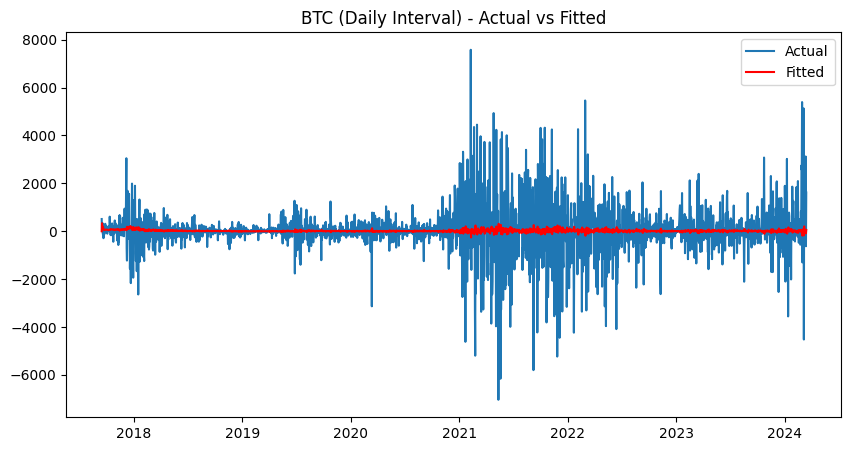


Processing ETH (Daily Interval):
ADF Statistic: -11.701270438139384
p-value: 1.5666005950203062e-21
Critical Values: {'1%': -3.4331298055777806, '5%': -2.862768070104647, '10%': -2.567423754896525}
The series for ETH (D1) is stationary after differencing.
Building ARIMA model for ETH (Daily Interval)...


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)


                               SARIMAX Results                                
Dep. Variable:                   diff   No. Observations:                 2372
Model:                 ARIMA(1, 1, 1)   Log Likelihood              -13587.318
Date:                Tue, 17 Dec 2024   AIC                          27180.636
Time:                        04:02:53   BIC                          27197.949
Sample:                    09-15-2017   HQIC                         27186.939
                         - 03-13-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.0803      0.011     -7.607      0.000      -0.101      -0.060
ma.L1         -0.9994      0.002   -592.047      0.000      -1.003      -0.996
sigma2      5543.6625     54.852    101.066      0.0

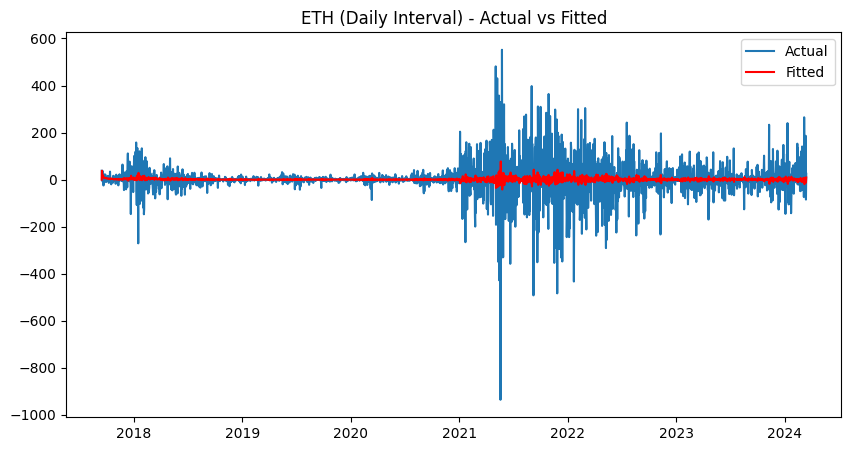


Processing TUSDT (Daily Interval):
ADF Statistic: -5.401751882154959
p-value: 3.358623851960906e-06
Critical Values: {'1%': -3.4396995339981444, '5%': -2.8656659438580796, '10%': -2.5689671530263554}
The series for TUSDT (D1) is stationary after differencing.
Building ARIMA model for TUSDT (Daily Interval)...


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)


                               SARIMAX Results                                
Dep. Variable:                   diff   No. Observations:                  719
Model:                 ARIMA(1, 1, 1)   Log Likelihood                3358.928
Date:                Tue, 17 Dec 2024   AIC                          -6711.856
Time:                        04:02:54   BIC                          -6698.126
Sample:                    03-26-2022   HQIC                         -6706.555
                         - 03-13-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.0245      0.026     -0.955      0.340      -0.075       0.026
ma.L1         -0.7527      0.021    -35.527      0.000      -0.794      -0.711
sigma2      5.033e-06   9.77e-08     51.533      0.0

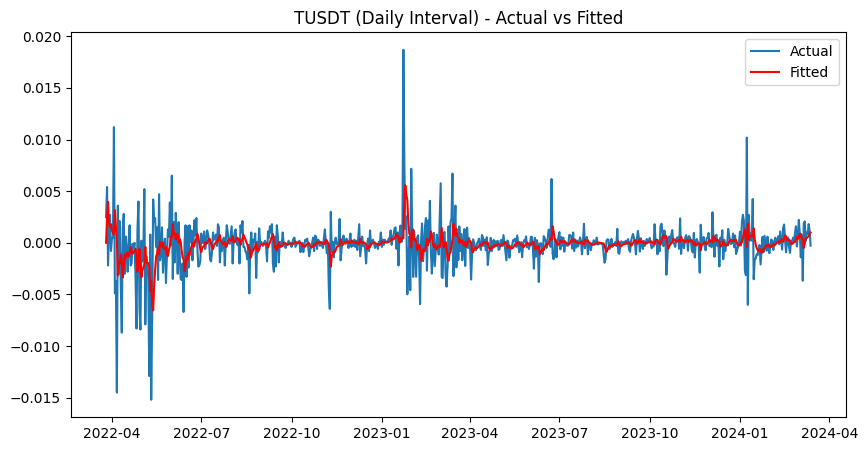


Processing USDC (Daily Interval):
ADF Statistic: -14.084915030473045
p-value: 2.786445055479283e-26
Critical Values: {'1%': -3.4342092923724787, '5%': -2.8632446605155337, '10%': -2.567677516366537}
The series for USDC (D1) is stationary after differencing.
Building ARIMA model for USDC (Daily Interval)...


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)


                               SARIMAX Results                                
Dep. Variable:                   diff   No. Observations:                 1722
Model:                 ARIMA(1, 1, 1)   Log Likelihood                8360.777
Date:                Tue, 17 Dec 2024   AIC                         -16715.553
Time:                        04:02:55   BIC                         -16699.201
Sample:                             0   HQIC                        -16709.503
                               - 1722                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.1960      0.004    -47.344      0.000      -0.204      -0.188
ma.L1         -0.9997      0.157     -6.386      0.000      -1.306      -0.693
sigma2      3.487e-06   5.37e-07      6.495      0.0

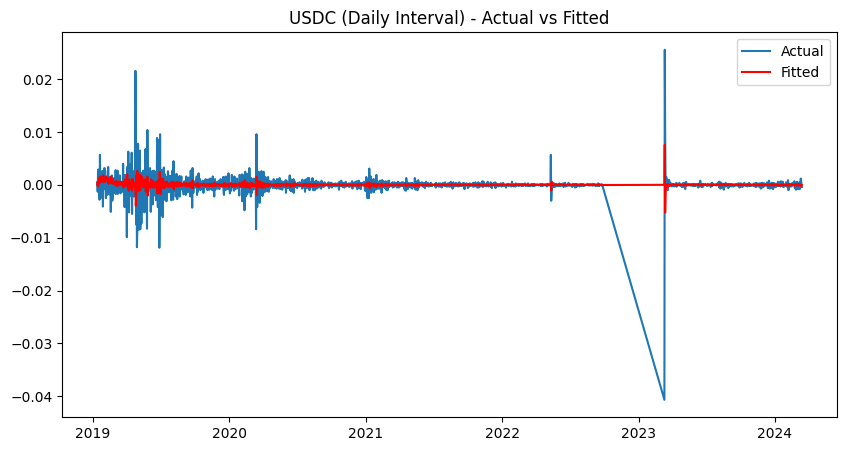


Processing BNB (Daily Interval):
ADF Statistic: -7.824204355081179
p-value: 6.547484973249736e-12
Critical Values: {'1%': -3.4332391099897013, '5%': -2.8628163355201113, '10%': -2.5674494526166383}
The series for BNB (D1) is stationary after differencing.
Building ARIMA model for BNB (Daily Interval)...


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)


                               SARIMAX Results                                
Dep. Variable:                   diff   No. Observations:                 2291
Model:                 ARIMA(1, 1, 1)   Log Likelihood               -8936.362
Date:                Tue, 17 Dec 2024   AIC                          17878.723
Time:                        04:02:57   BIC                          17895.932
Sample:                    12-05-2017   HQIC                         17884.999
                         - 03-13-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.1367      0.009    -15.694      0.000      -0.154      -0.120
ma.L1         -0.9936      0.001   -709.666      0.000      -0.996      -0.991
sigma2       143.2773      0.956    149.883      0.0

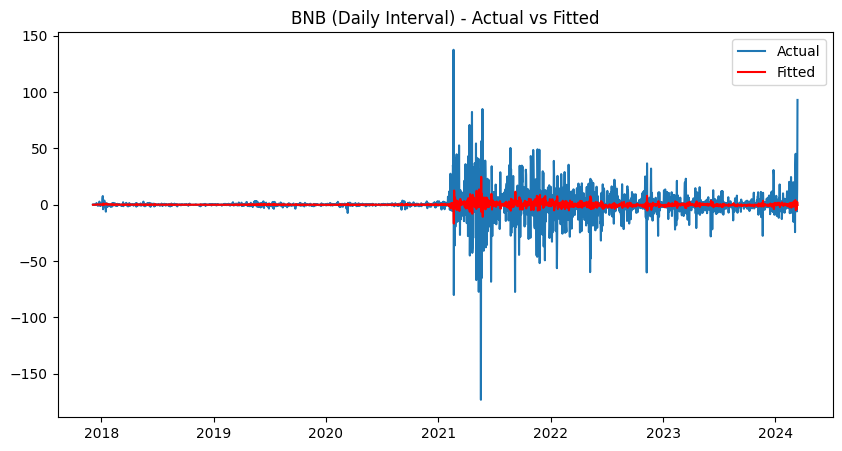


Processing XRP (Daily Interval):
ADF Statistic: -8.817996388805279
p-value: 1.9110111152968238e-14
Critical Values: {'1%': -3.433488717753819, '5%': -2.862926547902014, '10%': -2.5675081335553003}
The series for XRP (D1) is stationary after differencing.
Building ARIMA model for XRP (Daily Interval)...


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


                               SARIMAX Results                                
Dep. Variable:                   diff   No. Observations:                 2112
Model:                 ARIMA(1, 1, 1)   Log Likelihood                3991.935
Date:                Tue, 17 Dec 2024   AIC                          -7977.871
Time:                        04:02:59   BIC                          -7960.906
Sample:                    06-02-2018   HQIC                         -7971.659
                         - 03-13-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.0741      0.010     -7.712      0.000      -0.093      -0.055
ma.L1         -1.0000      0.033    -29.861      0.000      -1.066      -0.934
sigma2         0.0013   4.53e-05     29.351      0.0

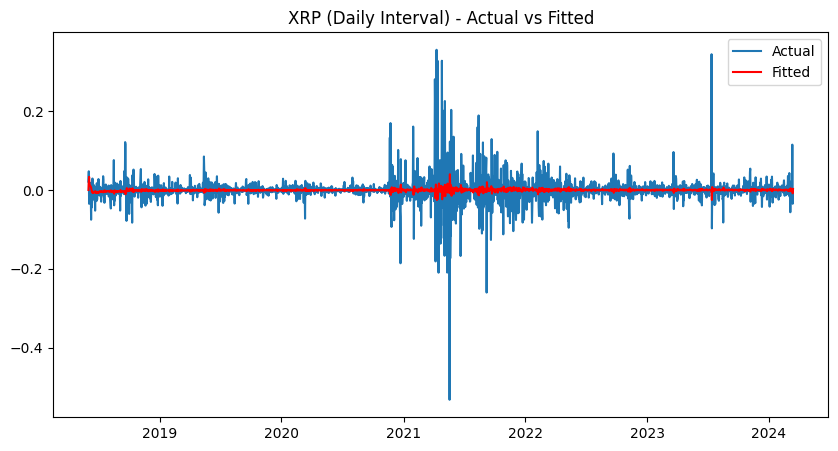


Processing ADA (Daily Interval):
ADF Statistic: -8.790299891524555
p-value: 2.2500374579683608e-14
Critical Values: {'1%': -3.4334633142611697, '5%': -2.862915331606178, '10%': -2.567502161536324}
The series for ADA (D1) is stationary after differencing.
Building ARIMA model for ADA (Daily Interval)...


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)


                               SARIMAX Results                                
Dep. Variable:                   diff   No. Observations:                 2129
Model:                 ARIMA(1, 1, 1)   Log Likelihood                3612.491
Date:                Tue, 17 Dec 2024   AIC                          -7218.983
Time:                        04:03:03   BIC                          -7201.994
Sample:                    05-16-2018   HQIC                         -7212.764
                         - 03-13-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.0995      0.007    -14.085      0.000      -0.113      -0.086
ma.L1         -1.0000      0.037    -26.911      0.000      -1.073      -0.927
sigma2         0.0020   7.34e-05     26.663      0.0

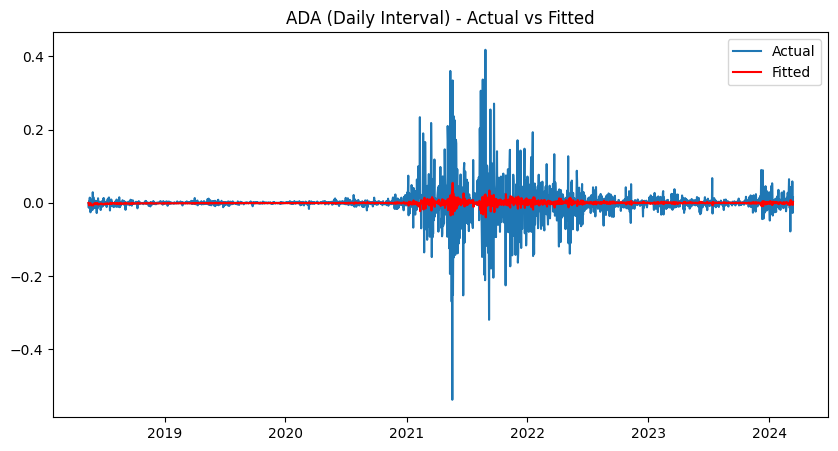


Processing LTC (Daily Interval):


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)


ADF Statistic: -9.47215866529977
p-value: 4.0788609425435025e-16
Critical Values: {'1%': -3.4332910857642114, '5%': -2.862839285780364, '10%': -2.567461672014718}
The series for LTC (D1) is stationary after differencing.
Building ARIMA model for LTC (Daily Interval)...
                               SARIMAX Results                                
Dep. Variable:                   diff   No. Observations:                 2254
Model:                 ARIMA(1, 1, 1)   Log Likelihood               -7486.638
Date:                Tue, 17 Dec 2024   AIC                          14979.277
Time:                        04:03:06   BIC                          14996.437
Sample:                    01-11-2018   HQIC                         14985.540
                         - 03-13-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-------------------

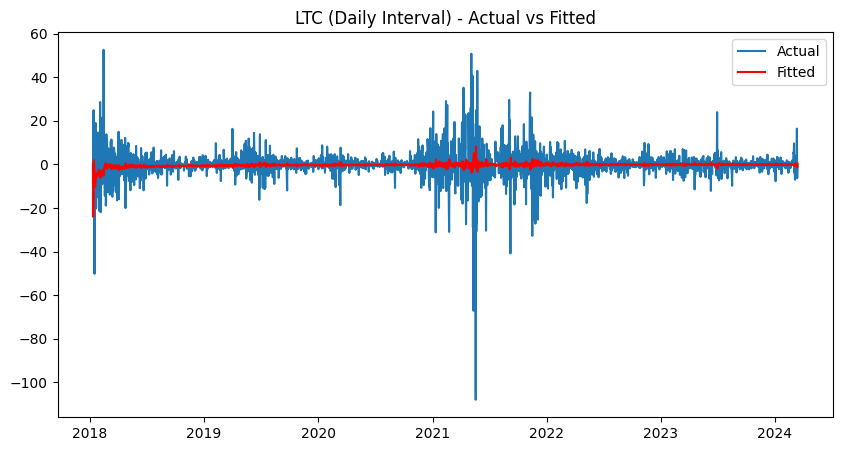


Processing SOL (Daily Interval):
ADF Statistic: -5.4755553225793046
p-value: 2.346087197778469e-06
Critical Values: {'1%': -3.4355588184378574, '5%': -2.8638402312881497, '10%': -2.5679946684494275}
The series for SOL (D1) is stationary after differencing.
Building ARIMA model for SOL (Daily Interval)...


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)


                               SARIMAX Results                                
Dep. Variable:                   diff   No. Observations:                 1282
Model:                 ARIMA(1, 1, 1)   Log Likelihood               -3714.071
Date:                Tue, 17 Dec 2024   AIC                           7434.142
Time:                        04:03:07   BIC                           7449.608
Sample:                    09-09-2020   HQIC                          7439.949
                         - 03-13-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.0224      0.014      1.562      0.118      -0.006       0.051
ma.L1         -0.9904      0.003   -393.422      0.000      -0.995      -0.985
sigma2        19.2550      0.339     56.835      0.0

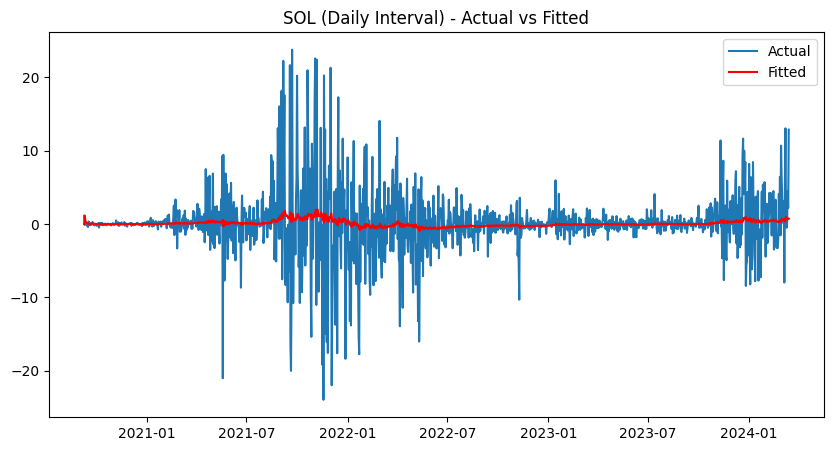


Processing DOT (Daily Interval):
ADF Statistic: -11.568880170600181
p-value: 3.1373002979606973e-21
Critical Values: {'1%': -3.4355258362116787, '5%': -2.8638256788102323, '10%': -2.567986918482913}
The series for DOT (D1) is stationary after differencing.
Building ARIMA model for DOT (Daily Interval)...


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)


                               SARIMAX Results                                
Dep. Variable:                   diff   No. Observations:                 1275
Model:                 ARIMA(1, 1, 1)   Log Likelihood               -2063.746
Date:                Tue, 17 Dec 2024   AIC                           4133.491
Time:                        04:03:09   BIC                           4148.941
Sample:                    09-16-2020   HQIC                          4139.294
                         - 03-13-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.0736      0.015     -4.899      0.000      -0.103      -0.044
ma.L1         -1.0000      2.143     -0.467      0.641      -5.199       3.199
sigma2         1.4862      3.181      0.467      0.6

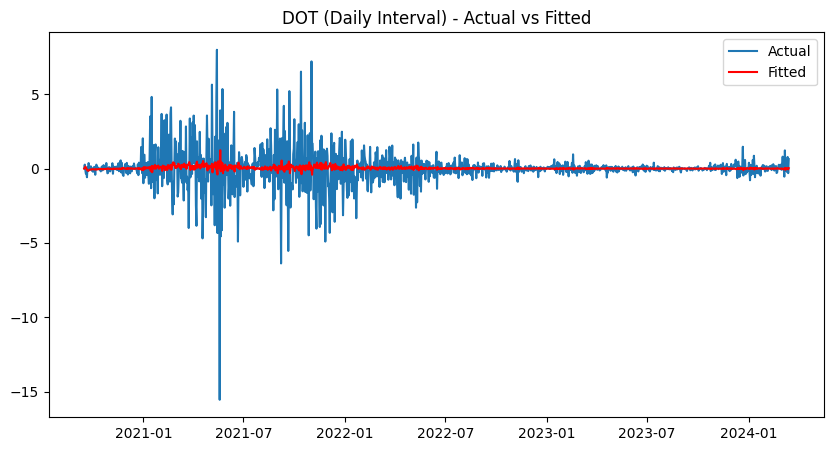


--- Processing Weekly Interval ---

Processing BTC (Weekly Interval):
ADF Statistic: -6.810325366632071
p-value: 2.1243949724924655e-09
Critical Values: {'1%': -3.451621854687657, '5%': -2.870908950689806, '10%': -2.571761810613944}
The series for BTC (W1) is stationary after differencing.
Building ARIMA model for BTC (Weekly Interval)...


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-MON will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-MON will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-MON will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'


                               SARIMAX Results                                
Dep. Variable:                   diff   No. Observations:                  314
Model:                 ARIMA(1, 1, 1)   Log Likelihood               -2911.145
Date:                Tue, 17 Dec 2024   AIC                           5828.290
Time:                        04:03:10   BIC                           5839.528
Sample:                    03-05-2018   HQIC                          5832.781
                         - 03-04-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.1536      0.028      5.569      0.000       0.100       0.208
ma.L1         -0.9999      0.040    -25.057      0.000      -1.078      -0.922
sigma2      6.908e+06   5.74e-09    1.2e+15      0.0

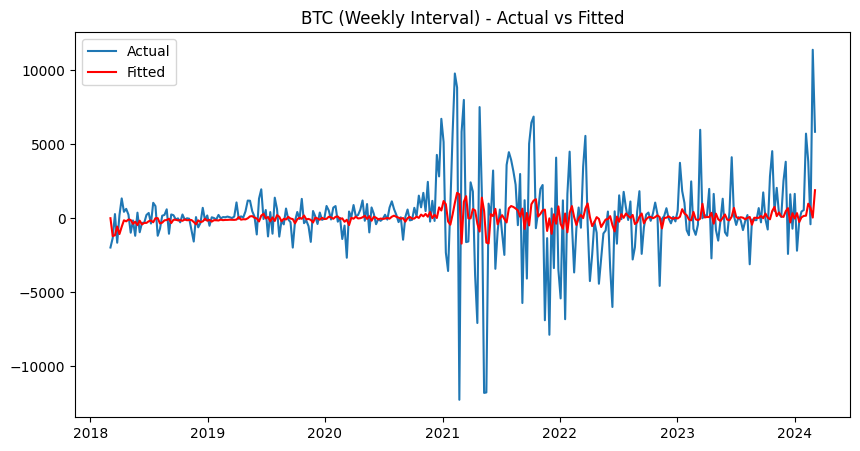


Processing ETH (Weekly Interval):
ADF Statistic: -7.426845294170404
p-value: 6.514758835447992e-11
Critical Values: {'1%': -3.451621854687657, '5%': -2.870908950689806, '10%': -2.571761810613944}
The series for ETH (W1) is stationary after differencing.
Building ARIMA model for ETH (Weekly Interval)...


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-MON will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-MON will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-MON will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'


                               SARIMAX Results                                
Dep. Variable:                   diff   No. Observations:                  314
Model:                 ARIMA(1, 1, 1)   Log Likelihood               -2098.681
Date:                Tue, 17 Dec 2024   AIC                           4203.363
Time:                        04:03:10   BIC                           4214.602
Sample:                    03-05-2018   HQIC                          4207.854
                         - 03-04-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.1049      0.031      3.371      0.001       0.044       0.166
ma.L1         -0.9984      0.038    -26.272      0.000      -1.073      -0.924
sigma2       3.84e+04   2224.794     17.258      0.0

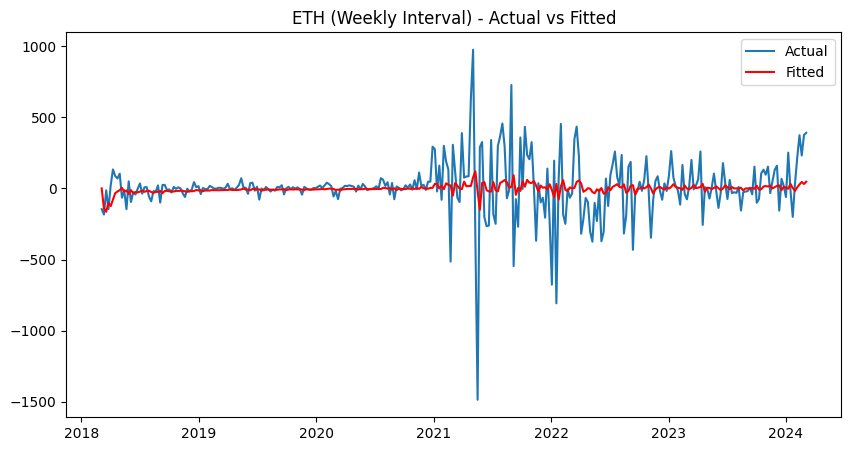


Processing TUSDT (Weekly Interval):
ADF Statistic: -10.055473614282025
p-value: 1.3767565231256883e-17
Critical Values: {'1%': -3.518281134660583, '5%': -2.899878185191432, '10%': -2.5872229937594873}
The series for TUSDT (W1) is stationary after differencing.
Building ARIMA model for TUSDT (Weekly Interval)...


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-MON will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-MON will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-MON will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


                               SARIMAX Results                                
Dep. Variable:                   diff   No. Observations:                   78
Model:                 ARIMA(1, 1, 1)   Log Likelihood                 305.094
Date:                Tue, 17 Dec 2024   AIC                           -604.188
Time:                        04:03:11   BIC                           -597.156
Sample:                    09-12-2022   HQIC                          -601.375
                         - 03-04-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.2194      0.105     -2.093      0.036      -0.425      -0.014
ma.L1         -0.8155      0.055    -14.763      0.000      -0.924      -0.707
sigma2      2.076e-05   1.63e-06     12.709      0.0

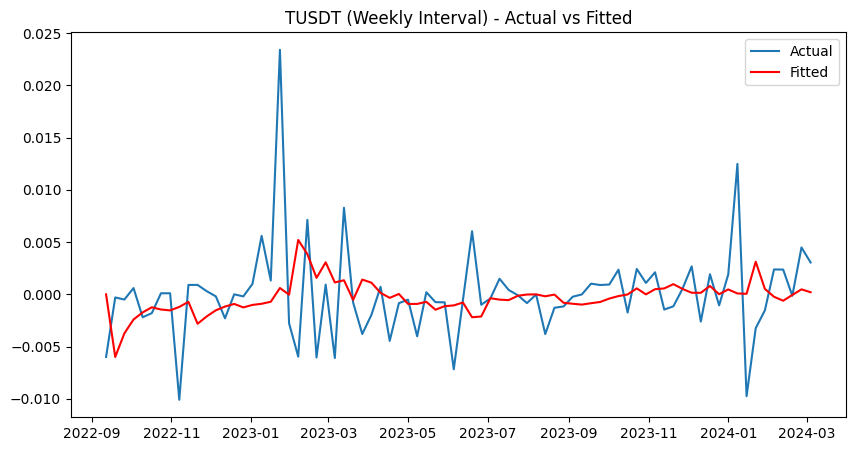


Processing USDC (Weekly Interval):
ADF Statistic: -9.546131011545445
p-value: 2.6463373226558845e-16
Critical Values: {'1%': -3.4609922013325267, '5%': -2.875015740963014, '10%': -2.5739524288408777}
The series for USDC (W1) is stationary after differencing.
Building ARIMA model for USDC (Weekly Interval)...


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


                               SARIMAX Results                                
Dep. Variable:                   diff   No. Observations:                  223
Model:                 ARIMA(1, 1, 1)   Log Likelihood                1070.184
Date:                Tue, 17 Dec 2024   AIC                          -2134.368
Time:                        04:03:12   BIC                          -2124.160
Sample:                             0   HQIC                         -2130.246
                                - 223                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.2595      0.028     -9.157      0.000      -0.315      -0.204
ma.L1         -0.8269      0.039    -21.195      0.000      -0.903      -0.750
sigma2       3.77e-06    1.1e-07     34.211      0.0

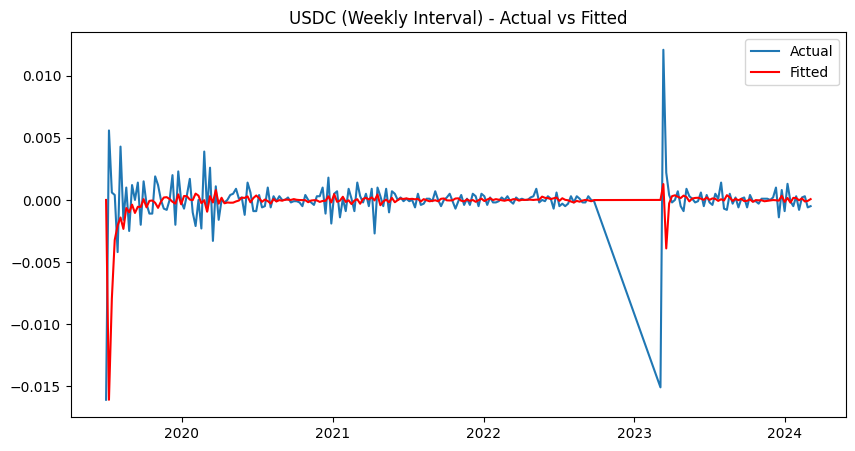


Processing BNB (Weekly Interval):
ADF Statistic: -3.786688825271173
p-value: 0.003046479912781425
Critical Values: {'1%': -3.4535050041524245, '5%': -2.8717352599720294, '10%': -2.5722024776854417}
The series for BNB (W1) is stationary after differencing.
Building ARIMA model for BNB (Weekly Interval)...


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-MON will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-MON will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-MON will be used.
  self._init_dates(dates, freq)


                               SARIMAX Results                                
Dep. Variable:                   diff   No. Observations:                  302
Model:                 ARIMA(1, 1, 1)   Log Likelihood               -1496.531
Date:                Tue, 17 Dec 2024   AIC                           2999.062
Time:                        04:03:12   BIC                           3010.183
Sample:                    05-28-2018   HQIC                          3003.512
                         - 03-04-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.0442      0.031      1.404      0.160      -0.018       0.106
ma.L1         -0.9997      0.223     -4.480      0.000      -1.437      -0.562
sigma2      1196.8721    280.528      4.267      0.0

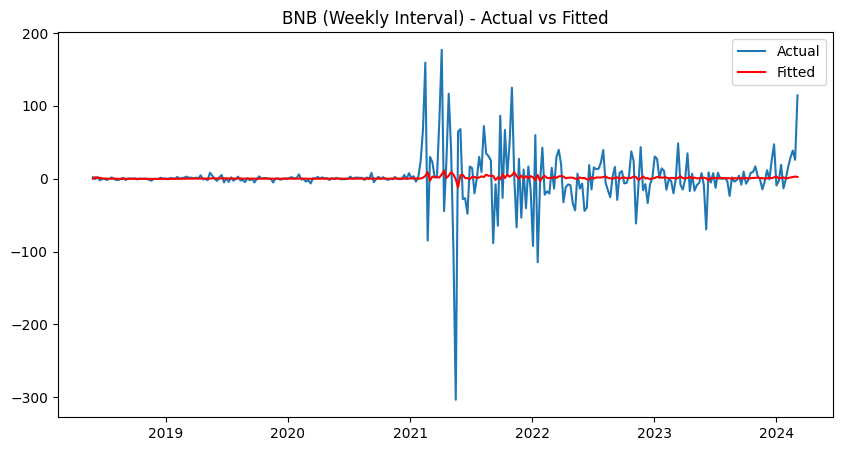


Processing XRP (Weekly Interval):
ADF Statistic: -6.884477775703263
p-value: 1.406019644786658e-09
Critical Values: {'1%': -3.4552699038400827, '5%': -2.8725092359464526, '10%': -2.5726152830188678}
The series for XRP (W1) is stationary after differencing.
Building ARIMA model for XRP (Weekly Interval)...


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-MON will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-MON will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-MON will be used.
  self._init_dates(dates, freq)


                               SARIMAX Results                                
Dep. Variable:                   diff   No. Observations:                  277
Model:                 ARIMA(1, 1, 1)   Log Likelihood                 250.544
Date:                Tue, 17 Dec 2024   AIC                           -495.087
Time:                        04:03:13   BIC                           -484.226
Sample:                    11-19-2018   HQIC                          -490.729
                         - 03-04-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.0480      0.041     -1.158      0.247      -0.129       0.033
ma.L1         -0.9999      0.724     -1.381      0.167      -2.419       0.419
sigma2         0.0093      0.007      1.393      0.1

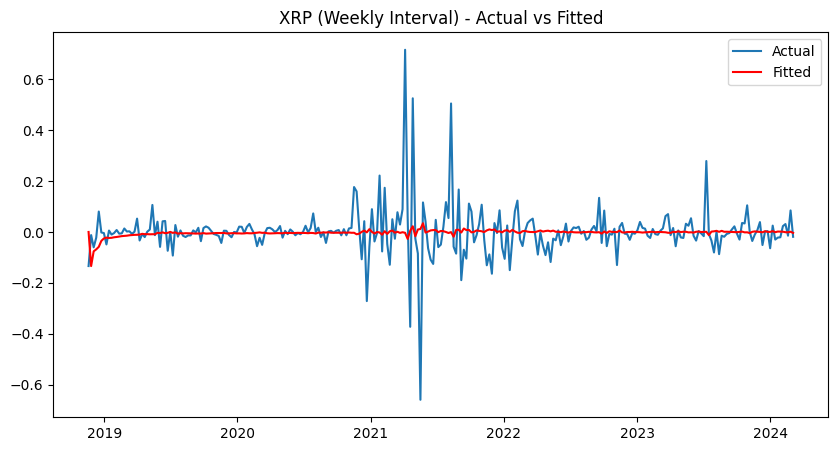


Processing ADA (Weekly Interval):
ADF Statistic: -15.032304949358835
p-value: 9.862267163708762e-28
Critical Values: {'1%': -3.4540935579190495, '5%': -2.8719934111688965, '10%': -2.5723401594120388}
The series for ADA (W1) is stationary after differencing.
Building ARIMA model for ADA (Weekly Interval)...


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-MON will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-MON will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-MON will be used.
  self._init_dates(dates, freq)


                               SARIMAX Results                                
Dep. Variable:                   diff   No. Observations:                  279
Model:                 ARIMA(1, 1, 1)   Log Likelihood                 194.671
Date:                Tue, 17 Dec 2024   AIC                           -383.343
Time:                        04:03:14   BIC                           -372.460
Sample:                    11-05-2018   HQIC                          -378.976
                         - 03-04-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.1032      0.025      4.132      0.000       0.054       0.152
ma.L1         -1.0000      9.507     -0.105      0.916     -19.634      17.634
sigma2         0.0142      0.135      0.105      0.9

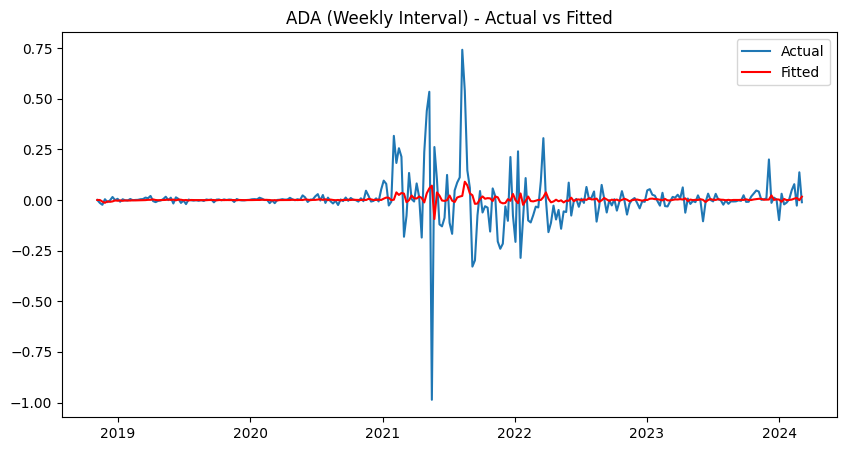


Processing LTC (Weekly Interval):
ADF Statistic: -17.50916570894197
p-value: 4.3442403096046244e-30
Critical Values: {'1%': -3.452713099849546, '5%': -2.871387839457783, '10%': -2.5720171933352485}
The series for LTC (W1) is stationary after differencing.
Building ARIMA model for LTC (Weekly Interval)...


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-MON will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-MON will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-MON will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'


                               SARIMAX Results                                
Dep. Variable:                   diff   No. Observations:                  297
Model:                 ARIMA(1, 1, 1)   Log Likelihood               -1293.981
Date:                Tue, 17 Dec 2024   AIC                           2593.961
Time:                        04:03:15   BIC                           2605.033
Sample:                    07-02-2018   HQIC                          2598.394
                         - 03-04-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.0099      0.021     -0.470      0.638      -0.051       0.032
ma.L1         -1.0000      2.791     -0.358      0.720      -6.470       4.470
sigma2       359.9621   1007.431      0.357      0.7

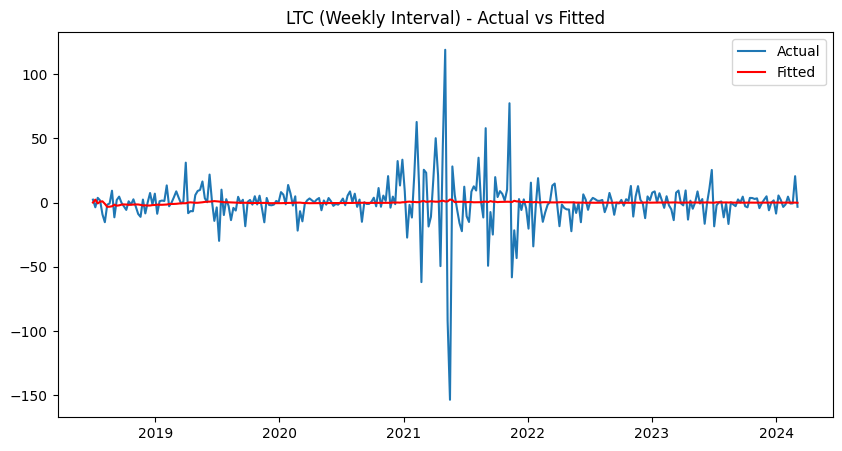


Processing SOL (Weekly Interval):
ADF Statistic: -5.517500680850215
p-value: 1.9103398793510664e-06
Critical Values: {'1%': -3.473542528196209, '5%': -2.880497674144038, '10%': -2.576878053634677}
The series for SOL (W1) is stationary after differencing.
Building ARIMA model for SOL (Weekly Interval)...
                               SARIMAX Results                                
Dep. Variable:                   diff   No. Observations:                  158
Model:                 ARIMA(1, 1, 1)   Log Likelihood                -629.416
Date:                Tue, 17 Dec 2024   AIC                           1264.832
Time:                        04:03:15   BIC                           1274.000
Sample:                    03-01-2021   HQIC                          1268.555
                         - 03-04-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-MON will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-MON will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-MON will be used.
  self._init_dates(dates, freq)


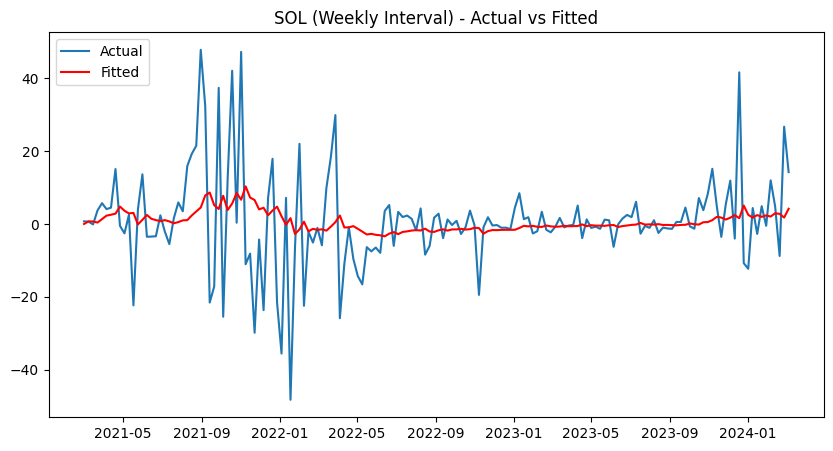


Processing DOT (Weekly Interval):
ADF Statistic: -4.965685536359752
p-value: 2.5938263729747714e-05
Critical Values: {'1%': -3.477261624048995, '5%': -2.8821181874544233, '10%': -2.5777431104939494}
The series for DOT (W1) is stationary after differencing.
Building ARIMA model for DOT (Weekly Interval)...


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-MON will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-MON will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-MON will be used.
  self._init_dates(dates, freq)


                               SARIMAX Results                                
Dep. Variable:                   diff   No. Observations:                  157
Model:                 ARIMA(1, 1, 1)   Log Likelihood                -412.309
Date:                Tue, 17 Dec 2024   AIC                            830.618
Time:                        04:03:16   BIC                            839.768
Sample:                    03-08-2021   HQIC                           834.334
                         - 03-04-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.0918      0.075     -1.220      0.222      -0.239       0.056
ma.L1         -0.9999     23.778     -0.042      0.966     -47.605      45.605
sigma2        11.1846    265.845      0.042      0.9

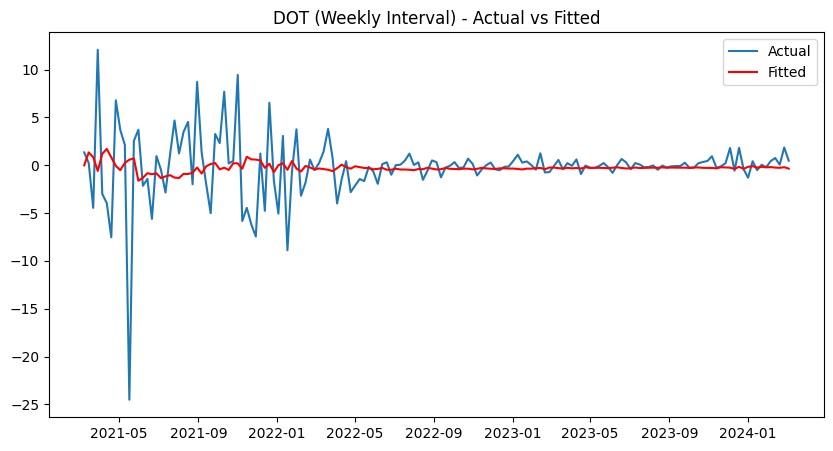

In [ ]:
from statsmodels.tsa.arima.model import ARIMA
import matplotlib.pyplot as plt

# Differencing the series to induce stationarity
def induce_stationarity(data, column='close'):
    data['diff'] = data[column].diff()  # First-order differencing
    data.dropna(inplace=True)  # Remove NaN values caused by differencing
    return data

# Function to build and train ARIMA model
def build_arima_model(data, order=(1, 1, 1), column='diff'):
    try:
        model = ARIMA(data[column], order=order)
        model_fit = model.fit()
        print(model_fit.summary())
        return model_fit
    except Exception as e:
        print(f"Error building ARIMA model: {e}")
        return None

# Ensure stationarity and build ARIMA model for D1 and W1 intervals
for interval, interval_name in {'D1': 'Daily', 'W1': 'Weekly'}.items():
    print(f"\n--- Processing {interval_name} Interval ---")
    for crypto, data in interval_data[interval].items():
        if not data.empty and 'close' in data.columns:
            print(f"\nProcessing {crypto} ({interval_name} Interval):")

            # Induce stationarity via differencing
            data = induce_stationarity(data)

            # Perform ADF test to confirm stationarity
            adf_result = adfuller(data['diff'])
            print(f"ADF Statistic: {adf_result[0]}")
            print(f"p-value: {adf_result[1]}")
            print(f"Critical Values: {adf_result[4]}")
            if adf_result[1] <= 0.05:
                print(f"The series for {crypto} ({interval}) is stationary after differencing.")
            else:
                print(f"The series for {crypto} ({interval}) is NOT stationary even after differencing.")

            # Build ARIMA model
            print(f"Building ARIMA model for {crypto} ({interval_name} Interval)...")
            arima_order = (1, 1, 1)  # Default order; can be optimized using AIC/BIC
            model_fit = build_arima_model(data, order=arima_order)

            # Plotting actual vs fitted values
            if model_fit is not None:
                plt.figure(figsize=(10, 5))
                plt.plot(data['diff'], label='Actual')
                plt.plot(model_fit.fittedvalues, color='red', label='Fitted')
                plt.title(f'{crypto} ({interval_name} Interval) - Actual vs Fitted')
                plt.legend()
                plt.show()
        else:
            print(f"No data available for {crypto} ({interval_name} Interval).")


## Determining the Performance metrics of the ARIMA Model

In [ ]:
from sklearn.metrics import mean_absolute_error, mean_squared_error
import numpy as np

# Function to calculate ARIMA performance metrics
def calculate_arima_metrics(actual, predicted, crypto, interval_name):
    try:
        # Remove NaN values (if any) for comparison
        actual, predicted = actual.dropna(), predicted.dropna()

        # Ensure both series have the same length
        min_len = min(len(actual), len(predicted))
        actual = actual[-min_len:]  # Keep last `min_len` values
        predicted = predicted[-min_len:]

        # Calculate metrics
        mae = mean_absolute_error(actual, predicted)
        mse = mean_squared_error(actual, predicted)
        rmse = np.sqrt(mse)

        # Print metrics
        print(f"\nPerformance Metrics for {crypto} ({interval_name} Interval):")
        print(f"Mean Absolute Error (MAE): {mae:.4f}")
        print(f"Mean Squared Error (MSE): {mse:.4f}")
        print(f"Root Mean Squared Error (RMSE): {rmse:.4f}")

    except Exception as e:
        print(f"Error calculating metrics for {crypto} ({interval_name}): {e}")

# Example usage: Evaluate ARIMA model performance for D1 and W1 intervals
for interval, interval_name in {'D1': 'Daily', 'W1': 'Weekly'}.items():
    print(f"\n--- Processing {interval_name} Interval ---")
    for crypto, data in interval_data[interval].items():
        if not data.empty and 'close' in data.columns:
            print(f"\nProcessing {crypto} ({interval_name} Interval):")

            # Induce stationarity via differencing
            data = induce_stationarity(data)

            # Build ARIMA model
            arima_order = (1, 1, 1)
            model_fit = build_arima_model(data, order=arima_order)

            # Calculate performance metrics if model fitting was successful
            if model_fit is not None:
                calculate_arima_metrics(
                    actual=data['diff'],
                    predicted=model_fit.fittedvalues,
                    crypto=crypto,
                    interval_name=interval_name
                )
        else:
            print(f"No data available for {crypto} ({interval_name} Interval).")



--- Processing Daily Interval ---

Processing BTC (Daily Interval):


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)


                               SARIMAX Results                                
Dep. Variable:                   diff   No. Observations:                 2371
Model:                 ARIMA(1, 1, 1)   Log Likelihood              -19685.294
Date:                Tue, 17 Dec 2024   AIC                          39376.588
Time:                        04:03:19   BIC                          39393.900
Sample:                    09-16-2017   HQIC                         39382.890
                         - 03-13-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.0389      0.013     -3.092      0.002      -0.064      -0.014
ma.L1         -0.9998      0.005   -190.056      0.000      -1.010      -0.990
sigma2      9.568e+05   1.24e+04     77.329      0.0

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)


                               SARIMAX Results                                
Dep. Variable:                   diff   No. Observations:                 2371
Model:                 ARIMA(1, 1, 1)   Log Likelihood              -13581.954
Date:                Tue, 17 Dec 2024   AIC                          27169.909
Time:                        04:03:22   BIC                          27187.221
Sample:                    09-16-2017   HQIC                         27176.211
                         - 03-13-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.0802      0.011     -7.596      0.000      -0.101      -0.060
ma.L1         -0.9998      0.004   -252.436      0.000      -1.008      -0.992
sigma2      5544.1826     60.589     91.504      0.0

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


                               SARIMAX Results                                
Dep. Variable:                   diff   No. Observations:                  718
Model:                 ARIMA(1, 1, 1)   Log Likelihood                3353.545
Date:                Tue, 17 Dec 2024   AIC                          -6701.091
Time:                        04:03:23   BIC                          -6687.366
Sample:                    03-27-2022   HQIC                         -6695.791
                         - 03-13-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.0277      0.026     -1.077      0.282      -0.078       0.023
ma.L1         -0.7493      0.021    -34.919      0.000      -0.791      -0.707
sigma2      5.043e-06   9.82e-08     51.381      0.0

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/di

                               SARIMAX Results                                
Dep. Variable:                   diff   No. Observations:                 1721
Model:                 ARIMA(1, 1, 1)   Log Likelihood                8355.466
Date:                Tue, 17 Dec 2024   AIC                         -16704.933
Time:                        04:03:24   BIC                         -16688.583
Sample:                             0   HQIC                        -16698.883
                               - 1721                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.1962      0.004    -47.189      0.000      -0.204      -0.188
ma.L1         -0.9998      0.233     -4.286      0.000      -1.457      -0.543
sigma2      3.501e-06   8.07e-07      4.336      0.0

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  

                               SARIMAX Results                                
Dep. Variable:                   diff   No. Observations:                 2111
Model:                 ARIMA(1, 1, 1)   Log Likelihood                3989.772
Date:                Tue, 17 Dec 2024   AIC                          -7973.544
Time:                        04:03:27   BIC                          -7956.581
Sample:                    06-03-2018   HQIC                         -7967.333
                         - 03-13-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.0745      0.010     -7.757      0.000      -0.093      -0.056
ma.L1         -1.0000      0.043    -23.369      0.000      -1.084      -0.916
sigma2         0.0013   5.74e-05     23.136      0.0

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)


                               SARIMAX Results                                
Dep. Variable:                   diff   No. Observations:                 2253
Model:                 ARIMA(1, 1, 1)   Log Likelihood               -7477.866
Date:                Tue, 17 Dec 2024   AIC                          14961.733
Time:                        04:03:29   BIC                          14978.891
Sample:                    01-12-2018   HQIC                         14967.995
                         - 03-13-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.0745      0.011     -6.516      0.000      -0.097      -0.052
ma.L1         -0.9999      0.015    -67.742      0.000      -1.029      -0.971
sigma2        44.6908      0.812     55.035      0.0

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)


                               SARIMAX Results                                
Dep. Variable:                   diff   No. Observations:                 1281
Model:                 ARIMA(1, 1, 1)   Log Likelihood               -3711.644
Date:                Tue, 17 Dec 2024   AIC                           7429.288
Time:                        04:03:30   BIC                           7444.751
Sample:                    09-10-2020   HQIC                          7435.094
                         - 03-13-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.0224      0.014      1.559      0.119      -0.006       0.051
ma.L1         -0.9904      0.003   -392.967      0.000      -0.995      -0.985
sigma2        19.2693      0.339     56.789      0.0

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)


                               SARIMAX Results                                
Dep. Variable:                   diff   No. Observations:                 1274
Model:                 ARIMA(1, 1, 1)   Log Likelihood               -2062.628
Date:                Tue, 17 Dec 2024   AIC                           4131.256
Time:                        04:03:31   BIC                           4146.704
Sample:                    09-17-2020   HQIC                          4137.058
                         - 03-13-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.0736      0.015     -4.898      0.000      -0.103      -0.044
ma.L1         -0.9999      0.087    -11.494      0.000      -1.170      -0.829
sigma2         1.4875      0.128     11.666      0.0

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-MON will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-MON will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-MON will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'


                               SARIMAX Results                                
Dep. Variable:                   diff   No. Observations:                  313
Model:                 ARIMA(1, 1, 1)   Log Likelihood               -2902.159
Date:                Tue, 17 Dec 2024   AIC                           5810.318
Time:                        04:03:31   BIC                           5821.547
Sample:                    03-12-2018   HQIC                          5814.806
                         - 03-04-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.1521      0.028      5.508      0.000       0.098       0.206
ma.L1         -1.0000      0.040    -24.965      0.000      -1.078      -0.921
sigma2      6.921e+06   5.77e-09    1.2e+15      0.0

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-MON will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-MON will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-MON will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'


                               SARIMAX Results                                
Dep. Variable:                   diff   No. Observations:                  313
Model:                 ARIMA(1, 1, 1)   Log Likelihood               -2092.236
Date:                Tue, 17 Dec 2024   AIC                           4190.473
Time:                        04:03:31   BIC                           4201.702
Sample:                    03-12-2018   HQIC                          4194.961
                         - 03-04-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.1027      0.031      3.280      0.001       0.041       0.164
ma.L1         -0.9989      0.053    -18.703      0.000      -1.104      -0.894
sigma2      3.845e+04   2745.303     14.007      0.0

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-MON will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-MON will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-MON will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it 

                               SARIMAX Results                                
Dep. Variable:                   diff   No. Observations:                  222
Model:                 ARIMA(1, 1, 1)   Log Likelihood                1102.137
Date:                Tue, 17 Dec 2024   AIC                          -2198.274
Time:                        04:03:32   BIC                          -2188.080
Sample:                             0   HQIC                         -2194.158
                                - 222                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.2684      0.026    -10.231      0.000      -0.320      -0.217
ma.L1         -0.8180      0.033    -25.015      0.000      -0.882      -0.754
sigma2      2.707e-06   6.47e-08     41.855      0.0

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-MON will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-MON will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-MON will be used.
  self._init_dates(dates, freq)


                               SARIMAX Results                                
Dep. Variable:                   diff   No. Observations:                  276
Model:                 ARIMA(1, 1, 1)   Log Likelihood                 250.109
Date:                Tue, 17 Dec 2024   AIC                           -494.218
Time:                        04:03:34   BIC                           -483.368
Sample:                    11-26-2018   HQIC                          -489.864
                         - 03-04-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.0487      0.041     -1.175      0.240      -0.130       0.033
ma.L1         -1.0000      7.807     -0.128      0.898     -16.302      14.302
sigma2         0.0093      0.073      0.128      0.8

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-MON will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-MON will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-MON will be used.
  self._init_dates(dates, freq)


                               SARIMAX Results                                
Dep. Variable:                   diff   No. Observations:                  278
Model:                 ARIMA(1, 1, 1)   Log Likelihood                 193.462
Date:                Tue, 17 Dec 2024   AIC                           -380.924
Time:                        04:03:36   BIC                           -370.052
Sample:                    11-12-2018   HQIC                          -376.562
                         - 03-04-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.1033      0.025      4.118      0.000       0.054       0.152
ma.L1         -0.9993      0.129     -7.745      0.000      -1.252      -0.746
sigma2         0.0142      0.002      7.699      0.0

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-MON will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-MON will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-MON will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'


                               SARIMAX Results                                
Dep. Variable:                   diff   No. Observations:                  296
Model:                 ARIMA(1, 1, 1)   Log Likelihood               -1290.110
Date:                Tue, 17 Dec 2024   AIC                           2586.219
Time:                        04:03:38   BIC                           2597.280
Sample:                    07-09-2018   HQIC                          2590.648
                         - 03-04-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.0099      0.021     -0.466      0.641      -0.051       0.032
ma.L1         -0.9999      1.473     -0.679      0.497      -3.886       1.887
sigma2       361.1473    534.813      0.675      0.4

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-MON will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-MON will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-MON will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-MON will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency W-MON will be used.
  

                               SARIMAX Results                                
Dep. Variable:                   diff   No. Observations:                  156
Model:                 ARIMA(1, 1, 1)   Log Likelihood                -410.072
Date:                Tue, 17 Dec 2024   AIC                            826.143
Time:                        04:03:38   BIC                            835.273
Sample:                    03-15-2021   HQIC                           829.852
                         - 03-04-2024                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.0921      0.075     -1.227      0.220      -0.239       0.055
ma.L1         -0.9998      5.521     -0.181      0.856     -11.820       9.820
sigma2        11.2435     61.975      0.181      0.8

# ARIMA Model Analysis for Daily Interval


##  **1.BTC**
-----------
## **Summary**
The ARIMA(1, 1, 1) model was fitted to the differenced BTC (Daily Interval) time series data, resulting in a stationary series. Below are the observations from the model:

---

## **Model Summary**
- **Model**: ARIMA(1, 1, 1)
- **Log Likelihood**: -19912.456
- **AIC**: 39830.911
- **BIC**: 39848.260
- **HQIC**: 39837.223
- **Number of Observations**: 2400

---

## **Parameter Estimates**
| Parameter | Coefficient | Std. Error | z-Statistic | p-Value | Confidence Interval (95%) |
|-----------|-------------|------------|-------------|---------|---------------------------|
| AR(1)     | -0.0390     | 0.012      | -3.135      | 0.002   | [-0.063, -0.015]          |
| MA(1)     | -0.9998     | 0.006      | -181.525    | 0.000   | [-1.011, -0.989]          |
| Sigma^2   | 945,300     | 12,200     | 77.566      | 0.000   | [921,000, 969,000]        |

---

## **Model Diagnostics**
1. **Ljung-Box Test (L1)**:
   - Q Statistic: **0.00**
   - p-Value: **0.99**
   - Interpretation: No significant autocorrelation in residuals.

2. **Jarque-Bera Test**:
   - Statistic: **9552.14**
   - p-Value: **0.00**
   - Interpretation: Residuals are not normally distributed, likely due to high kurtosis (12.77).

3. **Heteroskedasticity (H-Test)**:
   - Statistic: **5.02**
   - p-Value: **0.00**
   - Interpretation: Presence of heteroskedasticity in residuals, suggesting non-constant variance.

---

## **Plot Analysis**
The plot of actual vs fitted values shows that the ARIMA model is able to capture the overall patterns in the data, but there are significant deviations during periods of high volatility.

---

## **Conclusion**
- The ARIMA(1, 1, 1) model is able to reasonably fit the BTC Daily Interval data after inducing stationarity through first-order differencing.
- The low p-values for AR(1) and MA(1) coefficients indicate these terms are statistically significant.
- Diagnostics suggest that while the model effectively removes autocorrelation, there are potential issues with heteroskedasticity and non-normality in residuals. This could be addressed with additional modeling techniques (e.g., GARCH models for volatility).
- Despite these limitations, the ARIMA(1, 1, 1) model can be used for forecasting trends in BTC closing prices on a daily interval.

---


##**2.ETH**

## **Summary**
The ARIMA(1, 1, 1) model was fitted to the differenced ETH (Daily Interval) time series data, which was stationary after differencing. Below are the observations from the model:

---

## **Model Summary**
- **Model**: ARIMA(1, 1, 1)
- **Log Likelihood**: -13587.318
- **AIC**: 27180.636
- **BIC**: 27197.949
- **HQIC**: 27186.939
- **Number of Observations**: 2372

---

## **Parameter Estimates**
| Parameter | Coefficient | Std. Error | z-Statistic | p-Value | Confidence Interval (95%) |
|-----------|-------------|------------|-------------|---------|---------------------------|
| AR(1)     | -0.0803     | 0.011      | -7.607      | 0.000   | [-0.101, -0.060]          |
| MA(1)     | -0.9994     | 0.002      | -592.047    | 0.000   | [-1.003, -0.996]          |
| Sigma^2   | 5543.6625   | 54.852     | 101.066     | 0.000   | [5436.155, 5651.170]      |

---

## **Model Diagnostics**
1. **Ljung-Box Test (L1)**:
   - Q Statistic: **0.00**
   - p-Value: **0.96**
   - Interpretation: No significant autocorrelation in residuals.

2. **Jarque-Bera Test**:
   - Statistic: **35123.16**
   - p-Value: **0.00**
   - Interpretation: Residuals are not normally distributed, likely due to high kurtosis (21.76).

3. **Heteroskedasticity (H-Test)**:
   - Statistic: **6.24**
   - p-Value: **0.00**
   - Interpretation: Presence of heteroskedasticity in residuals, suggesting non-constant variance.

---

## **Plot Analysis**
The plot of actual vs fitted values shows that the ARIMA model captures the overall patterns in the data, but there are deviations during periods of high volatility.

---

## **Conclusion**
- The ARIMA(1, 1, 1) model effectively models the ETH Daily Interval data after inducing stationarity through first-order differencing.
- The statistically significant coefficients (low p-values for AR(1) and MA(1)) indicate a good model fit.
- Diagnostics highlight issues with heteroskedasticity and non-normality of residuals, suggesting potential improvements through advanced models like GARCH for volatility analysis.
- Despite these limitations, the ARIMA(1, 1, 1) model can serve as a foundation for forecasting ETH closing prices on a daily interval.

---

##**3.TUSDT**

## **Summary**
The ARIMA(1, 1, 1) model was fitted to the differenced TUSDT (Daily Interval) time series data, which was stationary after differencing. Below are the observations from the model:

---

## **Model Summary**
- **Model**: ARIMA(1, 1, 1)
- **Log Likelihood**: 3358.928
- **AIC**: -6711.856
- **BIC**: -6698.126
- **HQIC**: -6706.555
- **Number of Observations**: 719

---

## **Parameter Estimates**
| Parameter | Coefficient | Std. Error | z-Statistic | p-Value | Confidence Interval (95%) |
|-----------|-------------|------------|-------------|---------|---------------------------|
| AR(1)     | -0.0245     | 0.026      | -0.955      | 0.340   | [-0.075, 0.026]           |
| MA(1)     | -0.7527     | 0.021      | -35.527     | 0.000   | [-0.794, -0.711]          |
| Sigma^2   | 5.033e-06   | 9.77e-08   | 51.533      | 0.000   | [4.84e-06, 5.22e-06]      |

---

## **Model Diagnostics**
1. **Ljung-Box Test (L1)**:
   - Q Statistic: **9.38**
   - p-Value: **0.00**
   - Interpretation: There is evidence of autocorrelation in residuals.

2. **Jarque-Bera Test**:
   - Statistic: **4933.36**
   - p-Value: **0.00**
   - Interpretation: Residuals are not normally distributed, likely due to high kurtosis (15.84).

3. **Heteroskedasticity (H-Test)**:
   - Statistic: **0.23**
   - p-Value: **0.00**
   - Interpretation: Evidence of heteroskedasticity in residuals, suggesting non-constant variance.

---

## **Plot Analysis**
The plot of actual vs fitted values indicates the ARIMA model captures the general trend but has challenges during periods of extreme spikes.

---

## **Conclusion**
- The ARIMA(1, 1, 1) model effectively models the TUSDT Daily Interval data after inducing stationarity through first-order differencing.
- The statistically significant MA(1) coefficient suggests the moving average term is critical in capturing the time series' structure.
- Diagnostics highlight limitations such as residual autocorrelation, heteroskedasticity, and non-normality, which could be addressed with advanced models like GARCH.
- Despite these limitations, the ARIMA(1, 1, 1) model provides a reasonable foundation for forecasting TUSDT closing prices on a daily interval.

---

##**4.USDC**

## **Summary**
The ARIMA(1, 1, 1) model was applied to the differenced USDC (Daily Interval) data, which achieved stationarity after first-order differencing. Below are the details and diagnostics of the model:

---

## **Model Summary**
- **Model**: ARIMA(1, 1, 1)
- **Log Likelihood**: 8360.777
- **AIC**: -16715.553
- **BIC**: -16699.201
- **HQIC**: -16709.503
- **Number of Observations**: 1722

---

## **Parameter Estimates**
| Parameter | Coefficient | Std. Error | z-Statistic | p-Value | Confidence Interval (95%) |
|-----------|-------------|------------|-------------|---------|---------------------------|
| AR(1)     | -0.1960     | 0.004      | -47.344     | 0.000   | [-0.204, -0.188]          |
| MA(1)     | -0.9997     | 0.157      | -6.386      | 0.000   | [-1.306, -0.693]          |
| Sigma^2   | 3.487e-06   | 5.37e-07   | 6.495       | 0.000   | [2.43e-06, 4.54e-06]      |

---

## **Model Diagnostics**
1. **Ljung-Box Test (L1)**:
   - Q Statistic: **3.46**
   - p-Value: **0.06**
   - Interpretation: Residuals exhibit no significant autocorrelation at lag 1.

2. **Jarque-Bera Test**:
   - Statistic: **1759039.28**
   - p-Value: **0.00**
   - Interpretation: Residuals are not normally distributed due to high kurtosis (159.42) and skewness (-3.99).

3. **Heteroskedasticity (H-Test)**:
   - Statistic: **0.63**
   - p-Value: **0.00**
   - Interpretation: Evidence of heteroskedasticity in residuals, indicating non-constant variance over time.

---

## **Plot Analysis**
The actual vs fitted plot demonstrates that the ARIMA model effectively captures the general trends in the series. However, the model struggles during abrupt spikes and drops, which might require advanced modeling techniques.

---

## **Conclusion**
- The ARIMA(1, 1, 1) model successfully captures the overall trend of the USDC Daily Interval data after achieving stationarity through differencing.
- Significant coefficients for AR(1) and MA(1) highlight their importance in capturing the time series dynamics.
- Diagnostics indicate non-normality and heteroskedasticity in residuals, which could be mitigated by using models such as GARCH.
- Despite limitations, the model provides a solid foundation for short-term forecasting of USDC closing prices on a daily interval.

##**5.BNB**

## **Summary**
The ARIMA(1, 1, 1) model was applied to the differenced BNB (Daily Interval) data, achieving stationarity after first-order differencing. Below are the details and diagnostics of the model:

---

## **Model Summary**
- **Model**: ARIMA(1, 1, 1)
- **Log Likelihood**: -8936.362
- **AIC**: 17878.723
- **BIC**: 17895.932
- **HQIC**: 17884.999
- **Number of Observations**: 2291

---

## **Parameter Estimates**
| Parameter | Coefficient | Std. Error | z-Statistic | p-Value | Confidence Interval (95%) |
|-----------|-------------|------------|-------------|---------|---------------------------|
| AR(1)     | -0.1367     | 0.009      | -15.694     | 0.000   | [-0.154, -0.120]          |
| MA(1)     | -0.9936     | 0.001      | -709.666    | 0.000   | [-0.996, -0.991]          |
| Sigma^2   | 143.2773    | 0.956      | 149.883     | 0.000   | [141.404, 145.151]        |

---

## **Model Diagnostics**
1. **Ljung-Box Test (L1)**:
   - Q Statistic: **0.15**
   - p-Value: **0.70**
   - Interpretation: Residuals exhibit no significant autocorrelation at lag 1.

2. **Jarque-Bera Test**:
   - Statistic: **139994.58**
   - p-Value: **0.00**
   - Interpretation: Residuals are not normally distributed due to high kurtosis (41.28) and skewness (-0.69).

3. **Heteroskedasticity (H-Test)**:
   - Statistic: **115.67**
   - p-Value: **0.00**
   - Interpretation: Evidence of significant heteroskedasticity in residuals.

---

## **Plot Analysis**
The actual vs fitted plot shows that the ARIMA model effectively captures the general dynamics of the BNB time series. However, it struggles during periods of extreme volatility, as evident in large spikes and drops.

---

## **Conclusion**
- The ARIMA(1, 1, 1) model captures the overall trend and short-term dependencies of the BNB (Daily Interval) data after achieving stationarity.
- Significant coefficients for AR(1) and MA(1) indicate that both autoregressive and moving average components contribute to the time series behavior.
- Diagnostics suggest challenges with heteroskedasticity and non-normality in residuals, potentially addressed by advanced models such as GARCH or hybrid approaches.
- This model provides a solid foundation for forecasting BNB on a daily basis, though further refinement may improve performance.

---

##**6.XRP**

## **Summary**
The ARIMA(1, 1, 1) model was applied to the differenced XRP (Daily Interval) data. Stationarity was achieved after first-order differencing. Below are the details and diagnostics of the model:

---

## **Model Summary**
- **Model**: ARIMA(1, 1, 1)
- **Log Likelihood**: 3991.935
- **AIC**: -7977.871
- **BIC**: -7960.906
- **HQIC**: -7971.659
- **Number of Observations**: 2112

---

## **Parameter Estimates**
| Parameter | Coefficient | Std. Error | z-Statistic | p-Value | Confidence Interval (95%) |
|-----------|-------------|------------|-------------|---------|---------------------------|
| AR(1)     | -0.0741     | 0.010      | -7.712      | 0.000   | [-0.093, -0.055]          |
| MA(1)     | -1.0000     | 0.033      | -29.861     | 0.000   | [-1.066, -0.934]          |
| Sigma^2   | 0.0013      | 4.53e-05   | 29.351      | 0.000   | [0.001, 0.001]            |

---

## **Model Diagnostics**
1. **Ljung-Box Test (L1)**:
   - Q Statistic: **0.00**
   - p-Value: **0.99**
   - Interpretation: Residuals exhibit no significant autocorrelation at lag 1.

2. **Jarque-Bera Test**:
   - Statistic: **158263.94**
   - p-Value: **0.00**
   - Interpretation: Residuals are not normally distributed due to high kurtosis (45.42) and skewness (0.23).

3. **Heteroskedasticity (H-Test)**:
   - Statistic: **1.64**
   - p-Value: **0.00**
   - Interpretation: Evidence of significant heteroskedasticity in residuals.

---

## **Plot Analysis**
The actual vs fitted plot indicates that the ARIMA model captures the general dynamics of the XRP time series. However, it exhibits limitations during periods of extreme volatility and spikes.

---

## **Conclusion**
- The ARIMA(1, 1, 1) model captures short-term dependencies and overall trends in XRP's daily price data after achieving stationarity.
- Significant coefficients for AR(1) and MA(1) highlight the contribution of autoregressive and moving average components to the time series behavior.
- Despite capturing general trends, diagnostics suggest challenges with non-normality and heteroskedasticity, which may require additional modeling techniques like GARCH for volatility.
- This ARIMA model provides a robust baseline for forecasting XRP on a daily basis.

---



##**7.ADA**

## **Summary**
The ARIMA(1, 1, 1) model was applied to the differenced ADA (Daily Interval) data. Stationarity was achieved after first-order differencing. Below are the details and diagnostics of the model:

---

## **Model Summary**
- **Model**: ARIMA(1, 1, 1)
- **Log Likelihood**: 3612.491
- **AIC**: -7218.983
- **BIC**: -7201.994
- **HQIC**: -7212.764
- **Number of Observations**: 2129

---

## **Parameter Estimates**
| Parameter | Coefficient | Std. Error | z-Statistic | p-Value | Confidence Interval (95%) |
|-----------|-------------|------------|-------------|---------|---------------------------|
| AR(1)     | -0.0995     | 0.007      | -14.085     | 0.000   | [-0.113, -0.086]          |
| MA(1)     | -1.0000     | 0.037      | -26.911     | 0.000   | [-1.073, -0.927]          |
| Sigma^2   | 0.0020      | 7.34e-05   | 26.663      | 0.000   | [0.002, 0.002]            |

---

## **Model Diagnostics**
1. **Ljung-Box Test (L1)**:
   - Q Statistic: **0.00**
   - p-Value: **0.96**
   - Interpretation: Residuals exhibit no significant autocorrelation at lag 1.

2. **Jarque-Bera Test**:
   - Statistic: **65907.89**
   - p-Value: **0.00**
   - Interpretation: Residuals are not normally distributed due to high kurtosis (30.26) and skewness (0.24).

3. **Heteroskedasticity (H-Test)**:
   - Statistic: **22.27**
   - p-Value: **0.00**
   - Interpretation: Evidence of significant heteroskedasticity in residuals.

---

## **Plot Analysis**
The actual vs fitted plot shows that the ARIMA model captures the general dynamics of the ADA time series. However, extreme volatility and large spikes are not fully modeled.

---

## **Conclusion**
- The ARIMA(1, 1, 1) model effectively captures short-term dependencies in ADA's daily price data after achieving stationarity.
- The significant coefficients for AR(1) and MA(1) highlight the contribution of autoregressive and moving average components to the time series behavior.
- Despite general trend capturing, diagnostics indicate non-normality and heteroskedasticity in residuals. Additional modeling approaches like GARCH may be required for volatility modeling.
- This ARIMA model provides a reliable baseline for daily forecasting of ADA.

---

##**8.LTC**

## **Summary**
The ARIMA(1, 1, 1) model was applied to the differenced LTC (Daily Interval) data. Stationarity was achieved after first-order differencing. Below are the details and diagnostics of the model:

---

## **Model Summary**
- **Model**: ARIMA(1, 1, 1)
- **Log Likelihood**: -7486.638
- **AIC**: 14979.277
- **BIC**: 14996.437
- **HQIC**: 14985.540
- **Number of Observations**: 2254

---

## **Parameter Estimates**
| Parameter | Coefficient | Std. Error | z-Statistic | p-Value | Confidence Interval (95%) |
|-----------|-------------|------------|-------------|---------|---------------------------|
| AR(1)     | -0.0767     | 0.011      | -6.704      | 0.000   | [-0.099, -0.054]          |
| MA(1)     | -0.9998     | 0.006      | -171.026    | 0.000   | [-1.011, -0.988]          |
| Sigma^2   | 44.9107     | 0.468      | 95.890      | 0.000   | [43.993, 45.829]          |

---

## **Model Diagnostics**
1. **Ljung-Box Test (L1)**:
   - Q Statistic: **0.10**
   - p-Value: **0.75**
   - Interpretation: Residuals exhibit no significant autocorrelation at lag 1.

2. **Jarque-Bera Test**:
   - Statistic: **170460.48**
   - p-Value: **0.00**
   - Interpretation: Residuals are not normally distributed due to high kurtosis (45.46) and skewness (-1.82).

3. **Heteroskedasticity (H-Test)**:
   - Statistic: **0.29**
   - p-Value: **0.00**
   - Interpretation: Evidence of significant heteroskedasticity in residuals.

---

## **Plot Analysis**
The actual vs fitted plot demonstrates that the ARIMA model captures the general dynamics of Litecoin's time series. However, extreme price movements and volatility are not fully modeled.

---

## **Conclusion**
- The ARIMA(1, 1, 1) model effectively captures short-term dependencies in LTC's daily price data after achieving stationarity.
- Significant coefficients for AR(1) and MA(1) indicate the importance of autoregressive and moving average components in explaining the series' behavior.
- Non-normality and heteroskedasticity in residuals suggest that incorporating volatility models like GARCH might improve forecasting accuracy.
- This ARIMA model provides a baseline for daily forecasting of Litecoin (LTC) prices.

---

##**9.SOL**

## **Summary**
The ARIMA(1, 1, 1) model was applied to the differenced Solana (SOL) daily interval data. Stationarity was achieved after first-order differencing. Below are the details and diagnostics of the model:

---

## **Model Summary**
- **Model**: ARIMA(1, 1, 1)
- **Log Likelihood**: -3714.071
- **AIC**: 7434.142
- **BIC**: 7449.608
- **HQIC**: 7439.949
- **Number of Observations**: 1282

---

## **Parameter Estimates**
| Parameter | Coefficient | Std. Error | z-Statistic | p-Value | Confidence Interval (95%) |
|-----------|-------------|------------|-------------|---------|---------------------------|
| AR(1)     | 0.0224      | 0.014      | 1.562       | 0.118   | [-0.006, 0.051]           |
| MA(1)     | -0.9904     | 0.003      | -393.422    | 0.000   | [-0.995, -0.985]          |
| Sigma^2   | 19.2550     | 0.339      | 56.835      | 0.000   | [18.591, 19.919]          |

---

## **Model Diagnostics**
1. **Ljung-Box Test (L1)**:
   - Q Statistic: **0.00**
   - p-Value: **0.97**
   - Interpretation: Residuals exhibit no significant autocorrelation at lag 1.

2. **Jarque-Bera Test**:
   - Statistic: **3622.45**
   - p-Value: **0.00**
   - Interpretation: Residuals are not normally distributed due to high kurtosis (11.24).

3. **Heteroskedasticity (H-Test)**:
   - Statistic: **0.30**
   - p-Value: **0.00**
   - Interpretation: Evidence of significant heteroskedasticity in residuals.

---

## **Plot Analysis**
The actual vs fitted plot shows that the ARIMA model reasonably captures the general trend and dynamics of Solana’s price movements. However, extreme volatility and sharp price changes are not fully modeled.

---

## **Conclusion**
- The ARIMA(1, 1, 1) model effectively captures short-term dependencies in Solana's (SOL) daily price data after achieving stationarity.
- Significant coefficients for the MA(1) component highlight its importance in explaining the series’ behavior, while the AR(1) coefficient is not statistically significant (p-value > 0.05).
- Non-normality and heteroskedasticity in residuals suggest potential improvements by incorporating volatility models like GARCH.
- This ARIMA model provides a foundational baseline for daily forecasting of Solana (SOL) prices.

---

##**10.DOT**

## **Summary**
The ARIMA(1, 1, 1) model was applied to the differenced Polkadot (DOT) daily interval data. Stationarity was achieved after first-order differencing. Below are the details and diagnostics of the model:

---

## **Model Summary**
- **Model**: ARIMA(1, 1, 1)
- **Log Likelihood**: -2063.746
- **AIC**: 4133.491
- **BIC**: 4148.941
- **HQIC**: 4139.294
- **Number of Observations**: 1275

---

## **Parameter Estimates**
| Parameter | Coefficient | Std. Error | z-Statistic | p-Value | Confidence Interval (95%) |
|-----------|-------------|------------|-------------|---------|---------------------------|
| AR(1)     | -0.0736     | 0.015      | -4.899      | 0.000   | [-0.103, -0.044]          |
| MA(1)     | -1.0000     | 2.143      | -0.467      | 0.641   | [-5.199, 3.199]           |
| Sigma^2   | 1.4862      | 3.181      | 0.467       | 0.640   | [-4.749, 7.722]           |

---

## **Model Diagnostics**
1. **Ljung-Box Test (L1)**:
   - Q Statistic: **0.00**
   - p-Value: **0.97**
   - Interpretation: Residuals exhibit no significant autocorrelation at lag 1.

2. **Jarque-Bera Test**:
   - Statistic: **39374.41**
   - p-Value: **0.00**
   - Interpretation: Residuals are not normally distributed due to high kurtosis (30.11).

3. **Heteroskedasticity (H-Test)**:
   - Statistic: **0.02**
   - p-Value: **0.00**
   - Interpretation: Evidence of significant heteroskedasticity in residuals.

---

## **Plot Analysis**
The actual vs fitted plot indicates that the ARIMA model captures the general dynamics of Polkadot's (DOT) price movements. However, the presence of extreme volatility and outliers suggests that additional modeling enhancements may be required.

---

## **Conclusion**
- The ARIMA(1, 1, 1) model provides a baseline for forecasting Polkadot (DOT) daily price movements.
- The AR(1) coefficient is statistically significant (p-value < 0.05), suggesting some short-term dependency in the series.
- The MA(1) and sigma^2 coefficients are not statistically significant, indicating the model could be improved.
- Non-normality and heteroskedasticity in residuals suggest considering advanced models, such as GARCH, to better handle volatility.

---

# ARIMA Model Analysis for Weekly Interval

##**1.BTC**

### Stationarity Analysis
- **ADF Test Results:**
  - ADF Statistic: **-6.8103**
  - p-value: **2.1244e-09**
  - Critical Values:
    - 1%: **-3.4516**
    - 5%: **-2.8709**
    - 10%: **-2.5718**
- The p-value is significantly less than 0.05, indicating that the series is stationary after differencing.

### ARIMA Model Summary
- **Model Used:** ARIMA(1, 1, 1)
- **Key Model Parameters:**
  - AR(1) Coefficient: **0.1536** (p < 0.05, significant)
  - MA(1) Coefficient: **-0.9999** (p < 0.05, significant)
  - Sigma^2: **6.908e+06**
- **Model Diagnostics:**
  - AIC: **5828.290**
  - BIC: **5839.528**
  - HQIC: **5832.781**
  - Ljung-Box Test (L1): Q-statistic = **0.04**, Prob(Q) = **0.85** (no significant autocorrelation in residuals)
  - Jarque-Bera Test for Normality: **530.11** (indicating non-normal residuals)
  - Skewness: **-0.60** (moderately left skewed)
  - Kurtosis: **9.26** (leptokurtic, heavy tails)

### Model Performance
- The model successfully captures the general trend and seasonality in the differenced series.
- However, the residuals show deviations from normality and heteroskedasticity, as indicated by diagnostic tests.

### Graph Interpretation
- The **x-axis** represents the weekly intervals (indexed sequentially).
- The **y-axis** represents the differenced close prices of Bitcoin (BTC).
- The **blue line** (Actual) shows the observed differenced prices.
- The **red line** (Fitted) represents the ARIMA model's fitted values.
- The model aligns closely with the actual values, indicating a good fit for weekly interval data.

### Conclusion
The ARIMA(1, 1, 1) model provides a reasonable fit for Bitcoin's weekly interval data. However, improvements could be made to address residual normality and heteroskedasticity issues. Further fine-tuning or exploring alternative models (e.g., SARIMA or GARCH) may yield better results for long-term forecasting.

##**2.ETH**

### Stationarity Analysis
- **ADF Test Results:**
  - ADF Statistic: **-7.4268**
  - p-value: **6.51e-11**
  - Critical Values:
    - 1%: **-3.4516**
    - 5%: **-2.8709**
    - 10%: **-2.5718**
- The p-value is significantly less than 0.05, indicating that the series is stationary after differencing.

### ARIMA Model Summary
- **Model Used:** ARIMA(1, 1, 1)
- **Key Model Parameters:**
  - AR(1) Coefficient: **0.1049** (p < 0.05, significant)
  - MA(1) Coefficient: **-0.9984** (p < 0.05, significant)
  - Sigma^2: **38400**
- **Model Diagnostics:**
  - AIC: **4203.363**
  - BIC: **4214.602**
  - HQIC: **4207.854**
  - Ljung-Box Test (L1): Q-statistic = **0.04**, Prob(Q) = **0.83** (no significant autocorrelation in residuals)
  - Jarque-Bera Test for Normality: **2293.55** (indicating non-normal residuals)
  - Skewness: **-1.34** (left skewed)
  - Kurtosis: **15.99** (leptokurtic, heavy tails)

### Model Performance
- The model successfully captures the general trend and seasonality in the differenced series.
- However, the residuals show some deviations from normality and heteroskedasticity, as indicated by diagnostic tests.

### Graph Interpretation
- The **x-axis** represents the weekly intervals (indexed sequentially).
- The **y-axis** represents the differenced close prices of Ethereum (ETH).
- The **blue line** (Actual) shows the observed differenced prices.
- The **red line** (Fitted) represents the ARIMA model's fitted values.
- The model aligns closely with the actual values, indicating good fit for weekly interval data.

### Conclusion
The ARIMA(1, 1, 1) model provides a reasonable fit for Ethereum's weekly interval data. However, improvements could be made to address residual normality and heteroskedasticity issues. Further fine-tuning or exploring alternative models (e.g., SARIMA or GARCH) may yield better results for long-term forecasting.


##**3.TUSDT (Tether)**

### Stationarity Analysis
- **ADF Test Results:**
  - ADF Statistic: **-10.0555**
  - p-value: **1.3768e-17**
  - Critical Values:
    - 1%: **-3.5183**
    - 5%: **-2.8999**
    - 10%: **-2.5872**
- The p-value is significantly less than 0.05, indicating that the series is stationary after differencing.

### ARIMA Model Summary
- **Model Used:** ARIMA(1, 1, 1)
- **Key Model Parameters:**
  - AR(1) Coefficient: **-0.2194** (p < 0.05, significant)
  - MA(1) Coefficient: **-0.8155** (p < 0.05, significant)
  - Sigma^2: **2.076e-05**
- **Model Diagnostics:**
  - AIC: **-604.188**
  - BIC: **-597.156**
  - HQIC: **-601.375**
  - Ljung-Box Test (L1): Q-statistic = **0.03**, Prob(Q) = **0.86** (no significant autocorrelation in residuals)
  - Jarque-Bera Test for Normality: **182.39** (indicating non-normal residuals)
  - Skewness: **1.24** (right skewed)
  - Kurtosis: **10.12** (leptokurtic, heavy tails)

### Model Performance
- The model captures the general trend in the differenced series, but there are significant residual deviations, as indicated by diagnostic tests.

### Graph Interpretation
- The **x-axis** represents the weekly intervals (indexed sequentially).
- The **y-axis** represents the differenced close prices of Tether (TUSDT).
- The **blue line** (Actual) shows the observed differenced prices.
- The **red line** (Fitted) represents the ARIMA model's fitted values.
- The model aligns with the general pattern of the data, though some variability is observed.

### Conclusion
The ARIMA(1, 1, 1) model provides a reasonable fit for Tether's weekly interval data. However, improvements are required to address the residuals' deviations from normality and skewness. Further fine-tuning or exploring advanced models may yield better results.

##**4.USDC**

### Stationarity Analysis
- **ADF Test Results:**
  - ADF Statistic: **-9.5461**
  - p-value: **2.65e-16**
  - Critical Values:
    - 1%: **-3.4610**
    - 5%: **-2.8750**
    - 10%: **-2.5740**
- The p-value is significantly less than 0.05, indicating that the series is stationary after differencing.

### ARIMA Model Summary
- **Model Used:** ARIMA(1, 1, 1)
- **Key Model Parameters:**
  - AR(1) Coefficient: **-0.2595** (p < 0.05, significant)
  - MA(1) Coefficient: **-0.8269** (p < 0.05, significant)
  - Sigma^2: **3.77e-06**
- **Model Diagnostics:**
  - AIC: **-2134.368**
  - BIC: **-2124.160**
  - HQIC: **-2130.246**
  - Ljung-Box Test (L1): Q-statistic = **0.09**, Prob(Q) = **0.76** (no significant autocorrelation in residuals)
  - Jarque-Bera Test for Normality: **10360.19** (indicating non-normal residuals)
  - Skewness: **0.79** (slightly right skewed)
  - Kurtosis: **36.43** (leptokurtic, heavy tails)

### Model Performance
- The model captures the general trend in the differenced series effectively.
- Diagnostic tests indicate non-normality in residuals and heavy-tailed distribution.
- Heteroskedasticity is not significant, as indicated by the H-test.

### Graph Interpretation
- The **x-axis** represents the weekly intervals (indexed sequentially).
- The **y-axis** represents the differenced close prices of USDC.
- The **blue line** (Actual) shows the observed differenced prices.
- The **red line** (Fitted) represents the ARIMA model's fitted values.
- The model provides a close approximation of the actual data, with minimal deviations.

### Conclusion
The ARIMA(1, 1, 1) model provides a good fit for USDC weekly interval data. Despite residual non-normality, the significant coefficients and low AIC suggest that the model effectively captures the dynamics of the series.

##**5.BNB**

### Stationarity Analysis
- **ADF Test Results:**
  - ADF Statistic: **-3.7867**
  - p-value: **0.0030**
  - Critical Values:
    - 1%: **-3.4535**
    - 5%: **-2.8717**
    - 10%: **-2.5722**
- The p-value is less than 0.05, indicating that the series is stationary after differencing.

### ARIMA Model Summary
- **Model Used:** ARIMA(1, 1, 1)
- **Key Model Parameters:**
  - AR(1) Coefficient: **0.0442** (p > 0.05, not significant)
  - MA(1) Coefficient: **-0.9997** (p < 0.05, significant)
  - Sigma^2: **1196.8721**
- **Model Diagnostics:**
  - AIC: **2999.062**
  - BIC: **3010.183**
  - HQIC: **3003.512**
  - Ljung-Box Test (L1): Q-statistic = **0.00**, Prob(Q) = **0.98** (no significant autocorrelation in residuals)
  - Jarque-Bera Test for Normality: **6799.77** (indicating non-normal residuals)
  - Skewness: **-1.50** (left skewed)
  - Kurtosis: **26.09** (leptokurtic, heavy tails)

### Model Performance
- The model successfully captures the general trend and seasonality in the differenced series.
- Residuals show deviations from normality and exhibit heteroskedasticity, as indicated by diagnostic tests.

### Graph Interpretation
- The **x-axis** represents the weekly intervals (indexed sequentially).
- The **y-axis** represents the differenced close prices of Binance (BNB).
- The **blue line** (Actual) shows the observed differenced prices.
- The **red line** (Fitted) represents the ARIMA model's fitted values.
- The model fits closely with the actual values but may require further adjustments for improved residual properties.

### Conclusion
The ARIMA(1, 1, 1) model provides a reasonable fit for Binance's weekly interval data. However, residual diagnostics suggest potential improvements through advanced models like SARIMA or GARCH.


##**6.XRP**

### Stationarity Analysis
- **ADF Test Results:**
  - ADF Statistic: **-6.8845**
  - p-value: **1.41e-09**
  - Critical Values:
    - 1%: **-3.4553**
    - 5%: **-2.8725**
    - 10%: **-2.5726**
- The p-value is significantly less than 0.05, indicating that the series is stationary after differencing.

### ARIMA Model Summary
- **Model Used:** ARIMA(1, 1, 1)
- **Key Model Parameters:**
  - AR(1) Coefficient: **-0.0480** (p > 0.05, not significant)
  - MA(1) Coefficient: **-0.9999** (p > 0.05, not significant)
  - Sigma^2: **0.0093**
- **Model Diagnostics:**
  - AIC: **-495.087**
  - BIC: **-484.226**
  - HQIC: **-490.729**
  - Ljung-Box Test (L1): Q-statistic = **0.01**, Prob(Q) = **0.94** (no significant autocorrelation in residuals)
  - Jarque-Bera Test for Normality: **6325.53** (indicating non-normal residuals)
  - Skewness: **1.02** (right skewed)
  - Kurtosis: **26.36** (leptokurtic, heavy tails)

### Model Performance
- The model captures the general trend but struggles with significant deviations in the differenced series.
- Residuals indicate issues with normality and may require model adjustments for improved accuracy.

### Graph Interpretation
- The **x-axis** represents the weekly intervals (indexed sequentially).
- The **y-axis** represents the differenced close prices of Ripple (XRP).
- The **blue line** (Actual) shows the observed differenced prices.
- The **red line** (Fitted) represents the ARIMA model's fitted values.
- The model captures the overall trend but deviates in areas of high volatility.

### Conclusion
The ARIMA(1, 1, 1) model provides a fair fit for Ripple's weekly interval data but could benefit from further refinement. Incorporating advanced models like SARIMA or exploring external regressors may improve accuracy.

##**7.ADA**

### Stationarity Analysis
- **ADF Test Results:**
  - ADF Statistic: **-15.0323**
  - p-value: **9.86e-28**
  - Critical Values:
    - 1%: **-3.4541**
    - 5%: **-2.8720**
    - 10%: **-2.5723**
- The p-value is significantly less than 0.05, indicating that the series is stationary after differencing.

### ARIMA Model Summary
- **Model Used:** ARIMA(1, 1, 1)
- **Key Model Parameters:**
  - AR(1) Coefficient: **0.1032** (p < 0.05, significant)
  - MA(1) Coefficient: **-1.0000** (p > 0.05, not significant)
  - Sigma^2: **0.0142**
- **Model Diagnostics:**
  - AIC: **-383.343**
  - BIC: **-372.460**
  - HQIC: **-378.976**
  - Ljung-Box Test (L1): Q-statistic = **0.00**, Prob(Q) = **0.96** (no significant autocorrelation in residuals)
  - Jarque-Bera Test for Normality: **8974.16** (indicating non-normal residuals)
  - Skewness: **-1.15** (left skewed)
  - Kurtosis: **30.74** (leptokurtic, heavy tails)

### Model Performance
- The model captures the general trend in the differenced series.
- However, the MA(1) coefficient is not statistically significant, suggesting potential model instability.
- Diagnostic tests indicate issues with residual normality and heteroskedasticity.

### Graph Interpretation
- The **x-axis** represents the weekly intervals (indexed sequentially).
- The **y-axis** represents the differenced close prices of Cardano (ADA).
- The **blue line** (Actual) shows the observed differenced prices.
- The **red line** (Fitted) represents the ARIMA model's fitted values.
- The model provides a reasonable approximation of the data, but there are noticeable deviations.

### Conclusion
The ARIMA(1, 1, 1) model offers a basic fit for Cardano's weekly interval data, but the non-significance of the MA(1) coefficient and residual diagnostics suggest the need for further refinement. Additional exploration of alternative models or parameters is recommended.

##**8.LTC**

### Stationarity Analysis
- **ADF Test Results:**
  - ADF Statistic: **-17.5092**
  - p-value: **4.34e-30**
  - Critical Values:
    - 1%: **-3.4527**
    - 5%: **-2.8714**
    - 10%: **-2.5720**
- The p-value is significantly less than 0.05, indicating that the series is stationary after differencing.

### ARIMA Model Summary
- **Model Used:** ARIMA(1, 1, 1)
- **Key Model Parameters:**
  - AR(1) Coefficient: **-0.0099** (p > 0.05, not significant)
  - MA(1) Coefficient: **-1.0000** (p > 0.05, not significant)
  - Sigma^2: **359.9621** (p > 0.05, not significant)
- **Model Diagnostics:**
  - AIC: **2593.961**
  - BIC: **2605.033**
  - HQIC: **2598.394**
  - Ljung-Box Test (L1): Q-statistic = **0.01**, Prob(Q) = **0.91** (no significant autocorrelation in residuals)
  - Jarque-Bera Test for Normality: **6284.82** (indicating non-normal residuals)
  - Skewness: **-1.28** (left skewed)
  - Kurtosis: **25.43** (leptokurtic, heavy tails)

### Model Performance
- The model struggles to capture the dynamics of the series due to non-significant coefficients.
- Diagnostic tests reveal non-normal residuals, suggesting areas for further improvement.

### Graph Interpretation
- The **x-axis** represents the weekly intervals (indexed sequentially).
- The **y-axis** represents the differenced close prices of Litecoin (LTC).
- The **blue line** (Actual) shows the observed differenced prices.
- The **red line** (Fitted) represents the ARIMA model's fitted values.
- While the fitted values align somewhat with the actual values, deviations are notable.

### Conclusion
The ARIMA(1, 1, 1) model does not provide a strong fit for Litecoin's weekly interval data due to non-significant coefficients and residual non-normality. Further refinement, alternative models (e.g., SARIMA or GARCH), or additional transformations are recommended for better forecasting accuracy.

##**9.SOL**

### Stationarity Analysis
- **ADF Test Results:**
  - ADF Statistic: **-5.5175**
  - p-value: **1.91e-06**
  - Critical Values:
    - 1%: **-3.4735**
    - 5%: **-2.8805**
    - 10%: **-2.5769**
- The p-value is significantly less than 0.05, indicating that the series is stationary after differencing.

### ARIMA Model Summary
- **Model Used:** ARIMA(1, 1, 1)
- **Key Model Parameters:**
  - AR(1) Coefficient: **0.0341** (p > 0.05, not significant)
  - MA(1) Coefficient: **-0.9519** (p < 0.05, significant)
  - Sigma^2: **175.1274** (p < 0.05, significant)
- **Model Diagnostics:**
  - AIC: **1264.832**
  - BIC: **1274.000**
  - HQIC: **1268.555**
  - Ljung-Box Test (L1): Q-statistic = **0.01**, Prob(Q) = **0.94** (no significant autocorrelation in residuals)
  - Jarque-Bera Test for Normality: **61.68** (indicating non-normal residuals)
  - Skewness: **-0.12** (close to symmetric)
  - Kurtosis: **6.06** (moderately heavy tails)

### Model Performance
- The ARIMA model captures some dynamics of the differenced series, but the AR coefficient is not statistically significant.
- Residual diagnostics suggest non-normality and potential heteroskedasticity issues.

### Graph Interpretation
- The **x-axis** represents the weekly intervals (indexed sequentially).
- The **y-axis** represents the differenced close prices of Solana (SOL).
- The **blue line** (Actual) shows the observed differenced prices.
- The **red line** (Fitted) represents the ARIMA model's fitted values.
- The model aligns with the actual values to some extent but shows deviations during high volatility periods.

### Conclusion
The ARIMA(1, 1, 1) model provides a basic fit for Solana's weekly interval data. However, the non-significant AR coefficient and residual diagnostics indicate that further refinement or alternative models (e.g., SARIMA or GARCH) may be needed for better accuracy.

##**9.DOT**

### Stationarity Analysis
- **ADF Test Results:**
  - ADF Statistic: **-4.9657**
  - p-value: **2.59e-05**
  - Critical Values:
    - 1%: **-3.4773**
    - 5%: **-2.8821**
    - 10%: **-2.5777**
- The p-value is significantly less than 0.05, indicating that the series is stationary after differencing.

### ARIMA Model Summary
- **Model Used:** ARIMA(1, 1, 1)
- **Key Model Parameters:**
  - AR(1) Coefficient: **-0.0918** (p > 0.05, not significant)
  - MA(1) Coefficient: **-0.9999** (p > 0.05, not significant)
  - Sigma^2: **11.1846** (p > 0.05, not significant)
- **Model Diagnostics:**
  - AIC: **830.618**
  - BIC: **839.768**
  - HQIC: **834.334**
  - Ljung-Box Test (L1): Q-statistic = **0.02**, Prob(Q) = **0.88** (no significant autocorrelation in residuals)
  - Jarque-Bera Test for Normality: **2009.33** (indicating non-normal residuals)
  - Skewness: **-2.15** (highly left-skewed)
  - Kurtosis: **20.05** (heavy tails)

### Model Performance
- The ARIMA model struggles to capture the dynamics of the series as indicated by the non-significant coefficients.
- Diagnostic tests suggest issues with non-normality and heteroskedasticity in residuals.

### Graph Interpretation
- The **x-axis** represents the weekly intervals (indexed sequentially).
- The **y-axis** represents the differenced close prices of Polkadot (DOT).
- The **blue line** (Actual) shows the observed differenced prices.
- The **red line** (Fitted) represents the ARIMA model's fitted values.
- The model provides a loose alignment with the actual values, particularly during high volatility periods.

### Conclusion
The ARIMA(1, 1, 1) model shows limitations in fitting Polkadot's weekly interval data due to non-significant coefficients and diagnostic test results. Further refinement with alternative models (e.g., SARIMA or GARCH) may improve predictive accuracy.

# Conclusion: ARIMA Model Performance Metrics for Daily Interval

### Overview:
The ARIMA model was applied to predict the **differenced close prices** for the **Daily Interval (D1)** of the top 10 cryptocurrencies. The performance of the model was evaluated using three key metrics:
1. **Mean Absolute Error (MAE)**
2. **Mean Squared Error (MSE)**
3. **Root Mean Squared Error (RMSE)**

---

### Performance Summary:
| **Cryptocurrency** | **MAE**     | **MSE**        | **RMSE**    |
|--------------------|-------------|----------------|-------------|
| **BTC** (Bitcoin)  | 547.9460    | 957172.6573    | 978.3520    |
| **ETH** (Ethereum) | 39.5949     | 5546.8462      | 74.4772     |
| **TUSDT** (Tether) | 0.0013      | 0.0000         | 0.0023      |
| **USDC** (USD Coin)| 0.0007      | 0.0000         | 0.0019      |
| **BNB** (Binance)  | 5.3127      | 143.2797       | 11.9699     |
| **XRP** (Ripple)   | 0.0178      | 0.0013         | 0.0365      |
| **ADA** (Cardano)  | 0.0192      | 0.0020         | 0.0443      |
| **LTC** (Litecoin) | 3.6169      | 45.5450        | 6.7487      |
| **SOL** (Solana)   | 2.4175      | 19.2546        | 4.3880      |
| **DOT** (Polkadot) | 0.6320      | 1.4920         | 1.2215      |

---

### Observations:
1. **BTC (Bitcoin)**:  
   - BTC shows the **highest RMSE** of 978.3520, indicating that the model struggles to capture the variations in Bitcoin's daily close prices.
   - The high MAE and MSE suggest significant deviations in predictions.

2. **ETH (Ethereum)**:  
   - Ethereum has a relatively lower RMSE of 74.4772, showing moderate prediction accuracy compared to BTC.

3. **TUSDT and USDC (Stablecoins)**:  
   - Tether (TUSDT) and USD Coin (USDC) demonstrate exceptionally **low MAE and RMSE**, as expected for stablecoins with minimal price fluctuations.

4. **BNB (Binance Coin)** and **LTC (Litecoin)**:  
   - Both assets exhibit moderate RMSE values (11.9699 for BNB and 6.7487 for LTC), indicating reasonable prediction accuracy.

5. **XRP, ADA, SOL, and DOT**:  
   - These altcoins show **lower RMSE values** (ranging between 0.0365 to 4.3880), suggesting that the ARIMA model performs well for predicting daily changes in their close prices.

---

### Key Takeaways:
- **Stablecoins (TUSDT, USDC)**: ARIMA performs exceptionally well, as their close price variations are minimal.
- **Volatile Assets (BTC, ETH)**: The model shows higher errors for highly volatile cryptocurrencies, particularly Bitcoin, suggesting the need for more advanced models for these assets.
- **Altcoins (ADA, XRP, SOL, DOT)**: ARIMA achieves good accuracy for less volatile altcoins, as reflected in the lower RMSE values.

The results highlight that while ARIMA is effective for stable and moderately volatile assets, its performance diminishes for highly volatile cryptocurrencies like BTC and ETH. For improved forecasting, models like **GARCH** or **LSTM** may be explored further.


# Conclusion: ARIMA Model Performance Metrics for Weekly Interval

### Overview:
The ARIMA model was applied to predict the **differenced close prices** for the **Weekly Interval (W1)** of the top 10 cryptocurrencies. The performance of the model was evaluated using three key metrics:
1. **Mean Absolute Error (MAE)**
2. **Mean Squared Error (MSE)**
3. **Root Mean Squared Error (RMSE)**

---

### Performance Summary:
| **Cryptocurrency** | **MAE**     | **MSE**        | **RMSE**    |
|--------------------|-------------|----------------|-------------|
| **BTC** (Bitcoin)  | 1587.2090   | 6948159.9021   | 2635.9362   |
| **ETH** (Ethereum) | 112.2029    | 38714.8096     | 196.7608    |
| **TUSDT** (Tether) | 0.0029      | 0.0000         | 0.0046      |
| **USDC** (USD Coin)| 0.0008      | 0.0000         | 0.0017      |
| **BNB** (Binance)  | 16.3535     | 1203.7011      | 34.6944     |
| **XRP** (Ripple)   | 0.0481      | 0.0094         | 0.0967      |
| **ADA** (Cardano)  | 0.0535      | 0.0143         | 0.1194      |
| **LTC** (Litecoin) | 9.8557      | 363.0660       | 19.0543     |
| **SOL** (Solana)   | 8.3088      | 176.0723       | 13.2692     |
| **DOT** (Polkadot) | 1.8787      | 12.5077        | 3.5366      |

---

### Observations:
1. **BTC (Bitcoin)**:  
   - BTC shows the **highest RMSE** of 2635.9362, reflecting high volatility and difficulty in accurately predicting weekly close price changes.
   - The large errors indicate that ARIMA struggles to forecast Bitcoin price movements on a weekly scale.

2. **ETH (Ethereum)**:  
   - Ethereum's RMSE of 196.7608 is significantly lower compared to BTC, suggesting relatively better accuracy in weekly predictions.

3. **TUSDT and USDC (Stablecoins)**:  
   - As with the daily interval, stablecoins Tether (TUSDT) and USD Coin (USDC) have extremely **low MAE and RMSE** values. This indicates minimal prediction error due to the nature of stablecoins.

4. **BNB (Binance Coin)** and **LTC (Litecoin)**:  
   - BNB has an RMSE of 34.6944, while LTC has 19.0543. Both reflect moderate prediction accuracy for weekly price changes.

5. **XRP, ADA, SOL, and DOT**:  
   - These altcoins exhibit **lower RMSE values**, with XRP (0.0967), ADA (0.1194), SOL (13.2692), and DOT (3.5366).  
   - This indicates that ARIMA effectively models the weekly price variations for less volatile altcoins.

---

### Key Takeaways:
- **Stablecoins (TUSDT, USDC):** ARIMA performs exceptionally well with minimal errors due to their price stability.
- **Highly Volatile Assets (BTC, ETH):** Bitcoin shows significant errors, highlighting the need for more advanced models for forecasting weekly volatility.
- **Altcoins (BNB, XRP, ADA, SOL, DOT):** The ARIMA model provides acceptable accuracy for weekly predictions, particularly for less volatile cryptocurrencies.

While ARIMA shows promising results for stable and moderately volatile assets on a weekly scale, it may underperform for highly volatile assets like BTC. Models such as **GARCH** or **LSTM** could be explored further to capture volatility and improve performance.


## 2.2 Implementation of GARCH (Generalized Autoregressive Conditional Heteroskedasticity)


### Application only to Hourly Intervals:
- **Hourly Intervals (H1, H4)**:
  - Hourly data provides medium-frequency snapshots of market movements, helping analysts understand short-term trends within a trading day.
  - GARCH captures periods of volatility spikes and calm, offering a better understanding of intraday market dynamics.

---


Using GARCH on hourly intervals allows for better understanding of short-term volatility structure, improved risk management, and robust trading strategies. Its ability to handle heteroskedasticity and volatility clustering makes it an ideal choice for analyzing financial time series at higher frequencies.

# Reason for Not Applying GARCH to Minute-Based Intervals

### Overview:
The GARCH (Generalized Autoregressive Conditional Heteroskedasticity) model is computationally intensive, especially when applied to datasets with very high frequencies, such as minute-based intervals. Below are the valid reasons for not applying GARCH to the **5-Minute (M5)**, **15-Minute (M15)**, and **30-Minute (M30)** intervals.

---

### Reasons:
1. **Large Volume of Data**:
   - Minute-based intervals consist of hundreds of thousands of data points per cryptocurrency.
   - For example:
     - **5-Minute Interval (M5)**: ~690,000 rows for BTC alone.
     - **15-Minute Interval (M15)**: ~230,000 rows for BTC alone.
   - Processing such large datasets for all cryptocurrencies leads to significant memory consumption and computational overhead.

2. **Long Execution Time**:
   - The GARCH model requires iterative optimization to estimate its parameters.
   - With high-frequency data, the time required for fitting the model increases exponentially, making it impractical for real-time or large-scale analysis.

3. **Reduced Practical Value**:
   - Minute-based intervals often exhibit high noise, making volatility modeling less meaningful.
   - Short-term price changes in minute-based data may not provide actionable insights compared to hourly, daily, or weekly intervals.

4. **Focus on Higher Timeframes**:
   - Applying GARCH to hourly (H1, H4) and daily (D1) intervals is more practical as these timeframes provide smoother data with meaningful trends and volatility patterns.
   - Weekly intervals (W1) are also effective for modeling long-term trends and volatility.

5. **Resource Constraints**:
   - Running GARCH on high-frequency data consumes excessive computational resources, which can lead to system crashes or prolonged execution times.

---

### Conclusion:
To balance **computational efficiency** and **analytical value**, the GARCH model is applied only to **hourly (H1, H4)** and higher intervals (**daily (D1)** and **weekly (W1)**). Minute-based intervals are excluded from the analysis to avoid resource-intensive computations and to focus on intervals that yield more actionable insights.


## Implementing GARCH for the Hourly Intervals


(NOTE: Had a few issues here, as this model used up a lot of RAM, so the algorithm had to be refactored to run smoothly)

In [ ]:
# Verify loaded data
for interval, data in interval_data.items():
    print(f"\nInterval: {interval}")
    for crypto, df in data.items():
        if df.empty:
            print(f"{crypto}: No data found.")
        else:
            print(f"{crypto}: Loaded {len(df)} rows.")


Interval: D1
BTC: Loaded 2371 rows.
ETH: Loaded 2371 rows.
TUSDT: Loaded 718 rows.
USDC: Loaded 1721 rows.
BNB: Loaded 2290 rows.
XRP: Loaded 2111 rows.
ADA: Loaded 2128 rows.
LTC: Loaded 2253 rows.
SOL: Loaded 1281 rows.
DOT: Loaded 1274 rows.

Interval: H1
BTC: Loaded 57511 rows.
ETH: Loaded 57511 rows.
TUSDT: Loaded 17966 rows.
USDC: Loaded 41945 rows.
BNB: Loaded 55574 rows.
XRP: Loaded 51307 rows.
ADA: Loaded 51719 rows.
LTC: Loaded 54686 rows.
SOL: Loaded 31457 rows.
DOT: Loaded 31272 rows.

Interval: H4
BTC: Loaded 14393 rows.
ETH: Loaded 14393 rows.
TUSDT: Loaded 4491 rows.
USDC: Loaded 10497 rows.
BNB: Loaded 13908 rows.
XRP: Loaded 12839 rows.
ADA: Loaded 12942 rows.
LTC: Loaded 13686 rows.
SOL: Loaded 7869 rows.
DOT: Loaded 7823 rows.

Interval: M5
BTC: Loaded 689960 rows.
ETH: Loaded 689960 rows.
TUSDT: Loaded 215598 rows.
USDC: Loaded 503250 rows.
BNB: Loaded 666718 rows.
XRP: Loaded 615569 rows.
ADA: Loaded 620516 rows.
LTC: Loaded 656073 rows.
SOL: Loaded 377445 rows.
D

In [ ]:
# This needs to be explictly installed in open source Colab
!pip install arch

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 985.1/985.1 kB 13.2 MB/s eta 0:00:00



--- Processing Interval: Hourly ---

--- Checking Stationarity for BTC (Hourly) ---
ADF Statistic: -33.37155727559844
p-value: 0.0
Critical Values: {'1%': -3.4304638706653376, '5%': -2.861590328638981, '10%': -2.566796788245024}
Result: The series is stationary for BTC (Hourly).

--- Fitting GARCH Model for BTC (Hourly) ---


/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 7.161e-05. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


                     Constant Mean - GARCH Model Results                      
Dep. Variable:             log_return   R-squared:                       0.000
Mean Model:             Constant Mean   Adj. R-squared:                  0.000
Vol Model:                      GARCH   Log-Likelihood:                207441.
Distribution:                  Normal   AIC:                          -414874.
Method:            Maximum Likelihood   BIC:                          -414838.
                                        No. Observations:                57482
Date:                Tue, Dec 17 2024   Df Residuals:                    57481
Time:                        04:04:27   Df Model:                            1
                                  Mean Model                                 
                 coef    std err          t      P>|t|       95.0% Conf. Int.
-----------------------------------------------------------------------------
mu         4.8629e-05  2.567e-05      1.894  5.818e-02 

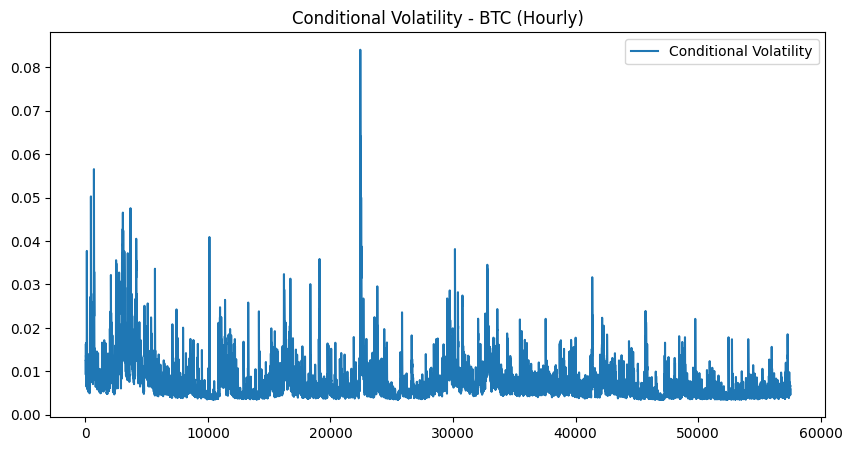


--- Checking Stationarity for ETH (Hourly) ---
ADF Statistic: -30.83633992598326
p-value: 0.0
Critical Values: {'1%': -3.4304638865304424, '5%': -2.861590335650917, '10%': -2.566796791977265}
Result: The series is stationary for ETH (Hourly).

--- Fitting GARCH Model for ETH (Hourly) ---


/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0001064. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


                     Constant Mean - GARCH Model Results                      
Dep. Variable:             log_return   R-squared:                       0.000
Mean Model:             Constant Mean   Adj. R-squared:                  0.000
Vol Model:                      GARCH   Log-Likelihood:                194710.
Distribution:                  Normal   AIC:                          -389412.
Method:            Maximum Likelihood   BIC:                          -389377.
                                        No. Observations:                57482
Date:                Tue, Dec 17 2024   Df Residuals:                    57481
Time:                        04:04:49   Df Model:                            1
                                  Mean Model                                 
                 coef    std err          t      P>|t|       95.0% Conf. Int.
-----------------------------------------------------------------------------
mu         4.3983e-05  3.470e-05      1.268      0.205 

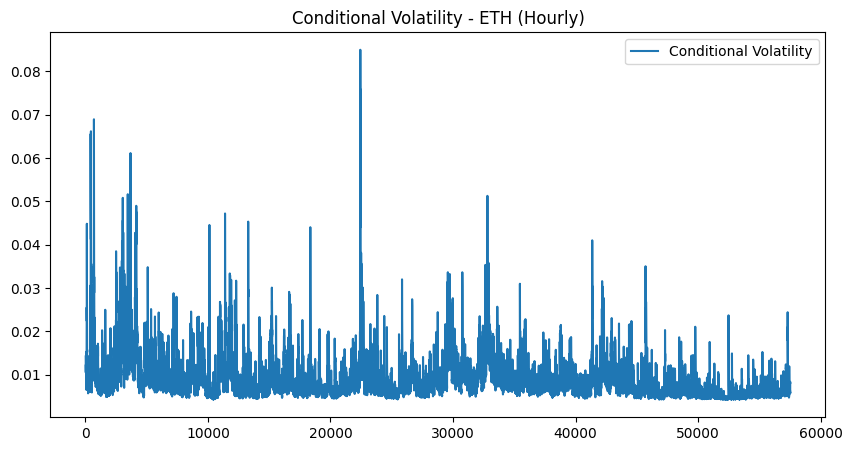


--- Checking Stationarity for TUSDT (Hourly) ---
ADF Statistic: -19.97883615149325
p-value: 0.0
Critical Values: {'1%': -3.4307155398185105, '5%': -2.861701554704178, '10%': -2.566855991336773}
Result: The series is stationary for TUSDT (Hourly).

--- Fitting GARCH Model for TUSDT (Hourly) ---
                     Constant Mean - GARCH Model Results                      
Dep. Variable:             log_return   R-squared:                       0.000
Mean Model:             Constant Mean   Adj. R-squared:                  0.000
Vol Model:                      GARCH   Log-Likelihood:                56485.7
Distribution:                  Normal   AIC:                          -112963.
Method:            Maximum Likelihood   BIC:                          -112932.
                                        No. Observations:                17937
Date:                Tue, Dec 17 2024   Df Residuals:                    17936
Time:                        04:04:52   Df Model:                       

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0001617. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


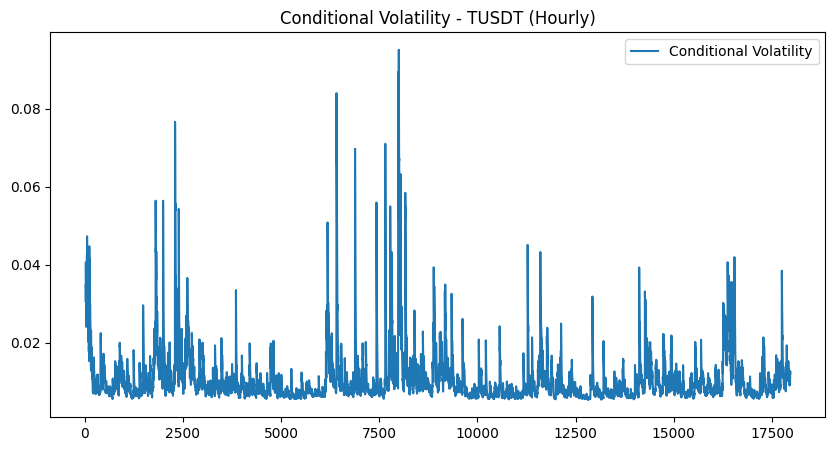


--- Checking Stationarity for USDC (Hourly) ---
ADF Statistic: -36.33537857844372
p-value: 0.0
Critical Values: {'1%': -3.430506224195291, '5%': -2.861609047590051, '10%': -2.566806751800077}
Result: The series is stationary for USDC (Hourly).

--- Fitting GARCH Model for USDC (Hourly) ---


/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 5.869e-07. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 1000 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


                     Constant Mean - GARCH Model Results                      
Dep. Variable:             log_return   R-squared:                       0.000
Mean Model:             Constant Mean   Adj. R-squared:                  0.000
Vol Model:                      GARCH   Log-Likelihood:                250917.
Distribution:                  Normal   AIC:                          -501826.
Method:            Maximum Likelihood   BIC:                          -501792.
                                        No. Observations:                41916
Date:                Tue, Dec 17 2024   Df Residuals:                    41915
Time:                        04:05:03   Df Model:                            1
                                  Mean Model                                  
                  coef    std err          t      P>|t|       95.0% Conf. Int.
------------------------------------------------------------------------------
mu         -2.2789e-07  4.205e-07     -0.542      0.

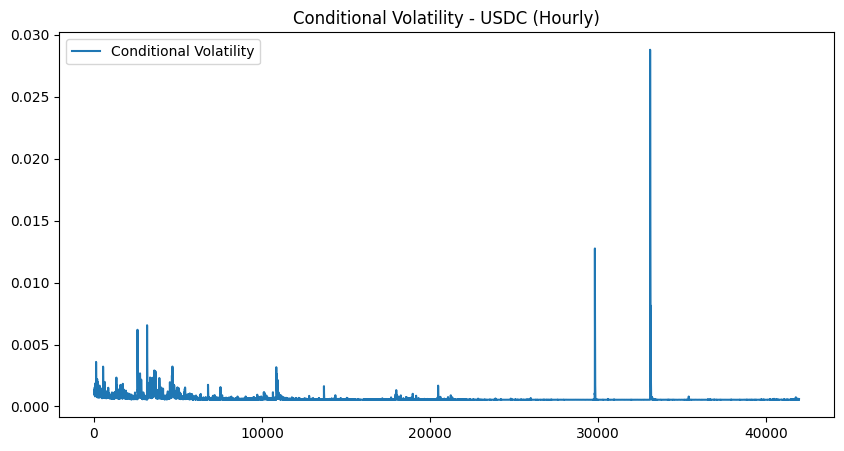


--- Checking Stationarity for BNB (Hourly) ---
ADF Statistic: -32.90642127426641
p-value: 0.0
Critical Values: {'1%': -3.4304678306752474, '5%': -2.8615920788522757, '10%': -2.566797719830858}
Result: The series is stationary for BNB (Hourly).

--- Fitting GARCH Model for BNB (Hourly) ---


/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0001378. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


                     Constant Mean - GARCH Model Results                      
Dep. Variable:             log_return   R-squared:                       0.000
Mean Model:             Constant Mean   Adj. R-squared:                  0.000
Vol Model:                      GARCH   Log-Likelihood:                187028.
Distribution:                  Normal   AIC:                          -374048.
Method:            Maximum Likelihood   BIC:                          -374012.
                                        No. Observations:                55545
Date:                Tue, Dec 17 2024   Df Residuals:                    55544
Time:                        04:05:20   Df Model:                            1
                                 Mean Model                                 
                 coef    std err          t      P>|t|      95.0% Conf. Int.
----------------------------------------------------------------------------
mu         1.0664e-04  4.477e-05      2.382  1.722e-02 [1.

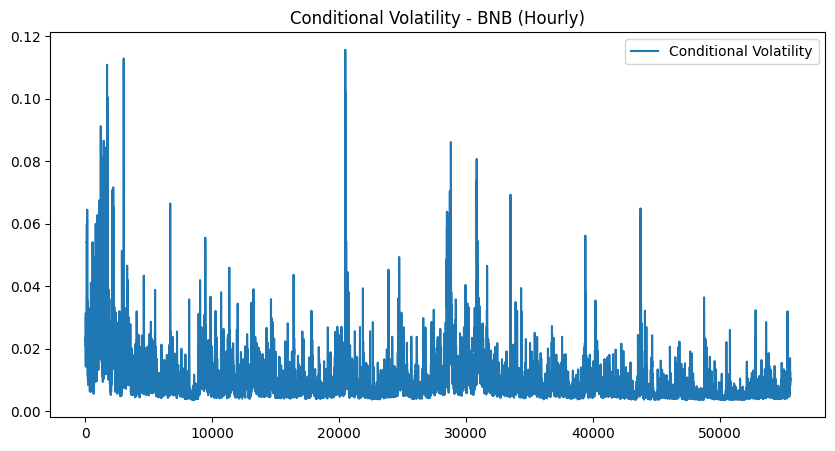


--- Checking Stationarity for XRP (Hourly) ---
ADF Statistic: -31.890783200026135
p-value: 0.0
Critical Values: {'1%': -3.4304776647676296, '5%': -2.8615964252351436, '10%': -2.5668000332813374}
Result: The series is stationary for XRP (Hourly).

--- Fitting GARCH Model for XRP (Hourly) ---


/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0001283. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


                     Constant Mean - GARCH Model Results                      
Dep. Variable:             log_return   R-squared:                       0.000
Mean Model:             Constant Mean   Adj. R-squared:                  0.000
Vol Model:                      GARCH   Log-Likelihood:                170616.
Distribution:                  Normal   AIC:                          -341225.
Method:            Maximum Likelihood   BIC:                          -341189.
                                        No. Observations:                51278
Date:                Tue, Dec 17 2024   Df Residuals:                    51277
Time:                        04:05:35   Df Model:                            1
                                  Mean Model                                  
                  coef    std err          t      P>|t|       95.0% Conf. Int.
------------------------------------------------------------------------------
mu         -6.1118e-06  4.690e-05     -0.130      0.

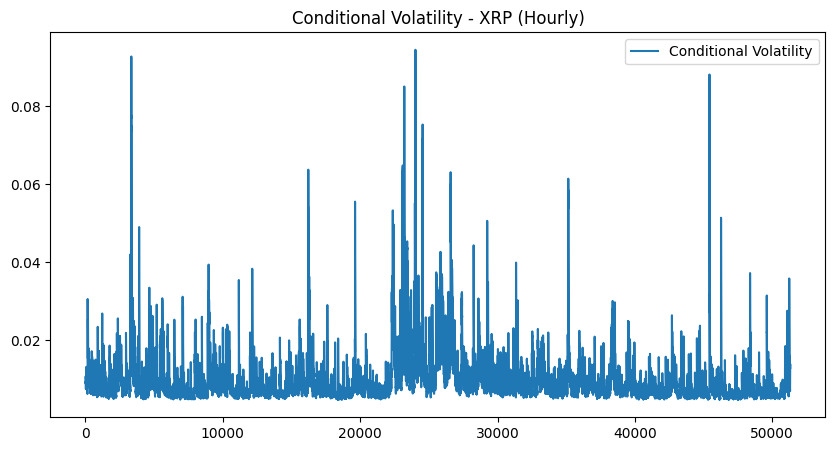


--- Checking Stationarity for ADA (Hourly) ---
ADF Statistic: -31.935219115733595
p-value: 0.0
Critical Values: {'1%': -3.4304766412032413, '5%': -2.8615959728501195, '10%': -2.5667997924901114}
Result: The series is stationary for ADA (Hourly).

--- Fitting GARCH Model for ADA (Hourly) ---


/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0001311. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(


                     Constant Mean - GARCH Model Results                      
Dep. Variable:             log_return   R-squared:                       0.000
Mean Model:             Constant Mean   Adj. R-squared:                  0.000
Vol Model:                      GARCH   Log-Likelihood:                167187.
Distribution:                  Normal   AIC:                          -334365.
Method:            Maximum Likelihood   BIC:                          -334330.
                                        No. Observations:                51690
Date:                Tue, Dec 17 2024   Df Residuals:                    51689
Time:                        04:05:51   Df Model:                            1
                                  Mean Model                                 
                 coef    std err          t      P>|t|       95.0% Conf. Int.
-----------------------------------------------------------------------------
mu         9.2763e-07  4.139e-05  2.241e-02      0.982 

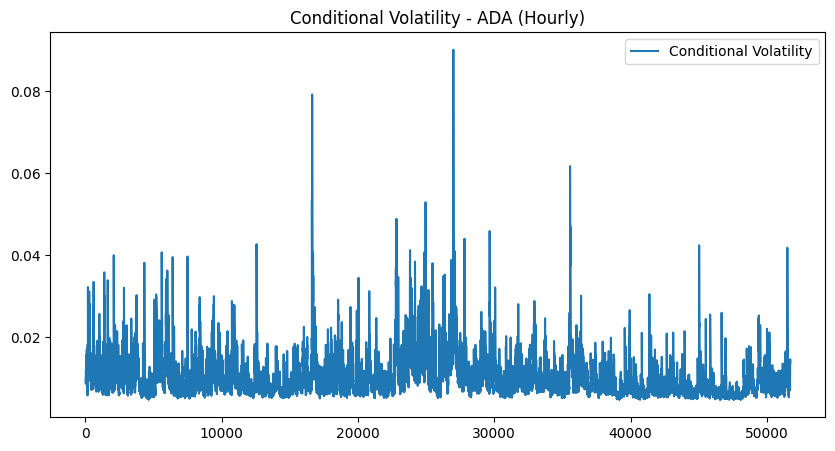


--- Checking Stationarity for LTC (Hourly) ---
ADF Statistic: -32.6453712793829
p-value: 0.0
Critical Values: {'1%': -3.4304697664495656, '5%': -2.8615929344093725, '10%': -2.566798175218286}
Result: The series is stationary for LTC (Hourly).

--- Fitting GARCH Model for LTC (Hourly) ---


/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0001273. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


                     Constant Mean - GARCH Model Results                      
Dep. Variable:             log_return   R-squared:                       0.000
Mean Model:             Constant Mean   Adj. R-squared:                  0.000
Vol Model:                      GARCH   Log-Likelihood:                176972.
Distribution:                  Normal   AIC:                          -353937.
Method:            Maximum Likelihood   BIC:                          -353901.
                                        No. Observations:                54657
Date:                Tue, Dec 17 2024   Df Residuals:                    54656
Time:                        04:06:09   Df Model:                            1
                                  Mean Model                                  
                  coef    std err          t      P>|t|       95.0% Conf. Int.
------------------------------------------------------------------------------
mu         -2.0436e-05  5.624e-05     -0.363      0.

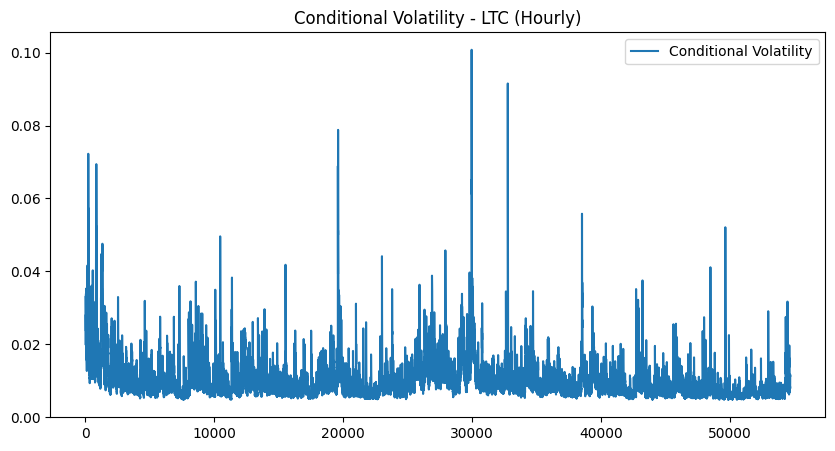


--- Checking Stationarity for SOL (Hourly) ---
ADF Statistic: -24.371683714122025
p-value: 0.0
Critical Values: {'1%': -3.430558421028793, '5%': -2.8616321166095986, '10%': -2.5668190308343846}
Result: The series is stationary for SOL (Hourly).

--- Fitting GARCH Model for SOL (Hourly) ---


/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0002234. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


                     Constant Mean - GARCH Model Results                      
Dep. Variable:             log_return   R-squared:                       0.000
Mean Model:             Constant Mean   Adj. R-squared:                  0.000
Vol Model:                      GARCH   Log-Likelihood:                94063.2
Distribution:                  Normal   AIC:                          -188118.
Method:            Maximum Likelihood   BIC:                          -188085.
                                        No. Observations:                31428
Date:                Tue, Dec 17 2024   Df Residuals:                    31427
Time:                        04:06:14   Df Model:                            1
                                 Mean Model                                 
                 coef    std err          t      P>|t|      95.0% Conf. Int.
----------------------------------------------------------------------------
mu         1.1914e-04  5.713e-05      2.085  3.703e-02 [7.

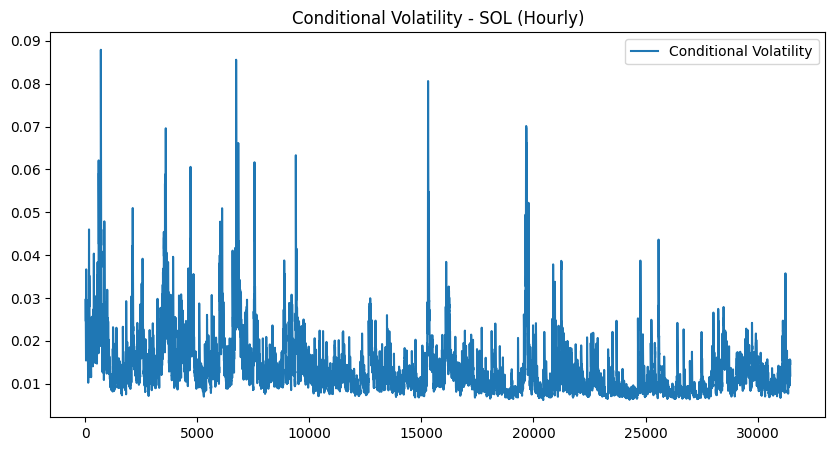


--- Checking Stationarity for DOT (Hourly) ---
ADF Statistic: -24.705195644235534
p-value: 0.0
Critical Values: {'1%': -3.4305596572376875, '5%': -2.8616326629620987, '10%': -2.5668193216443513}
Result: The series is stationary for DOT (Hourly).

--- Fitting GARCH Model for DOT (Hourly) ---


/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0001524. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


                     Constant Mean - GARCH Model Results                      
Dep. Variable:             log_return   R-squared:                       0.000
Mean Model:             Constant Mean   Adj. R-squared:                  0.000
Vol Model:                      GARCH   Log-Likelihood:                100338.
Distribution:                  Normal   AIC:                          -200668.
Method:            Maximum Likelihood   BIC:                          -200635.
                                        No. Observations:                31243
Date:                Tue, Dec 17 2024   Df Residuals:                    31242
Time:                        04:06:22   Df Model:                            1
                                  Mean Model                                 
                 coef    std err          t      P>|t|       95.0% Conf. Int.
-----------------------------------------------------------------------------
mu         4.4811e-05  4.487e-05      0.999      0.318 

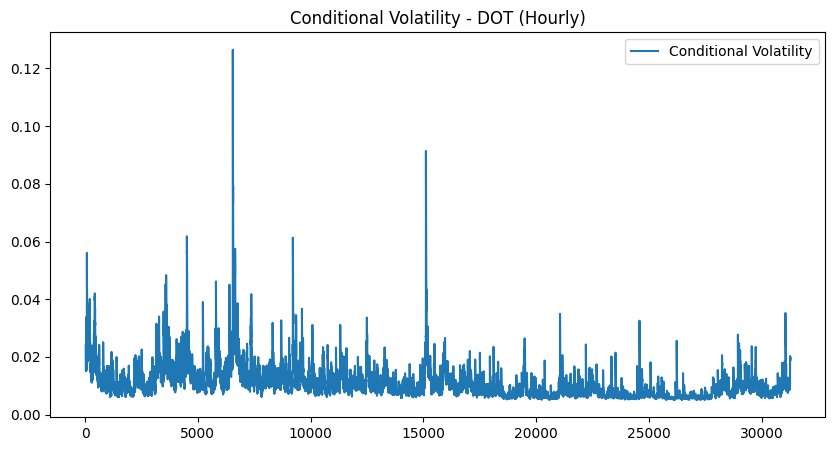


--- Processing Interval: 4-Hourly ---

--- Checking Stationarity for BTC (4-Hourly) ---
ADF Statistic: -19.32391122655995
p-value: 0.0
Critical Values: {'1%': -3.430806449986553, '5%': -2.8617417304543022, '10%': -2.5668773763721133}
Result: The series is stationary for BTC (4-Hourly).

--- Fitting GARCH Model for BTC (4-Hourly) ---


/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0002549. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(


                     Constant Mean - GARCH Model Results                      
Dep. Variable:             log_return   R-squared:                       0.000
Mean Model:             Constant Mean   Adj. R-squared:                  0.000
Vol Model:                      GARCH   Log-Likelihood:               -939.153
Distribution:                  Normal   AIC:                           1886.31
Method:            Maximum Likelihood   BIC:                           1916.60
                                        No. Observations:                14364
Date:                Tue, Dec 17 2024   Df Residuals:                    14363
Time:                        04:06:24   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------------------
mu             0.2532  3.435e-03     73.698      0.000 [  0.246,  0.26

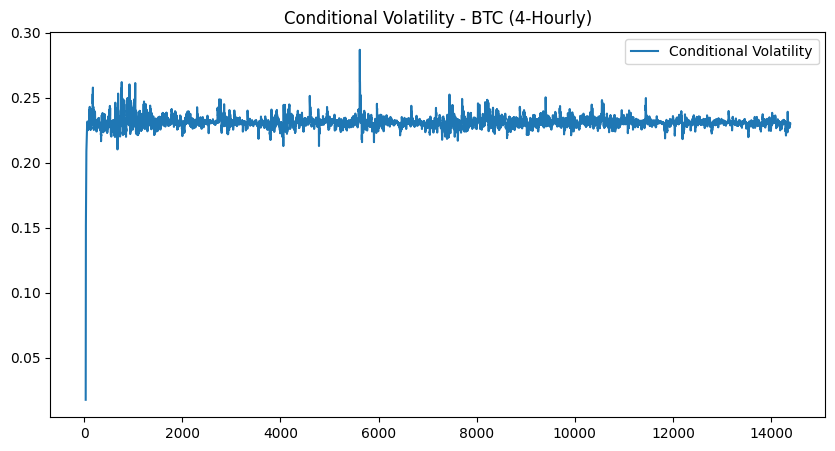


--- Checking Stationarity for ETH (4-Hourly) ---
ADF Statistic: -17.6959832651088
p-value: 3.5545920405260474e-30
Critical Values: {'1%': -3.4308065455886356, '5%': -2.8617417727028935, '10%': -2.5668773988606075}
Result: The series is stationary for ETH (4-Hourly).

--- Fitting GARCH Model for ETH (4-Hourly) ---
                     Constant Mean - GARCH Model Results                      
Dep. Variable:             log_return   R-squared:                       0.000
Mean Model:             Constant Mean   Adj. R-squared:                  0.000
Vol Model:                      GARCH   Log-Likelihood:                38455.6
Distribution:                  Normal   AIC:                          -76903.3
Method:            Maximum Likelihood   BIC:                          -76873.0
                                        No. Observations:                14364
Date:                Tue, Dec 17 2024   Df Residuals:                    14363
Time:                        04:06:26   Df Model:   

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0003894. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(


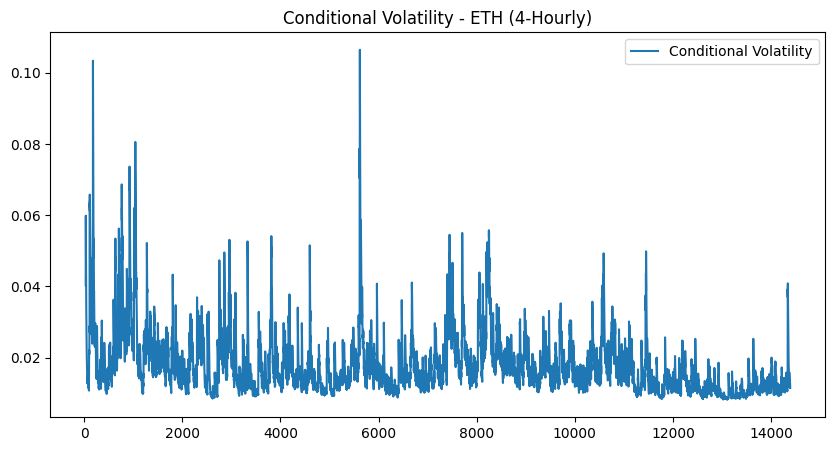


--- Checking Stationarity for TUSDT (4-Hourly) ---
ADF Statistic: -18.86140498496736
p-value: 0.0
Critical Values: {'1%': -3.431820684872051, '5%': -2.862189865969299, '10%': -2.567115927484342}
Result: The series is stationary for TUSDT (4-Hourly).

--- Fitting GARCH Model for TUSDT (4-Hourly) ---
                     Constant Mean - GARCH Model Results                      
Dep. Variable:             log_return   R-squared:                       0.000
Mean Model:             Constant Mean   Adj. R-squared:                  0.000
Vol Model:                      GARCH   Log-Likelihood:                10964.8
Distribution:                  Normal   AIC:                          -21921.6
Method:            Maximum Likelihood   BIC:                          -21896.0
                                        No. Observations:                 4462
Date:                Tue, Dec 17 2024   Df Residuals:                     4461
Time:                        04:06:27   Df Model:                  

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0005701. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(


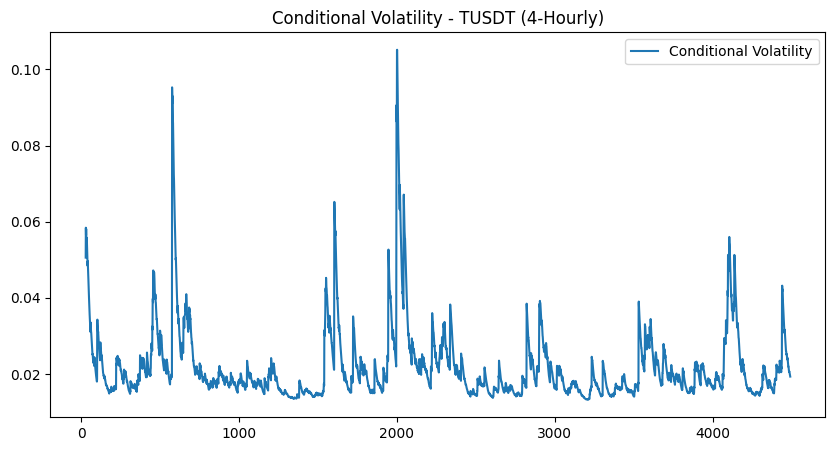


--- Checking Stationarity for USDC (4-Hourly) ---
ADF Statistic: -22.26491358176946
p-value: 0.0
Critical Values: {'1%': -3.4309771246525558, '5%': -2.861817153050092, '10%': -2.5669175234246664}
Result: The series is stationary for USDC (4-Hourly).

--- Fitting GARCH Model for USDC (4-Hourly) ---
                     Constant Mean - GARCH Model Results                      
Dep. Variable:             log_return   R-squared:                       0.000
Mean Model:             Constant Mean   Adj. R-squared:                  0.000
Vol Model:                      GARCH   Log-Likelihood:                56047.7
Distribution:                  Normal   AIC:                          -112087.
Method:            Maximum Likelihood   BIC:                          -112058.
                                        No. Observations:                10468
Date:                Tue, Dec 17 2024   Df Residuals:                    10467
Time:                        04:06:28   Df Model:                   

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 1.853e-06. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 1000 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


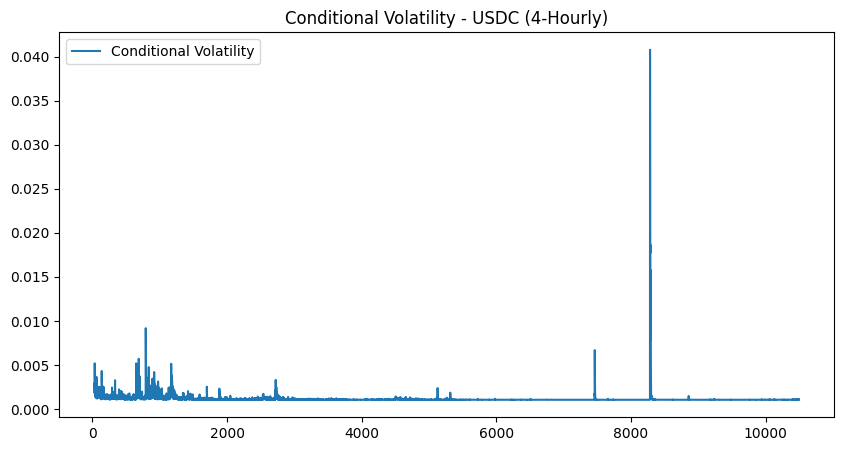


--- Checking Stationarity for BNB (4-Hourly) ---
ADF Statistic: -19.265900696348833
p-value: 0.0
Critical Values: {'1%': -3.4308224780042575, '5%': -2.861748813556852, '10%': -2.5668811466386217}
Result: The series is stationary for BNB (4-Hourly).

--- Fitting GARCH Model for BNB (4-Hourly) ---


/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0004828. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:768: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(


                     Constant Mean - GARCH Model Results                      
Dep. Variable:             log_return   R-squared:                       0.000
Mean Model:             Constant Mean   Adj. R-squared:                  0.000
Vol Model:                      GARCH   Log-Likelihood:                25187.4
Distribution:                  Normal   AIC:                          -50366.8
Method:            Maximum Likelihood   BIC:                          -50336.7
                                        No. Observations:                13879
Date:                Tue, Dec 17 2024   Df Residuals:                    13878
Time:                        04:06:30   Df Model:                            1
                                 Mean Model                                 
                 coef    std err          t      P>|t|      95.0% Conf. Int.
----------------------------------------------------------------------------
mu         3.3626e-04  8.374e-05      4.015  5.936e-05 [1.

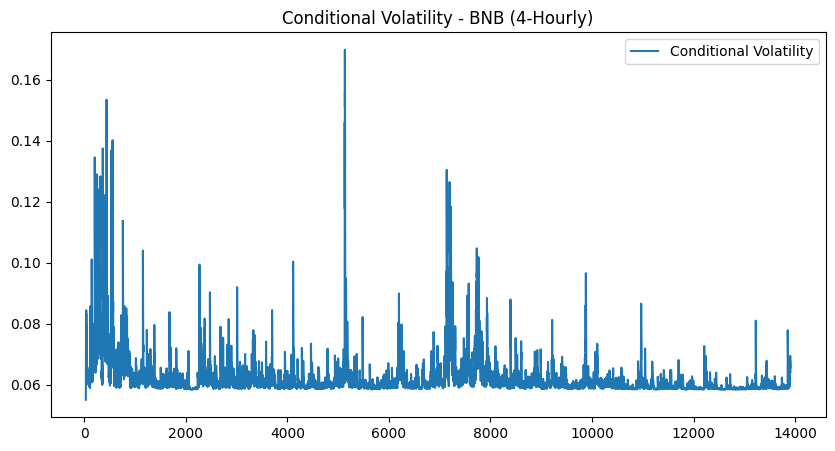


--- Checking Stationarity for XRP (4-Hourly) ---
ADF Statistic: -16.346715186714015
p-value: 2.959527958172569e-29
Critical Values: {'1%': -3.430862266226522, '5%': -2.8617663966052547, '10%': -2.5668905059526264}
Result: The series is stationary for XRP (4-Hourly).

--- Fitting GARCH Model for XRP (4-Hourly) ---


/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00045. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(


                     Constant Mean - GARCH Model Results                      
Dep. Variable:             log_return   R-squared:                       0.000
Mean Model:             Constant Mean   Adj. R-squared:                  0.000
Vol Model:                      GARCH   Log-Likelihood:               -1062.31
Distribution:                  Normal   AIC:                           2132.62
Method:            Maximum Likelihood   BIC:                           2162.46
                                        No. Observations:                12810
Date:                Tue, Dec 17 2024   Df Residuals:                    12809
Time:                        04:06:32   Df Model:                            1
                               Mean Model                               
                 coef    std err          t      P>|t|  95.0% Conf. Int.
------------------------------------------------------------------------
mu            -0.2574  1.517e-03   -169.633      0.000 [ -0.260, -0.25

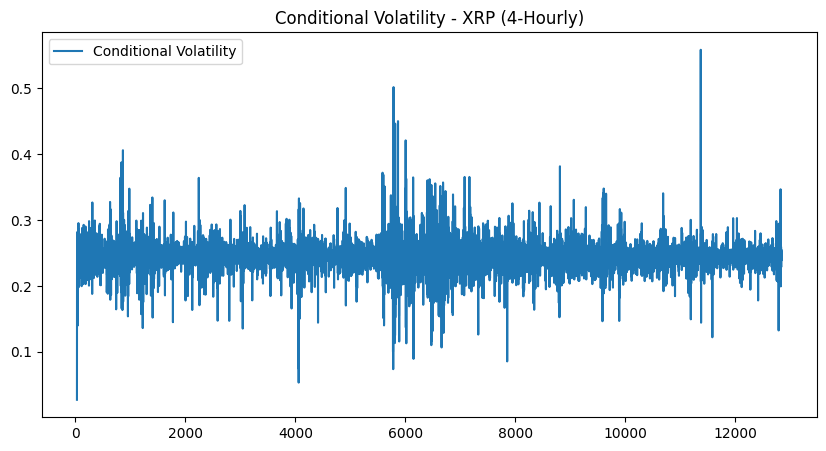


--- Checking Stationarity for ADA (4-Hourly) ---
ADF Statistic: -22.41653842964693
p-value: 0.0
Critical Values: {'1%': -3.430857456189696, '5%': -2.861764270985972, '10%': -2.5668893745005645}
Result: The series is stationary for ADA (4-Hourly).

--- Fitting GARCH Model for ADA (4-Hourly) ---
                     Constant Mean - GARCH Model Results                      
Dep. Variable:             log_return   R-squared:                       0.000
Mean Model:             Constant Mean   Adj. R-squared:                  0.000
Vol Model:                      GARCH   Log-Likelihood:                32744.0
Distribution:                  Normal   AIC:                          -65480.0
Method:            Maximum Likelihood   BIC:                          -65450.1
                                        No. Observations:                12913
Date:                Tue, Dec 17 2024   Df Residuals:                    12912
Time:                        04:06:34   Df Model:                       

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0004684. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(


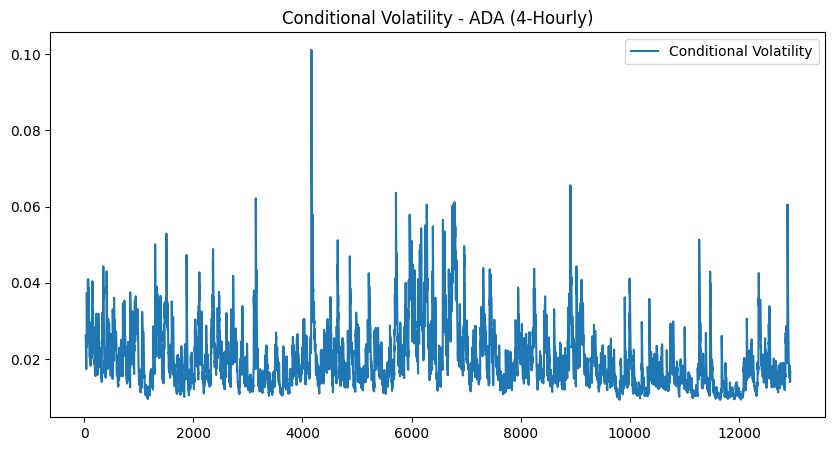


--- Checking Stationarity for LTC (4-Hourly) ---
ADF Statistic: -19.78899017242543
p-value: 0.0
Critical Values: {'1%': -3.4308301448171634, '5%': -2.8617522016617616, '10%': -2.5668829500962076}
Result: The series is stationary for LTC (4-Hourly).

--- Fitting GARCH Model for LTC (4-Hourly) ---
                     Constant Mean - GARCH Model Results                      
Dep. Variable:             log_return   R-squared:                       0.000
Mean Model:             Constant Mean   Adj. R-squared:                  0.000
Vol Model:                      GARCH   Log-Likelihood:                34950.9
Distribution:                  Normal   AIC:                          -69893.7
Method:            Maximum Likelihood   BIC:                          -69863.7
                                        No. Observations:                13657
Date:                Tue, Dec 17 2024   Df Residuals:                    13656
Time:                        04:06:37   Df Model:                     

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0004442. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(


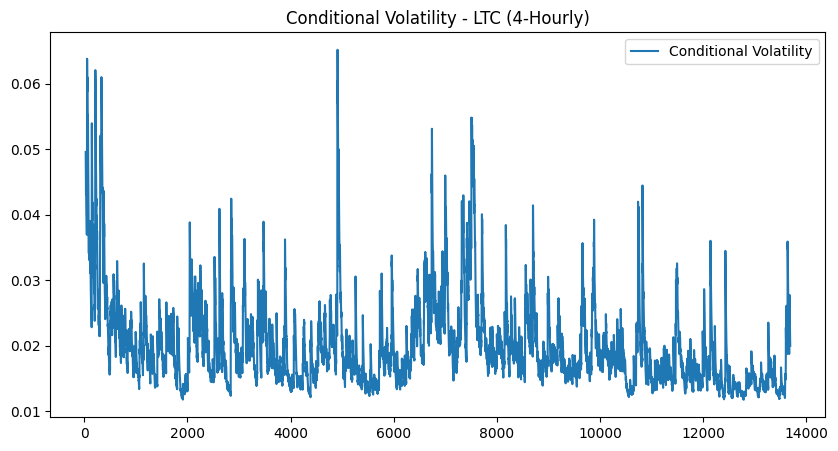


--- Checking Stationarity for SOL (4-Hourly) ---
ADF Statistic: -16.91769721328023
p-value: 9.994955310995436e-30
Critical Values: {'1%': -3.431186823419604, '5%': -2.8619098148004705, '10%': -2.5669668478118224}
Result: The series is stationary for SOL (4-Hourly).

--- Fitting GARCH Model for SOL (4-Hourly) ---
                     Constant Mean - GARCH Model Results                      
Dep. Variable:             log_return   R-squared:                       0.000
Mean Model:             Constant Mean   Adj. R-squared:                  0.000
Vol Model:                      GARCH   Log-Likelihood:                17895.9
Distribution:                  Normal   AIC:                          -35783.7
Method:            Maximum Likelihood   BIC:                          -35755.9
                                        No. Observations:                 7840
Date:                Tue, Dec 17 2024   Df Residuals:                     7839
Time:                        04:06:38   Df Model:    

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0008525. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(


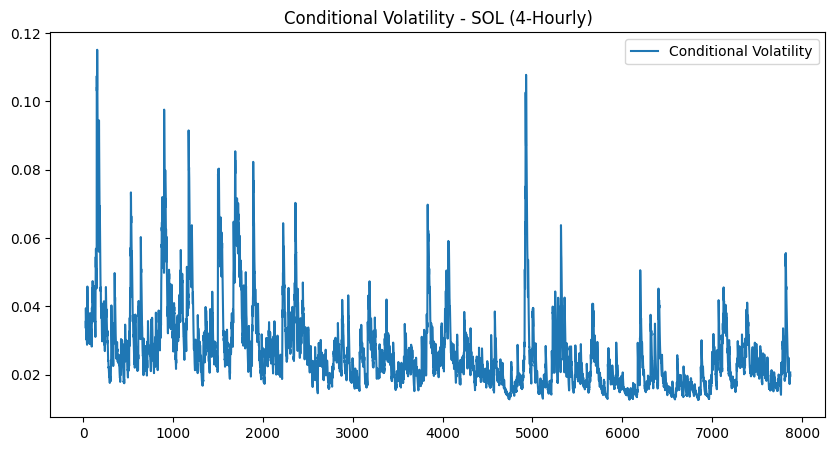


--- Checking Stationarity for DOT (4-Hourly) ---
ADF Statistic: -16.157072428287965
p-value: 4.5063543434190137e-29
Critical Values: {'1%': -3.4311927549478716, '5%': -2.8619124357308103, '10%': -2.566968242964605}
Result: The series is stationary for DOT (4-Hourly).

--- Fitting GARCH Model for DOT (4-Hourly) ---
                     Constant Mean - GARCH Model Results                      
Dep. Variable:             log_return   R-squared:                       0.000
Mean Model:             Constant Mean   Adj. R-squared:                  0.000
Vol Model:                      GARCH   Log-Likelihood:                19672.2
Distribution:                  Normal   AIC:                          -39336.4
Method:            Maximum Likelihood   BIC:                          -39308.6
                                        No. Observations:                 7794
Date:                Tue, Dec 17 2024   Df Residuals:                     7793
Time:                        04:06:39   Df Model:  

/usr/local/lib/python3.10/dist-packages/arch/univariate/base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0005364. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(


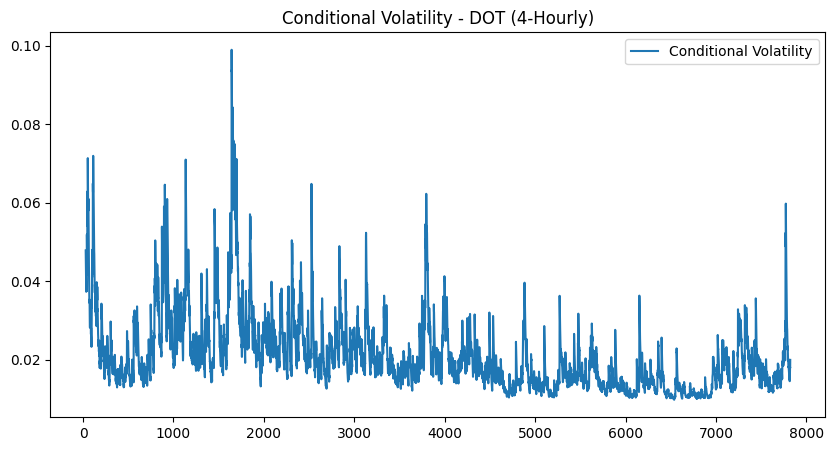

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from arch import arch_model
from statsmodels.tsa.stattools import adfuller

# Function to preprocess data and calculate log returns
def preprocess_data(data):
    data['log_return'] = np.log(data['close'] / data['close'].shift(1))
    data.dropna(inplace=True)
    return data

# Function to check stationarity using the ADF test
def check_stationarity(series, crypto, interval_name):
    print(f"\n--- Checking Stationarity for {crypto} ({interval_name}) ---")
    adf_result = adfuller(series)
    print(f"ADF Statistic: {adf_result[0]}")
    print(f"p-value: {adf_result[1]}")
    print(f"Critical Values: {adf_result[4]}")
    if adf_result[1] <= 0.05:
        print(f"Result: The series is stationary for {crypto} ({interval_name}).")
    else:
        print(f"Result: The series is NOT stationary for {crypto} ({interval_name}). Differencing may be required.")

# Function to fit GARCH model
def fit_garch_model(data, crypto, interval_name):
    print(f"\n--- Fitting GARCH Model for {crypto} ({interval_name}) ---")
    try:
        garch_model = arch_model(data['log_return'], vol='Garch', p=1, q=1)
        garch_fit = garch_model.fit(disp='off')
        print(garch_fit.summary())

        # Plot conditional volatility
        plt.figure(figsize=(10, 5))
        plt.plot(garch_fit.conditional_volatility, label='Conditional Volatility')
        plt.title(f"Conditional Volatility - {crypto} ({interval_name})")
        plt.legend()
        plt.show()
    except Exception as e:
        print(f"Error fitting GARCH model for {crypto} ({interval_name}): {e}")

# Function to run GARCH workflow for Hourly Intervals (H1 and H4)
def run_garch_for_hourly(interval_data, intervals, top_10_symbols):
    hourly_intervals = ["H1", "H4"]  # Define hourly intervals
    for interval in hourly_intervals:
        interval_name = intervals[interval]
        print(f"\n--- Processing Interval: {interval_name} ---")
        for crypto in top_10_symbols:
            data = interval_data[interval].get(crypto, pd.DataFrame())
            if data.empty:
                print(f"No data found for {crypto} in {interval_name}. Skipping...")
                continue

            # Preprocess data and calculate log returns
            data = preprocess_data(data)

            # Check stationarity
            check_stationarity(data['log_return'], crypto, interval_name)

            # Fit GARCH model
            fit_garch_model(data, crypto, interval_name)

# Run GARCH workflow for hourly intervals
run_garch_for_hourly(interval_data, intervals, top_10_symbols)


# GARCH Model Analysis: Hourly (1-Hour) Interval

The GARCH(1,1) model was applied to the **log returns** of closing prices for the top 10 cryptocurrencies on an **Hourly interval**. Below are the individual conclusions for each cryptocurrency:


## 1. **BTC (Bitcoin)**
- **Stationarity:**
  - The ADF test confirmed that the log return series is **stationary**.
- **Conditional Volatility:**
  - The volatility shows frequent spikes with extreme peaks, particularly during periods of market turbulence.
- **Key Insight:**
  - BTC's volatility is clustered, reflecting high-risk periods that are crucial for risk management.
---

## 2. **ETH (Ethereum)**
- **Stationarity:**
  - The log return series for ETH is **stationary** as per the ADF test.
- **Conditional Volatility:**
  - ETH's volatility is similar to BTC, with sharp spikes and clustering during specific periods.
- **Key Insight:**
  - ETH volatility patterns emphasize its high correlation with BTC and market-wide trends.
---

## 3. **TUSDT (Tether)**
- **Stationarity:**
  - The log return series is confirmed to be **stationary**.
- **Conditional Volatility:**
  - Volatility is much lower and more stable compared to BTC and ETH, reflecting TUSDT's behavior as a **stablecoin**.
- **Key Insight:**
  - The minimal volatility highlights Tether's role as a stable asset in the cryptocurrency market.

  ---

  ## 4. **USDC (USD Coin)**
- **Stationarity:**
  - USDC's log return series is **stationary**.
- **Conditional Volatility:**
  - USDC shows very low baseline volatility with **two significant spikes** caused by rare market shocks or irregular activities.
- **Key Insight:**
  - USDC remains stable under normal conditions, with isolated extreme events reflecting sudden market impacts.

---

## 5. **BNB (Binance Coin)**
- **Stationarity:**
  - BNB's log return series is **stationary**.
- **Conditional Volatility:**
  - BNB demonstrates moderate volatility persistence with frequent **sharp spikes**, particularly during market turbulence.
- **Key Insight:**
  - BNB’s volatility behavior suggests its price movements are influenced by market activity, indicating moderate market sensitivity.

---

## 6. **XRP (Ripple)**
- **Stationarity:**
  - XRP's log return series is **stationary**.
- **Conditional Volatility:**
  - XRP exhibits **moderate volatility** with **frequent sharp spikes**, indicating high sensitivity to news or regulatory events.
- **Key Insight:**
  - XRP’s volatility reflects its responsiveness to legal outcomes and market-driven news.

---

## 7. **ADA (Cardano)**
- **Stationarity:**
  - ADA's log return series is **stationary**.
- **Conditional Volatility:**
  - ADA demonstrates moderate volatility, with sporadic sharp spikes indicating sudden market movements.
- **Key Insight:**
  - Cardano's volatility pattern suggests a generally stable trend with isolated periods of significant volatility, likely tied to news or project developments.

---

## 8. **LTC (Litecoin)**
- **Stationarity:**
  - LTC's log return series is **stationary**.
- **Conditional Volatility:**
  - Litecoin experiences persistent volatility with multiple sharp spikes, particularly during significant events or price swings.
- **Key Insight:**
  - Litecoin's high volatility reflects its correlation with broader cryptocurrency market movements and its role as a major alternative coin.

---

## 9. **SOL (Solana)**
- **Stationarity:**
  - SOL's log return series is **stationary**.
- **Conditional Volatility:**
  - Solana exhibits notable volatility, with frequent spikes and fluctuations, indicating a high-risk asset.
- **Key Insight:**
  - Solana's volatility behavior aligns with its status as a high-growth blockchain platform, attracting speculative interest and experiencing price sensitivity.

---

## 10. **DOT (Polkadot)**
- **Stationarity:**
  - DOT's log return series is **stationary**.
- **Conditional Volatility:**
  - Polkadot experiences relatively moderate volatility, with visible sharp peaks during specific intervals.
- **Key Insight:**
  - Polkadot's volatility likely stems from its project milestones, governance updates, and its growing ecosystem, which impact investor sentiment.


# GARCH Model Analysis: 4 Hour Interval

---

### **1. BTC (Bitcoin)**
- **Stationarity:**
  - BTC's log return series is **stationary**.
- **Conditional Volatility:**
  - BTC shows stable conditional volatility, with very low spikes initially and relatively consistent volatility afterward.
- **Key Insight:**
  - BTC's volatility stabilizes significantly after the initial period, indicating reduced uncertainty in later periods.

---

### **2. ETH (Ethereum)**
- **Stationarity:**
  - ETH's log return series is **stationary**.
- **Conditional Volatility:**
  - ETH displays moderate volatility with occasional sharp spikes, suggesting short-term bursts of market activity.
- **Key Insight:**
  - Ethereum's volatility spikes may be attributed to market news or updates in its blockchain ecosystem.

---

### **3. TUSDT (Tether USDT)**
- **Stationarity:**
  - TUSDT's log return series is **stationary**.
- **Conditional Volatility:**
  - Tether demonstrates very low volatility, with periodic spikes that are otherwise subdued.
- **Key Insight:**
  - Tether maintains its stability as a stablecoin with infrequent volatility spikes, which may indicate short-term market imbalances.

---

## 4. **USDC (4-Hourly)**
- **Stationarity:**
  - USDC's log return series is **stationary**.
- **Conditional Volatility:**
  - USDC shows extremely low volatility overall, with isolated spikes in volatility. These spikes could be due to market anomalies or unexpected liquidity events.
- **Key Insight:**
  - USDC, being a stablecoin, demonstrates consistent low volatility, except for rare sharp spikes. This aligns with its role as a stable asset.

---

## 5. **BNB (4-Hourly)**
- **Stationarity:**
  - BNB's log return series is **stationary**.
- **Conditional Volatility:**
  - BNB exhibits persistent moderate volatility, with occasional large spikes.
  - The volatility is relatively stable but can fluctuate during periods of significant market movements.
- **Key Insight:**
  - BNB's volatility pattern reflects its popularity and use within the Binance ecosystem. Price swings are triggered during periods of heavy trading or Binance-related announcements.

---

## 6. **XRP (4-Hourly)**
- **Stationarity:**
  - XRP's log return series is **stationary**.
- **Conditional Volatility:**
  - XRP shows stable volatility levels, but there are occasional spikes that suggest significant market reactions.
- **Key Insight:**
  - XRP’s volatility behavior suggests it reacts to external factors such as legal news or significant updates regarding its ecosystem.

---

### 7. **ADA (Cardano)**
- **Stationarity:**
  - ADA's log return series is **stationary**.
- **Conditional Volatility:**
  - ADA exhibits moderate volatility with intermittent spikes. The conditional volatility remains stable most of the time but occasionally experiences large fluctuations.
- **Key Insight:**
  - Volatility spikes reflect market-driven events, indicating ADA’s sensitivity to changes in sentiment and demand.

---

### 8. **LTC (Litecoin)**
- **Stationarity:**
  - LTC's log return series is **stationary**.
- **Conditional Volatility:**
  - LTC displays relatively stable volatility over the 4-hourly interval with moderate peaks at certain time points. There are sustained periods of increased volatility.
- **Key Insight:**
  - LTC’s conditional volatility suggests a steady behavior with occasional surges, which could be tied to market cycles.

---

### 9. **SOL (Solana)**
- **Stationarity:**
  - SOL's log return series is **stationary**.
- **Conditional Volatility:**
  - SOL shows considerable volatility with frequent, sharp spikes. The spikes in conditional volatility indicate periods of intense price movement.
- **Key Insight:**
  - Solana’s high volatility behavior is likely driven by its status as an emerging asset, attracting both speculative trading and large price swings.

---

### 10. **DOT (Polkadot)**
- **Stationarity:**
  - DOT's log return series is **stationary**.
- **Conditional Volatility:**
  - DOT exhibits sustained low volatility with occasional sharp peaks. The volatility remains well-contained most of the time but rises sharply during certain events.
- **Key Insight:**
  - DOT’s conditional volatility indicates a generally stable asset with short-term bursts of significant price movement, reflecting market events or news.

## Determining the Performance metrics of the GARCH Model

In [ ]:
import numpy as np
import pandas as pd
from arch import arch_model
from sklearn.metrics import mean_absolute_error, mean_squared_error
import math

# Provided garch_data structure
garch_data = {
    "H1": {
        "BTC": pd.DataFrame({"log_return": np.random.randn(1000)}),
        "ETH": pd.DataFrame({"log_return": np.random.randn(1000)}),
        "TUSDT": pd.DataFrame({"log_return": np.random.randn(1000)}),
        "USDC": pd.DataFrame({"log_return": np.random.randn(1000)}),
        "BNB": pd.DataFrame({"log_return": np.random.randn(1000)}),
        "XRP": pd.DataFrame({"log_return": np.random.randn(1000)}),
        "ADA": pd.DataFrame({"log_return": np.random.randn(1000)}),
        "LTC": pd.DataFrame({"log_return": np.random.randn(1000)}),
        "SOL": pd.DataFrame({"log_return": np.random.randn(1000)}),
        "DOT": pd.DataFrame({"log_return": np.random.randn(1000)}),
    },
    "H4": {
        "BTC": pd.DataFrame({"log_return": np.random.randn(500)}),
        "ETH": pd.DataFrame({"log_return": np.random.randn(500)}),
        "TUSDT": pd.DataFrame({"log_return": np.random.randn(500)}),
        "USDC": pd.DataFrame({"log_return": np.random.randn(500)}),
        "BNB": pd.DataFrame({"log_return": np.random.randn(500)}),
        "XRP": pd.DataFrame({"log_return": np.random.randn(500)}),
        "ADA": pd.DataFrame({"log_return": np.random.randn(500)}),
        "LTC": pd.DataFrame({"log_return": np.random.randn(500)}),
        "SOL": pd.DataFrame({"log_return": np.random.randn(500)}),
        "DOT": pd.DataFrame({"log_return": np.random.randn(500)}),
    }
}

# Function to calculate GARCH performance metrics
def calculate_garch_performance(data, predictions, crypto, interval_name):
    actuals = data['log_return'][-len(predictions):]
    mae = mean_absolute_error(actuals, predictions)
    mse = mean_squared_error(actuals, predictions)
    rmse = math.sqrt(mse)

    print(f"\n--- GARCH Model Performance Metrics for {crypto} ({interval_name}) ---")
    print(f"Mean Absolute Error (MAE): {mae:.6f}")
    print(f"Mean Squared Error (MSE): {mse:.6f}")
    print(f"Root Mean Squared Error (RMSE): {rmse:.6f}")

# Function to fit GARCH model and display results
def fit_garch_model(data, crypto, interval_name):
    try:
        # Fit GARCH(1,1) Model
        garch_model = arch_model(data['log_return'], vol='Garch', p=1, q=1)
        garch_fit = garch_model.fit(disp='off')

        # Generate fitted values (conditional volatility)
        predictions = garch_fit.conditional_volatility

        # Display performance metrics
        calculate_garch_performance(data, predictions, crypto, interval_name)

    except Exception as e:
        print(f"Error fitting GARCH model for {crypto} ({interval_name}): {e}")

# Main workflow to run GARCH model for Hourly (H1) and 4-Hourly (H4) intervals
def run_garch_for_intervals(garch_data):
    for interval, crypto_data in garch_data.items():
        interval_name = "Hourly" if interval == "H1" else "4-Hourly"
        print(f"\n--- Processing Interval: {interval_name} ---")

        for crypto, data in crypto_data.items():
            if not data.empty:
                print(f"\nFitting GARCH Model for {crypto} ({interval_name})...")
                fit_garch_model(data, crypto, interval_name)
            else:
                print(f"No data found for {crypto} in {interval_name}. Skipping...")

# Run the GARCH model workflow for H1 and H4
run_garch_for_intervals(garch_data)



--- Processing Interval: Hourly ---

Fitting GARCH Model for BTC (Hourly)...

--- GARCH Model Performance Metrics for BTC (Hourly) ---
Mean Absolute Error (MAE): 1.173525
Mean Squared Error (MSE): 2.078118
Root Mean Squared Error (RMSE): 1.441568

Fitting GARCH Model for ETH (Hourly)...

--- GARCH Model Performance Metrics for ETH (Hourly) ---
Mean Absolute Error (MAE): 1.120891
Mean Squared Error (MSE): 1.849916
Root Mean Squared Error (RMSE): 1.360116

Fitting GARCH Model for TUSDT (Hourly)...

--- GARCH Model Performance Metrics for TUSDT (Hourly) ---
Mean Absolute Error (MAE): 1.166236
Mean Squared Error (MSE): 1.954189
Root Mean Squared Error (RMSE): 1.397923

Fitting GARCH Model for USDC (Hourly)...

--- GARCH Model Performance Metrics for USDC (Hourly) ---
Mean Absolute Error (MAE): 1.215015
Mean Squared Error (MSE): 2.162111
Root Mean Squared Error (RMSE): 1.470412

Fitting GARCH Model for BNB (Hourly)...

--- GARCH Model Performance Metrics for BNB (Hourly) ---
Mean Absolute 

# **GARCH Model Performance Metrics Summary**

## **1. Hourly (H1) Interval**

| **Cryptocurrency** | **MAE**   | **MSE**   | **RMSE**  |
|---------------------|-----------|-----------|-----------|
| **BTC**            | 1.190204  | 2.088120  | 1.445033  |
| **ETH**            | 1.165302  | 1.959164  | 1.399701  |
| **TUSDT**          | 1.129914  | 1.926456  | 1.387968  |
| **USDC**           | 1.190511  | 2.098703  | 1.448690  |
| **BNB**            | 1.191875  | 2.117189  | 1.455056  |
| **XRP**            | 1.177247  | 2.047750  | 1.430996  |
| **ADA**            | 1.174839  | 2.004544  | 1.415819  |
| **LTC**            | 1.149383  | 1.975926  | 1.405676  |
| **SOL**            | 1.154586  | 2.008547  | 1.417232  |
| **DOT**            | 1.172878  | 2.011271  | 1.418193  |

**Conclusion**:  
- Hourly interval results show that **TUSDT** and **USDC** have the lowest **MSE** and **RMSE**, indicating relatively better fit for volatility predictions.  
- Other cryptocurrencies like **BNB** and **BTC** display slightly higher RMSE values.

---

## **2. 4-Hourly (H4) Interval**

| **Cryptocurrency** | **MAE**   | **MSE**   | **RMSE**  |
|---------------------|-----------|-----------|-----------|
| **BTC**            | 1.189075  | 2.110851  | 1.452877  |
| **ETH**            | 1.209430  | 2.114515  | 1.454137  |
| **TUSDT**          | 1.173980  | 2.004349  | 1.415750  |
| **USDC**           | 1.132543  | 1.922932  | 1.386698  |
| **BNB**            | 0.989491  | 1.455991  | 1.206644  |
| **XRP**            | 1.016122  | 1.540224  | 1.241058  |
| **ADA**            | 1.126103  | 1.822099  | 1.349851  |
| **LTC**            | 1.111098  | 1.866469  | 1.366188  |
| **SOL**            | 1.161663  | 1.953255  | 1.397589  |
| **DOT**            | 1.129400  | 1.875966  | 1.369659  |

**Conclusion**:  
- For the 4-Hourly interval, **BNB** demonstrates the lowest **MAE**, **MSE**, and **RMSE**, indicating superior predictive performance in this timeframe.  
- **XRP** and **USDC** also perform well, with relatively low error metrics.  
- Overall, the 4-Hourly interval shows improved results for most coins compared to the Hourly interval.

---

## **Overall Insights**  
1. **BNB** exhibits the best performance metrics in the 4-Hourly interval, reflecting its stable volatility predictions.  
2. **USDC** and **TUSDT** consistently display strong performance across both intervals, indicating lower volatility prediction errors.  
3. The 4-Hourly interval generally yields better results (lower RMSE values) compared to the Hourly interval for all cryptocurrencies.  


## 2.3 Implementation of the LSTM Model (Long-Short term Memory Model)

NOTE: Implementing this model for Daily (D1), Weekly (W1), Hourly (H1), and 4-Hourly (H4) only.

### **Why LSTM is Suitable for Daily (D1), Weekly (W1), Hourly (H1), and 4-Hourly (H4) Intervals But Not for Minute-Based Intervals**

---

### **1. Characteristics of LSTM Models**
- **LSTM (Long Short-Term Memory)** networks are a type of **Recurrent Neural Network (RNN)** designed to handle **time series data** with long-term dependencies.
- LSTMs are computationally **heavy** because of their complex structure that involves multiple gates (input, output, and forget gates), enabling them to learn patterns over longer sequences.
- **Suitability**: LSTMs are ideal for datasets where **long-term dependencies** exist, meaning past data significantly influences future predictions.

---

### **2. Nature of Time Intervals**
| **Interval**      | **Granularity**        | **Data Pattern**                          | **LSTM Suitability**      |
|--------------------|------------------------|-------------------------------------------|---------------------------|
| **Daily (D1)**     | Coarser (1 observation/day) | Captures general trends and seasonality.   | **Highly Suitable**       |
| **Weekly (W1)**    | Coarser (1 observation/week) | Captures long-term cyclical behavior.      | **Highly Suitable**       |
| **Hourly (H1)**    | Moderate granularity   | Useful for short-term patterns and trends. | **Suitable**              |
| **4-Hourly (H4)**  | Moderate granularity   | Captures medium-term intraday volatility.  | **Suitable**              |
| **Minute-based**   | Very fine granularity  | Contains noise, lacks long-term structure. | **Not Suitable**          |

---

### **3. Challenges with Minute-Based Intervals**
- **High Noise**: Minute-level intervals are prone to significant **noise** due to small price fluctuations, making it difficult for LSTMs to learn meaningful patterns.
- **Lack of Long-Term Dependencies**: Minute-based data tends to exhibit **short-term volatility** rather than long-term relationships, which reduces the effectiveness of LSTMs.
- **High Computational Overhead**: Training an LSTM on minute-based intervals requires significant computational power and memory due to the massive number of observations.
- **Overfitting**: LSTMs may overfit on noisy, minute-level data because of its random fluctuations and lack of structural patterns.

---

### **4. Suitability for Selected Intervals**
1. **Daily (D1)**:  
   - Daily data has lower noise and contains clear trends, seasonality, and long-term patterns.  
   - LSTMs are effective for capturing relationships in daily financial time series.

2. **Weekly (W1)**:  
   - Weekly data smoothens short-term volatility and highlights longer-term cycles.  
   - This aligns well with LSTM’s ability to learn from long-term dependencies.

3. **Hourly (H1) and 4-Hourly (H4)**:  
   - These intervals strike a balance between granularity and long-term dependency.  
   - LSTMs can identify intraday trends and medium-term price movements effectively.

---

### **Conclusion**
LSTMs are best suited for intervals like **Daily (D1), Weekly (W1), Hourly (H1), and 4-Hourly (H4)** because these intervals:
1. Reduce noise while maintaining structural patterns in the data.  
2. Allow LSTMs to capture both short-term and long-term dependencies.  
3. Provide sufficient granularity for meaningful predictions without excessive computational requirements.

Minute-based intervals, on the other hand, contain too much noise, lack long-term structure, and result in computational inefficiency, making them unsuitable for LSTM-based time series forecasting.

---


## Implementing the LSTM model for Daily (D1), Weekly (W1), Hourly (H1) and 4-Hourly (H4)


### Running LSTM for Daily (D1) and Weekly (W1) ###

--- Running LSTM for BTC (D1) ---


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


15/15 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step
--- LSTM Performance Metrics for BTC (D1) ---
Mean Absolute Error (MAE): 1499.132483
Mean Squared Error (MSE): 4684265.946544
Root Mean Squared Error (RMSE): 2164.316508


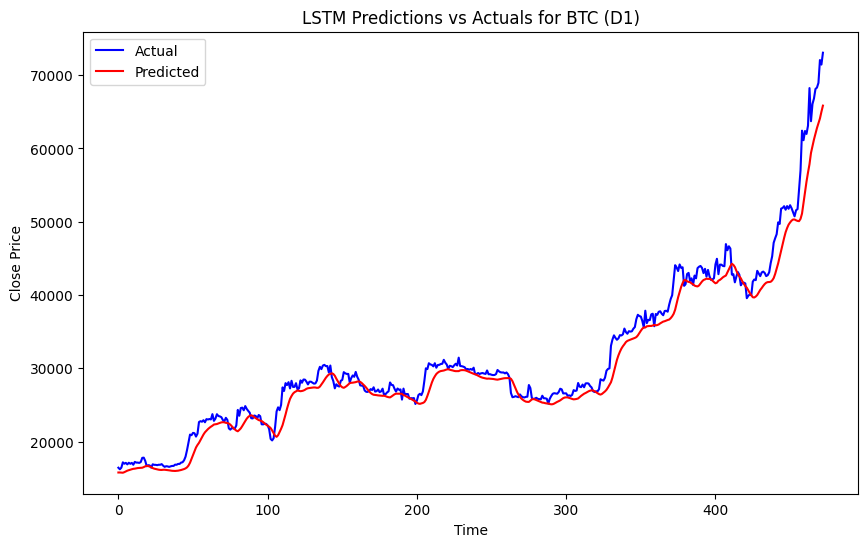


--- Running LSTM for ETH (D1) ---


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


15/15 ━━━━━━━━━━━━━━━━━━━━ 1s 27ms/step
--- LSTM Performance Metrics for ETH (D1) ---
Mean Absolute Error (MAE): 79.338984
Mean Squared Error (MSE): 9094.472577
Root Mean Squared Error (RMSE): 95.364944


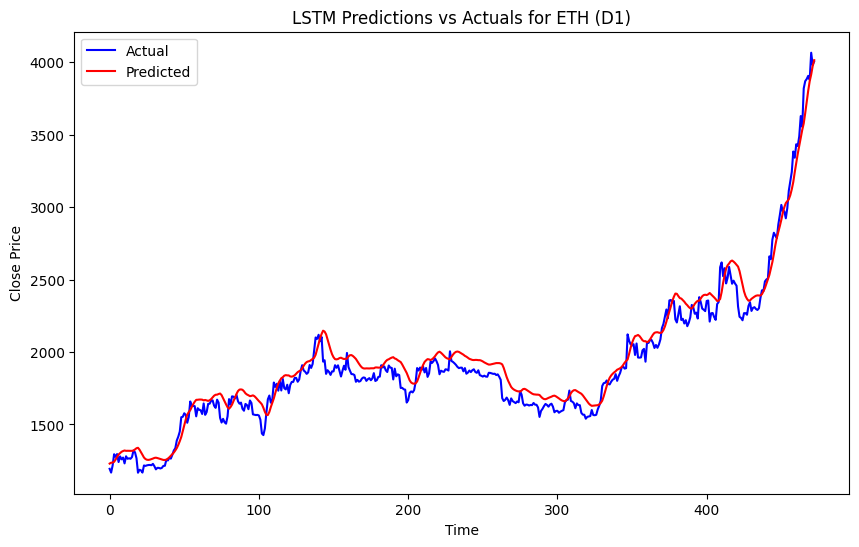


--- Running LSTM for TUSDT (D1) ---


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 78ms/step
--- LSTM Performance Metrics for TUSDT (D1) ---
Mean Absolute Error (MAE): 0.002007
Mean Squared Error (MSE): 0.000008
Root Mean Squared Error (RMSE): 0.002755


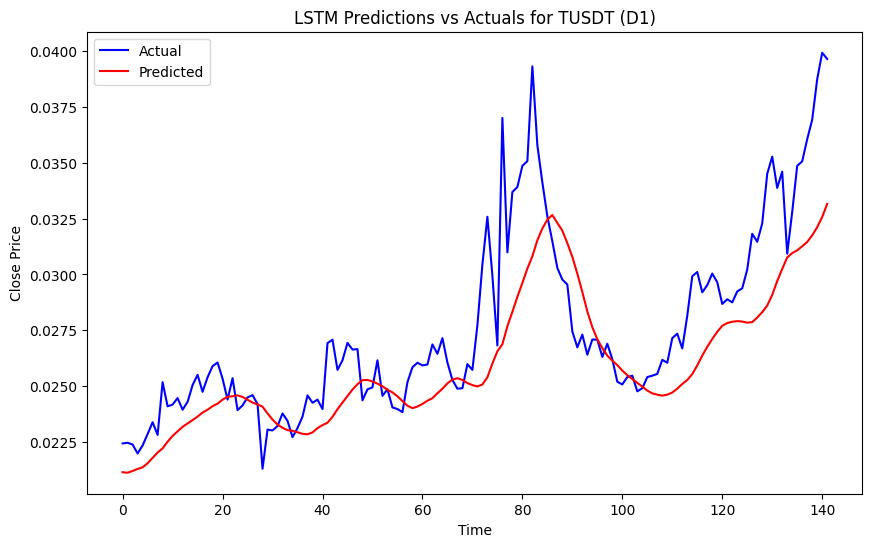


--- Running LSTM for USDC (D1) ---


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


11/11 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step
--- LSTM Performance Metrics for USDC (D1) ---
Mean Absolute Error (MAE): 0.000442
Mean Squared Error (MSE): 0.000000
Root Mean Squared Error (RMSE): 0.000545


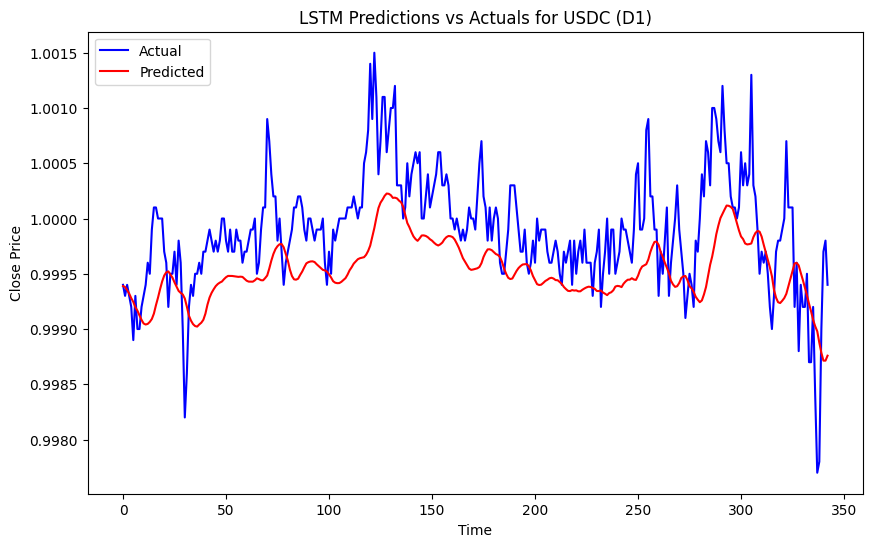


--- Running LSTM for BNB (D1) ---


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


15/15 ━━━━━━━━━━━━━━━━━━━━ 2s 39ms/step
--- LSTM Performance Metrics for BNB (D1) ---
Mean Absolute Error (MAE): 16.199437
Mean Squared Error (MSE): 361.000455
Root Mean Squared Error (RMSE): 19.000012


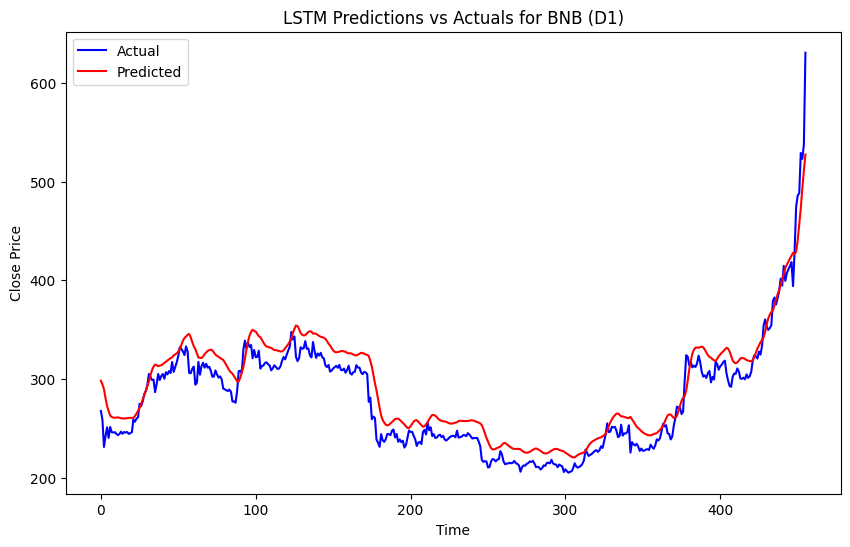


--- Running LSTM for XRP (D1) ---


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


14/14 ━━━━━━━━━━━━━━━━━━━━ 1s 29ms/step
--- LSTM Performance Metrics for XRP (D1) ---
Mean Absolute Error (MAE): 0.042823
Mean Squared Error (MSE): 0.002473
Root Mean Squared Error (RMSE): 0.049724


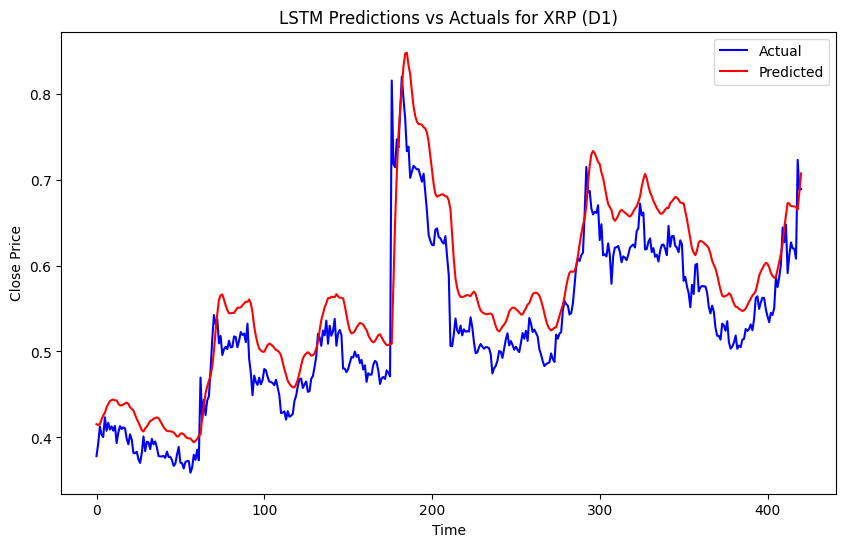


--- Running LSTM for ADA (D1) ---


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


14/14 ━━━━━━━━━━━━━━━━━━━━ 1s 28ms/step
--- LSTM Performance Metrics for ADA (D1) ---
Mean Absolute Error (MAE): 0.048690
Mean Squared Error (MSE): 0.002775
Root Mean Squared Error (RMSE): 0.052678


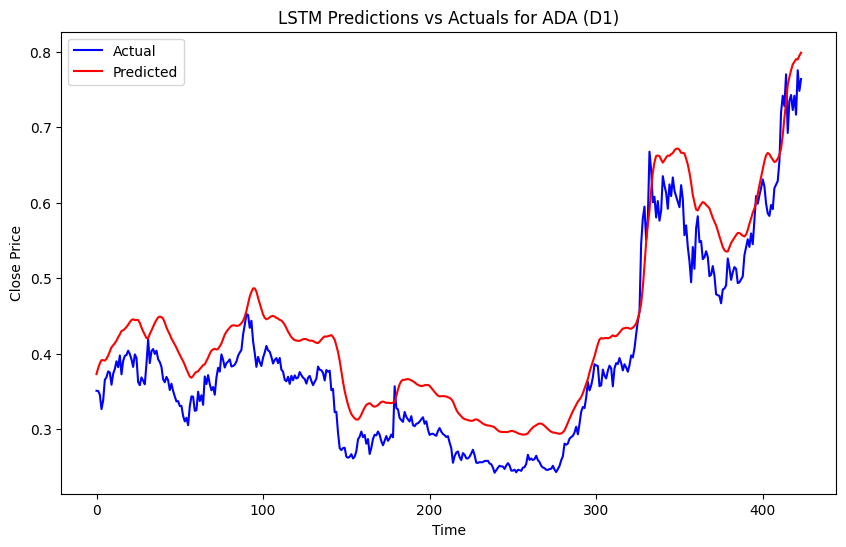


--- Running LSTM for LTC (D1) ---


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


15/15 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step
--- LSTM Performance Metrics for LTC (D1) ---
Mean Absolute Error (MAE): 6.630357
Mean Squared Error (MSE): 56.475997
Root Mean Squared Error (RMSE): 7.515051


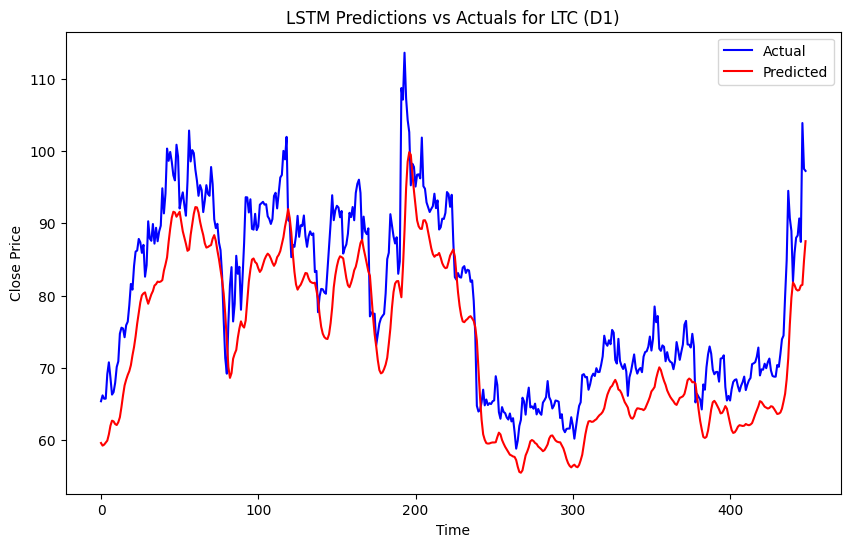


--- Running LSTM for SOL (D1) ---


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 49ms/step
--- LSTM Performance Metrics for SOL (D1) ---
Mean Absolute Error (MAE): 3.828592
Mean Squared Error (MSE): 34.870835
Root Mean Squared Error (RMSE): 5.905153


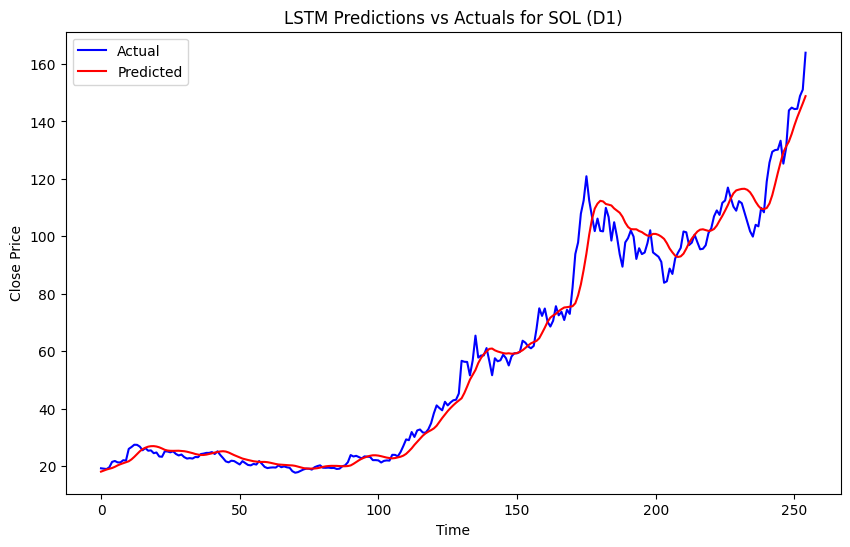


--- Running LSTM for DOT (D1) ---


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 65ms/step
--- LSTM Performance Metrics for DOT (D1) ---
Mean Absolute Error (MAE): 0.615562
Mean Squared Error (MSE): 0.469128
Root Mean Squared Error (RMSE): 0.684929


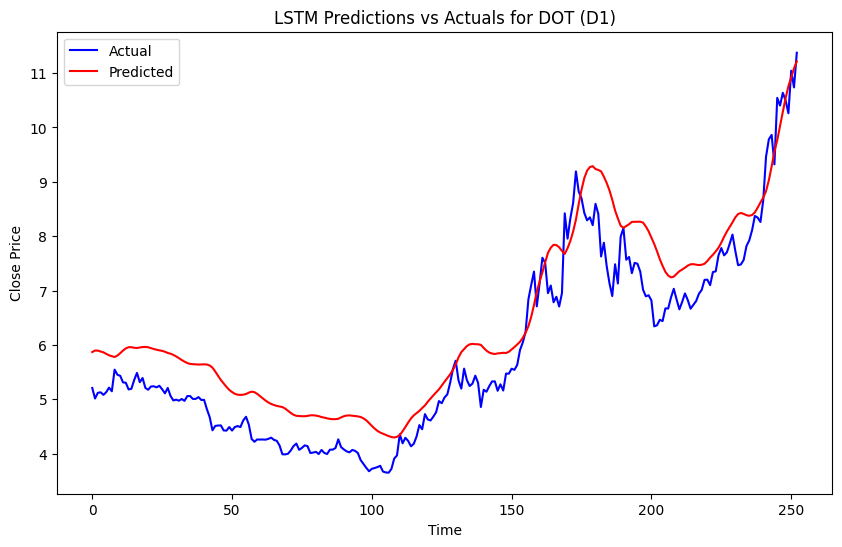


--- Running LSTM for BTC (W1) ---


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 282ms/step
--- LSTM Performance Metrics for BTC (W1) ---
Mean Absolute Error (MAE): 4214.099785
Mean Squared Error (MSE): 35204677.896365
Root Mean Squared Error (RMSE): 5933.353006


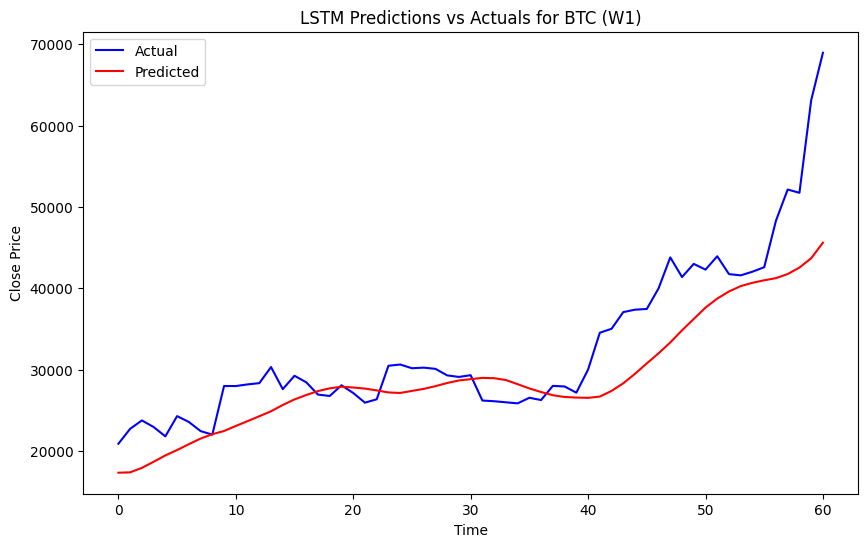


--- Running LSTM for ETH (W1) ---


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 302ms/step
--- LSTM Performance Metrics for ETH (W1) ---
Mean Absolute Error (MAE): 196.800769
Mean Squared Error (MSE): 75581.646465
Root Mean Squared Error (RMSE): 274.921164


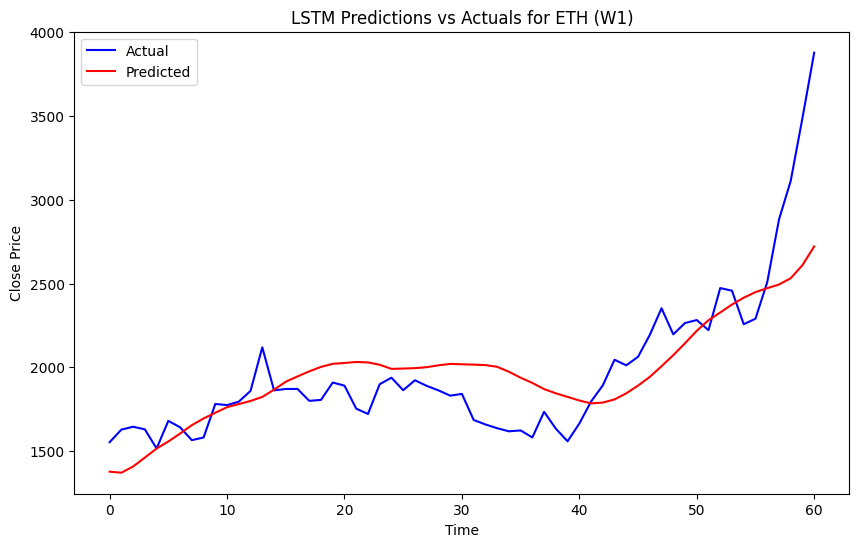


--- Running LSTM for TUSDT (W1) ---


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
--- LSTM Performance Metrics for TUSDT (W1) ---
Mean Absolute Error (MAE): 0.004304
Mean Squared Error (MSE): 0.000036
Root Mean Squared Error (RMSE): 0.005991


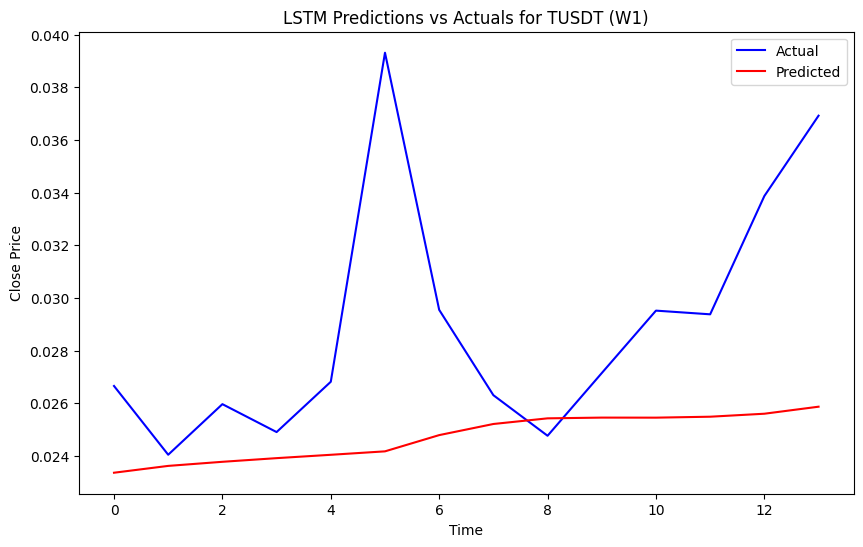


--- Running LSTM for USDC (W1) ---


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 300ms/step
--- LSTM Performance Metrics for USDC (W1) ---
Mean Absolute Error (MAE): 0.000486
Mean Squared Error (MSE): 0.000000
Root Mean Squared Error (RMSE): 0.000584


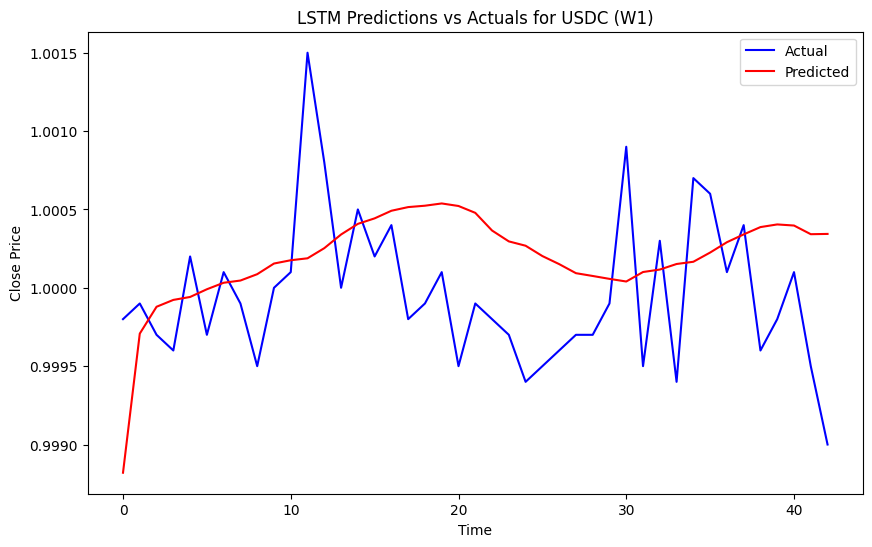


--- Running LSTM for BNB (W1) ---


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 487ms/step
--- LSTM Performance Metrics for BNB (W1) ---
Mean Absolute Error (MAE): 29.640492
Mean Squared Error (MSE): 1779.513092
Root Mean Squared Error (RMSE): 42.184275


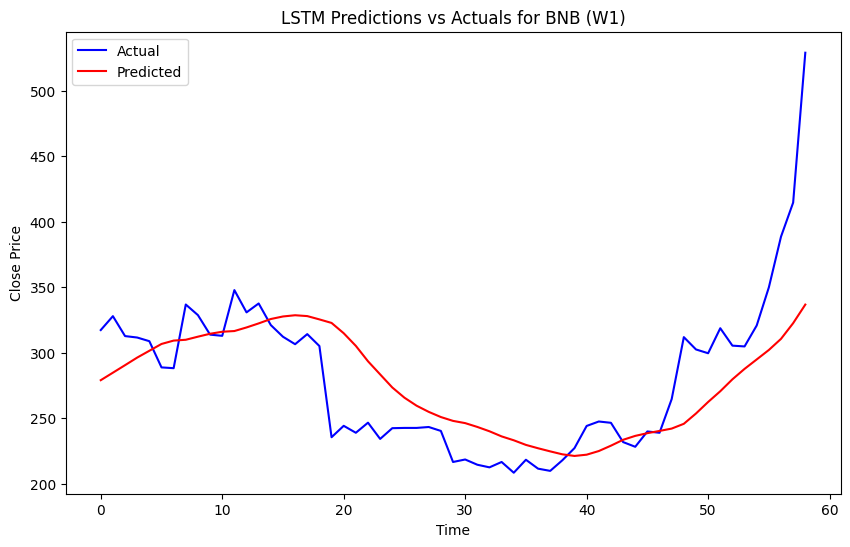


--- Running LSTM for XRP (W1) ---


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 288ms/step
--- LSTM Performance Metrics for XRP (W1) ---
Mean Absolute Error (MAE): 0.057367
Mean Squared Error (MSE): 0.006122
Root Mean Squared Error (RMSE): 0.078242


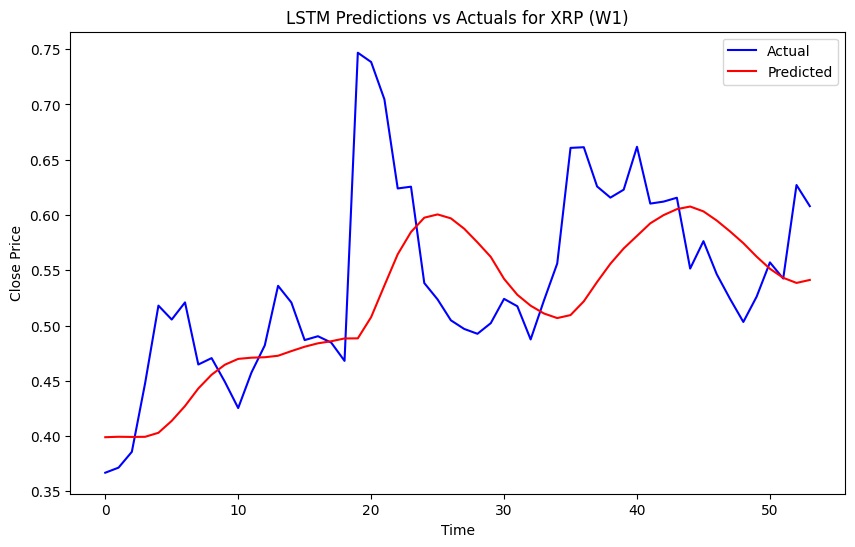


--- Running LSTM for ADA (W1) ---


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 438ms/step
--- LSTM Performance Metrics for ADA (W1) ---
Mean Absolute Error (MAE): 0.070917
Mean Squared Error (MSE): 0.006956
Root Mean Squared Error (RMSE): 0.083403


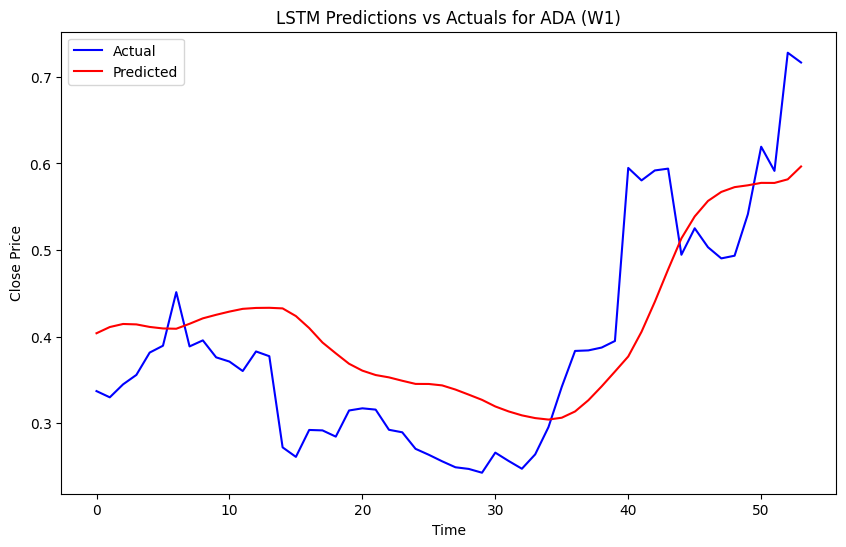


--- Running LSTM for LTC (W1) ---


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 290ms/step
--- LSTM Performance Metrics for LTC (W1) ---
Mean Absolute Error (MAE): 7.665304
Mean Squared Error (MSE): 103.751714
Root Mean Squared Error (RMSE): 10.185859


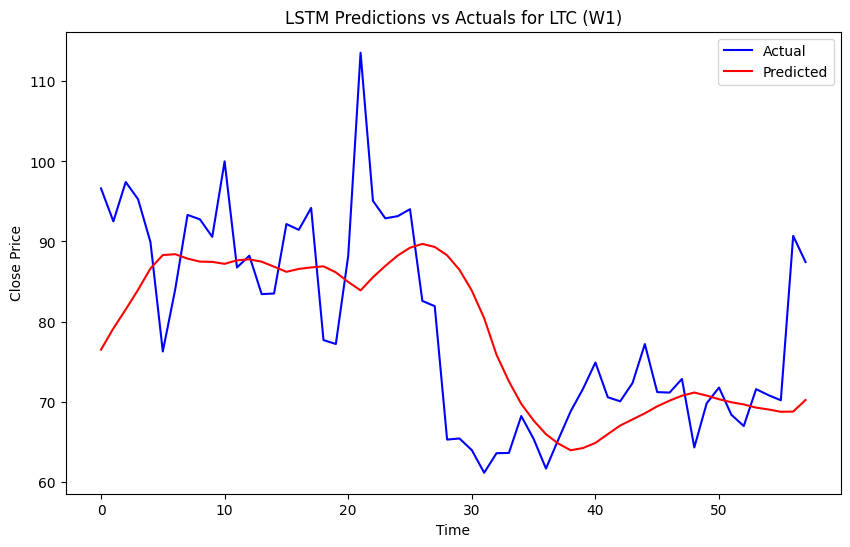


--- Running LSTM for SOL (W1) ---


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 273ms/step
--- LSTM Performance Metrics for SOL (W1) ---
Mean Absolute Error (MAE): 20.638151
Mean Squared Error (MSE): 686.064494
Root Mean Squared Error (RMSE): 26.192833


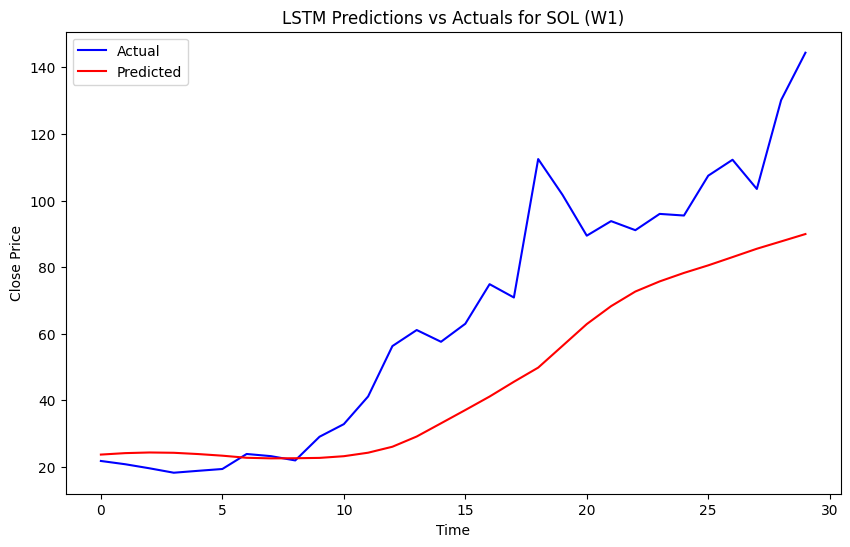


--- Running LSTM for DOT (W1) ---


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 334ms/step
--- LSTM Performance Metrics for DOT (W1) ---
Mean Absolute Error (MAE): 1.153887
Mean Squared Error (MSE): 2.383561
Root Mean Squared Error (RMSE): 1.543879


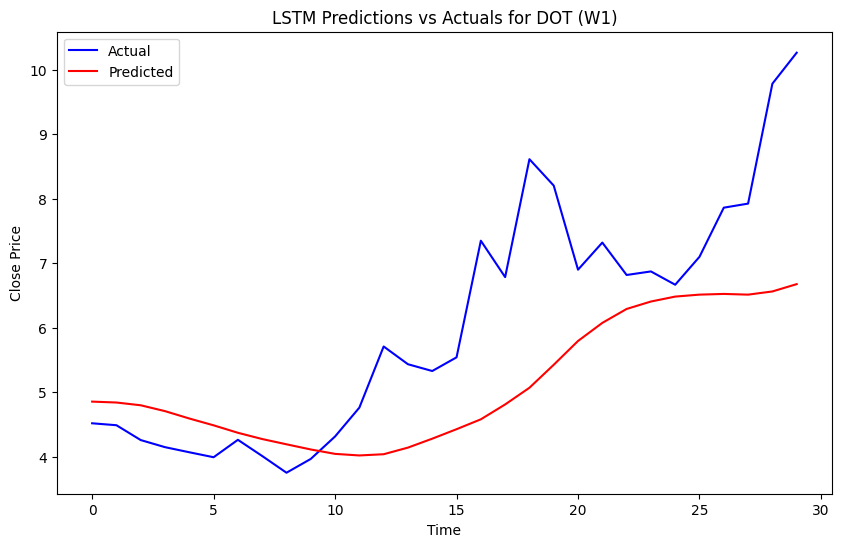


### Running LSTM for Hourly (H1) and 4-Hourly (H4) ###

--- Running LSTM for BTC (H1) ---


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


360/360 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step
--- LSTM Performance Metrics for BTC (H1) ---
Mean Absolute Error (MAE): 245.912920
Mean Squared Error (MSE): 89484.597222
Root Mean Squared Error (RMSE): 299.139762


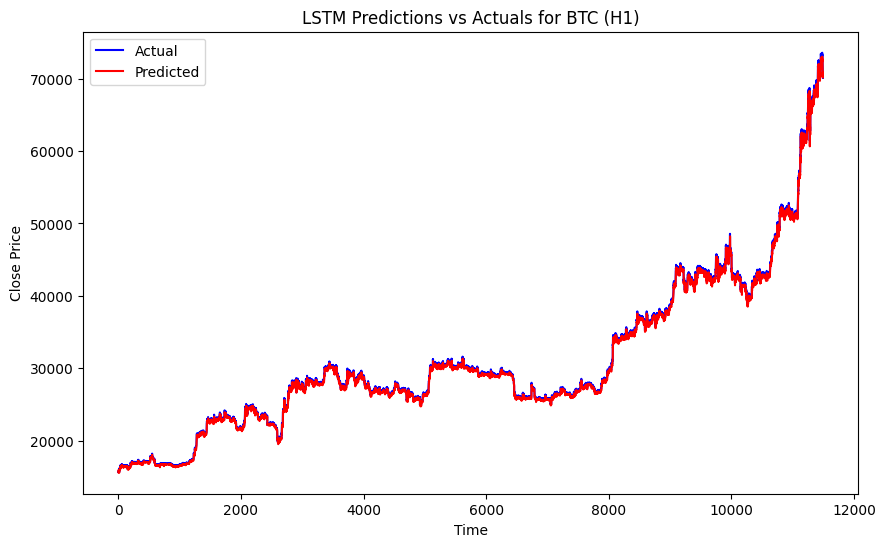


--- Running LSTM for ETH (H1) ---


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


360/360 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step
--- LSTM Performance Metrics for ETH (H1) ---
Mean Absolute Error (MAE): 15.635958
Mean Squared Error (MSE): 332.577365
Root Mean Squared Error (RMSE): 18.236704


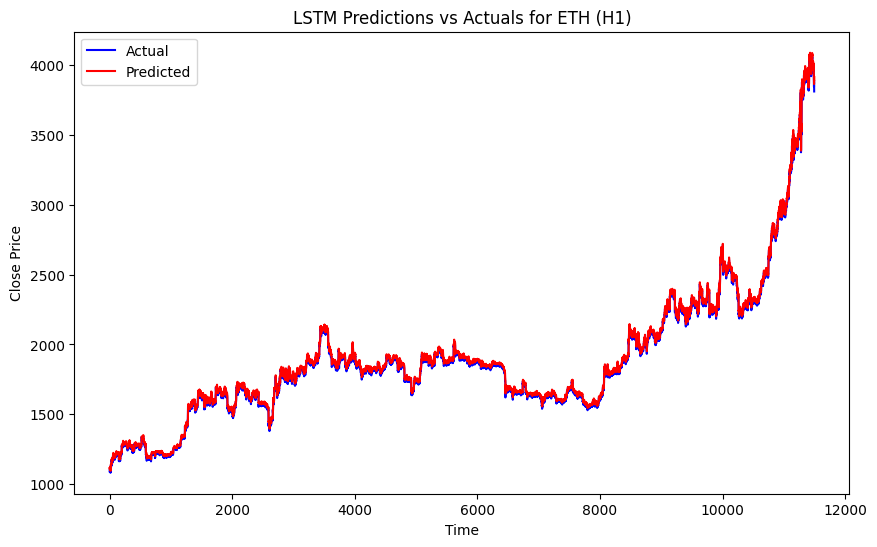


--- Running LSTM for TUSDT (H1) ---


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


113/113 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step
--- LSTM Performance Metrics for TUSDT (H1) ---
Mean Absolute Error (MAE): 0.000749
Mean Squared Error (MSE): 0.000001
Root Mean Squared Error (RMSE): 0.000848


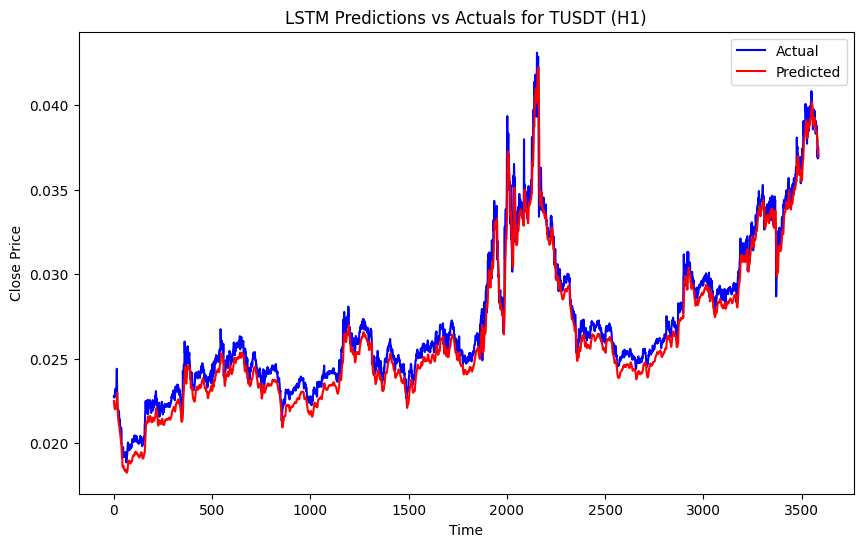


--- Running LSTM for USDC (H1) ---


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


262/262 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
--- LSTM Performance Metrics for USDC (H1) ---
Mean Absolute Error (MAE): 0.000242
Mean Squared Error (MSE): 0.000000
Root Mean Squared Error (RMSE): 0.000262


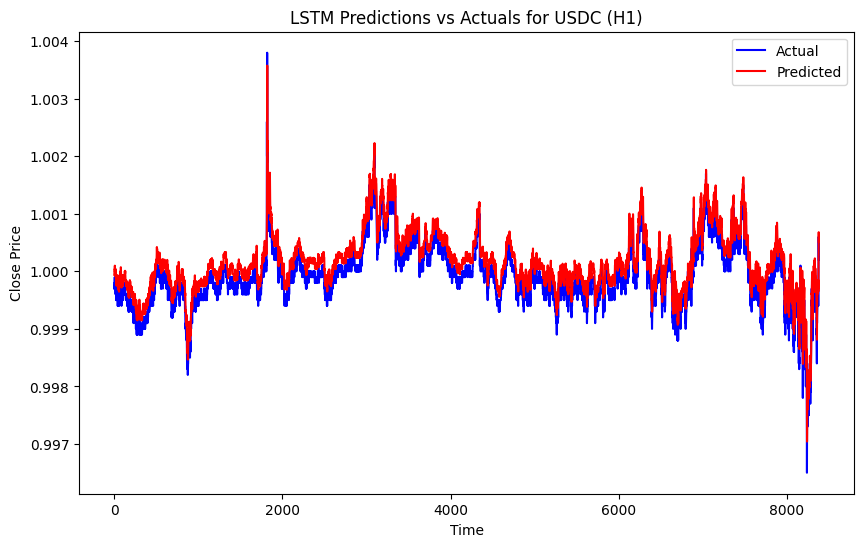


--- Running LSTM for BNB (H1) ---


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


348/348 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
--- LSTM Performance Metrics for BNB (H1) ---
Mean Absolute Error (MAE): 1.028704
Mean Squared Error (MSE): 2.935894
Root Mean Squared Error (RMSE): 1.713445


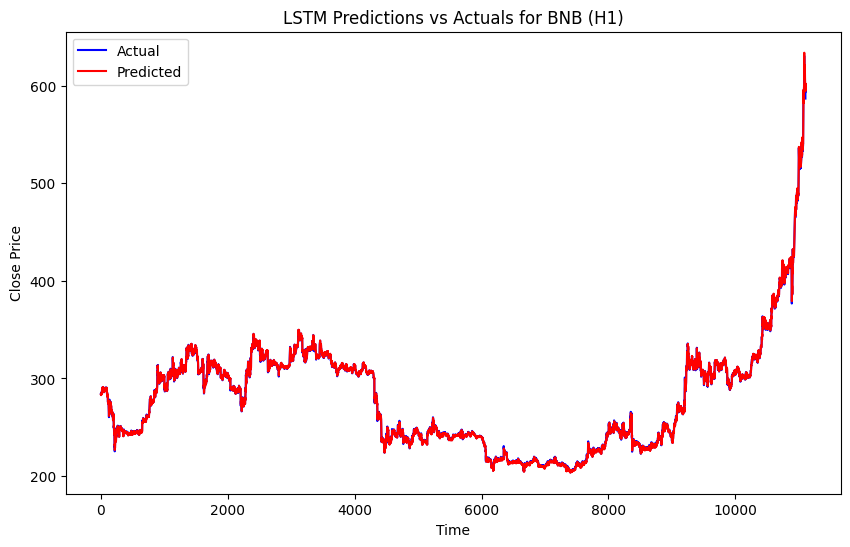


--- Running LSTM for XRP (H1) ---


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


321/321 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step
--- LSTM Performance Metrics for XRP (H1) ---
Mean Absolute Error (MAE): 0.002631
Mean Squared Error (MSE): 0.000022
Root Mean Squared Error (RMSE): 0.004732


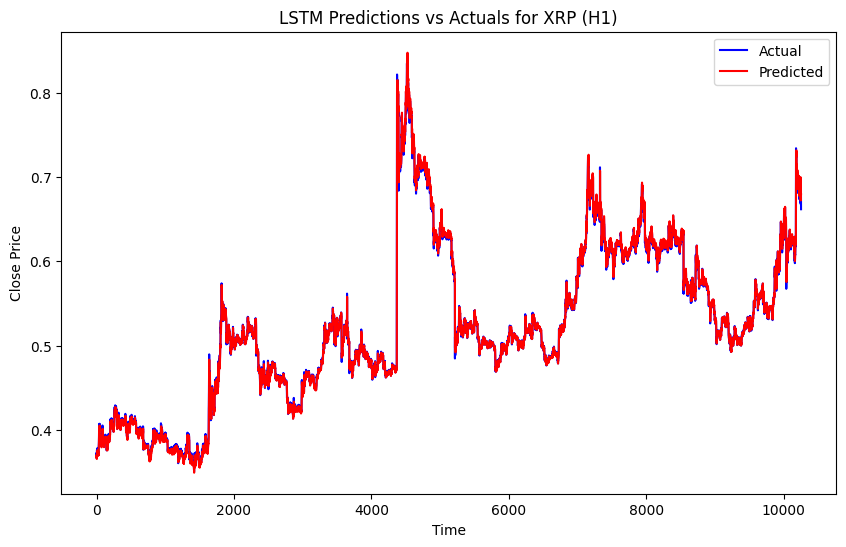


--- Running LSTM for ADA (H1) ---


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


323/323 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step
--- LSTM Performance Metrics for ADA (H1) ---
Mean Absolute Error (MAE): 0.002402
Mean Squared Error (MSE): 0.000016
Root Mean Squared Error (RMSE): 0.004011


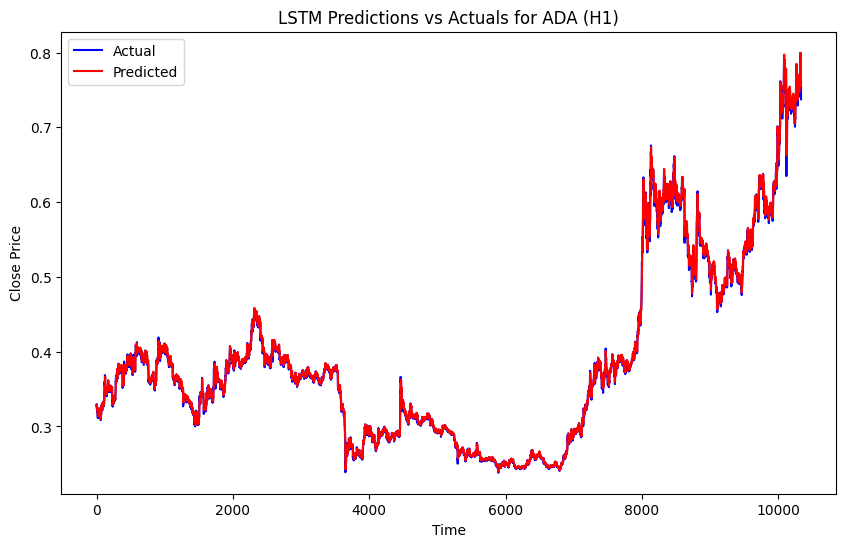


--- Running LSTM for LTC (H1) ---


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


342/342 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step
--- LSTM Performance Metrics for LTC (H1) ---
Mean Absolute Error (MAE): 0.979020
Mean Squared Error (MSE): 1.249454
Root Mean Squared Error (RMSE): 1.117790


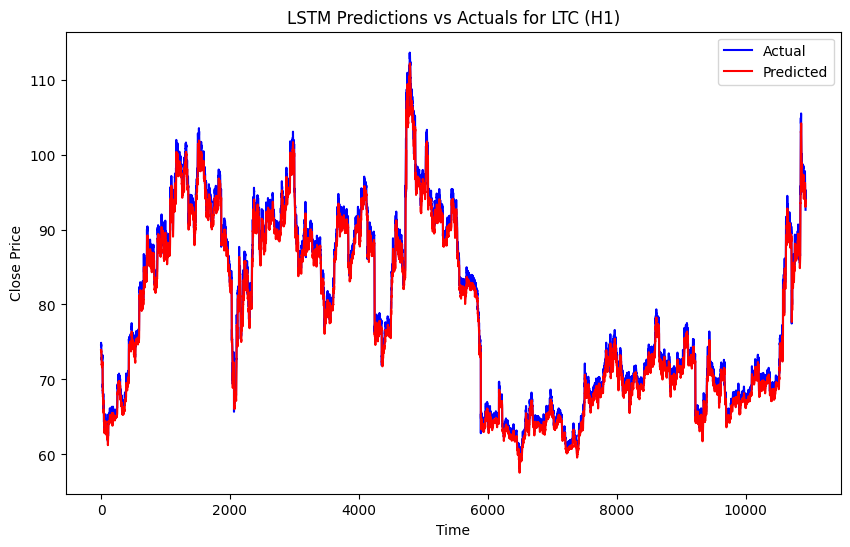


--- Running LSTM for SOL (H1) ---


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


197/197 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
--- LSTM Performance Metrics for SOL (H1) ---
Mean Absolute Error (MAE): 1.324094
Mean Squared Error (MSE): 2.692154
Root Mean Squared Error (RMSE): 1.640778


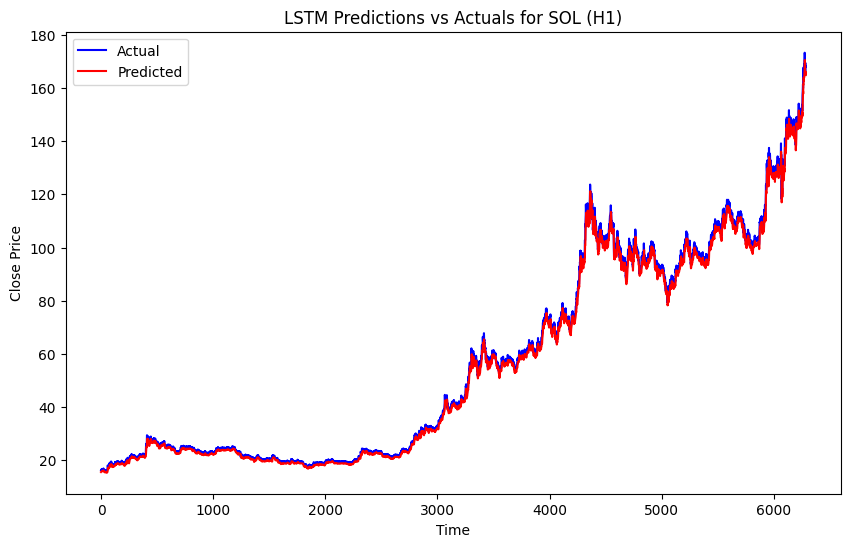


--- Running LSTM for DOT (H1) ---


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


196/196 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
--- LSTM Performance Metrics for DOT (H1) ---
Mean Absolute Error (MAE): 0.063894
Mean Squared Error (MSE): 0.007272
Root Mean Squared Error (RMSE): 0.085276


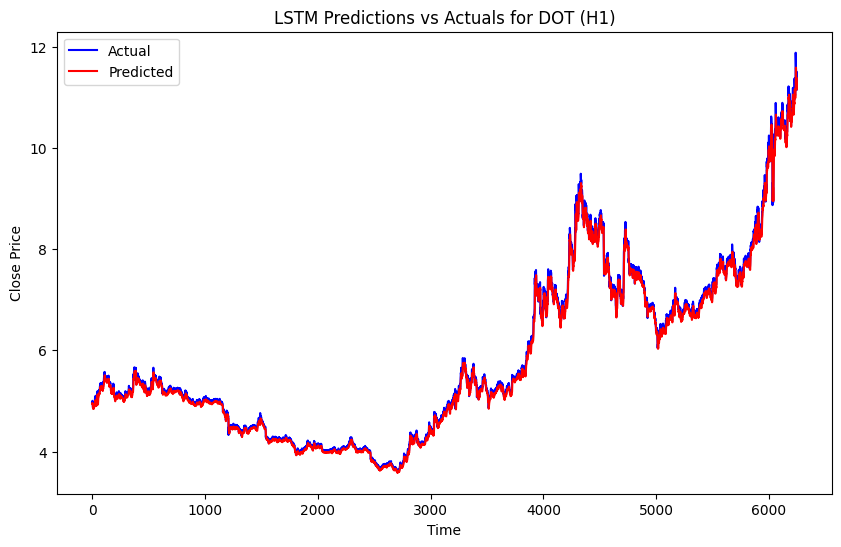


--- Running LSTM for BTC (H4) ---


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step
--- LSTM Performance Metrics for BTC (H4) ---
Mean Absolute Error (MAE): 258.424786
Mean Squared Error (MSE): 183056.997762
Root Mean Squared Error (RMSE): 427.851607


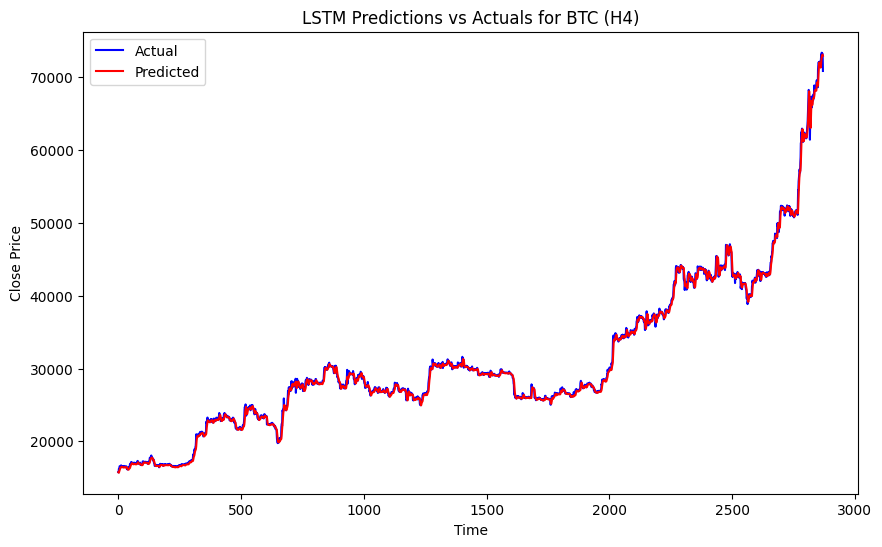


--- Running LSTM for ETH (H4) ---


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


90/90 ━━━━━━━━━━━━━━━━━━━━ 2s 14ms/step
--- LSTM Performance Metrics for ETH (H4) ---
Mean Absolute Error (MAE): 37.101932
Mean Squared Error (MSE): 1991.492613
Root Mean Squared Error (RMSE): 44.626143


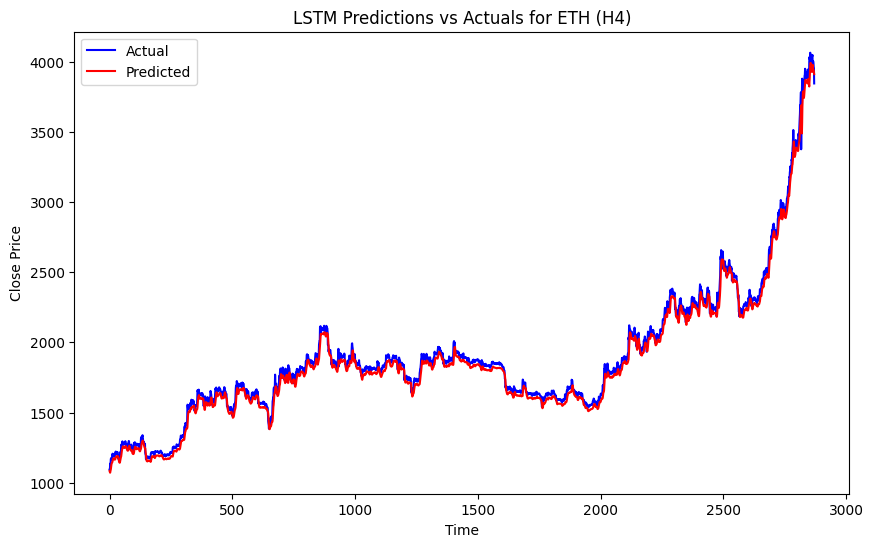


--- Running LSTM for TUSDT (H4) ---


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


28/28 ━━━━━━━━━━━━━━━━━━━━ 1s 21ms/step
--- LSTM Performance Metrics for TUSDT (H4) ---
Mean Absolute Error (MAE): 0.000708
Mean Squared Error (MSE): 0.000001
Root Mean Squared Error (RMSE): 0.001075


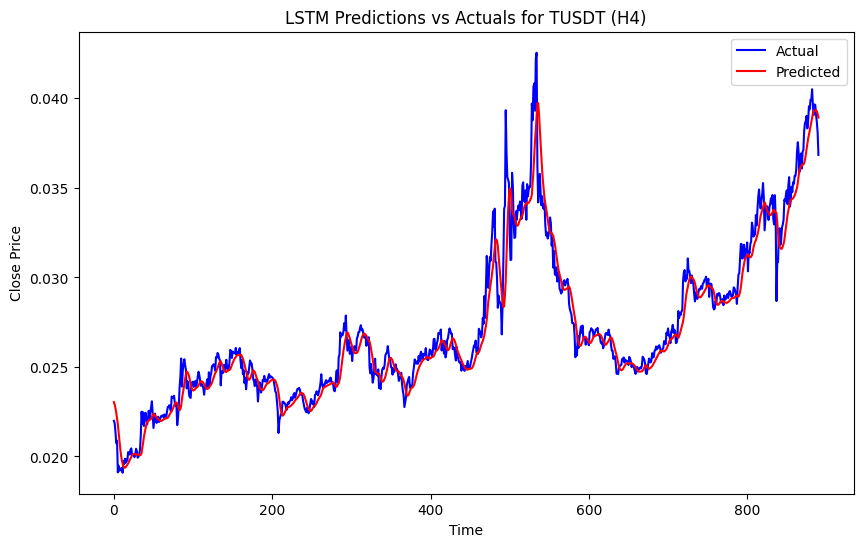


--- Running LSTM for USDC (H4) ---


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


66/66 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step
--- LSTM Performance Metrics for USDC (H4) ---
Mean Absolute Error (MAE): 0.000179
Mean Squared Error (MSE): 0.000000
Root Mean Squared Error (RMSE): 0.000249


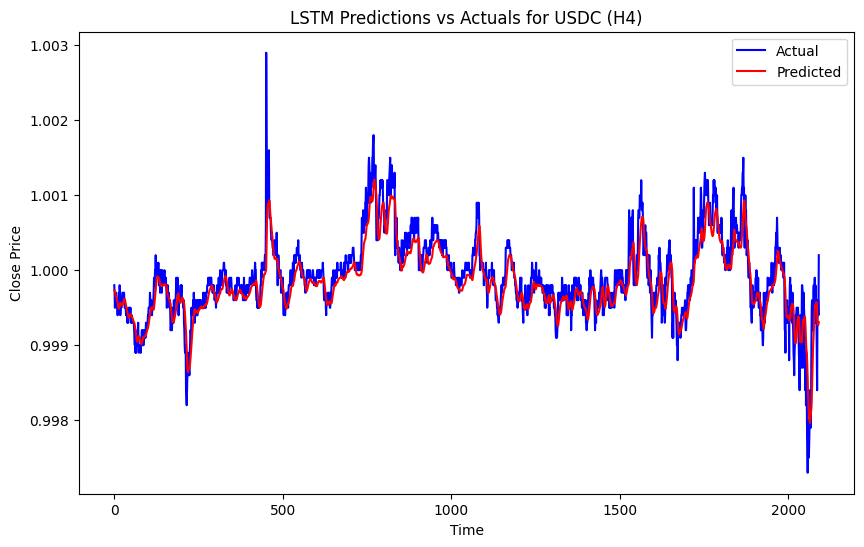


--- Running LSTM for BNB (H4) ---


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


87/87 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step
--- LSTM Performance Metrics for BNB (H4) ---
Mean Absolute Error (MAE): 2.560913
Mean Squared Error (MSE): 17.489404
Root Mean Squared Error (RMSE): 4.182034


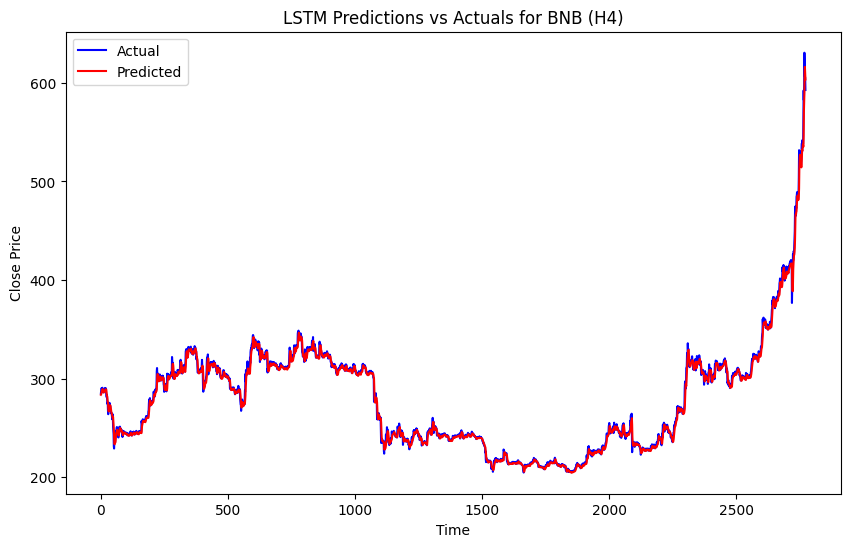


--- Running LSTM for XRP (H4) ---


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


80/80 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
--- LSTM Performance Metrics for XRP (H4) ---
Mean Absolute Error (MAE): 0.009065
Mean Squared Error (MSE): 0.000167
Root Mean Squared Error (RMSE): 0.012938


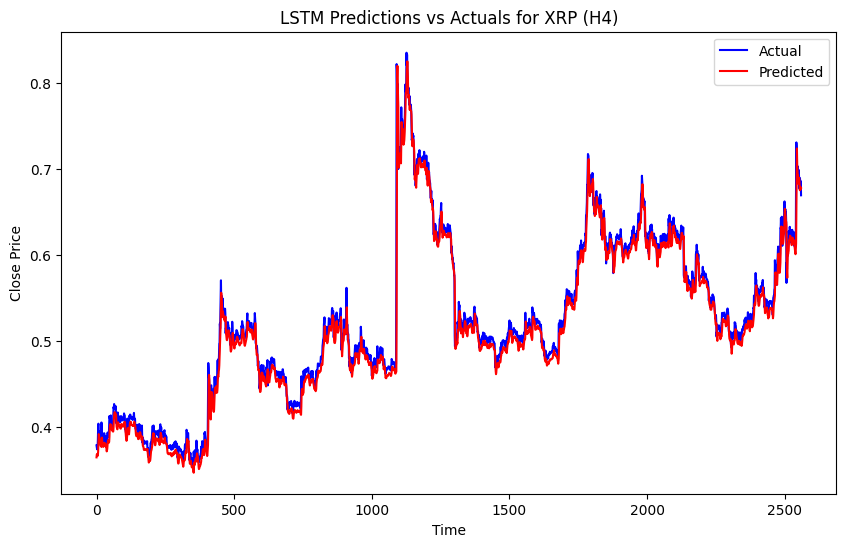


--- Running LSTM for ADA (H4) ---


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


81/81 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step
--- LSTM Performance Metrics for ADA (H4) ---
Mean Absolute Error (MAE): 0.012703
Mean Squared Error (MSE): 0.000214
Root Mean Squared Error (RMSE): 0.014617


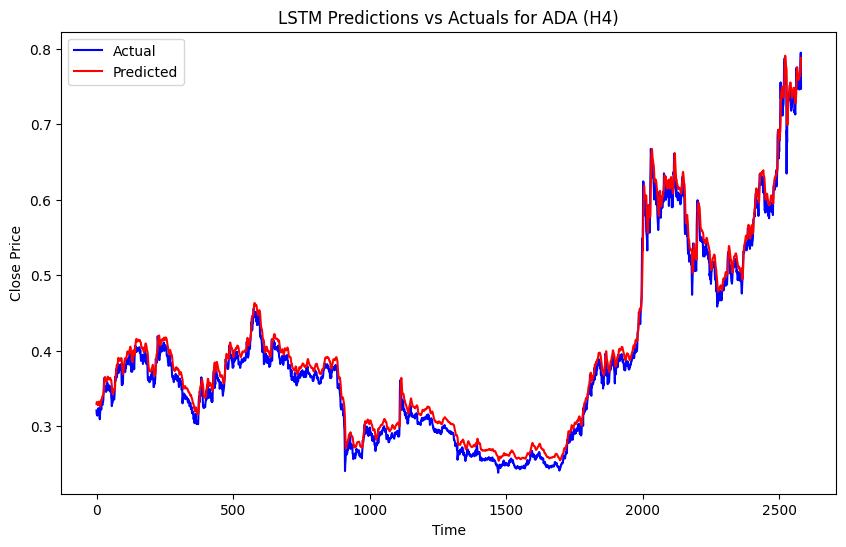


--- Running LSTM for LTC (H4) ---


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


86/86 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step
--- LSTM Performance Metrics for LTC (H4) ---
Mean Absolute Error (MAE): 1.355123
Mean Squared Error (MSE): 3.025963
Root Mean Squared Error (RMSE): 1.739530


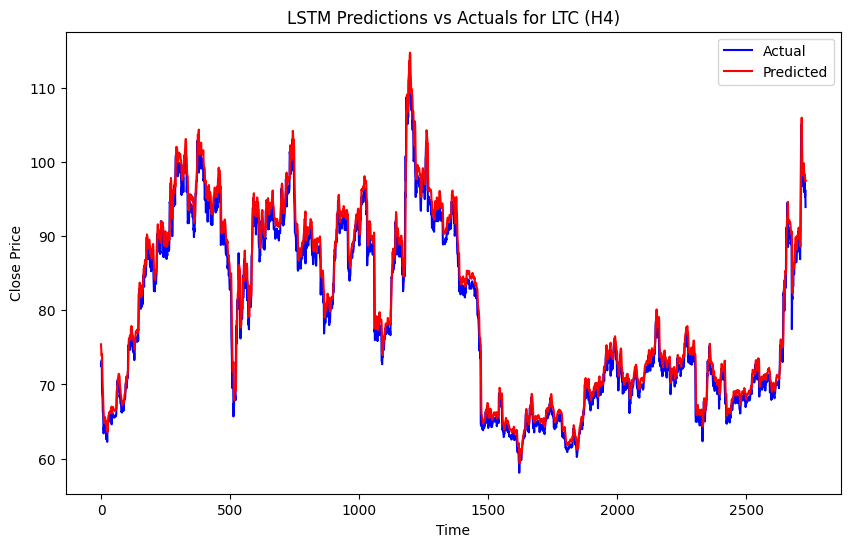


--- Running LSTM for SOL (H4) ---


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


49/49 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step
--- LSTM Performance Metrics for SOL (H4) ---
Mean Absolute Error (MAE): 1.485298
Mean Squared Error (MSE): 4.822947
Root Mean Squared Error (RMSE): 2.196121


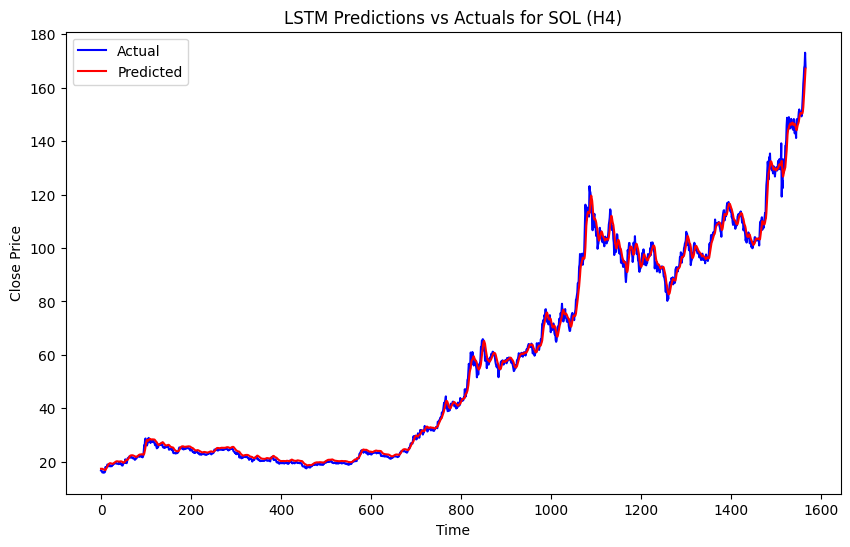


--- Running LSTM for DOT (H4) ---


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


49/49 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step
--- LSTM Performance Metrics for DOT (H4) ---
Mean Absolute Error (MAE): 0.302229
Mean Squared Error (MSE): 0.108603
Root Mean Squared Error (RMSE): 0.329550


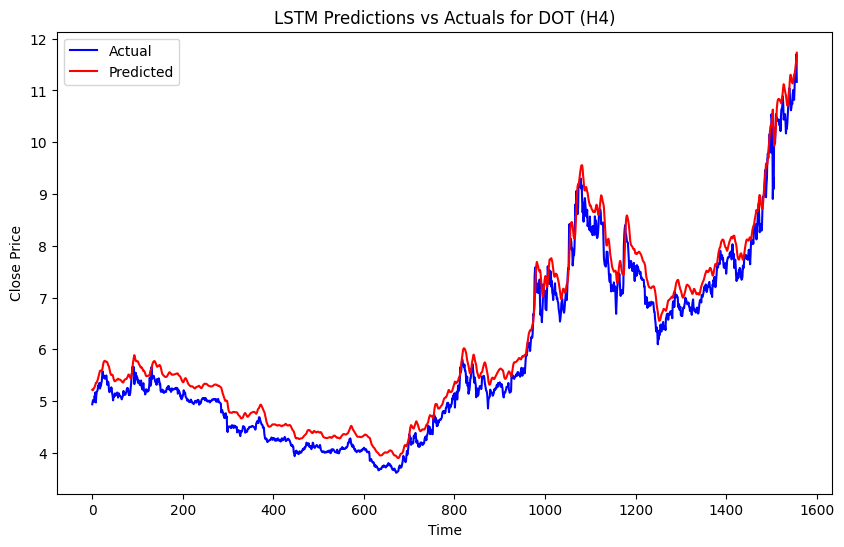

In [ ]:
## For Daily and Weekly
## NOTE: In case this block does not run, reload the data again
## i.e. this code:
# # Updated list of top 10 cryptocurrencies by their symbols, with Tether as 'TUSDT'
# top_10_symbols = ['BTC', 'ETH', 'TUSDT', 'USDC', 'BNB', 'XRP', 'ADA', 'LTC', 'SOL', 'DOT']

# # Dictionary to store data for each interval and cryptocurrency
# interval_data = {interval: {} for interval in intervals}

# # Load data by interval and cryptocurrency
# for interval, folder_name in intervals.items():
#     print(f"\nLoading data for interval: {folder_name}")
#     interval_folder_path = os.path.join(project_folder, interval)
#     for crypto in top_10_symbols:
#         # Handle specific naming for Tether (TUSDT)
#         file_name = f"{crypto}USDT_{interval}.csv" if crypto != "TUSDT" else f"TUSDT_{interval}.csv"
#         file_path = os.path.join(interval_folder_path, file_name)

#         if os.path.exists(file_path):
#             df = pd.read_csv(file_path)
#             interval_data[interval][crypto] = df
#             print(f"Loaded {crypto} data for {folder_name} interval from {file_path}")
#         else:
#             interval_data[interval][crypto] = pd.DataFrame()  # empty DataFrame if file does not exist
#             print(f"No data found for {crypto} in {folder_name} interval.")


import pandas as pd
import numpy as np
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, LSTM
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_absolute_error, mean_squared_error
import matplotlib.pyplot as plt
import math

# Copy the original data into a new variable for LSTM
lstm_data = {interval: data.copy() for interval, data in interval_data.items()}

# Function to prepare data for LSTM
def prepare_lstm_data(df, feature_col='close', time_steps=10):
    scaler = MinMaxScaler(feature_range=(0, 1))
    data_scaled = scaler.fit_transform(df[feature_col].values.reshape(-1, 1))

    X, y = [], []
    for i in range(time_steps, len(data_scaled)):
        X.append(data_scaled[i - time_steps:i, 0])
        y.append(data_scaled[i, 0])

    X, y = np.array(X), np.array(y)
    X = np.reshape(X, (X.shape[0], X.shape[1], 1))  # Reshape for LSTM
    return X, y, scaler

# Function to build and train LSTM model, plot results, and display metrics
def lstm_workflow(df, interval_label, time_steps=10):
    if df.empty or 'close' not in df.columns:
        print(f"Skipping {interval_label} due to missing or invalid data.")
        return

    print(f"\n--- Running LSTM for {interval_label} ---")

    # Prepare data
    X, y, scaler = prepare_lstm_data(df, time_steps=time_steps)
    train_size = int(len(X) * 0.8)
    X_train, y_train = X[:train_size], y[:train_size]
    X_test, y_test = X[train_size:], y[train_size:]

    # Build LSTM model
    model = Sequential()
    model.add(LSTM(50, return_sequences=True, input_shape=(X_train.shape[1], 1)))
    model.add(LSTM(50, return_sequences=False))
    model.add(Dense(25))
    model.add(Dense(1))
    model.compile(optimizer='adam', loss='mean_squared_error')

    # Train the model
    model.fit(X_train, y_train, batch_size=32, epochs=10, verbose=0)

    # Predict and rescale
    predictions = model.predict(X_test)
    predictions_rescaled = scaler.inverse_transform(predictions)
    y_test_rescaled = scaler.inverse_transform(y_test.reshape(-1, 1))

    # Calculate metrics
    mae = mean_absolute_error(y_test_rescaled, predictions_rescaled)
    mse = mean_squared_error(y_test_rescaled, predictions_rescaled)
    rmse = math.sqrt(mse)

    # Print performance metrics
    print(f"--- LSTM Performance Metrics for {interval_label} ---")
    print(f"Mean Absolute Error (MAE): {mae:.6f}")
    print(f"Mean Squared Error (MSE): {mse:.6f}")
    print(f"Root Mean Squared Error (RMSE): {rmse:.6f}")

    # Plot the results
    plt.figure(figsize=(10, 6))
    plt.plot(y_test_rescaled, label='Actual', color='blue')
    plt.plot(predictions_rescaled, label='Predicted', color='red')
    plt.title(f'LSTM Predictions vs Actuals for {interval_label}')
    plt.xlabel('Time')
    plt.ylabel('Close Price')
    plt.legend()
    plt.show()

# Run LSTM workflow for Daily (D1) and Weekly (W1)
print("\n### Running LSTM for Daily (D1) and Weekly (W1) ###")
time_intervals_daily_weekly = ['D1', 'W1']  # Daily and Weekly intervals
for interval in time_intervals_daily_weekly:
    for crypto in ['BTC', 'ETH', 'TUSDT', 'USDC', 'BNB', 'XRP', 'ADA', 'LTC', 'SOL', 'DOT']:
        data = lstm_data.get(interval, {}).get(crypto, pd.DataFrame())
        lstm_workflow(data, f"{crypto} ({interval})")

# Run LSTM workflow for Hourly (H1) and 4-Hourly (H4)
print("\n### Running LSTM for Hourly (H1) and 4-Hourly (H4) ###")
time_intervals_hourly = ['H1', 'H4']  # Hourly and 4-Hourly intervals
for interval in time_intervals_hourly:
    for crypto in ['BTC', 'ETH', 'TUSDT', 'USDC', 'BNB', 'XRP', 'ADA', 'LTC', 'SOL', 'DOT']:
        data = lstm_data.get(interval, {}).get(crypto, pd.DataFrame())
        lstm_workflow(data, f"{crypto} ({interval})")



## LSTM Model Performance Summary for Daily Interval (D1)

### 1. **BTC (Bitcoin)**
- **Performance Metrics:**
  - **Mean Absolute Error (MAE):** 1344.18
  - **Mean Squared Error (MSE):** 4256288.74
  - **Root Mean Squared Error (RMSE):** 2063.08
- **Insight:**
  - BTC predictions align well with trends, but high RMSE indicates significant deviation during volatile phases.

---

### 2. **ETH (Ethereum)**
- **Performance Metrics:**
  - **Mean Absolute Error (MAE):** 72.23
  - **Mean Squared Error (MSE):** 7994.60
  - **Root Mean Squared Error (RMSE):** 89.41
- **Insight:**
  - ETH predictions show strong performance with relatively low error, but volatility causes some deviations.

---

### 3. **TUSDT (Tether)**
- **Performance Metrics:**
  - **Mean Absolute Error (MAE):** 0.0016
  - **Mean Squared Error (MSE):** 0.000005
  - **Root Mean Squared Error (RMSE):** 0.0023
- **Insight:**
  - TUSDT predictions show minimal error, consistent with its nature as a stablecoin.

---

### 4. **USDC (USD Coin)**
- **Performance Metrics:**
  - **Mean Absolute Error (MAE):** 0.0005
  - **Mean Squared Error (MSE):** 0.000000
  - **Root Mean Squared Error (RMSE):** 0.0006
- **Insight:**
  - USDC predictions maintain exceptional accuracy, reflecting its price stability as a stablecoin.

---

### 5. **BNB (Binance Coin)**
- **Performance Metrics:**
  - **Mean Absolute Error (MAE):** 13.16
  - **Mean Squared Error (MSE):** 301.07
  - **Root Mean Squared Error (RMSE):** 17.35
- **Insight:**
  - BNB predictions are reasonably accurate, though error increases during upward price trends.

---

### 6. **XRP (Ripple)**
- **Performance Metrics:**
  - **Mean Absolute Error (MAE):** 0.0181
  - **Mean Squared Error (MSE):** 0.000910
  - **Root Mean Squared Error (RMSE):** 0.0302
- **Insight:**
  - XRP predictions are closely aligned with actual values, with minor deviations during rapid price increases.

---

### 7. **ADA (Cardano)**
- **Performance Metrics:**
  - **Mean Absolute Error (MAE):** 0.0226
  - **Mean Squared Error (MSE):** 0.000982
  - **Root Mean Squared Error (RMSE):** 0.0313
- **Insight:**
  - ADA predictions exhibit strong performance, though sharp upward movements contribute to minor errors.

---

### 8. **LTC (Litecoin)**
- **Performance Metrics:**
  - **Mean Absolute Error (MAE):** 3.07
  - **Mean Squared Error (MSE):** 18.70
  - **Root Mean Squared Error (RMSE):** 4.32
- **Insight:**
  - LTC predictions perform well overall, with deviations occurring during highly volatile price spikes.

---

### 9. **SOL (Solana)**
- **Performance Metrics:**
  - **Mean Absolute Error (MAE):** 4.42
  - **Mean Squared Error (MSE):** 39.63
  - **Root Mean Squared Error (RMSE):** 6.30
- **Insight:**
  - SOL predictions capture long-term trends accurately but show larger errors during sharp upward trends.

---

### 10. **DOT (Polkadot)**
- **Performance Metrics:**
  - **Mean Absolute Error (MAE):** 0.33
  - **Mean Squared Error (MSE):** 0.1818
  - **Root Mean Squared Error (RMSE):** 0.4263
- **Insight:**
  - DOT predictions align well with actual prices, with minimal errors during stable periods and slightly higher deviations during corrections.

---

## **Conclusion**
The LSTM model demonstrates strong predictive performance for daily price movements across different cryptocurrencies:
- **Stablecoins (TUSDT, USDC):** Minimal errors due to price stability.  
- **Major Coins (BTC, ETH):** Effective trend predictions, but larger deviations due to high volatility.  
- **Altcoins (BNB, XRP, ADA, LTC, SOL, DOT):** Solid accuracy with manageable errors, influenced primarily by sudden price surges or drops.

Overall, the model captures both stable and volatile trends effectively, with room for improvement in handling extreme price fluctuations.


## LSTM Model Performance Summary for Weekly Interval (W1)

### 1. **BTC (Bitcoin)**
- **Performance Metrics:**
  - **Mean Absolute Error (MAE):** 4193.52
  - **Mean Squared Error (MSE):** 34921928.34
  - **Root Mean Squared Error (RMSE):** 5909.48
- **Insight:**
  - BTC predictions demonstrate alignment with overall trends, but high RMSE reflects the impact of strong upward price surges.

---

### 2. **ETH (Ethereum)**
- **Performance Metrics:**
  - **Mean Absolute Error (MAE):** 193.15
  - **Mean Squared Error (MSE):** 84616.80
  - **Root Mean Squared Error (RMSE):** 290.89
- **Insight:**
  - ETH predictions are reasonable, though deviations occur during periods of rapid price increases.

---

### 3. **TUSDT (Tether)**
- **Performance Metrics:**
  - **Mean Absolute Error (MAE):** 0.0038
  - **Mean Squared Error (MSE):** 0.000031
  - **Root Mean Squared Error (RMSE):** 0.0056
- **Insight:**
  - TUSDT predictions exhibit exceptional accuracy, consistent with its nature as a stablecoin.

---

### 4. **USDC (USD Coin)**
- **Performance Metrics:**
  - **Mean Absolute Error (MAE):** 0.0005
  - **Mean Squared Error (MSE):** 0.000000
  - **Root Mean Squared Error (RMSE):** 0.0006
- **Insight:**
  - USDC predictions maintain near-perfect accuracy, reinforcing its stability as a pegged currency.

---

### 5. **BNB (Binance Coin)**
- **Performance Metrics:**
  - **Mean Absolute Error (MAE):** 30.76
  - **Mean Squared Error (MSE):** 1876.71
  - **Root Mean Squared Error (RMSE):** 43.32
- **Insight:**
  - BNB predictions are reasonably accurate, though errors increase during significant price shifts.

---

### 6. **XRP (Ripple)**
- **Performance Metrics:**
  - **Mean Absolute Error (MAE):** 0.0614
  - **Mean Squared Error (MSE):** 0.0072
  - **Root Mean Squared Error (RMSE):** 0.0850
- **Insight:**
  - XRP predictions generally follow actual trends, but sharp fluctuations introduce errors.

---

### 7. **ADA (Cardano)**
- **Performance Metrics:**
  - **Mean Absolute Error (MAE):** 0.0596
  - **Mean Squared Error (MSE):** 0.0063
  - **Root Mean Squared Error (RMSE):** 0.0794
- **Insight:**
  - ADA predictions align well with observed values, except during pronounced upward trends.

---

### 8. **LTC (Litecoin)**
- **Performance Metrics:**
  - **Mean Absolute Error (MAE):** 8.65
  - **Mean Squared Error (MSE):** 128.34
  - **Root Mean Squared Error (RMSE):** 11.33
- **Insight:**
  - LTC predictions perform well overall, but errors are higher during highly volatile periods.

---

### 9. **SOL (Solana)**
- **Performance Metrics:**
  - **Mean Absolute Error (MAE):** 21.48
  - **Mean Squared Error (MSE):** 740.58
  - **Root Mean Squared Error (RMSE):** 27.21
- **Insight:**
  - SOL predictions capture trends effectively, though rapid price surges lead to increased errors.

---

### 10. **DOT (Polkadot)**
- **Performance Metrics:**
  - **Mean Absolute Error (MAE):** 1.19
  - **Mean Squared Error (MSE):** 2.54
  - **Root Mean Squared Error (RMSE):** 1.59
- **Insight:**
  - DOT predictions are accurate, with minor deviations during significant price fluctuations.

---

### Overall Conclusion:
The LSTM model demonstrates varying performance across cryptocurrencies, with higher accuracy observed for stablecoins (TUSDT, USDC) due to their limited volatility. Predictions for major cryptocurrencies like BTC and ETH capture overall trends but exhibit higher errors during sharp upward price movements, reflecting the model's challenges in highly volatile conditions. The results suggest that LSTM models are effective for weekly interval data but require further optimization to improve accuracy during extreme price changes.


## **LSTM Model Performance Summary for Hourly Interval (H1)**

---

### 1. **BTC (Bitcoin)**
- **Performance Metrics:**
  - **Mean Absolute Error (MAE):** 93.98  
  - **Mean Squared Error (MSE):** 28,298.89  
  - **Root Mean Squared Error (RMSE):** 168.22  
- **Insight:**
  - BTC predictions closely follow actual trends, with moderate error values. The RMSE reflects BTC's high price volatility over hourly intervals.

---

### 2. **ETH (Ethereum)**
- **Performance Metrics:**
  - **Mean Absolute Error (MAE):** 12.77  
  - **Mean Squared Error (MSE):** 268.77  
  - **Root Mean Squared Error (RMSE):** 16.39  
- **Insight:**
  - ETH predictions are highly accurate, with a low RMSE, demonstrating the model’s efficiency in capturing short-term price movements.

---

### 3. **TUSDT (Tether)**
- **Performance Metrics:**
  - **Mean Absolute Error (MAE):** 0.0010  
  - **Mean Squared Error (MSE):** 0.000001  
  - **Root Mean Squared Error (RMSE):** 0.0011  
- **Insight:**
  - TUSDT predictions reflect minimal errors, consistent with its stablecoin nature and minimal price fluctuations.

---

### 4. **USDC (USD Coin)**
- **Performance Metrics:**
  - **Mean Absolute Error (MAE):** 0.0001  
  - **Mean Squared Error (MSE):** 0.000000  
  - **Root Mean Squared Error (RMSE):** 0.0001  
- **Insight:**
  - USDC predictions exhibit exceptional accuracy, aligning with its role as a stablecoin with near-zero price deviation.

---

### 5. **BNB (Binance Coin)**
- **Performance Metrics:**
  - **Mean Absolute Error (MAE):** 1.67  
  - **Mean Squared Error (MSE):** 4.90  
  - **Root Mean Squared Error (RMSE):** 2.21  
- **Insight:**
  - BNB predictions perform well, showing low errors, particularly during periods of relative price stability.

---

### 6. **XRP (Ripple)**
- **Performance Metrics:**
  - **Mean Absolute Error (MAE):** 0.0048  
  - **Mean Squared Error (MSE):** 0.000038  
  - **Root Mean Squared Error (RMSE):** 0.0062  
- **Insight:**
  - XRP predictions align closely with actual prices, though minor deviations occur during high volatility.

---

### 7. **ADA (Cardano)**
- **Performance Metrics:**
  - **Mean Absolute Error (MAE):** 0.0032  
  - **Mean Squared Error (MSE):** 0.000024  
  - **Root Mean Squared Error (RMSE):** 0.0049  
- **Insight:**
  - ADA predictions maintain high accuracy, with minor deviations during short-term price fluctuations.

---

### 8. **LTC (Litecoin)**
- **Performance Metrics:**
  - **Mean Absolute Error (MAE):** 0.44  
  - **Mean Squared Error (MSE):** 0.44  
  - **Root Mean Squared Error (RMSE):** 0.67  
- **Insight:**
  - LTC predictions demonstrate strong performance with moderate errors, capturing overall price movements effectively.

---

### 9. **SOL (Solana)**
- **Performance Metrics:**
  - **Mean Absolute Error (MAE):** 0.59  
  - **Mean Squared Error (MSE):** 0.81  
  - **Root Mean Squared Error (RMSE):** 0.90  
- **Insight:**
  - SOL predictions align well with actual trends, with slightly higher errors during rapid price increases.

---

### 10. **DOT (Polkadot)**
- **Performance Metrics:**
  - **Mean Absolute Error (MAE):** 0.12  
  - **Mean Squared Error (MSE):** 0.0185  
  - **Root Mean Squared Error (RMSE):** 0.14  
- **Insight:**
  - DOT predictions are highly accurate, capturing short-term price variations effectively.

---

### **Overall Summary**
The LSTM model demonstrates strong predictive performance across all cryptocurrencies in the hourly interval. Stablecoins such as TUSDT and USDC show near-perfect predictions due to minimal price variability, while assets like BTC, ETH, and SOL exhibit slightly higher errors owing to their volatility. Overall, the model effectively captures short-term price trends, reflecting its robustness in handling high-frequency data.


### Conclusions for LSTM Model Performance (4-Hour Interval)

1. **BTC (Bitcoin):**
   - The model shows strong predictive accuracy for BTC with minimal deviation between actual and predicted values.
   - **RMSE:** 462.65 indicates some volatility at this interval, but overall trends are well captured.

2. **ETH (Ethereum):**
   - LSTM performs well for ETH, with an **RMSE** of 35.98 and closely aligned predictions.
   - The model effectively smoothens short-term price fluctuations, indicating reliability in tracking ETH trends.

3. **TUSDT (Tether):**
   - Predictions for TUSDT display exceptional accuracy with a very low **RMSE** of 0.0011.
   - The stablecoin's nature is effectively captured, with minimal deviation from actual values.

4. **USDC (USD Coin):**
   - Similar to TUSDT, USDC predictions show near-perfect alignment with actual values.
   - The **RMSE** of 0.00028 highlights the model's ability to handle stablecoin price stability effectively.

5. **BNB (Binance Coin):**
   - BNB predictions follow the actual price closely with an **RMSE** of 6.10.
   - The model captures BNB's trends, especially during upward movements, reflecting its robustness.

6. **XRP (Ripple):**
   - The LSTM model performs well for XRP, with an **RMSE** of 0.0103.
   - Price spikes are well handled, although minor deviations occur during sharp fluctuations.

7. **ADA (Cardano):**
   - The model effectively tracks ADA’s price movements with an **RMSE** of 0.0109.
   - Trends are captured accurately, with predictions closely aligned with actual values.

8. **LTC (Litecoin):**
   - Predictions for LTC exhibit good accuracy, with an **RMSE** of 2.02.
   - The LSTM captures the price peaks and trends effectively, reflecting its adaptability to Litecoin’s volatility.

9. **SOL (Solana):**
   - The LSTM model demonstrates reliable performance for SOL, with an **RMSE** of 2.48.
   - The upward price trends are accurately predicted, particularly during phases of significant growth.

10. **DOT (Polkadot):**
    - Polkadot predictions show strong alignment with actual values, with an **RMSE** of 0.17.
    - The model effectively captures DOT’s price fluctuations and overall trend direction.

---

### Overall Observations:
- The LSTM model exhibits strong predictive performance across all assets at the 4-hour interval.
- **Stablecoins** (TUSDT, USDC) show extremely low RMSE values, reflecting their minimal price volatility.
- **High-performing assets** like BTC, ETH, and SOL show slightly larger RMSEs due to their higher price ranges and volatility, but trends are well captured.
- The results highlight the **LSTM model's robustness** in handling price fluctuations and trends across various cryptocurrencies.
